In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import pandas as pd
from astropy.io import fits
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import savgol_filter
import os
from sklearn.gaussian_process.kernels import RBF, ConstantKernel as C
from sklearn.gaussian_process import GaussianProcessRegressor
from scipy.interpolate import interp1d

In [3]:
# Load the metadata CSV file
metadata_file_path = '/content/drive/MyDrive/CSPII_NIR_Ia_spectra/Lu2023_TableA1_extension.csv'
metadata_df = pd.read_csv(metadata_file_path)

# Directory containing the FITS files
fits_data_directory = '/content/drive/MyDrive/CSPII_NIR_Ia_spectra/observed_spectra/spec_fits'


Pseudo-equivalent width for Ca II IR in ASAS14ad_20140208_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS14ad_20140208_fire: -4137.91 km/s


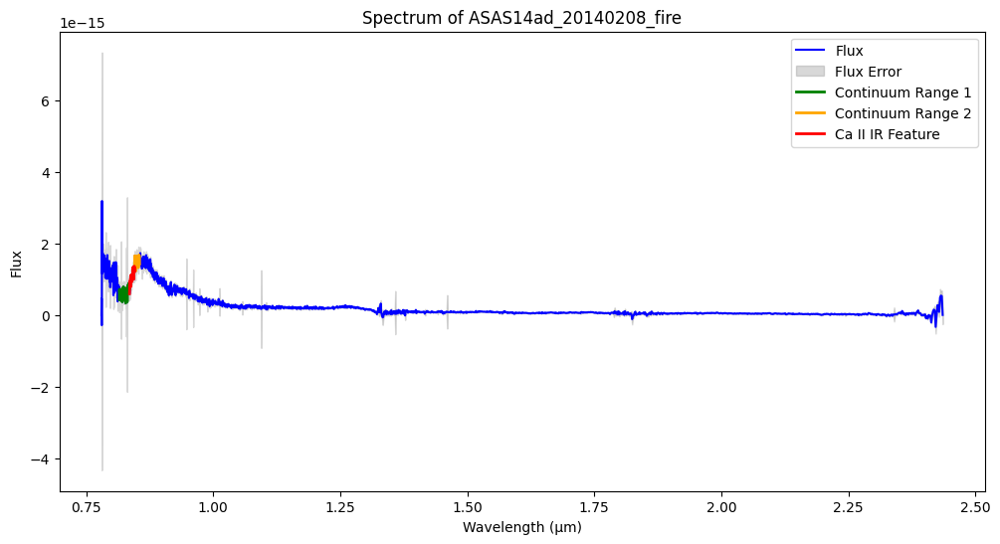

Pseudo-equivalent width for Ca II IR in ASAS14ad_20140215_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS14ad_20140215_fire: -2957.00 km/s


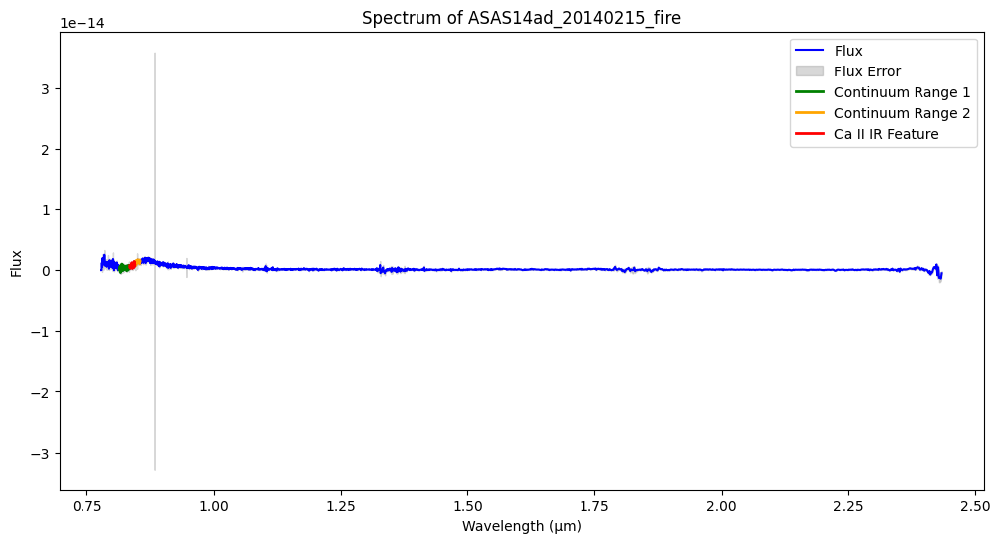

Pseudo-equivalent width for Ca II IR in ASAS14ad_20140222_fire: 0.02 Å
Velocity shift for Ca II IR in ASAS14ad_20140222_fire: -1651.41 km/s


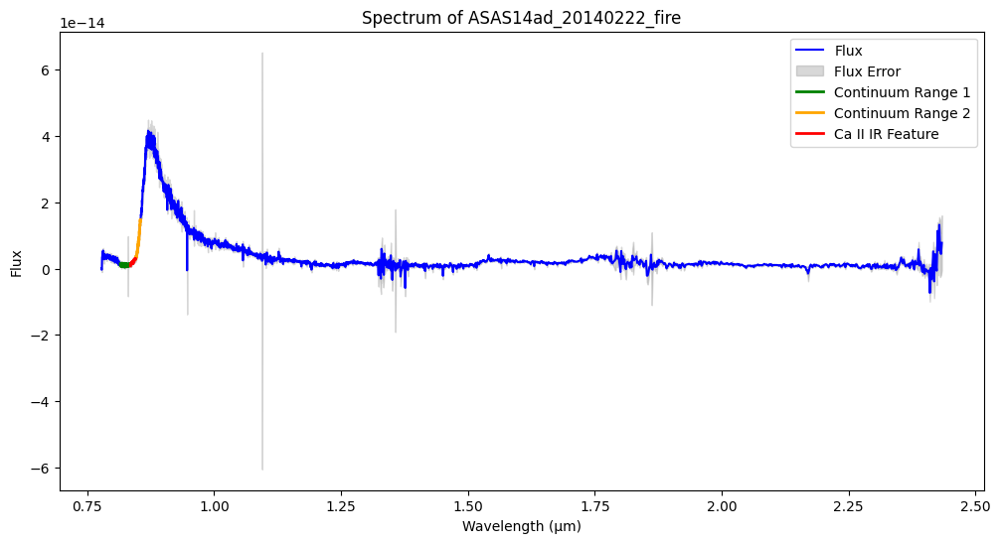

Pseudo-equivalent width for Ca II IR in ASAS14ad_20140227_fire: 0.02 Å
Velocity shift for Ca II IR in ASAS14ad_20140227_fire: -2594.76 km/s


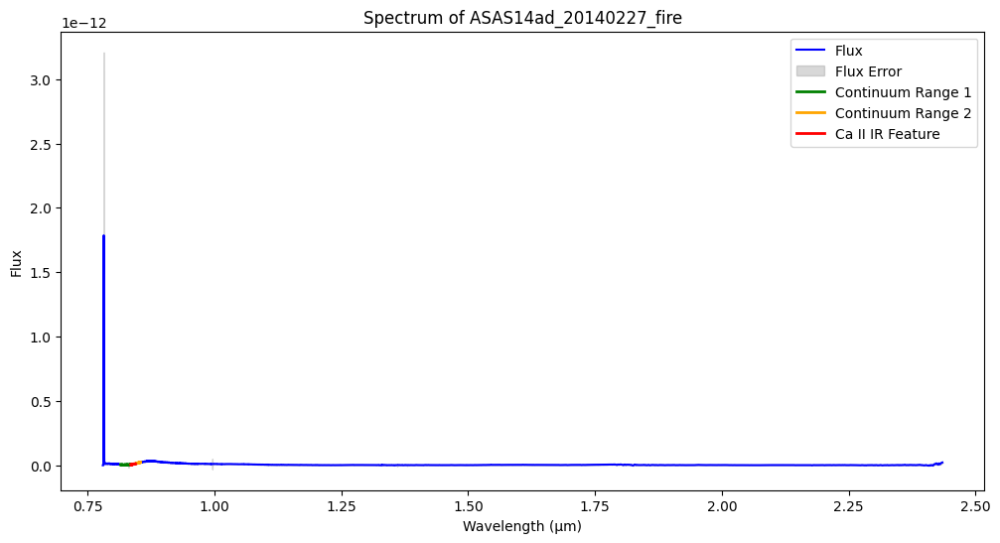

Pseudo-equivalent width for Ca II IR in ASAS14ad_20140310_fire: 0.02 Å
Velocity shift for Ca II IR in ASAS14ad_20140310_fire: -2234.80 km/s


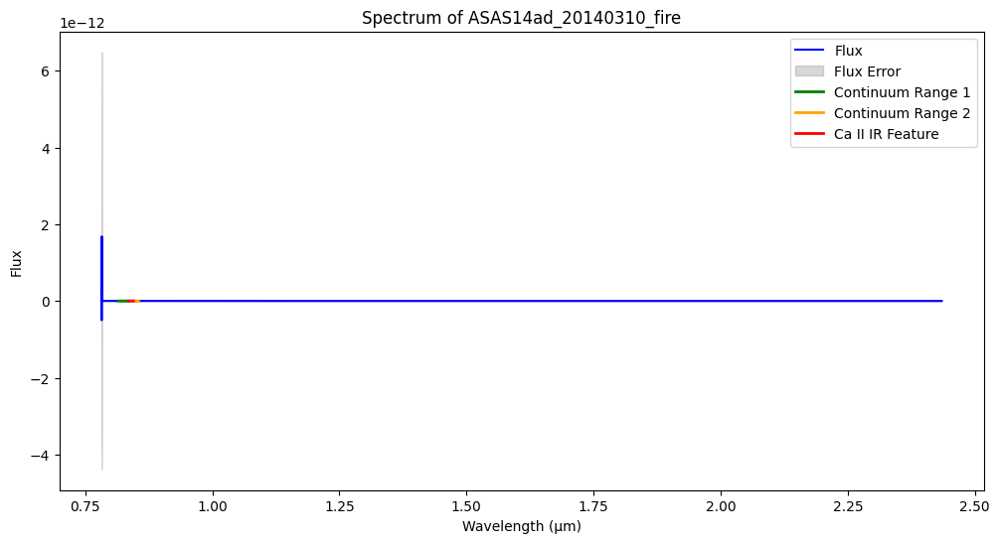

Pseudo-equivalent width for Ca II IR in ASAS14ad_20140325_fire: 0.02 Å
Velocity shift for Ca II IR in ASAS14ad_20140325_fire: -2383.65 km/s


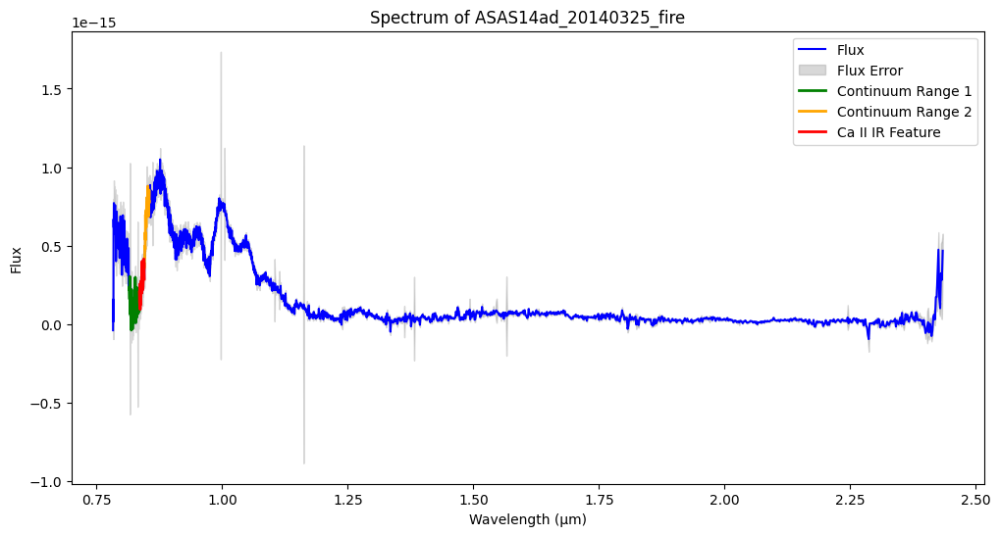

Pseudo-equivalent width for Ca II IR in ASAS14hp_20141105_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS14hp_20141105_fire: -3317.82 km/s


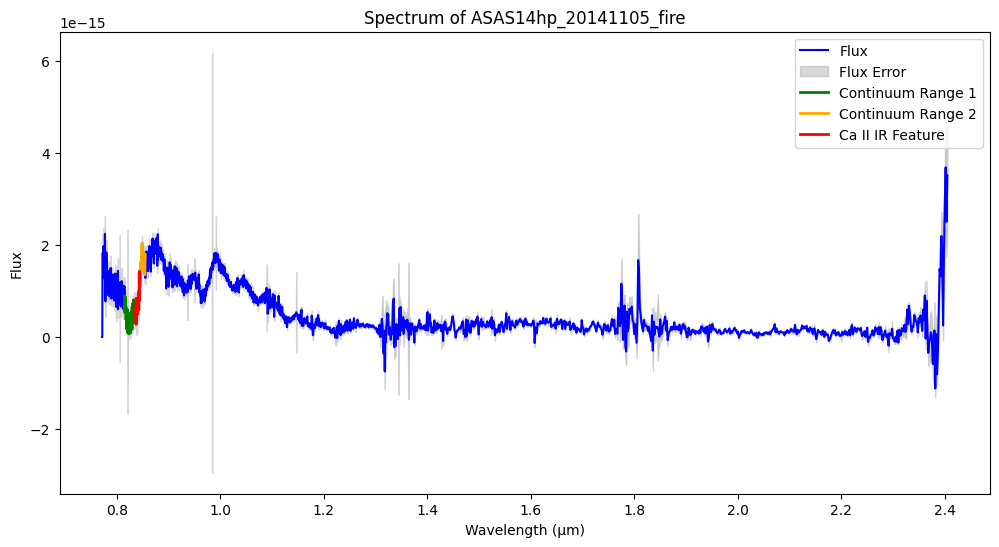

Pseudo-equivalent width for Ca II IR in ASAS14hu_20141105_fire: 0.02 Å
Velocity shift for Ca II IR in ASAS14hu_20141105_fire: -2388.76 km/s


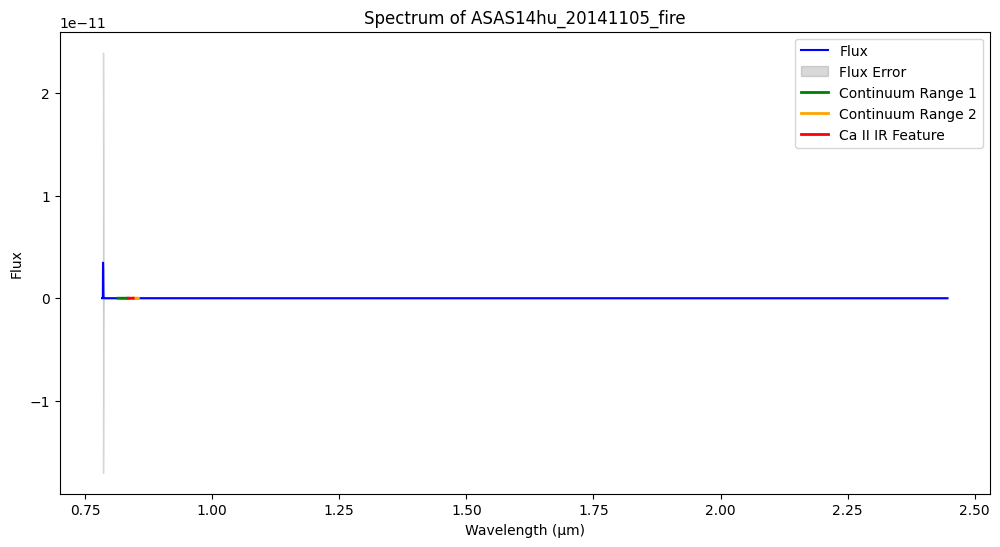

Pseudo-equivalent width for Ca II IR in ASAS14hu_20141208_fire: 0.02 Å
Velocity shift for Ca II IR in ASAS14hu_20141208_fire: -2202.73 km/s


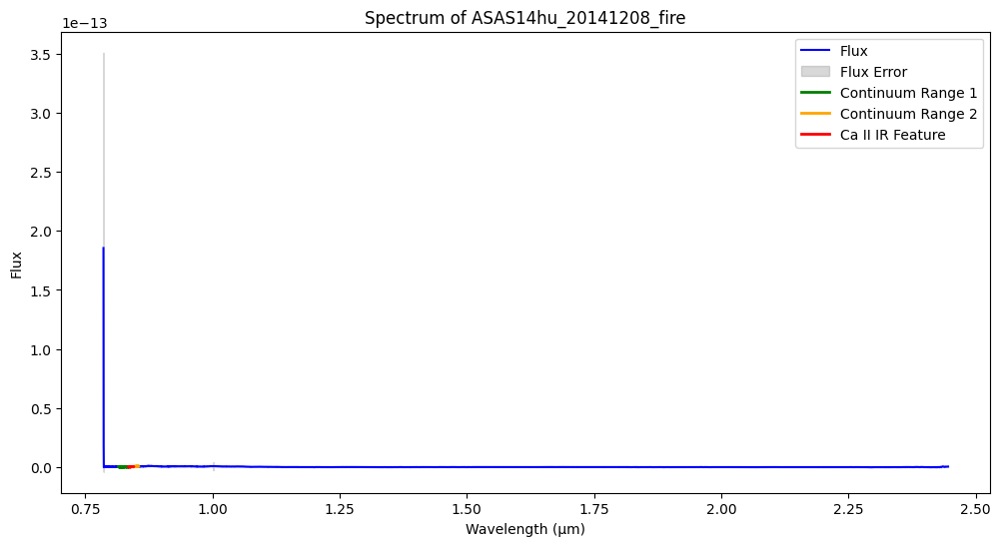

Pseudo-equivalent width for Ca II IR in ASAS14jc_20141105_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS14jc_20141105_fire: -2886.70 km/s


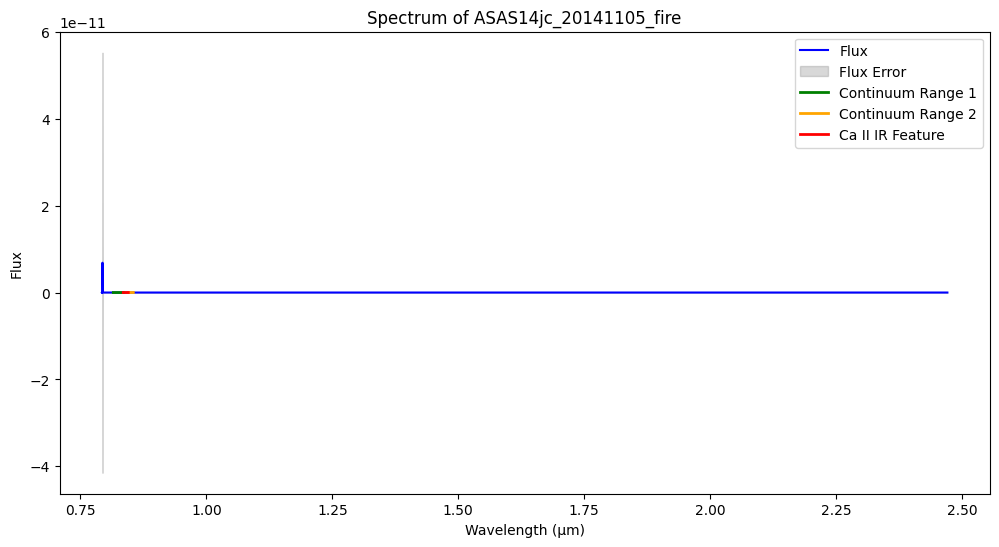

Pseudo-equivalent width for Ca II IR in ASAS14jg_20141105_fire: 0.00 Å
Velocity shift for Ca II IR in ASAS14jg_20141105_fire: -4814.43 km/s


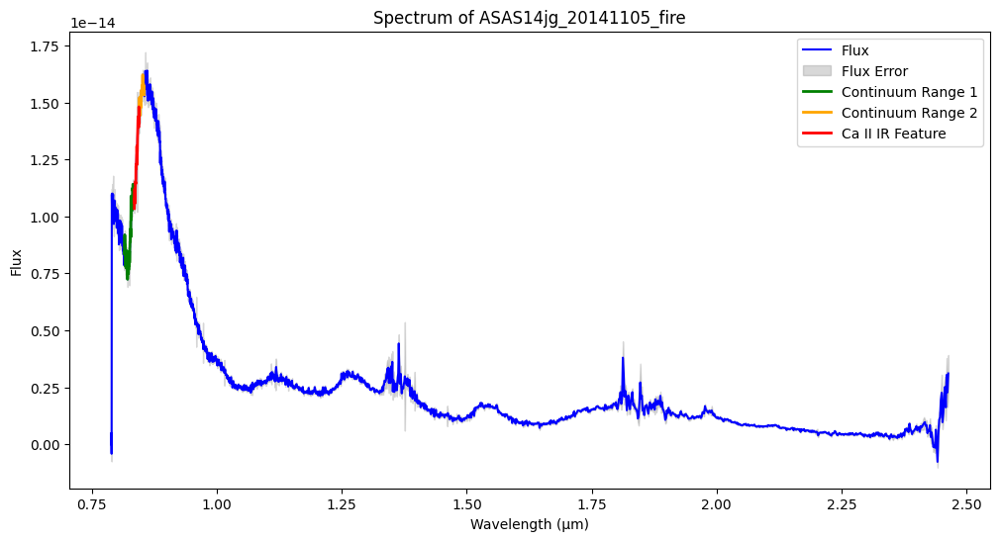

Pseudo-equivalent width for Ca II IR in ASAS14jg_20141208_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS14jg_20141208_fire: -3240.85 km/s


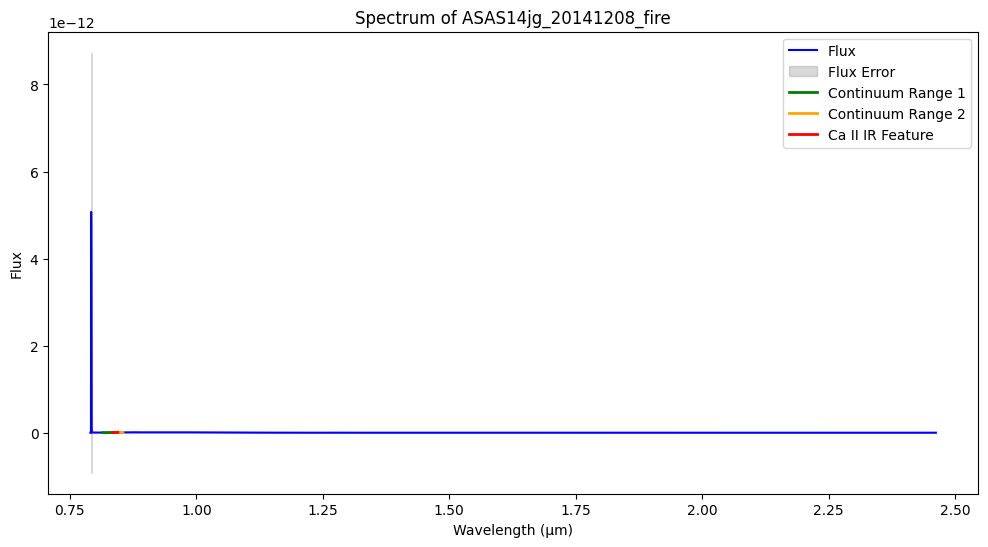

Pseudo-equivalent width for Ca II IR in ASAS14jg_20141214_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS14jg_20141214_fire: -3475.41 km/s


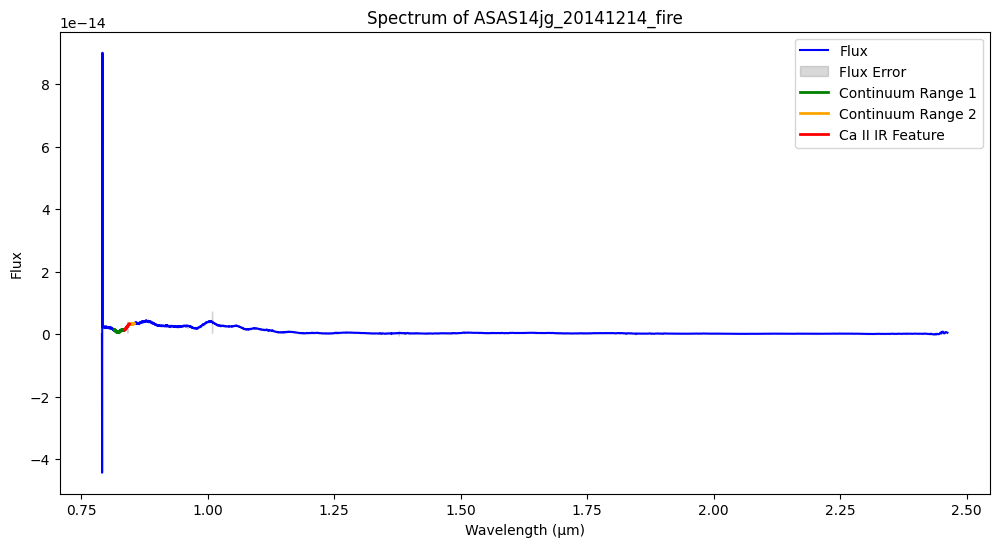

Pseudo-equivalent width for Ca II IR in ASAS14jg_20150114_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS14jg_20150114_fire: -3865.00 km/s


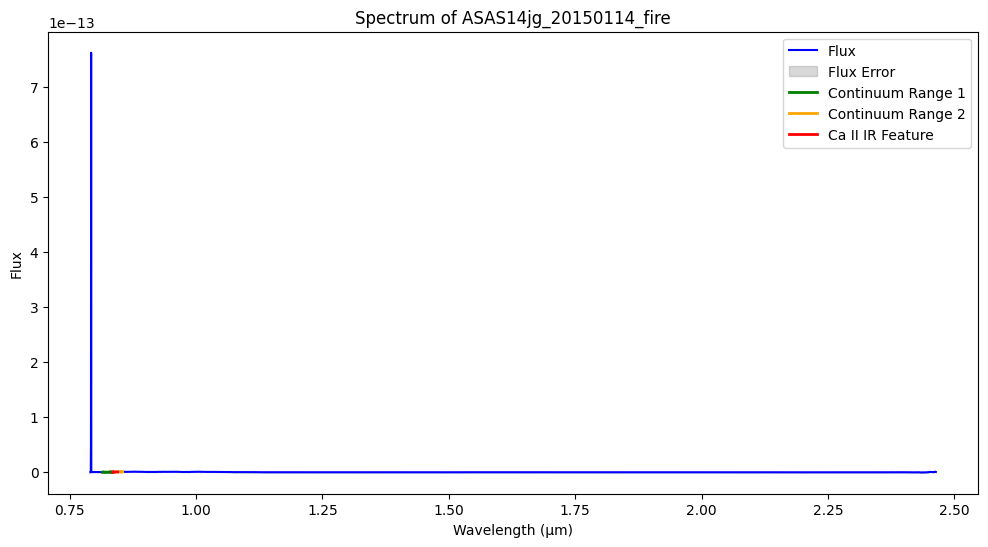

Pseudo-equivalent width for Ca II IR in ASAS14lo_20141214_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS14lo_20141214_fire: -3417.06 km/s


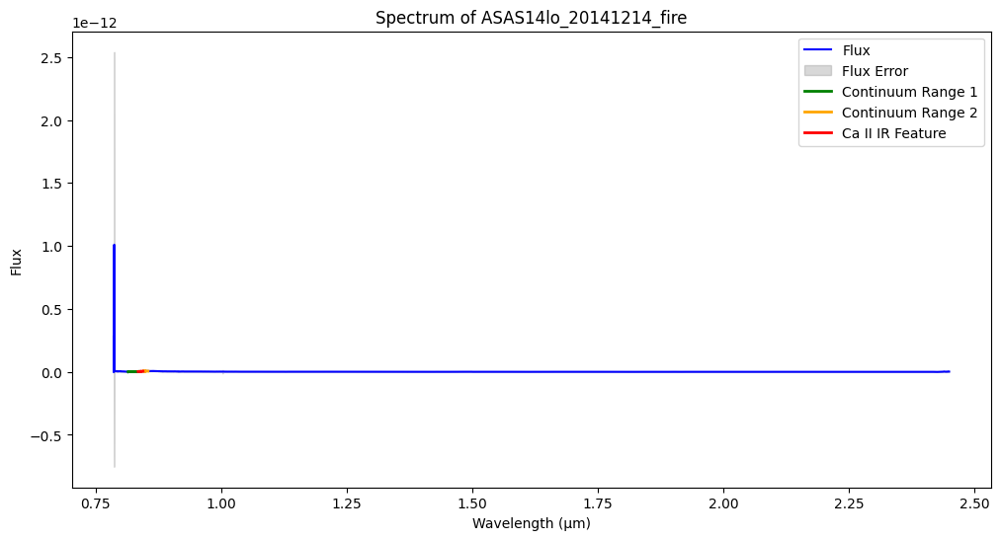

Pseudo-equivalent width for Ca II IR in ASAS14lp_20141214_fire: -0.00 Å
Velocity shift for Ca II IR in ASAS14lp_20141214_fire: -5839.76 km/s


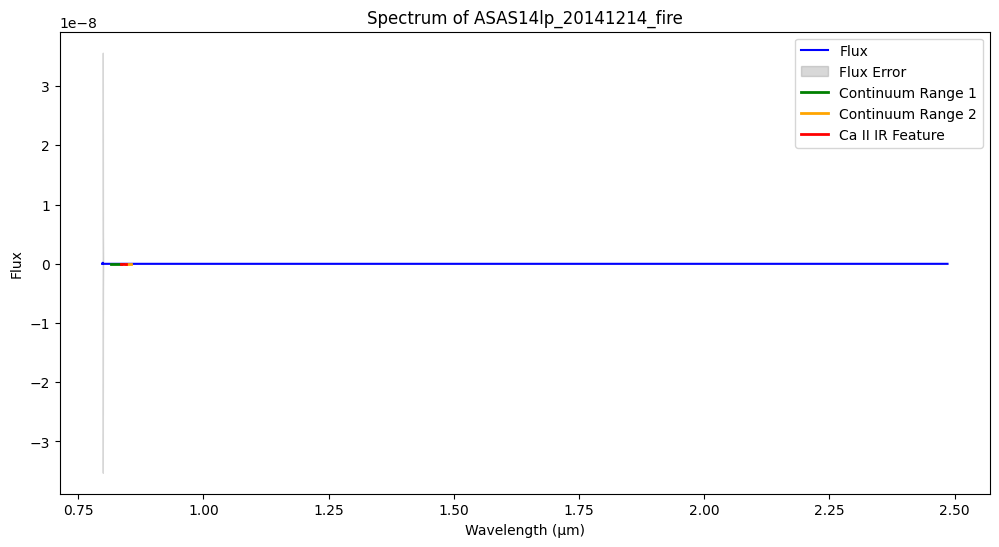

Pseudo-equivalent width for Ca II IR in ASAS14lp_20141220_fire: -0.00 Å
Velocity shift for Ca II IR in ASAS14lp_20141220_fire: -5865.60 km/s


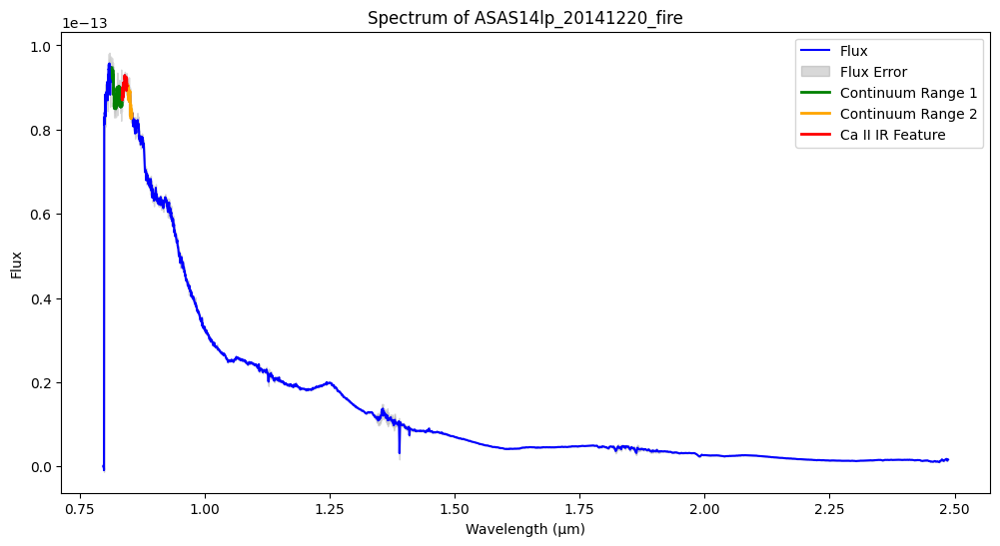

Pseudo-equivalent width for Ca II IR in ASAS14lp_20150114_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS14lp_20150114_fire: -3035.34 km/s


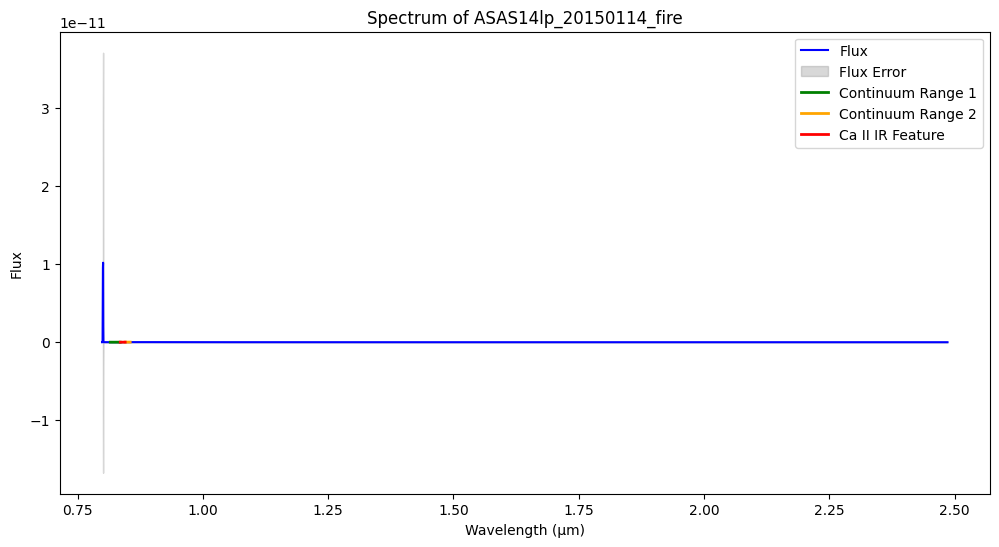

Pseudo-equivalent width for Ca II IR in ASAS14lp_20150128_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS14lp_20150128_fire: -2770.08 km/s


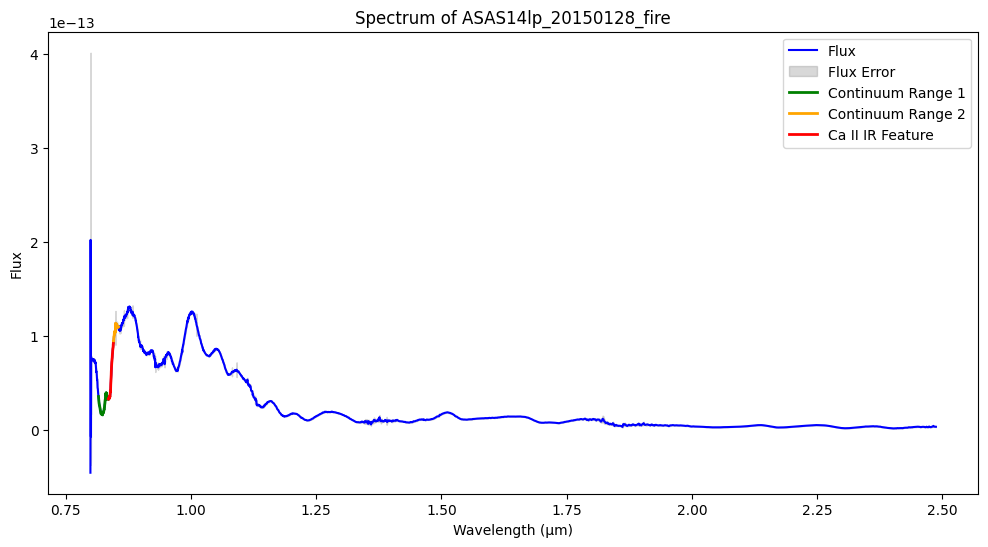

Pseudo-equivalent width for Ca II IR in ASAS14lp_20150204_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS14lp_20150204_fire: -2741.59 km/s


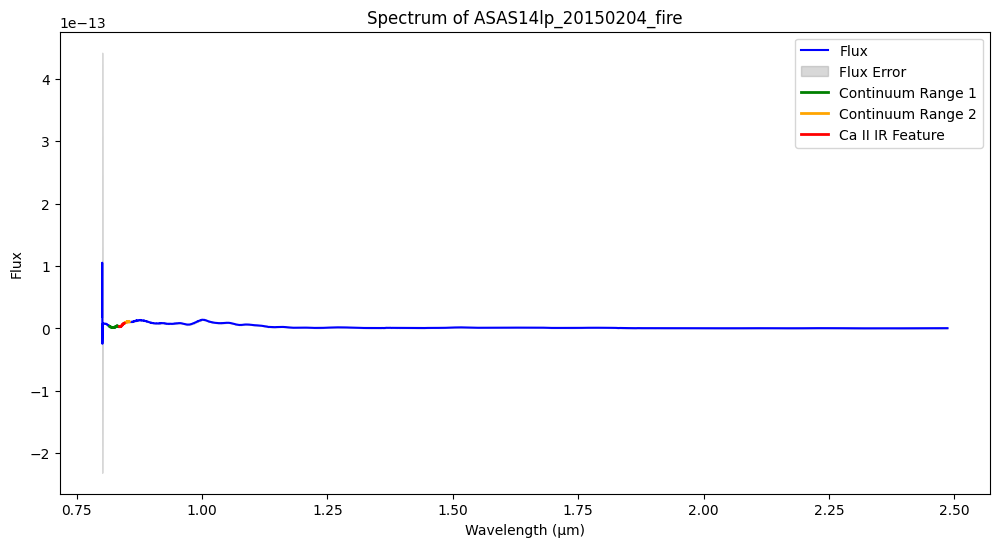

Pseudo-equivalent width for Ca II IR in ASAS14lp_20150307_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS14lp_20150307_fire: -2902.06 km/s


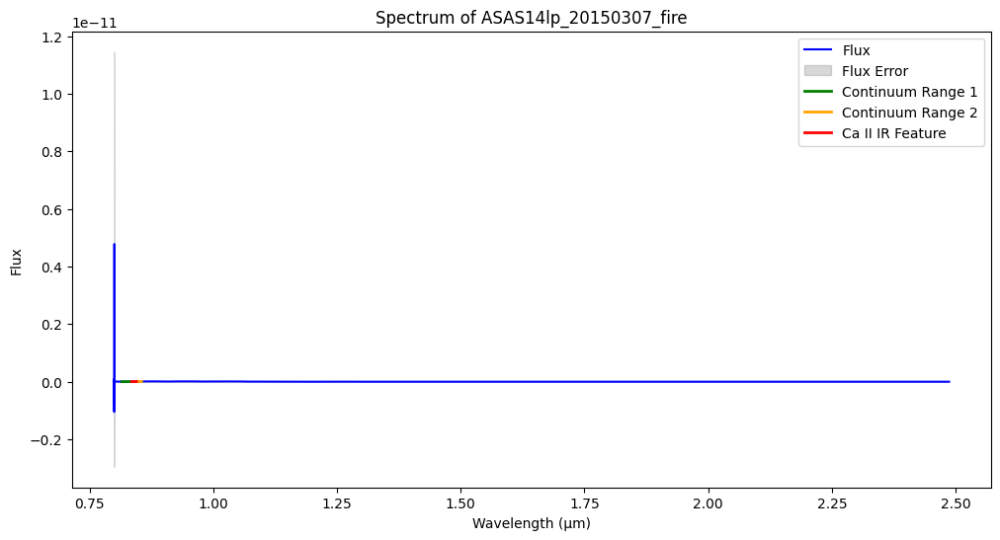

Pseudo-equivalent width for Ca II IR in ASAS14lq_20141214_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS14lq_20141214_fire: -4326.15 km/s


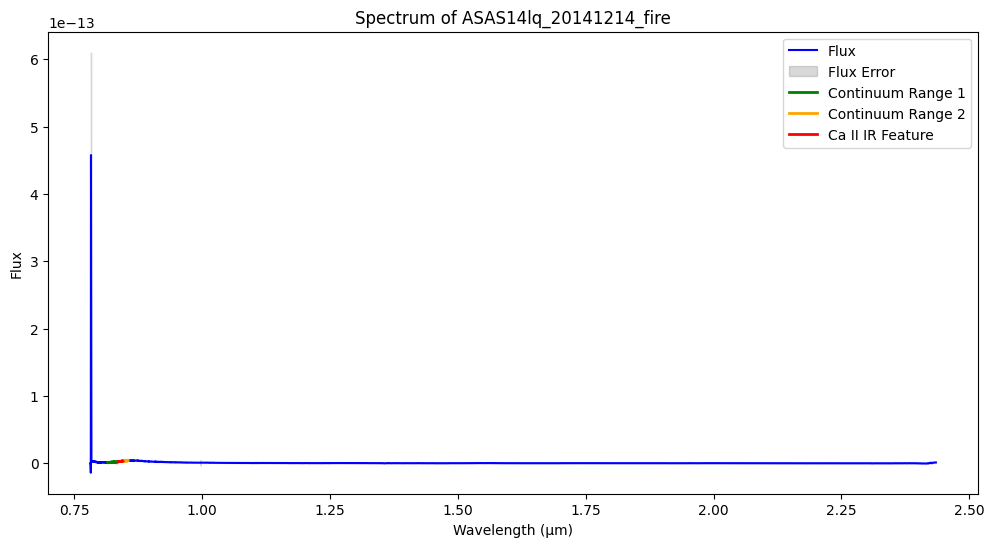

Pseudo-equivalent width for Ca II IR in ASAS14lw_20141214_fire: -0.00 Å
Velocity shift for Ca II IR in ASAS14lw_20141214_fire: -6202.06 km/s


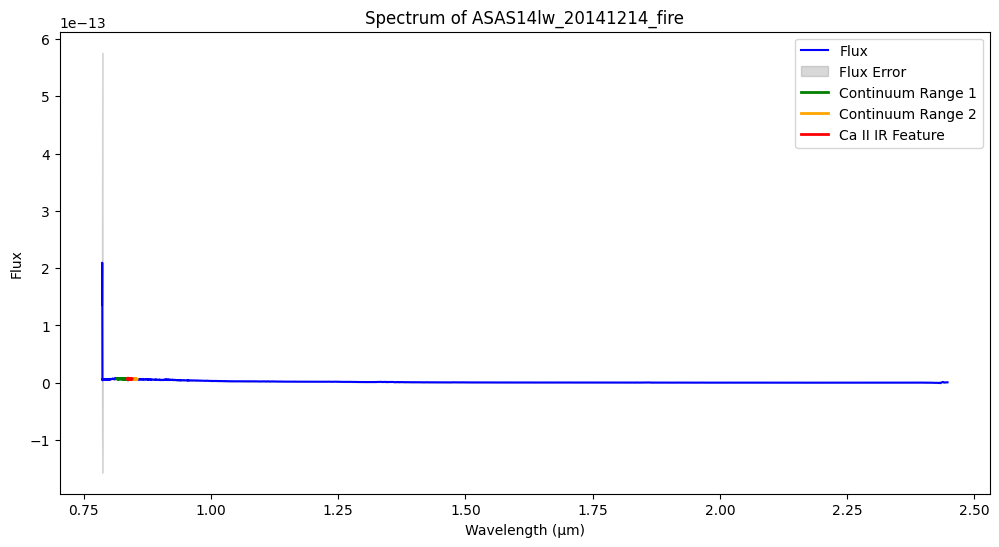

Pseudo-equivalent width for Ca II IR in ASAS14lw_20150105_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS14lw_20150105_fire: -3772.71 km/s


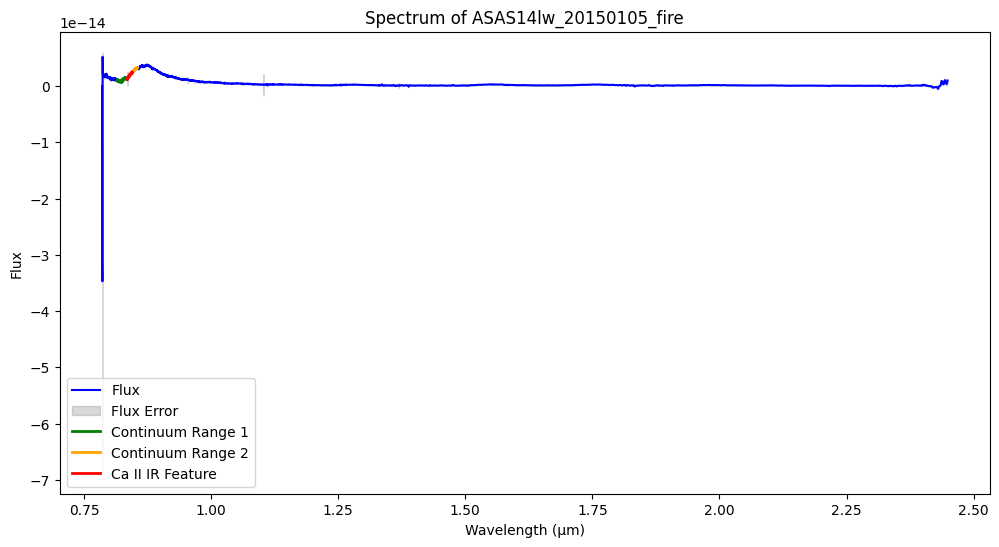

Pseudo-equivalent width for Ca II IR in ASAS14lw_20150114_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS14lw_20150114_fire: -3149.99 km/s


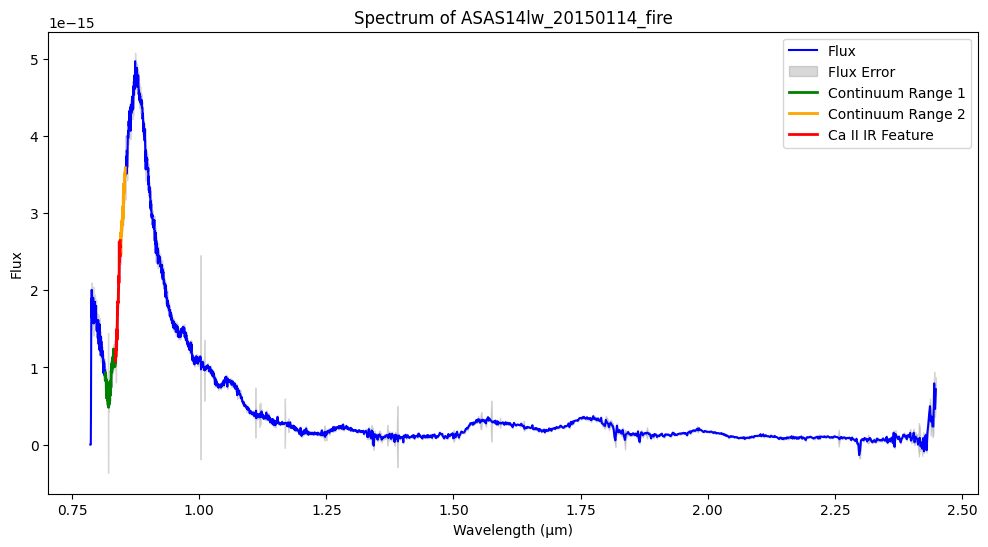

Pseudo-equivalent width for Ca II IR in ASAS14me_20150105_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS14me_20150105_fire: -4525.00 km/s


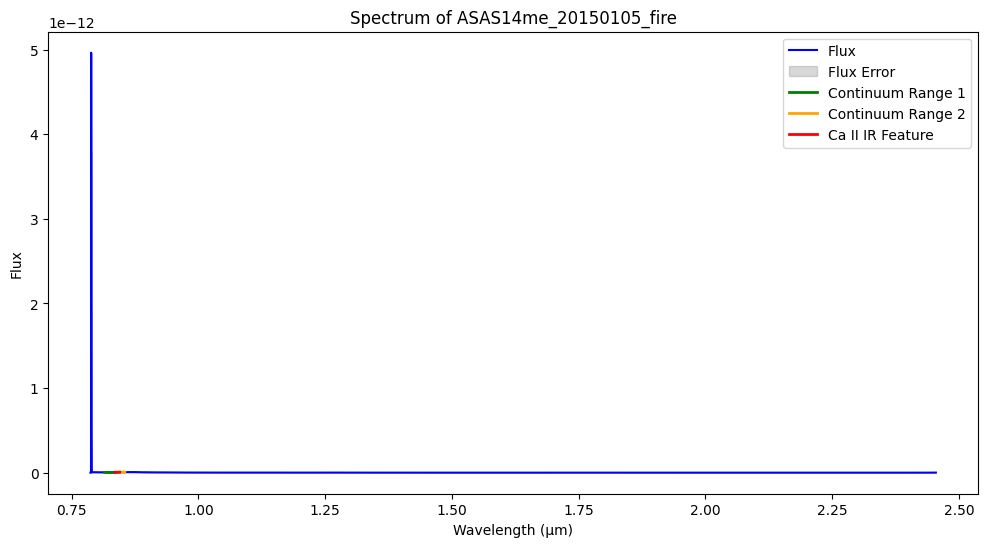

Pseudo-equivalent width for Ca II IR in ASAS14me_20150114_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS14me_20150114_fire: -3675.26 km/s


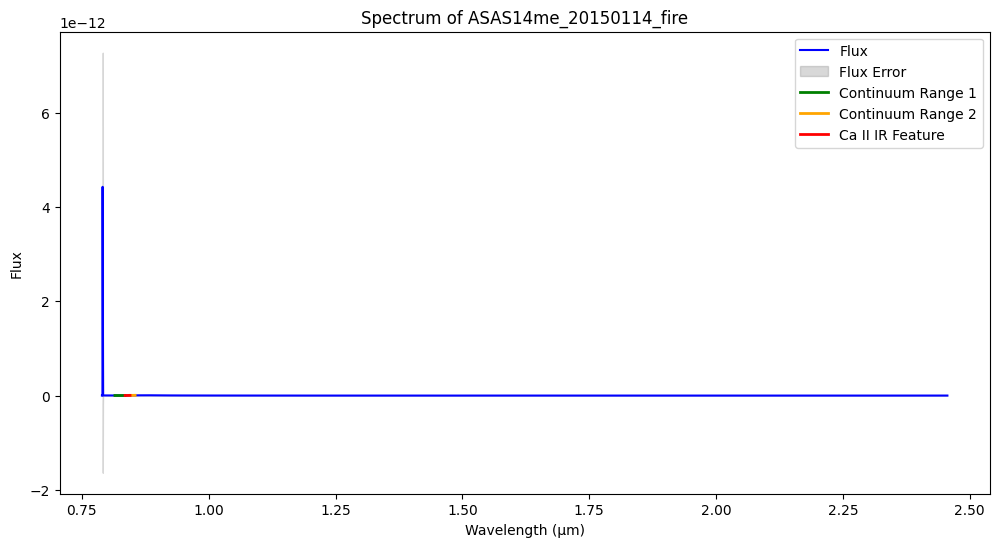

Pseudo-equivalent width for Ca II IR in ASAS14me_20150128_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS14me_20150128_fire: -3200.18 km/s


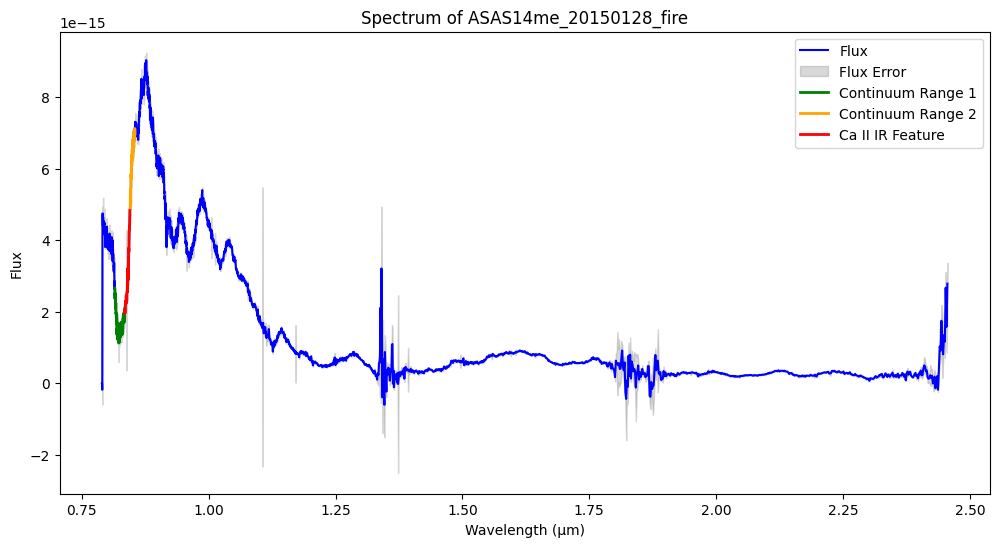

Pseudo-equivalent width for Ca II IR in ASAS14mw_20150105_fire: 0.00 Å
Velocity shift for Ca II IR in ASAS14mw_20150105_fire: -5351.46 km/s


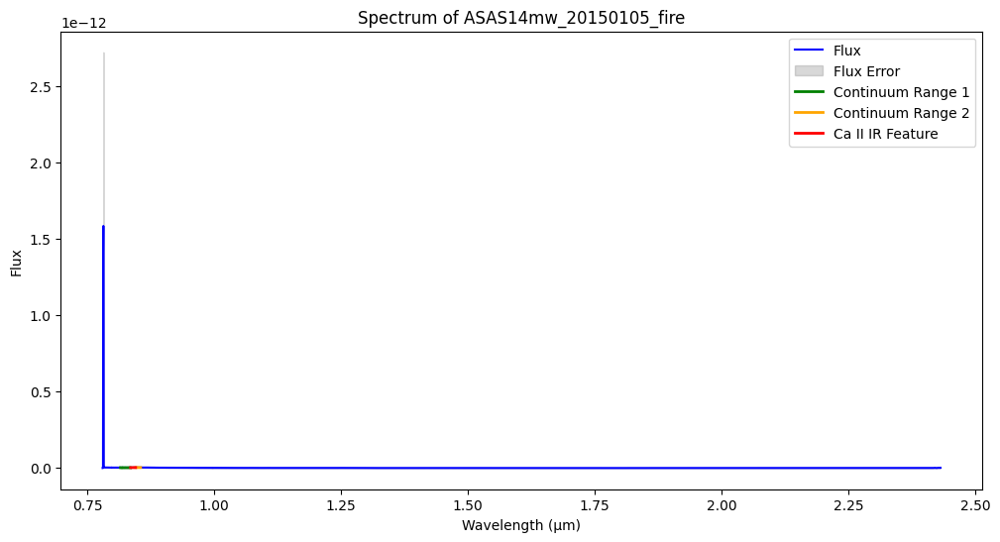

Pseudo-equivalent width for Ca II IR in ASAS14mw_20150114_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS14mw_20150114_fire: -3992.76 km/s


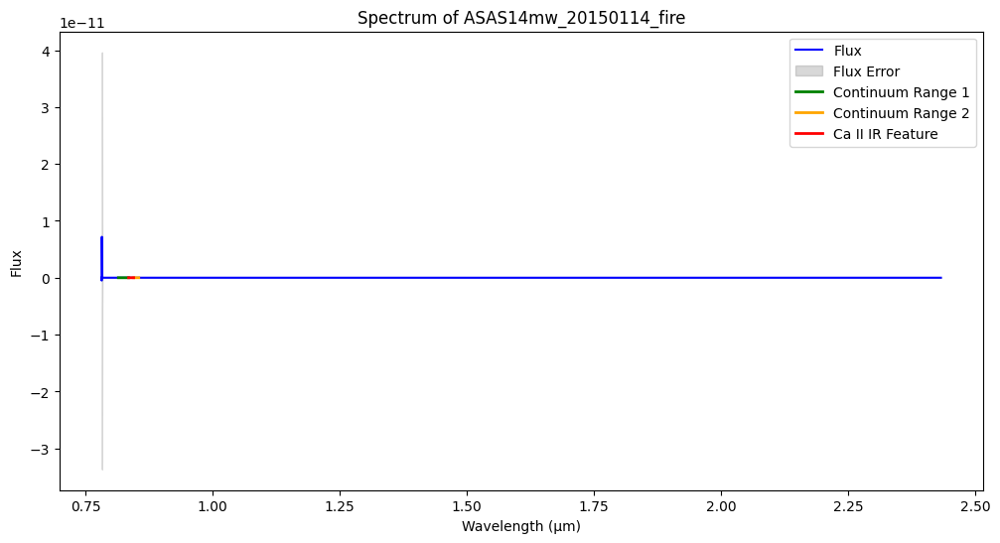

Pseudo-equivalent width for Ca II IR in ASAS14mw_20150128_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS14mw_20150128_fire: -3061.85 km/s


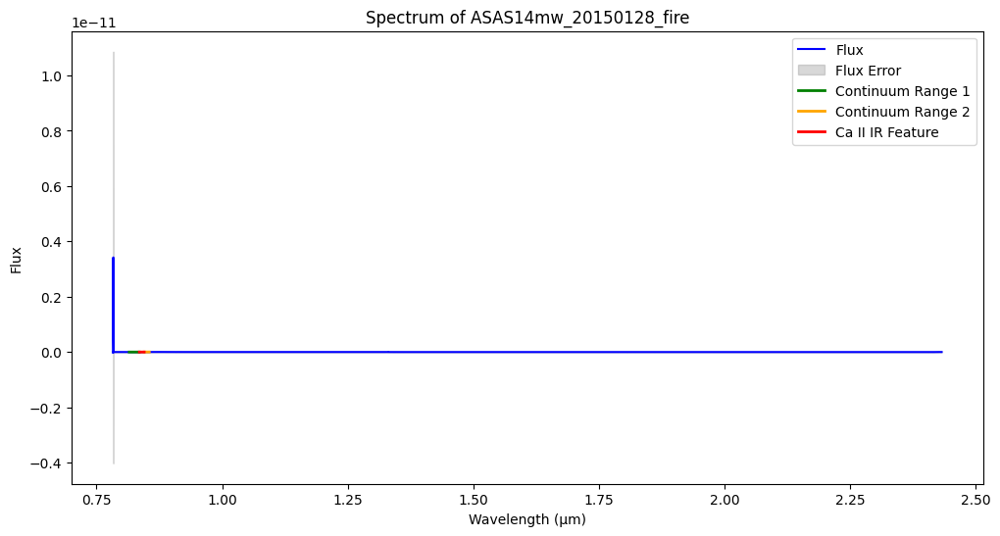

Pseudo-equivalent width for Ca II IR in ASAS14my_20150105_fire: 0.00 Å
Velocity shift for Ca II IR in ASAS14my_20150105_fire: -5336.86 km/s


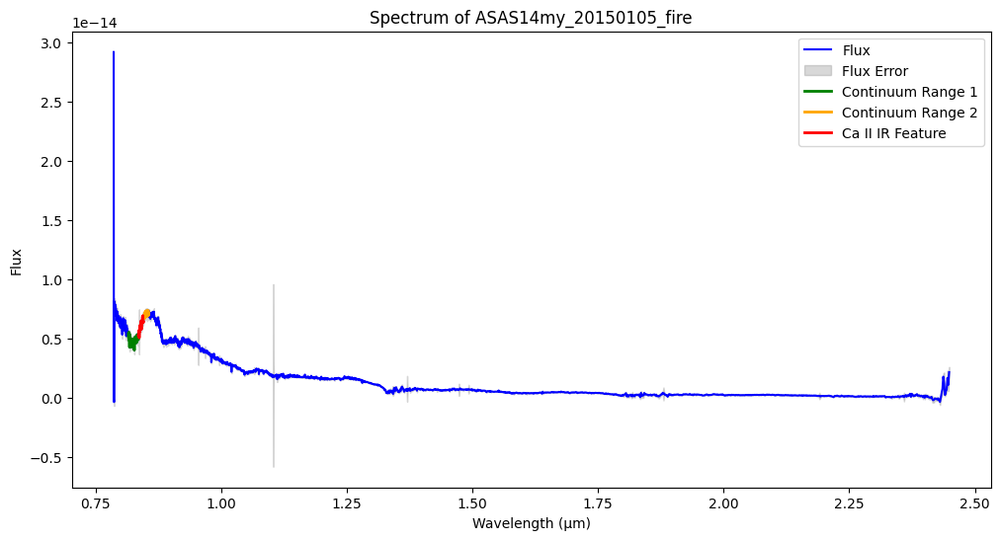

Pseudo-equivalent width for Ca II IR in ASAS14my_20150114_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS14my_20150114_fire: -4116.30 km/s


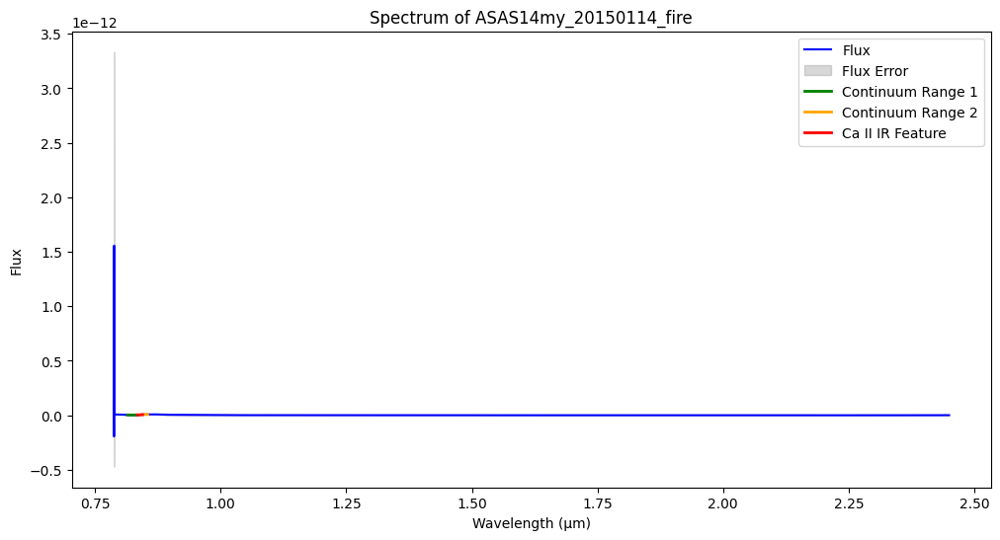

Pseudo-equivalent width for Ca II IR in ASAS14my_20150128_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS14my_20150128_fire: -3750.21 km/s


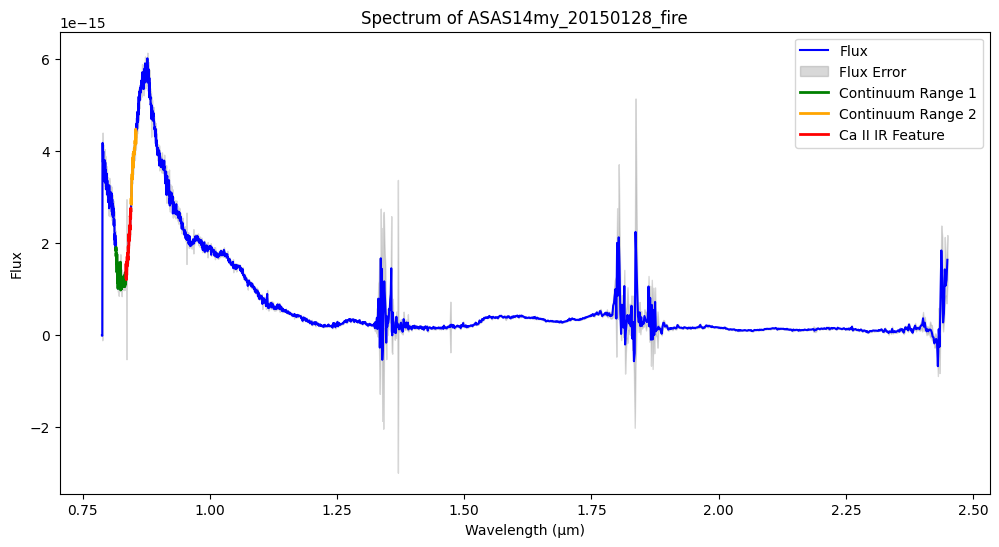

Pseudo-equivalent width for Ca II IR in ASAS15aj_20150114_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS15aj_20150114_fire: -4848.22 km/s


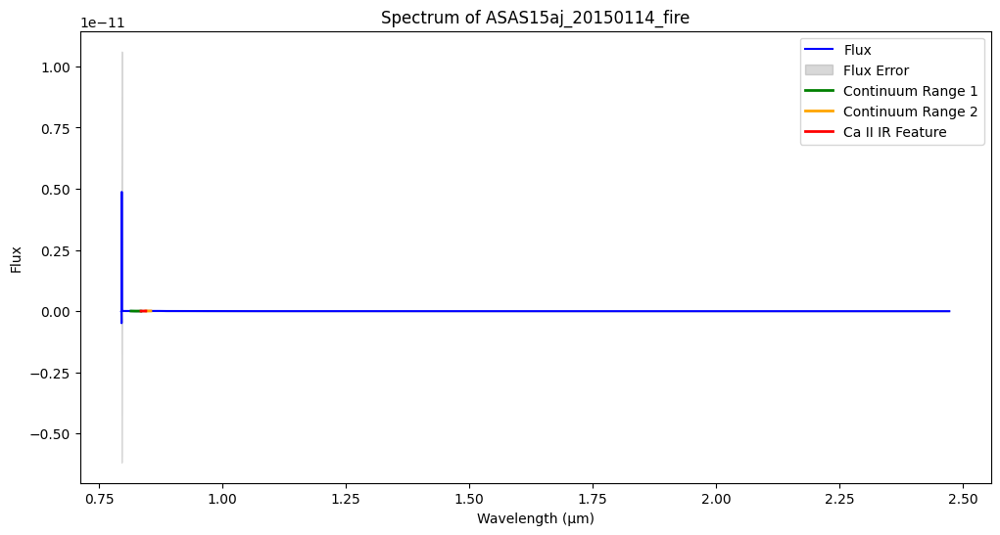

Pseudo-equivalent width for Ca II IR in ASAS15aj_20150128_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS15aj_20150128_fire: -4564.98 km/s


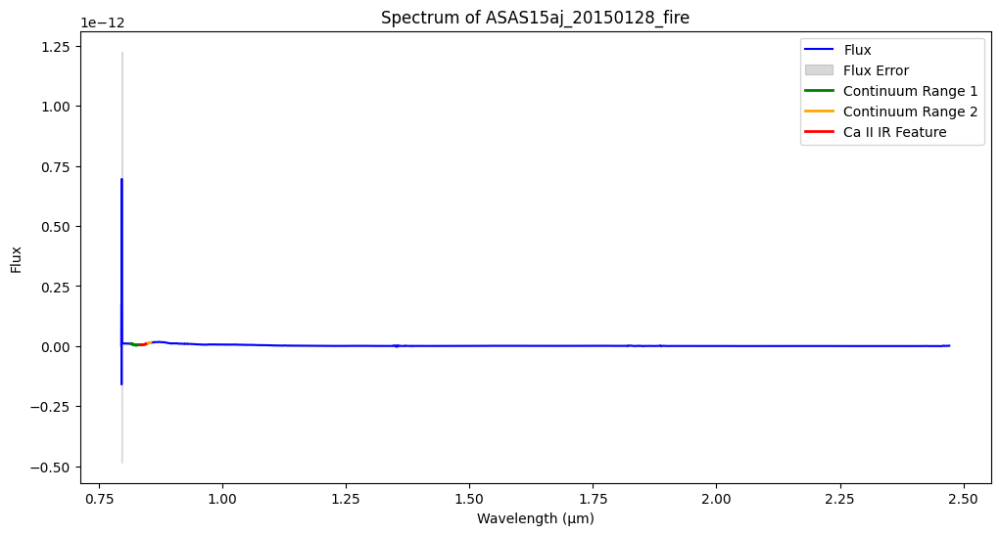

Pseudo-equivalent width for Ca II IR in ASAS15as_20150114_fire: 0.00 Å
Velocity shift for Ca II IR in ASAS15as_20150114_fire: -5576.52 km/s


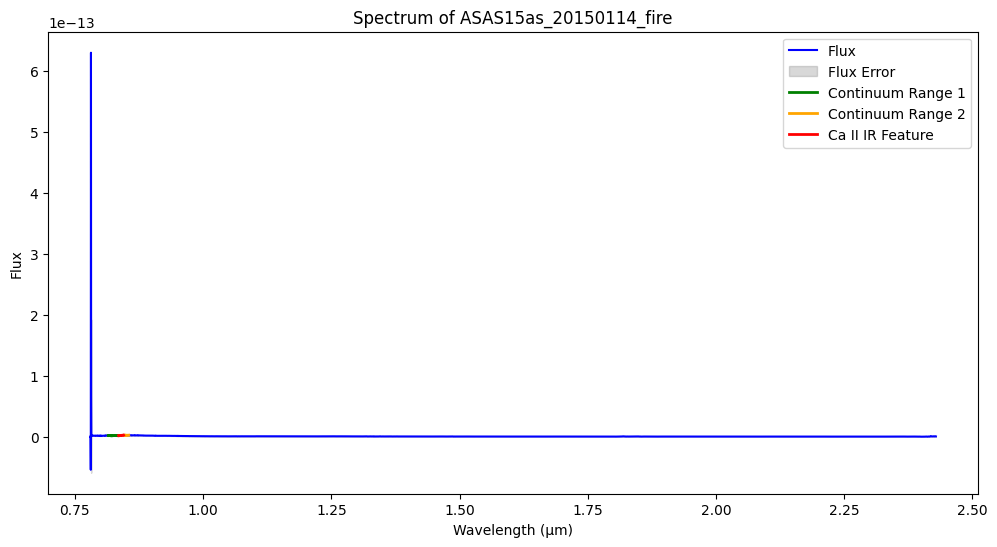

Pseudo-equivalent width for Ca II IR in ASAS15as_20150128_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS15as_20150128_fire: -3881.49 km/s


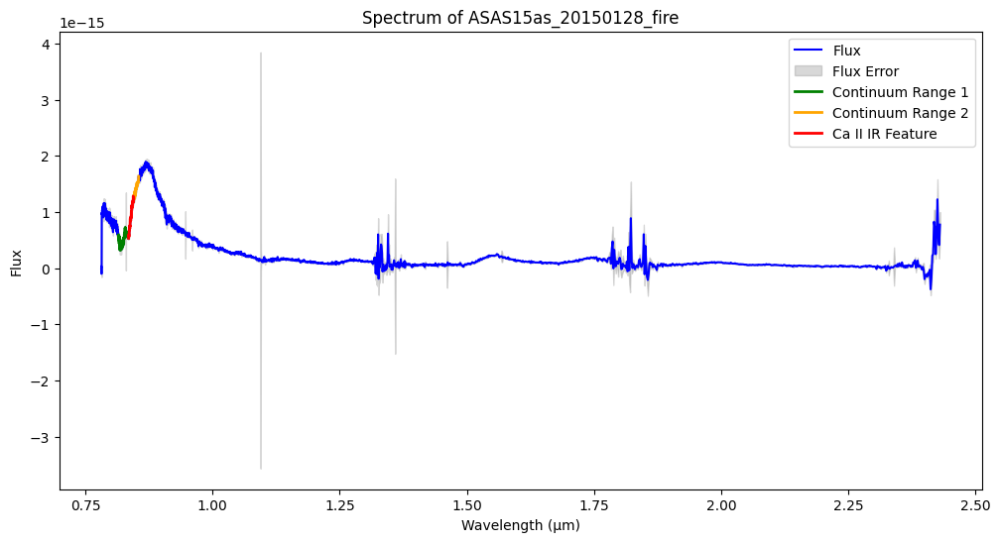

Pseudo-equivalent width for Ca II IR in ASAS15ba_20150128_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS15ba_20150128_fire: -3690.81 km/s


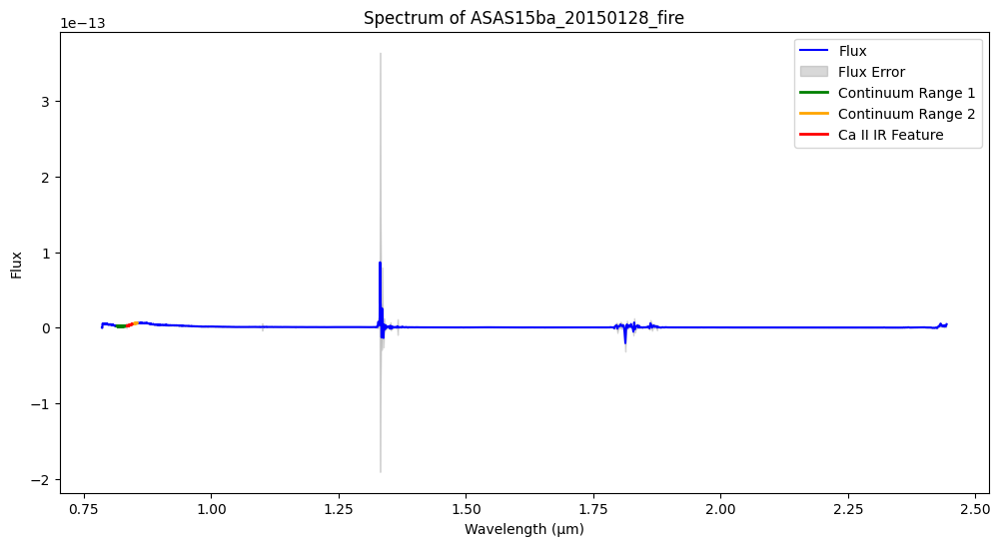

Pseudo-equivalent width for Ca II IR in ASAS15ba_20150307_fire: 0.02 Å
Velocity shift for Ca II IR in ASAS15ba_20150307_fire: -2425.65 km/s


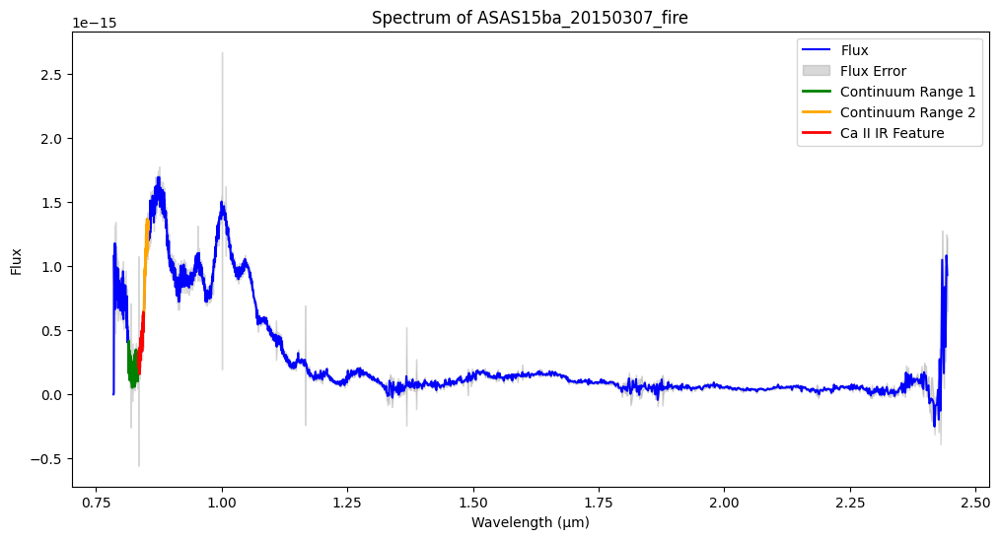

Pseudo-equivalent width for Ca II IR in ASAS15be_20150128_fire: 0.00 Å
Velocity shift for Ca II IR in ASAS15be_20150128_fire: -5216.41 km/s


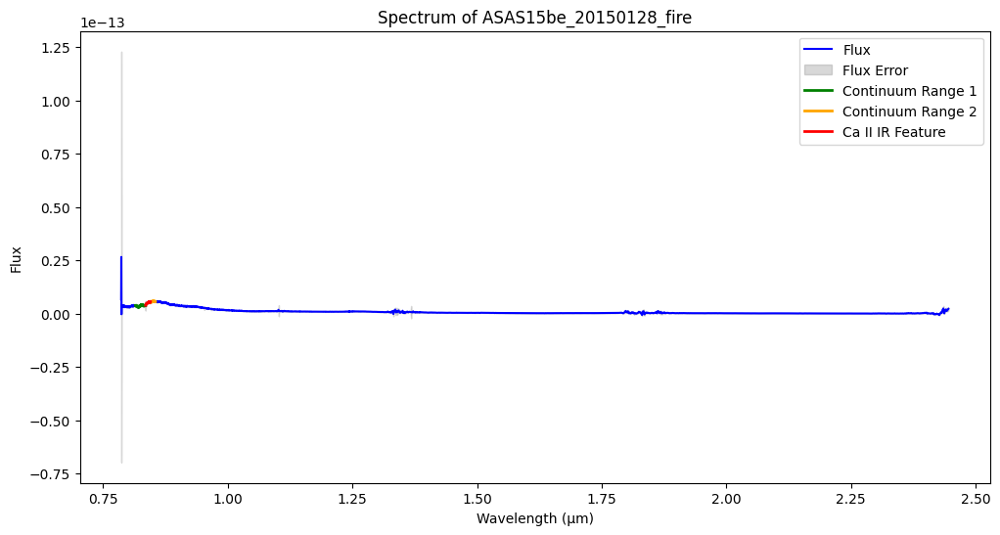

Pseudo-equivalent width for Ca II IR in ASAS15be_20150307_fire: 0.02 Å
Velocity shift for Ca II IR in ASAS15be_20150307_fire: -2397.98 km/s


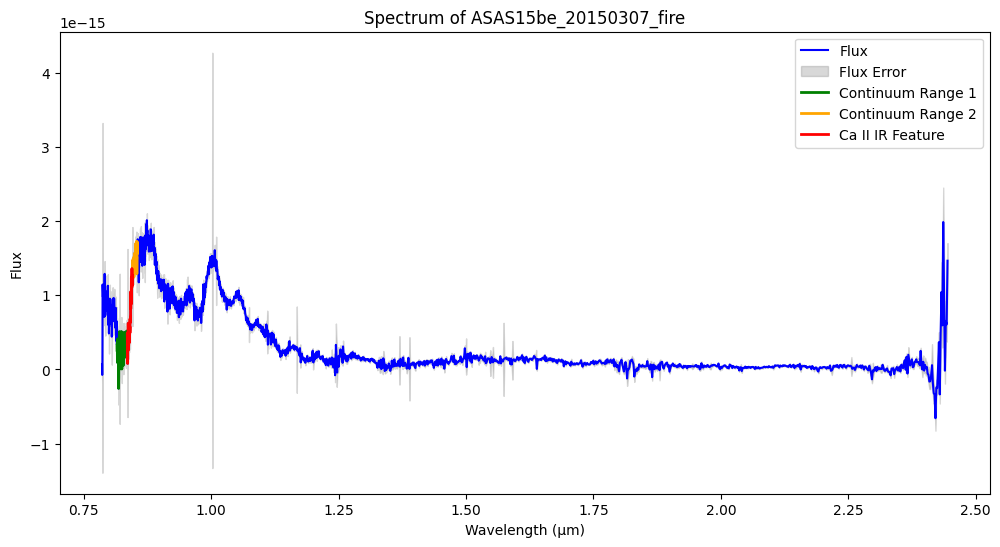

Pseudo-equivalent width for Ca II IR in ASAS15bm_20150128_fire: 0.00 Å
Velocity shift for Ca II IR in ASAS15bm_20150128_fire: -5663.55 km/s


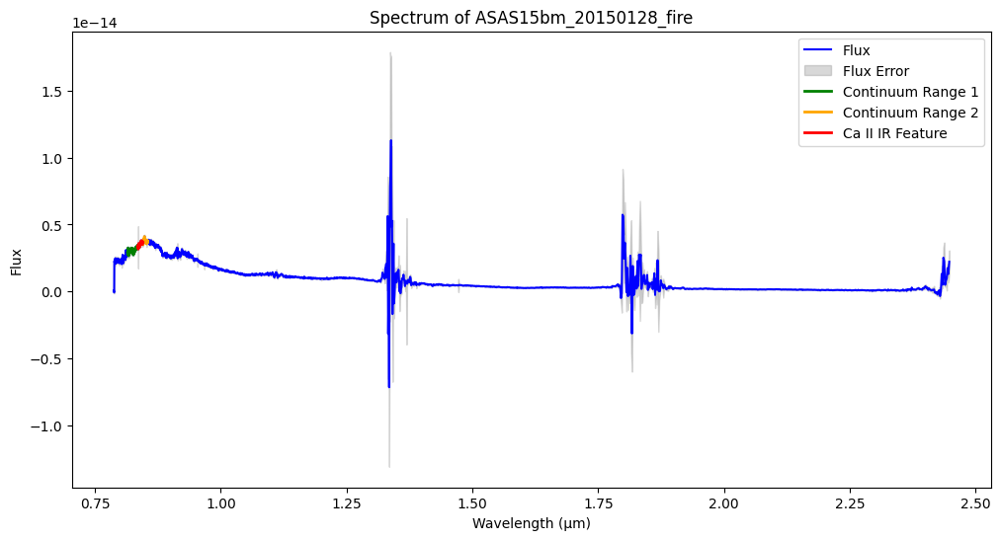

Pseudo-equivalent width for Ca II IR in ASAS15bm_20150204_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS15bm_20150204_fire: -4669.34 km/s


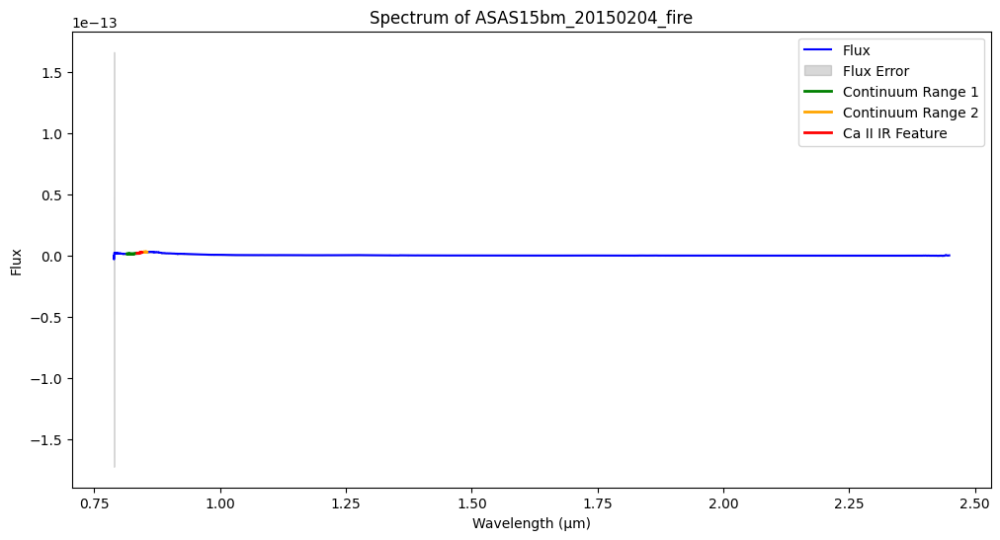

Pseudo-equivalent width for Ca II IR in ASAS15bm_20150307_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS15bm_20150307_fire: -3329.54 km/s


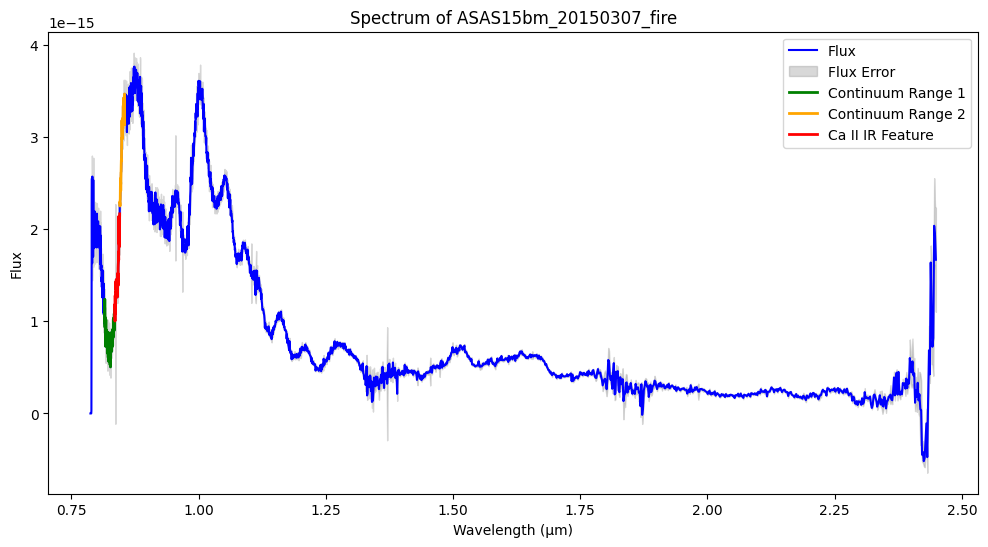

Pseudo-equivalent width for Ca II IR in ASAS15cd_20150128_fire: 0.00 Å
Velocity shift for Ca II IR in ASAS15cd_20150128_fire: -5524.38 km/s


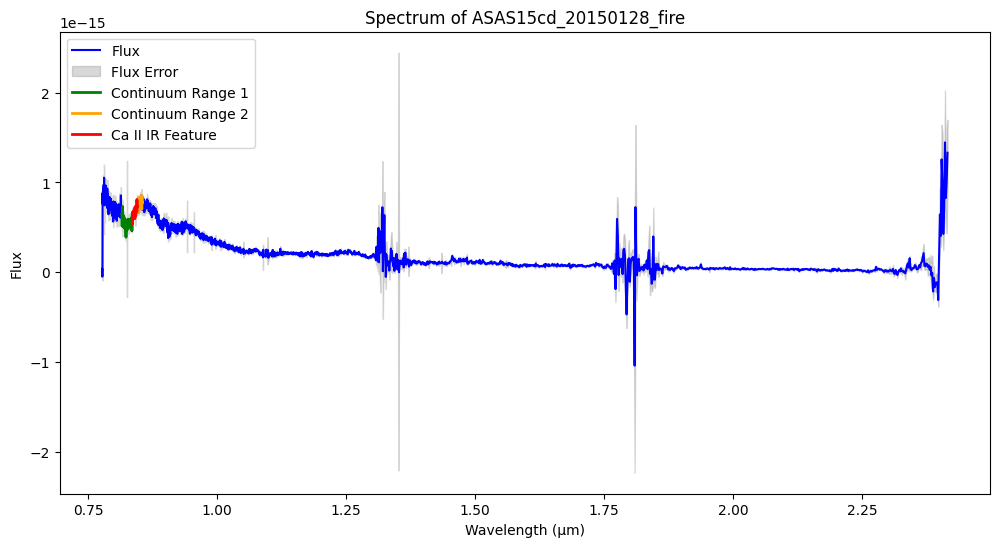

Pseudo-equivalent width for Ca II IR in ASAS15eb_20150307_fire: 0.00 Å
Velocity shift for Ca II IR in ASAS15eb_20150307_fire: -6029.62 km/s


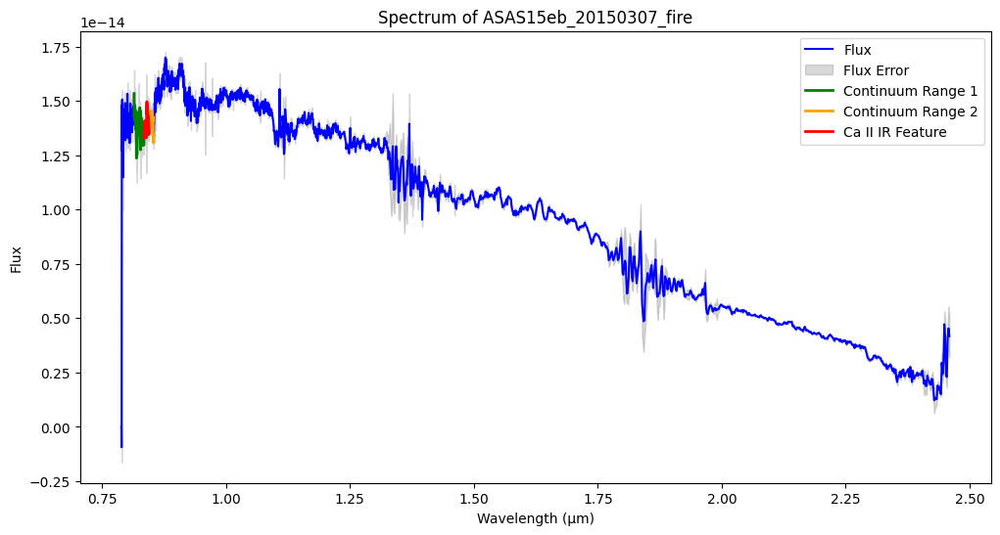

Pseudo-equivalent width for Ca II IR in ASAS15fr_20150407_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS15fr_20150407_fire: -4269.09 km/s


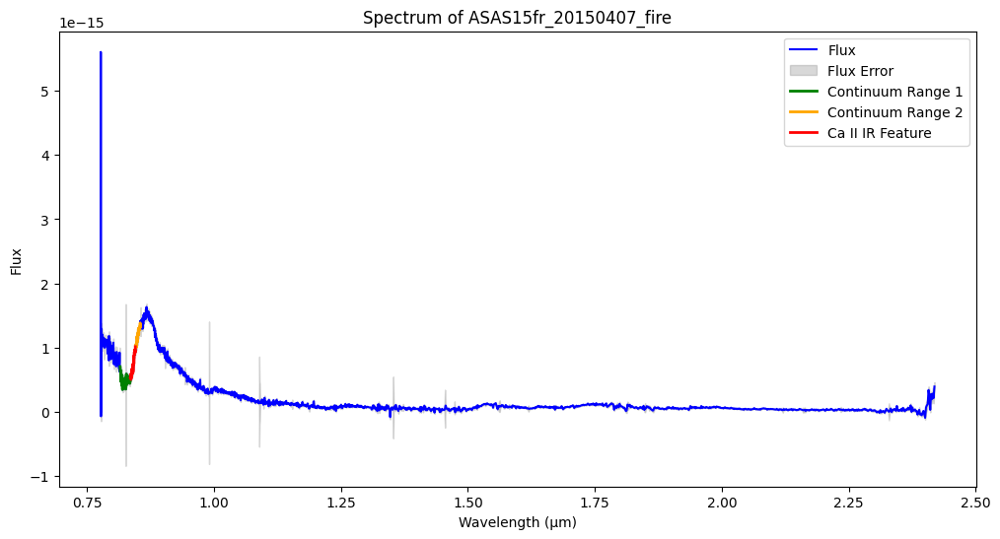

Pseudo-equivalent width for Ca II IR in ASAS15ga_20150402_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS15ga_20150402_fire: -3907.99 km/s


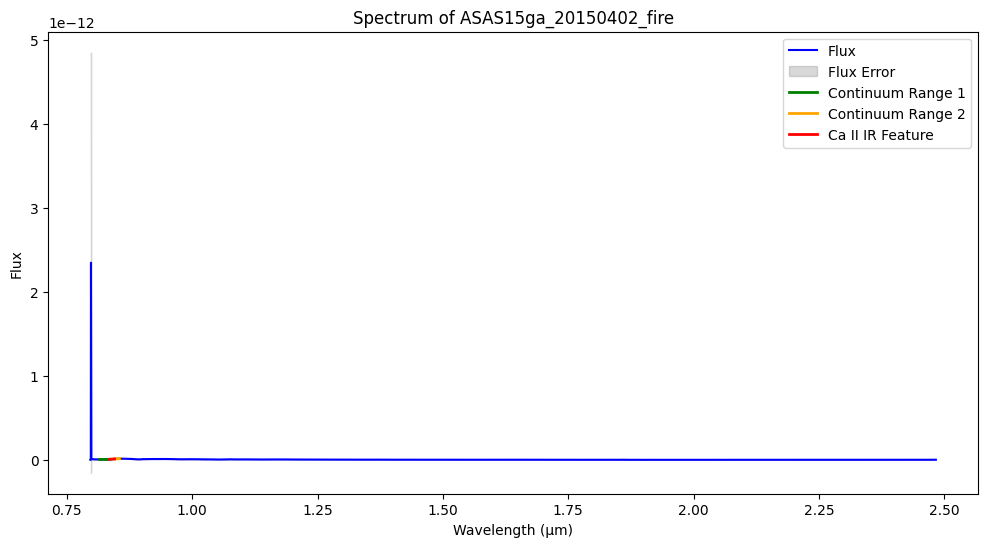

Pseudo-equivalent width for Ca II IR in ASAS15ga_20150407_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS15ga_20150407_fire: -4082.84 km/s


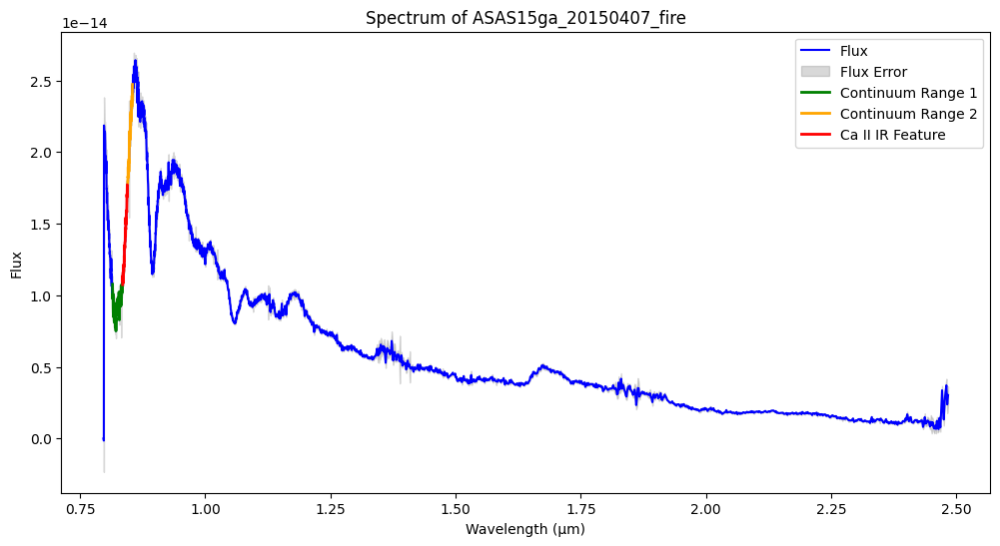

Pseudo-equivalent width for Ca II IR in ASAS15ga_20150412_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS15ga_20150412_fire: -3976.31 km/s


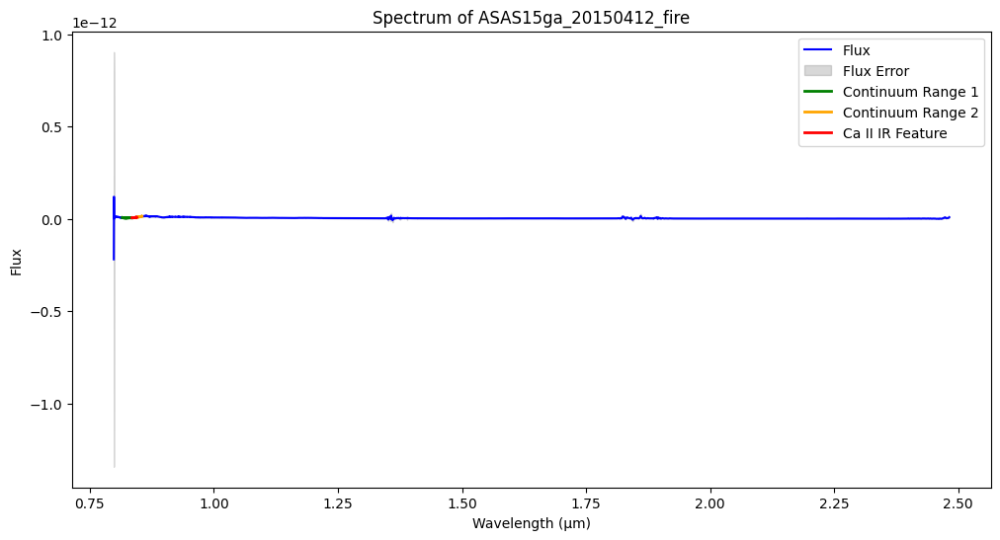

Pseudo-equivalent width for Ca II IR in ASAS15go_20150412_fire: 0.00 Å
Velocity shift for Ca II IR in ASAS15go_20150412_fire: -4992.32 km/s


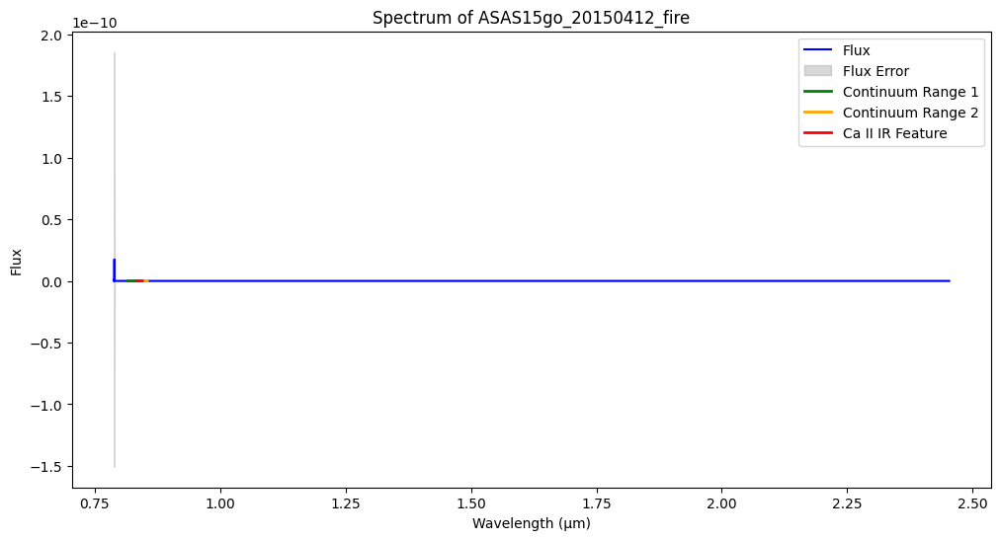

Pseudo-equivalent width for Ca II IR in ASAS15gr_20150412_fire: 0.00 Å
Velocity shift for Ca II IR in ASAS15gr_20150412_fire: -5460.88 km/s


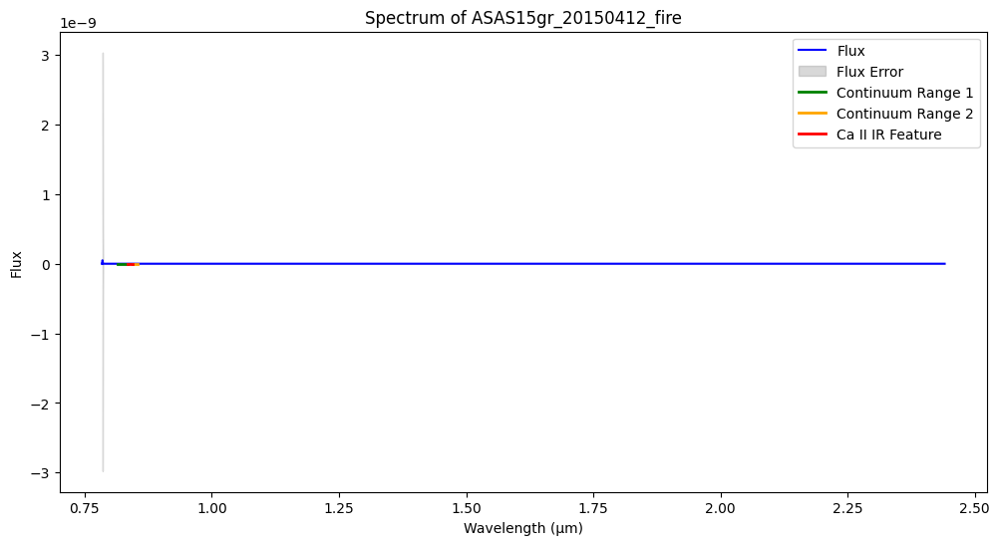

Pseudo-equivalent width for Ca II IR in ASAS15hf_20150602_fire: 0.00 Å
Velocity shift for Ca II IR in ASAS15hf_20150602_fire: -5103.46 km/s


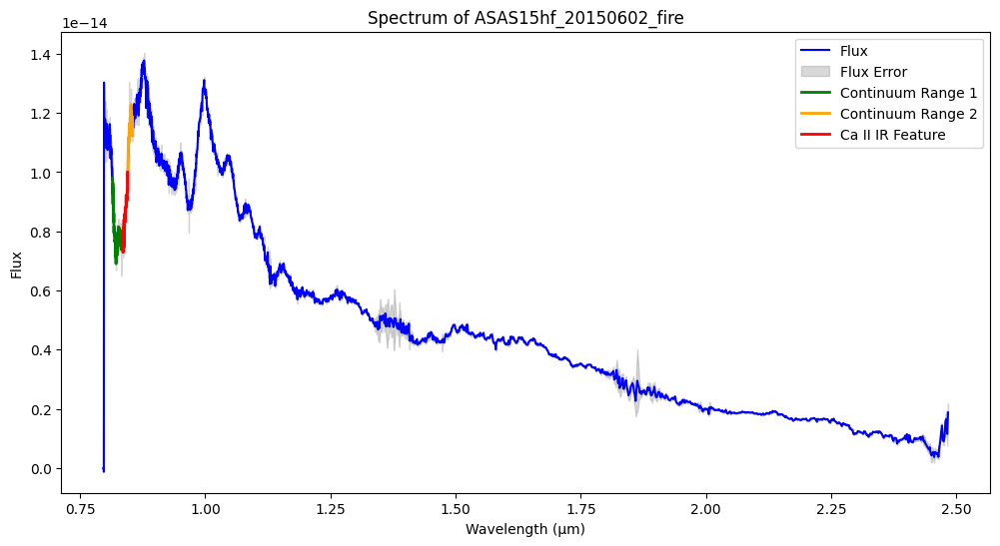

Pseudo-equivalent width for Ca II IR in ASAS15hx_20150601_fire: 0.01 Å
Velocity shift for Ca II IR in ASAS15hx_20150601_fire: -3658.18 km/s


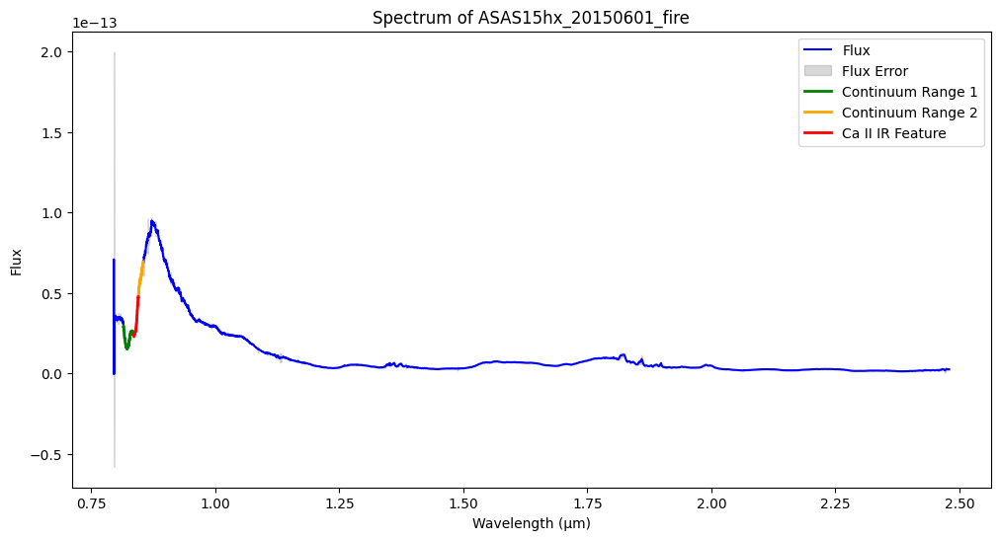

Pseudo-equivalent width for Ca II IR in CSP12G_20121203_fire: 0.01 Å
Velocity shift for Ca II IR in CSP12G_20121203_fire: -3883.11 km/s


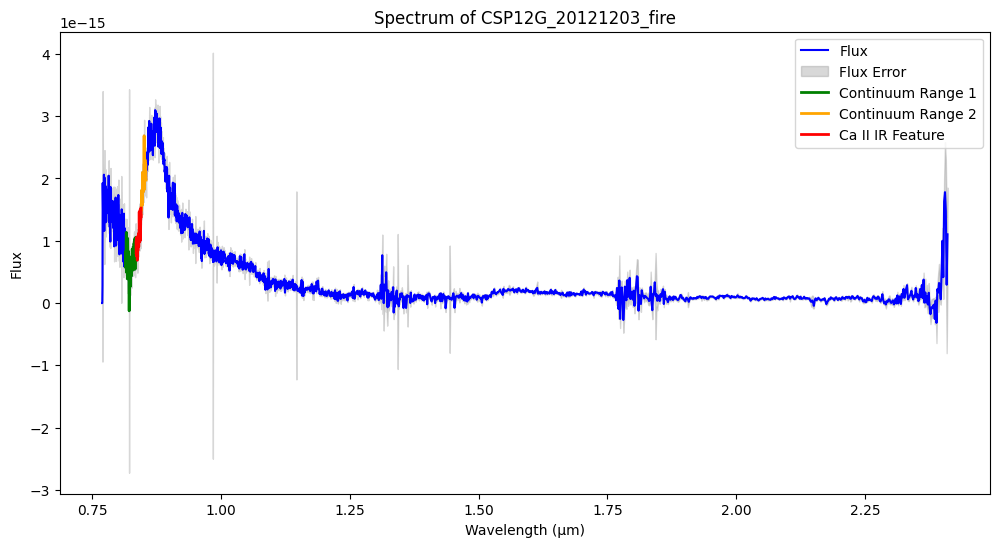

Pseudo-equivalent width for Ca II IR in LSQ11bk_20111218_fire: 0.00 Å
Velocity shift for Ca II IR in LSQ11bk_20111218_fire: -4986.30 km/s


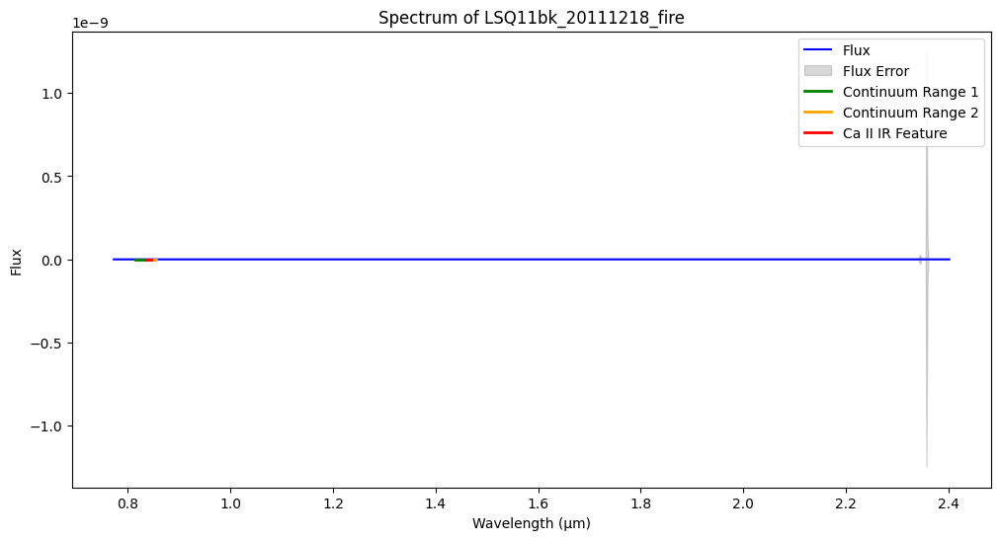

Pseudo-equivalent width for Ca II IR in LSQ11bk_20111221_fire: 0.01 Å
Velocity shift for Ca II IR in LSQ11bk_20111221_fire: -4512.75 km/s


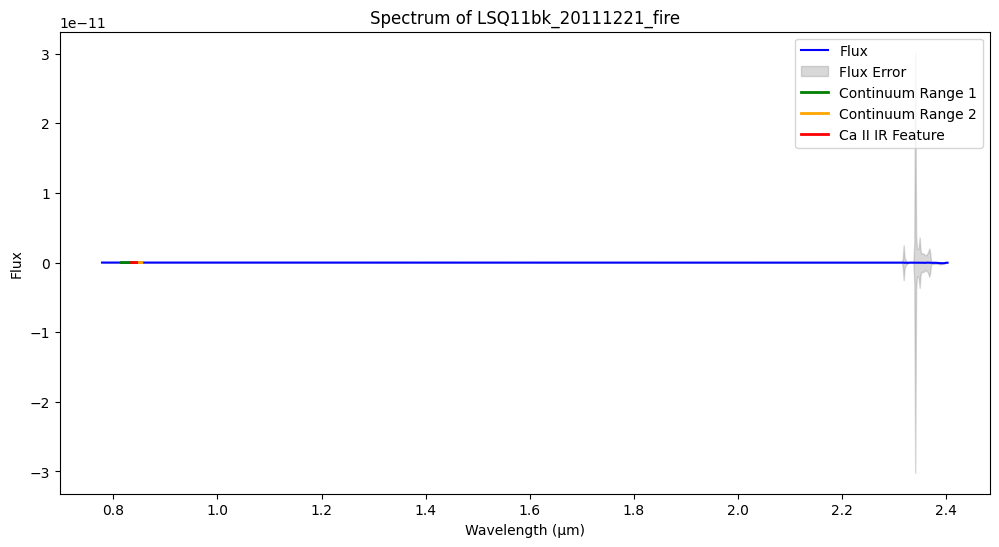

Pseudo-equivalent width for Ca II IR in LSQ11ot_20120115_fire: 0.01 Å
Velocity shift for Ca II IR in LSQ11ot_20120115_fire: -4062.48 km/s


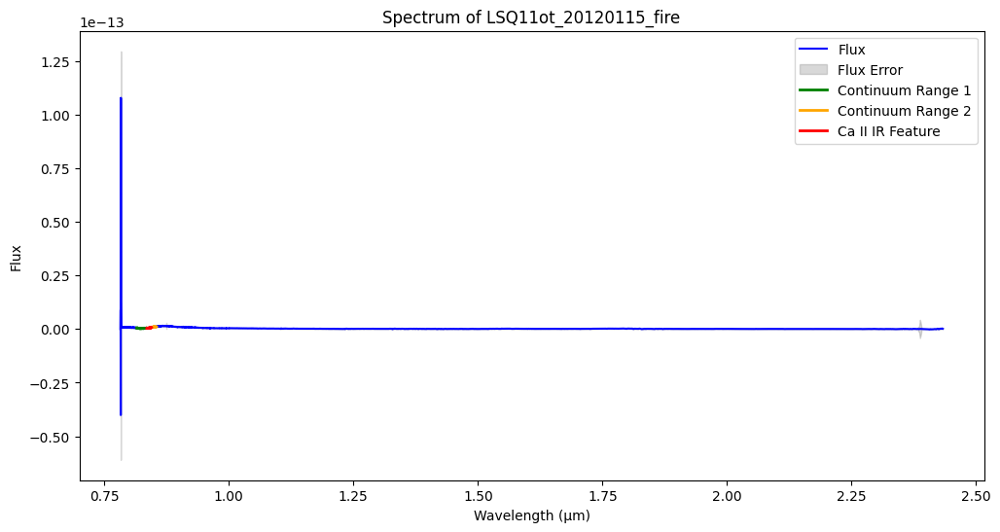

Pseudo-equivalent width for Ca II IR in LSQ11ot_20120203_fire: 0.01 Å
Velocity shift for Ca II IR in LSQ11ot_20120203_fire: -3464.07 km/s


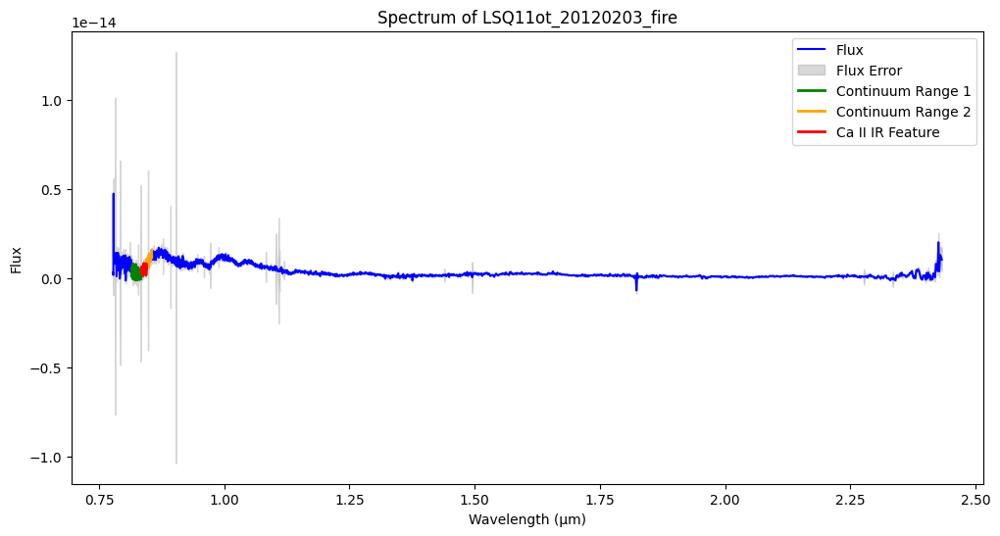

Pseudo-equivalent width for Ca II IR in LSQ11pn_20120116_fire: 0.01 Å
Velocity shift for Ca II IR in LSQ11pn_20120116_fire: -4236.30 km/s


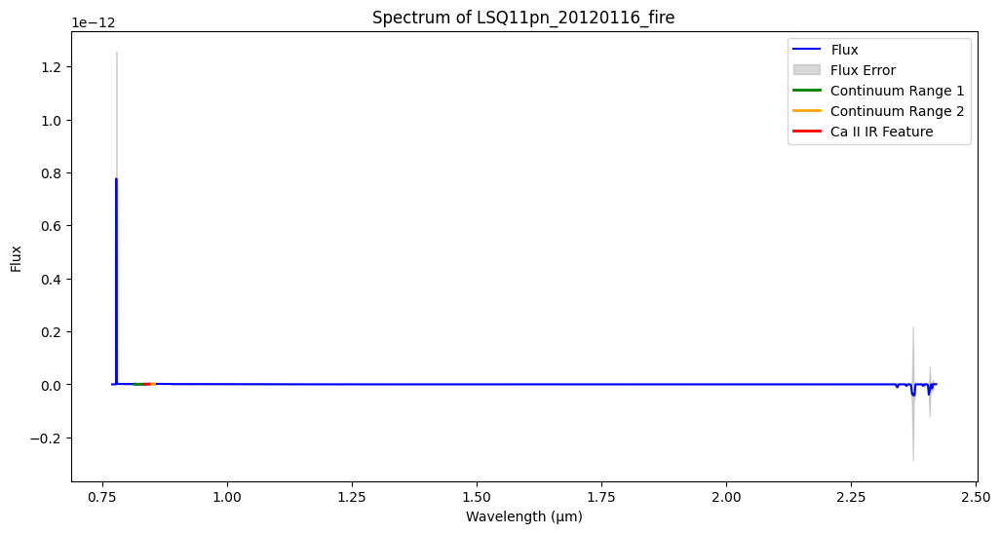

Pseudo-equivalent width for Ca II IR in LSQ12btn_20120419_fire: 0.01 Å
Velocity shift for Ca II IR in LSQ12btn_20120419_fire: -4260.56 km/s


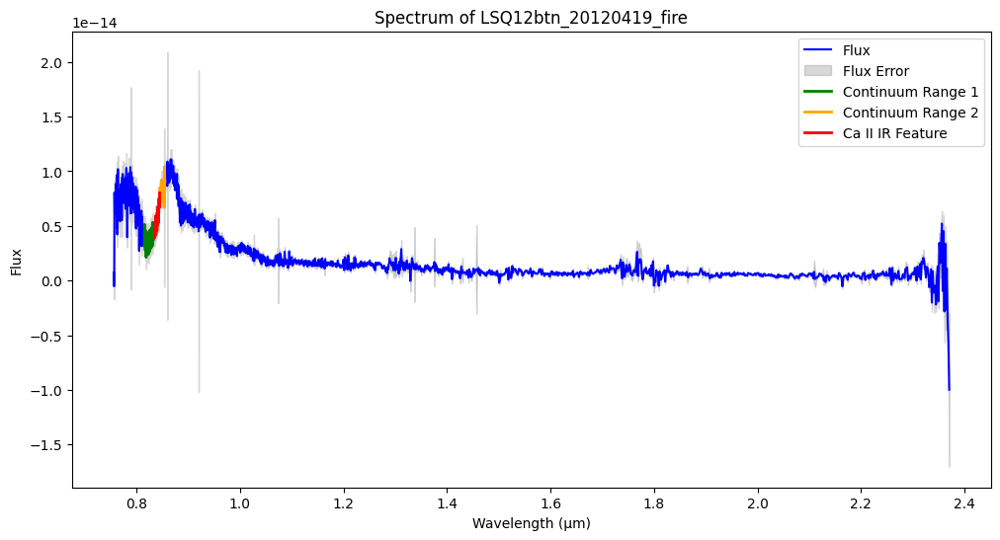

Pseudo-equivalent width for Ca II IR in LSQ12btn_20120430_fire: 0.01 Å
Velocity shift for Ca II IR in LSQ12btn_20120430_fire: -3920.09 km/s


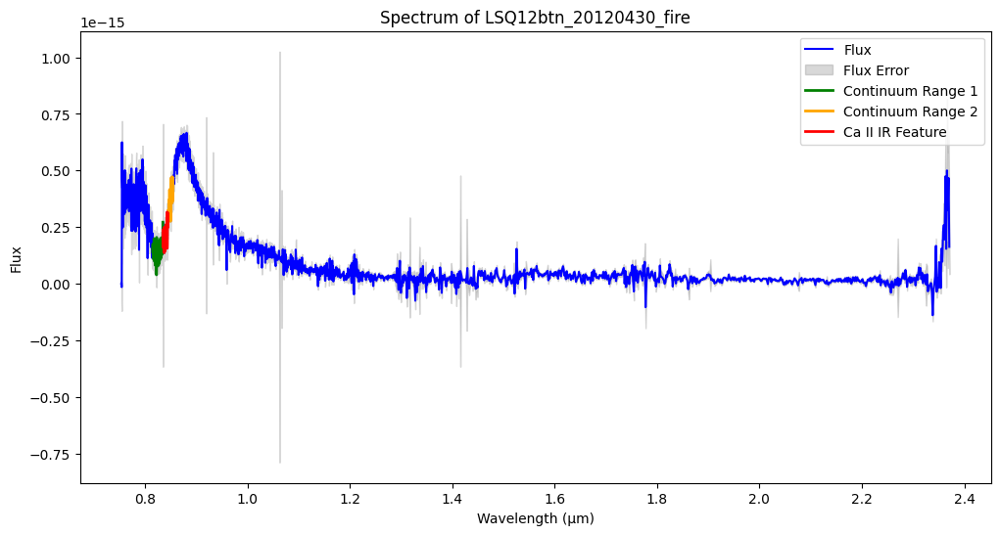

Pseudo-equivalent width for Ca II IR in LSQ12fuk_20121105_fire: 0.01 Å
Velocity shift for Ca II IR in LSQ12fuk_20121105_fire: -5150.53 km/s


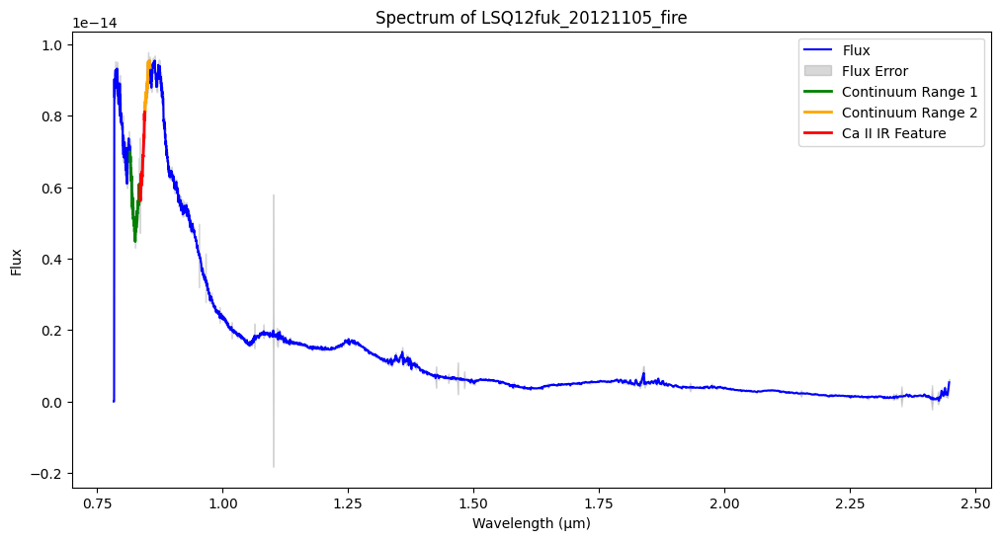

Pseudo-equivalent width for Ca II IR in LSQ12fuk_20121203_fire: 0.01 Å
Velocity shift for Ca II IR in LSQ12fuk_20121203_fire: -3533.29 km/s


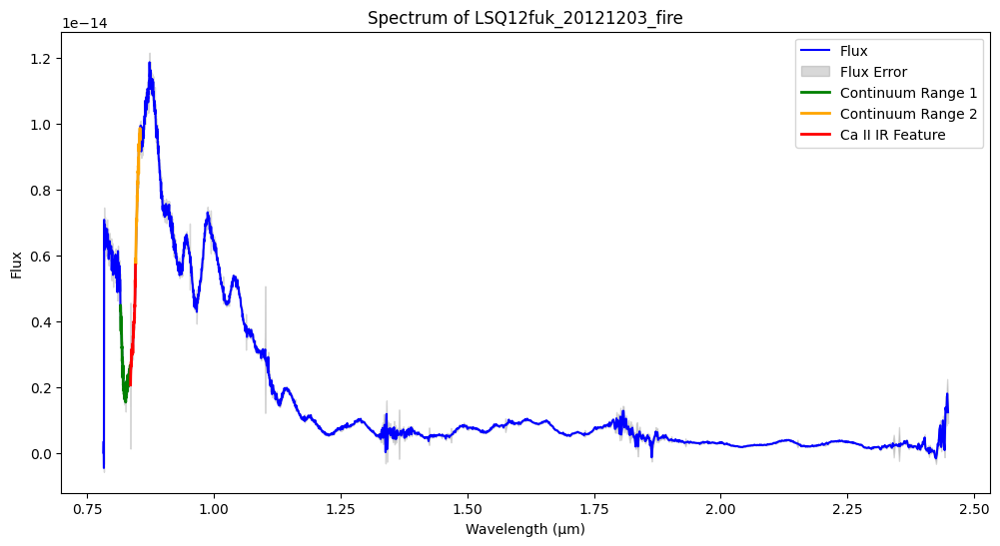

Pseudo-equivalent width for Ca II IR in LSQ12fxd_20121105_fire: 0.00 Å
Velocity shift for Ca II IR in LSQ12fxd_20121105_fire: -5971.77 km/s


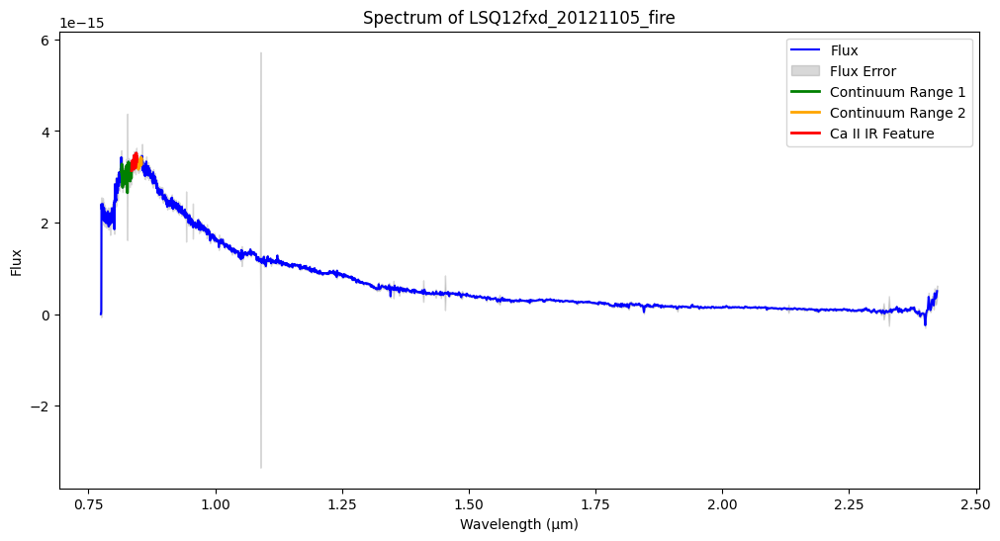

Pseudo-equivalent width for Ca II IR in LSQ12fxd_20121109_fire: 0.00 Å
Velocity shift for Ca II IR in LSQ12fxd_20121109_fire: -6056.05 km/s


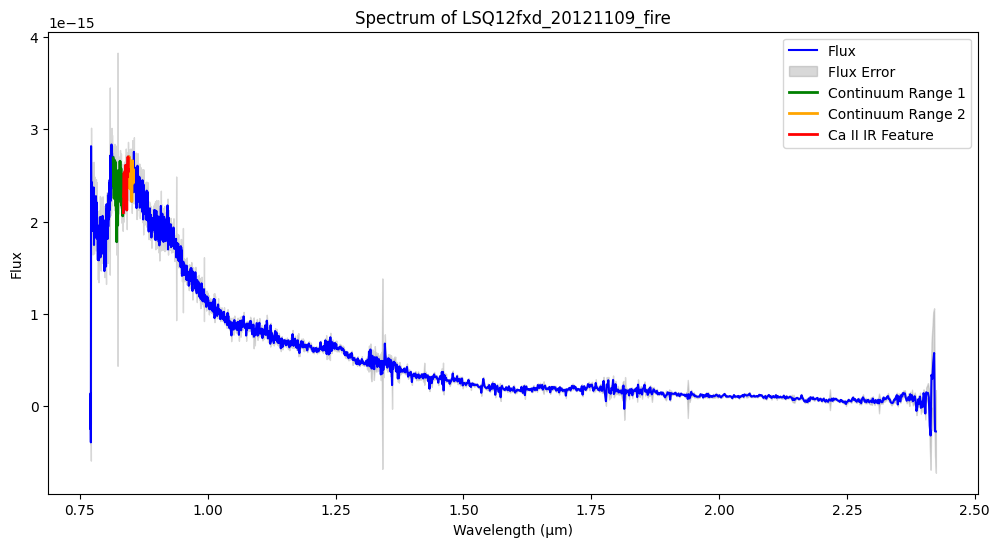

Pseudo-equivalent width for Ca II IR in LSQ12fxd_20121111_fire: 0.00 Å
Velocity shift for Ca II IR in LSQ12fxd_20121111_fire: -6144.02 km/s


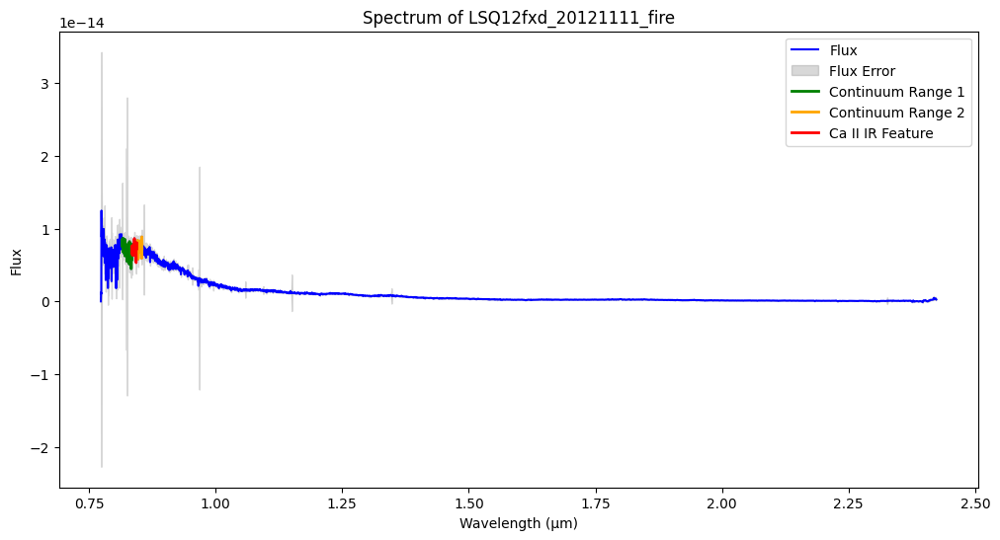

Pseudo-equivalent width for Ca II IR in LSQ12fxd_20121119_fire: 0.01 Å
Velocity shift for Ca II IR in LSQ12fxd_20121119_fire: -5029.31 km/s


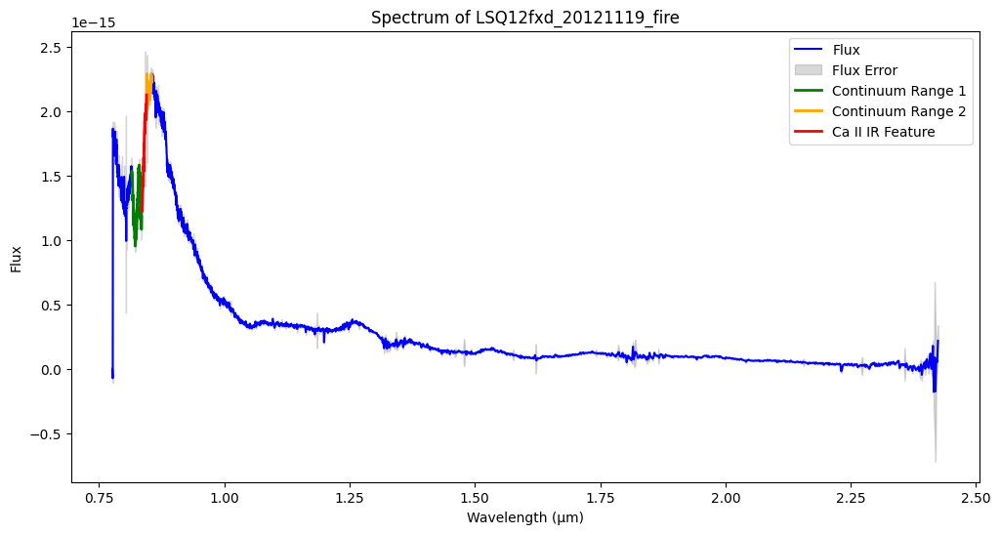

Pseudo-equivalent width for Ca II IR in LSQ12fxd_20121125_fire: 0.01 Å
Velocity shift for Ca II IR in LSQ12fxd_20121125_fire: -4238.28 km/s


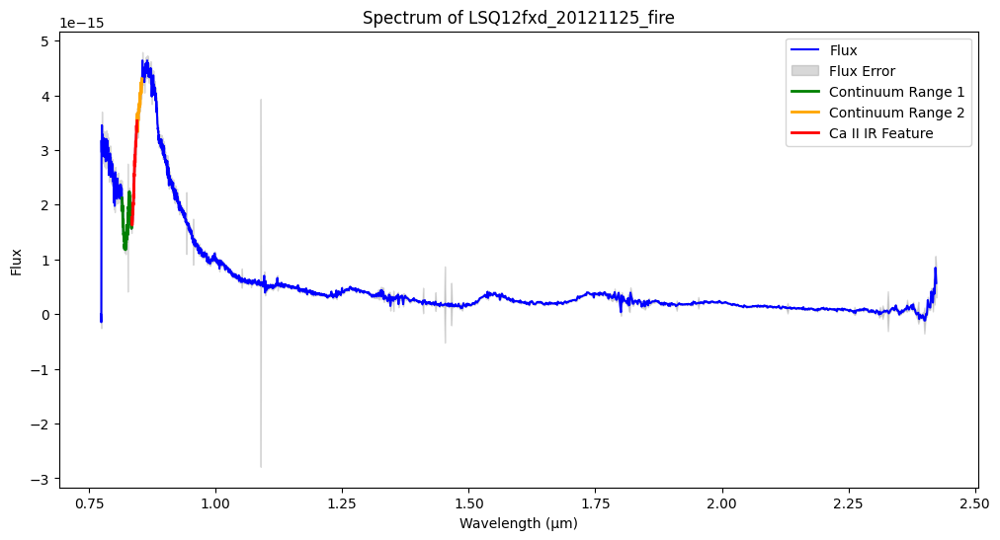

Pseudo-equivalent width for Ca II IR in LSQ12fxd_20121203_fire: 0.01 Å
Velocity shift for Ca II IR in LSQ12fxd_20121203_fire: -3691.74 km/s


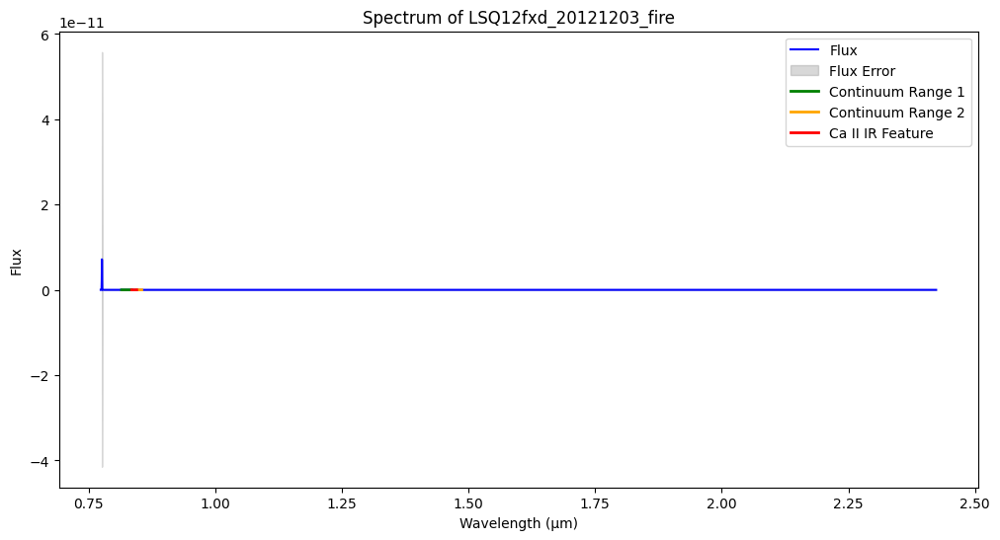

Pseudo-equivalent width for Ca II IR in LSQ12fxd_20130103_fire: 0.01 Å
Velocity shift for Ca II IR in LSQ12fxd_20130103_fire: -2990.45 km/s


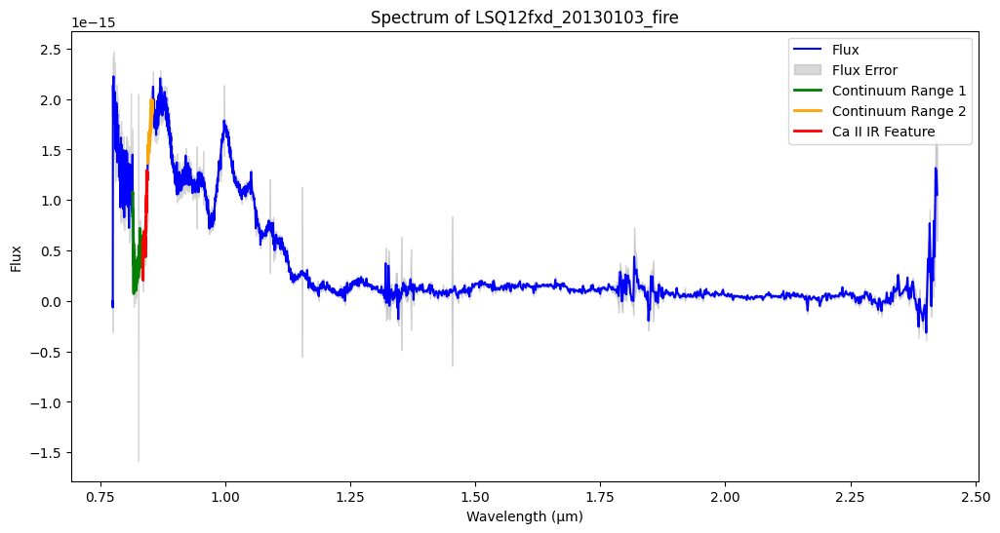

Pseudo-equivalent width for Ca II IR in LSQ12gdj_20121119_fire: -0.00 Å
Velocity shift for Ca II IR in LSQ12gdj_20121119_fire: -6492.41 km/s


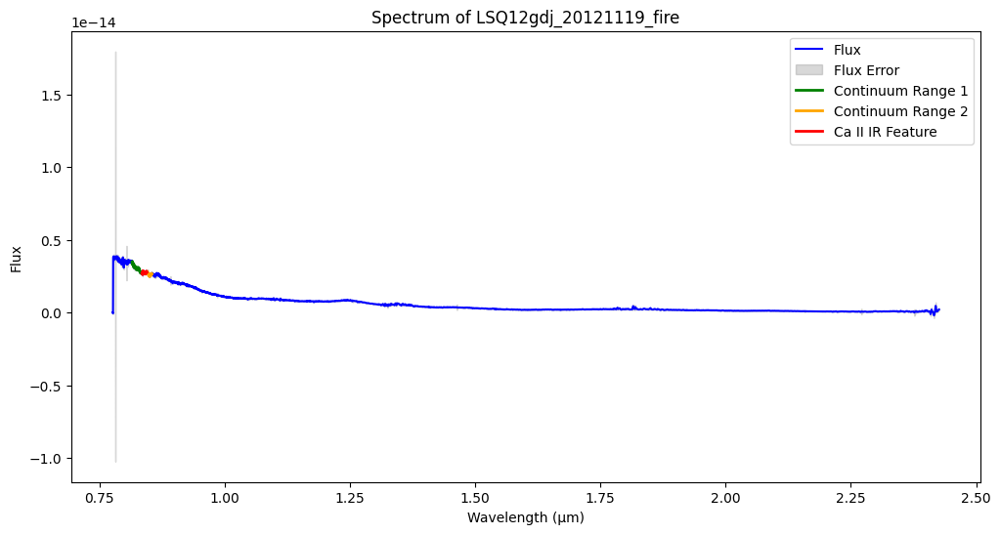

Pseudo-equivalent width for Ca II IR in LSQ12gdj_20121125_fire: 0.00 Å
Velocity shift for Ca II IR in LSQ12gdj_20121125_fire: -5957.04 km/s


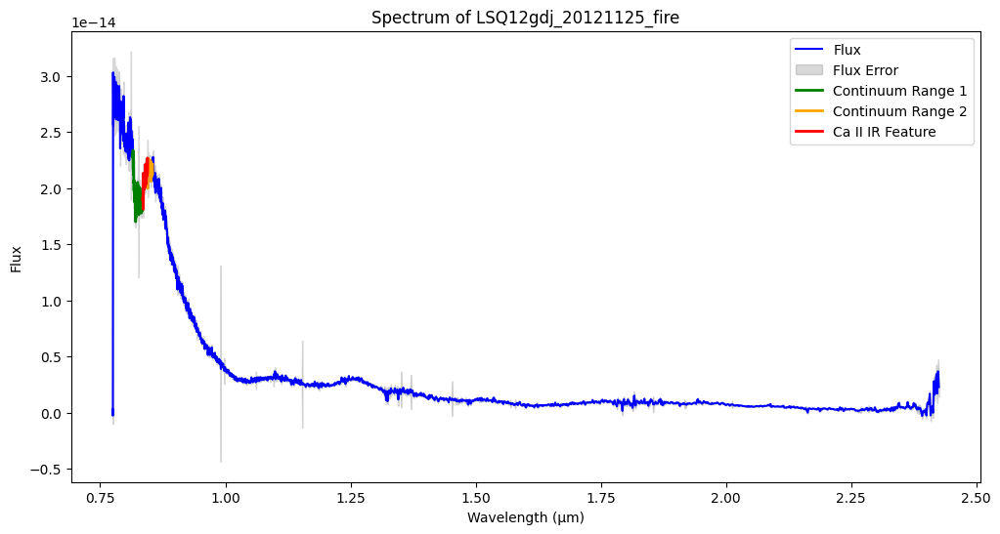

Pseudo-equivalent width for Ca II IR in LSQ12gdj_20121203_fire: 0.01 Å
Velocity shift for Ca II IR in LSQ12gdj_20121203_fire: -4818.05 km/s


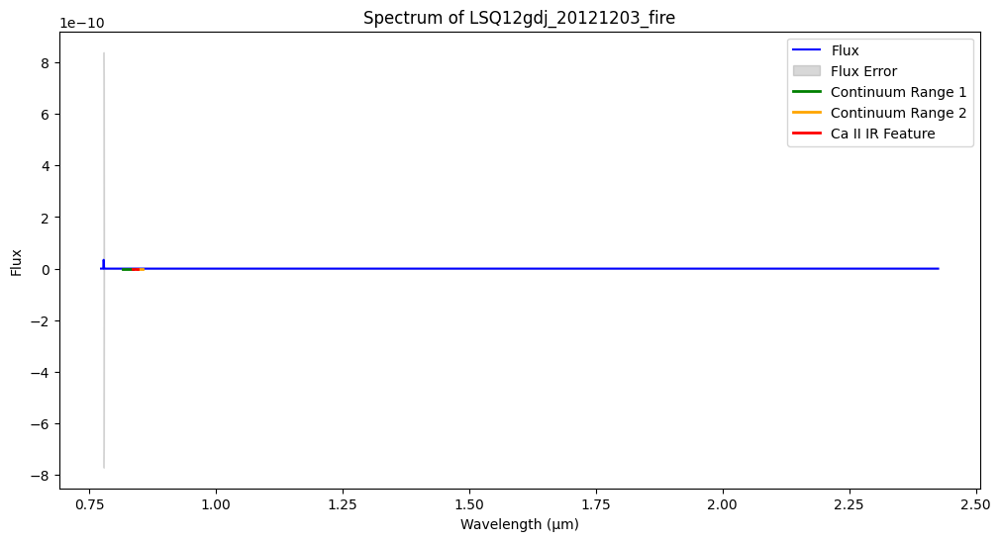

Pseudo-equivalent width for Ca II IR in LSQ12gdj_20121227_fire: 0.01 Å
Velocity shift for Ca II IR in LSQ12gdj_20121227_fire: -4378.80 km/s


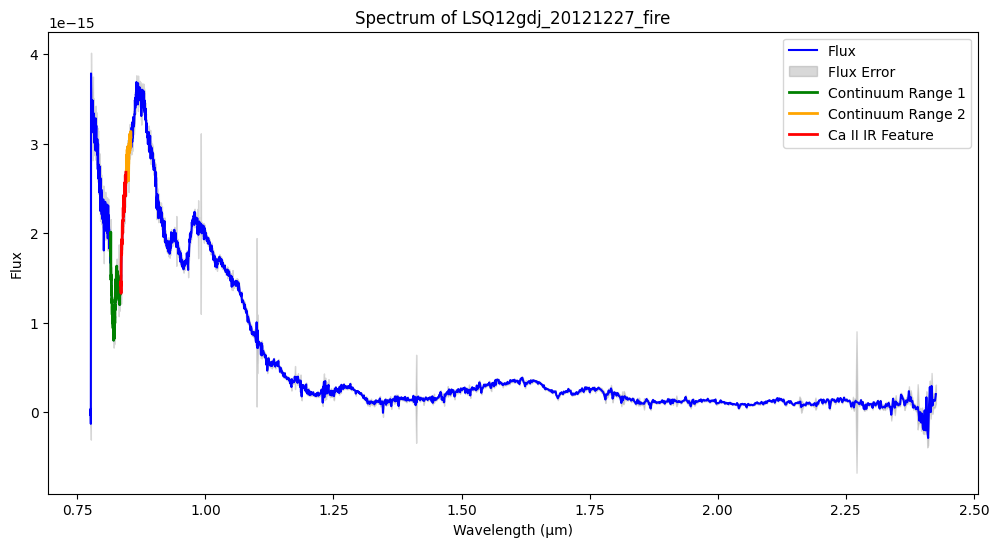

Pseudo-equivalent width for Ca II IR in LSQ12gdj_20130103_fire: 0.01 Å
Velocity shift for Ca II IR in LSQ12gdj_20130103_fire: -4324.51 km/s


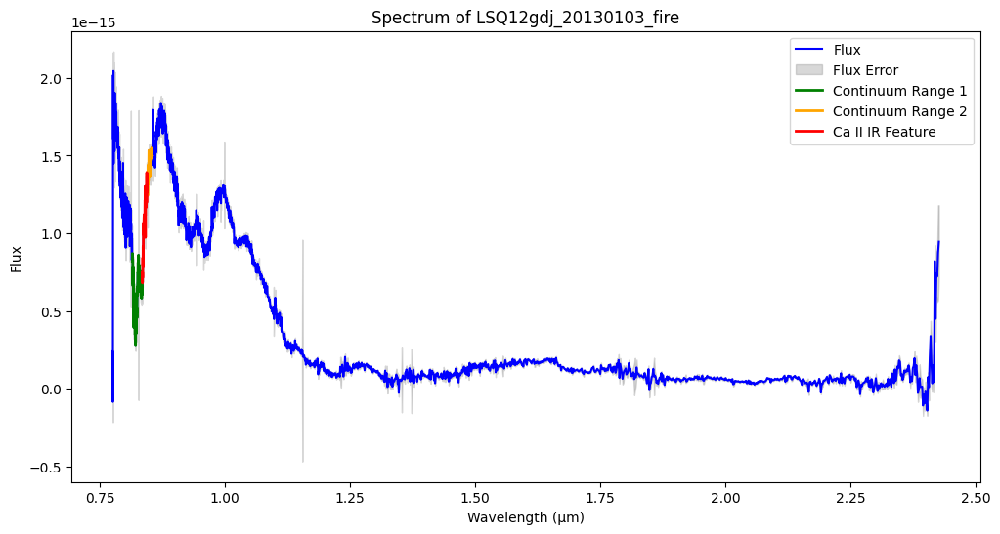

Pseudo-equivalent width for Ca II IR in LSQ12hzj_20130106_fire: 0.00 Å
Velocity shift for Ca II IR in LSQ12hzj_20130106_fire: -6048.51 km/s


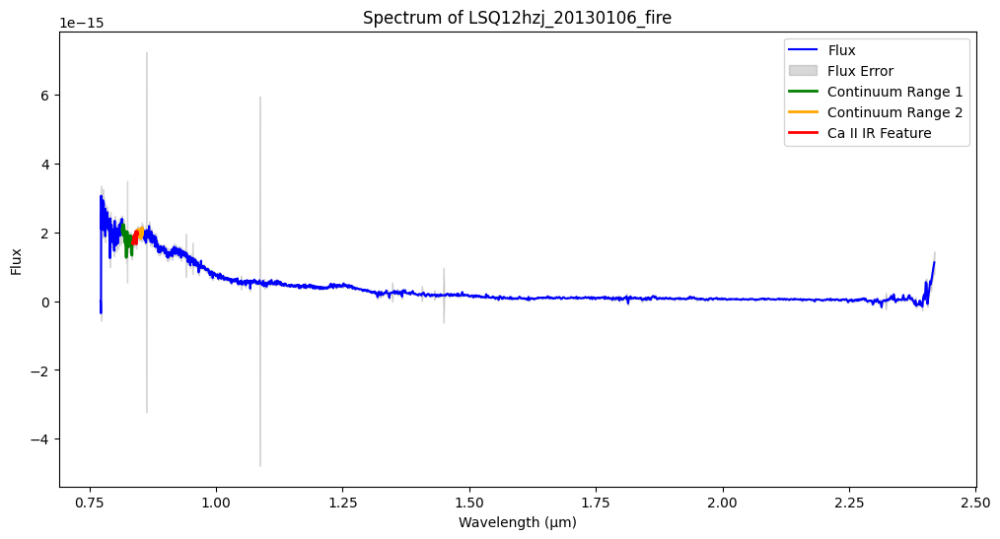

Pseudo-equivalent width for Ca II IR in LSQ13aiz_20130519_fire: 0.00 Å
Velocity shift for Ca II IR in LSQ13aiz_20130519_fire: -4575.65 km/s


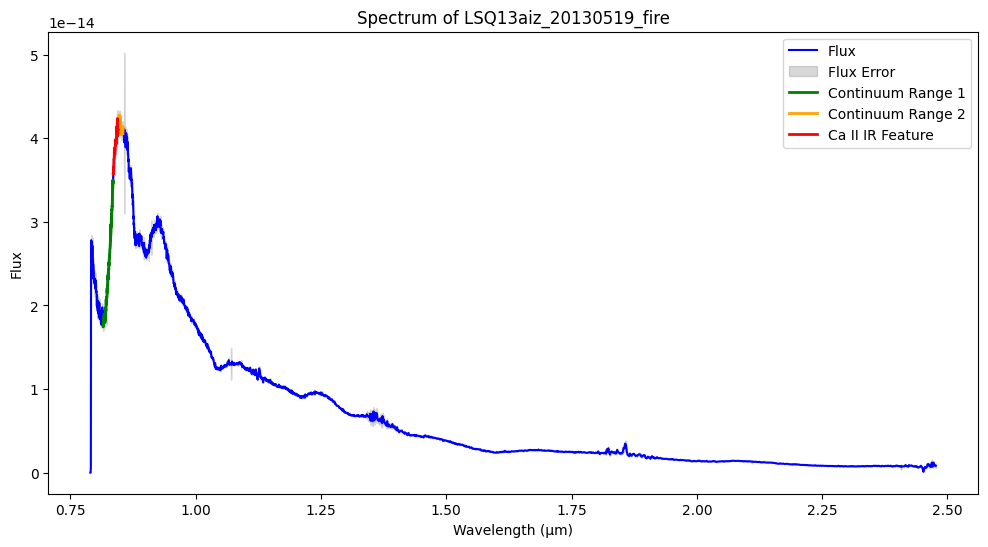

Pseudo-equivalent width for Ca II IR in LSQ13aiz_20130716_fire: 0.02 Å
Velocity shift for Ca II IR in LSQ13aiz_20130716_fire: -1593.88 km/s


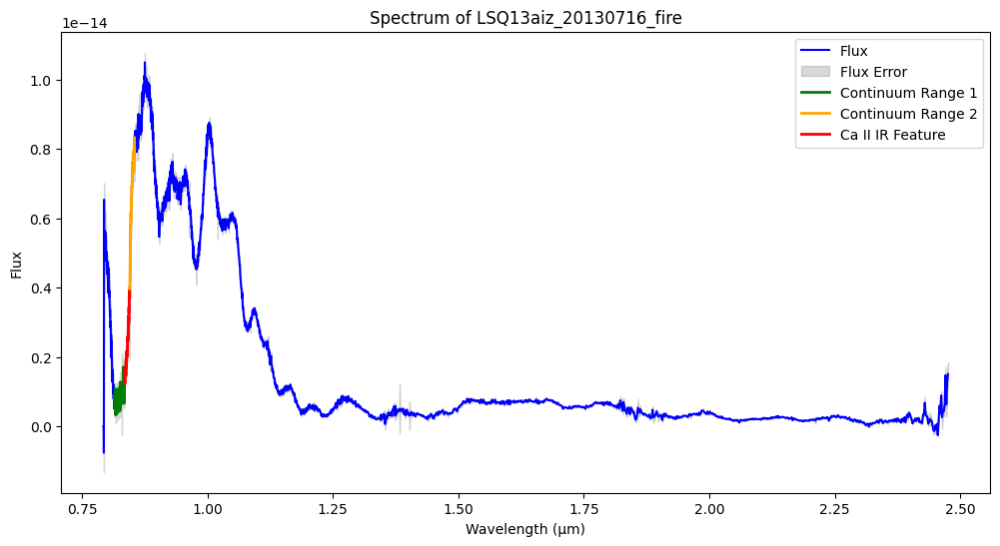

Pseudo-equivalent width for Ca II IR in LSQ13dsm_20140101_fire: 0.00 Å
Velocity shift for Ca II IR in LSQ13dsm_20140101_fire: -5041.39 km/s


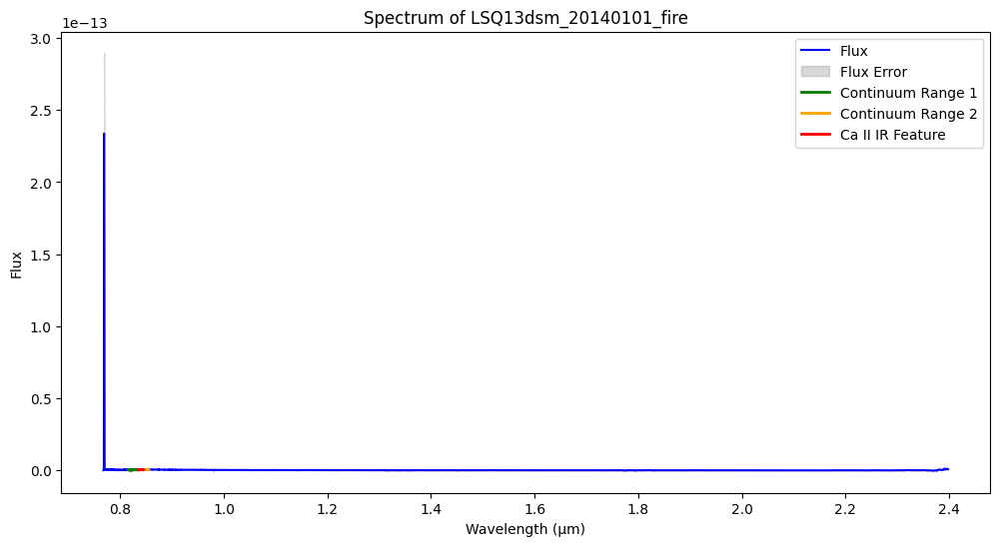

Pseudo-equivalent width for Ca II IR in LSQ13dsm_20140109_fire: 0.00 Å
Velocity shift for Ca II IR in LSQ13dsm_20140109_fire: -5544.69 km/s


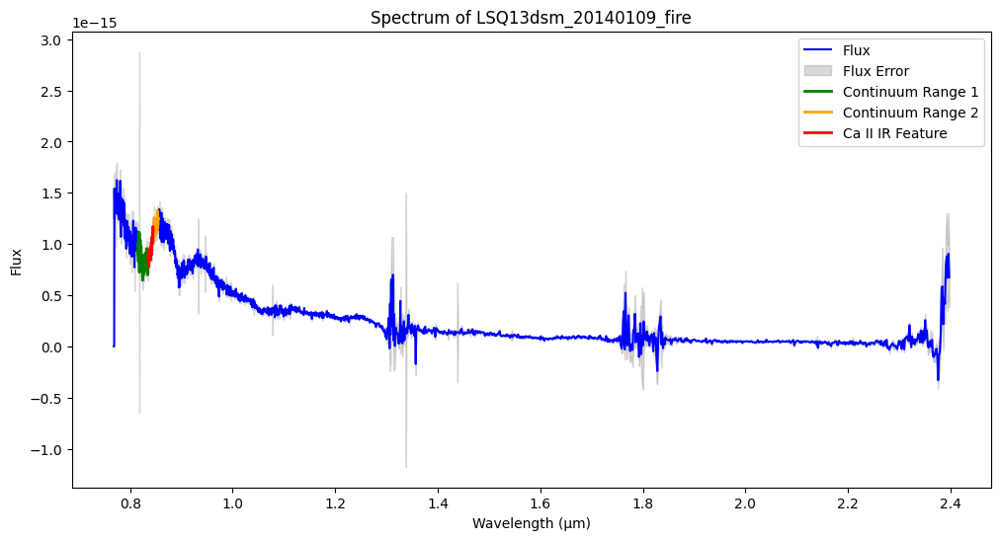

Pseudo-equivalent width for Ca II IR in LSQ13dsm_20140114_fire: 0.01 Å
Velocity shift for Ca II IR in LSQ13dsm_20140114_fire: -5120.50 km/s


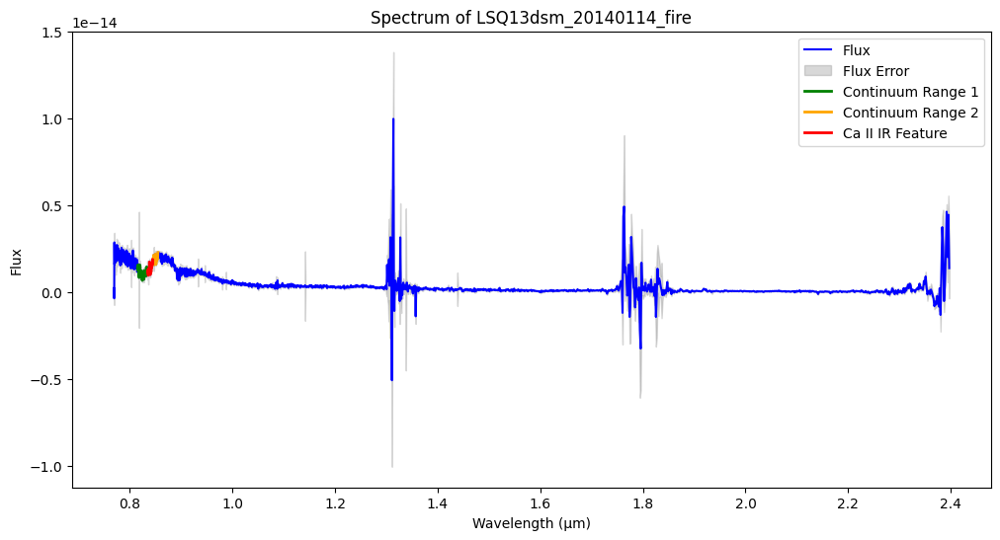

Pseudo-equivalent width for Ca II IR in LSQ13pf_20130325_fire: 0.01 Å
Velocity shift for Ca II IR in LSQ13pf_20130325_fire: -3459.67 km/s


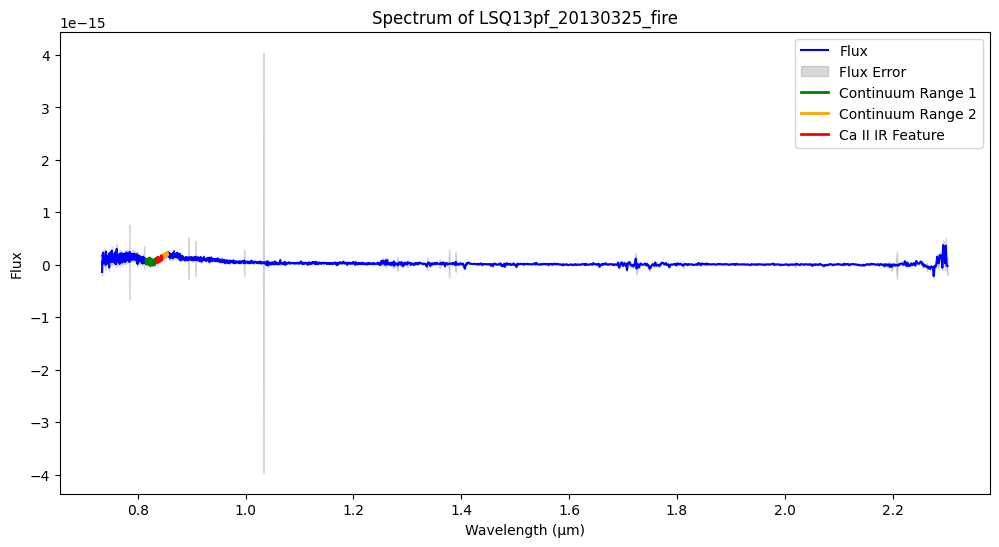

Pseudo-equivalent width for Ca II IR in LSQ13ry_20130401_fire: 0.00 Å
Velocity shift for Ca II IR in LSQ13ry_20130401_fire: -5034.19 km/s


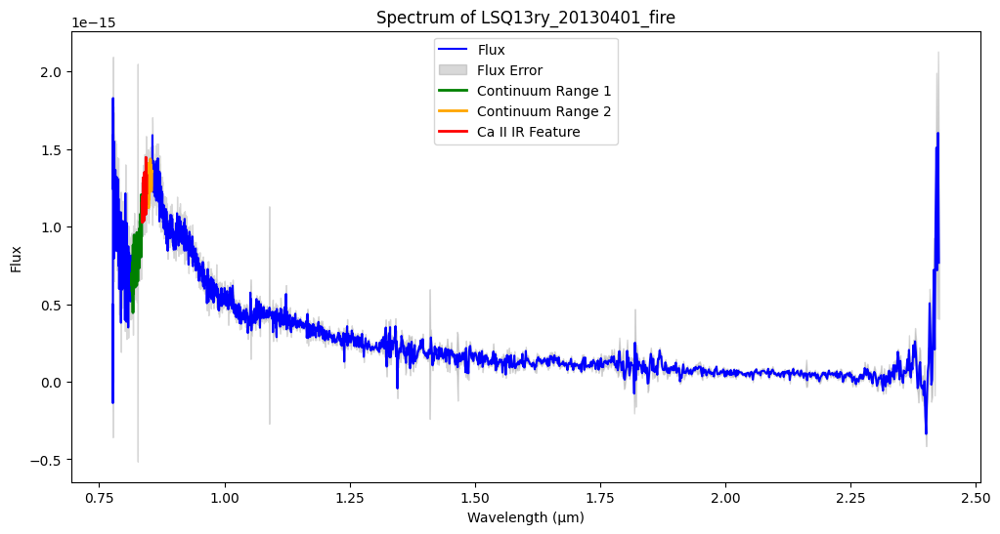

Pseudo-equivalent width for Ca II IR in LSQ13ry_20130404_fire: 0.00 Å
Velocity shift for Ca II IR in LSQ13ry_20130404_fire: -5498.42 km/s


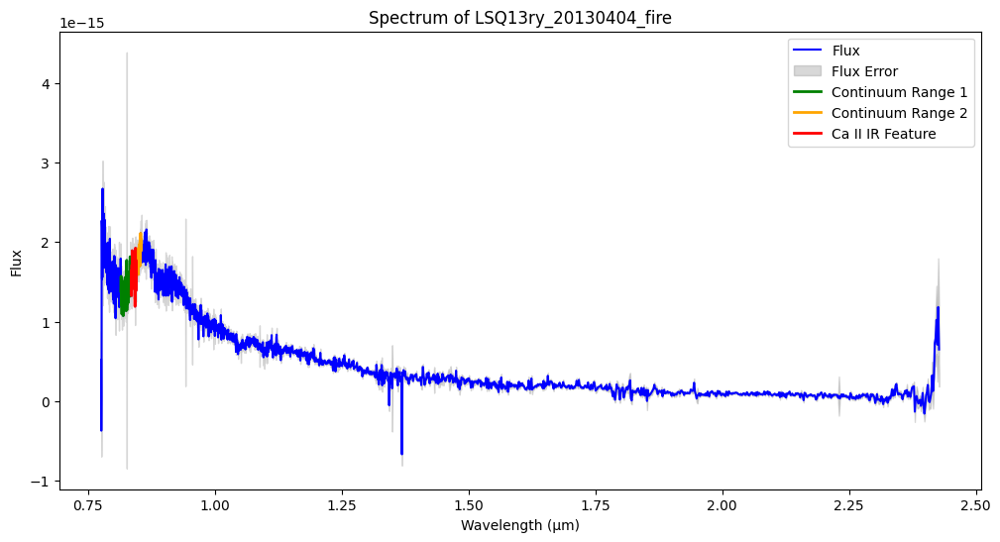

Pseudo-equivalent width for Ca II IR in LSQ14ajn_20140318_fire: 0.01 Å
Velocity shift for Ca II IR in LSQ14ajn_20140318_fire: -4306.56 km/s


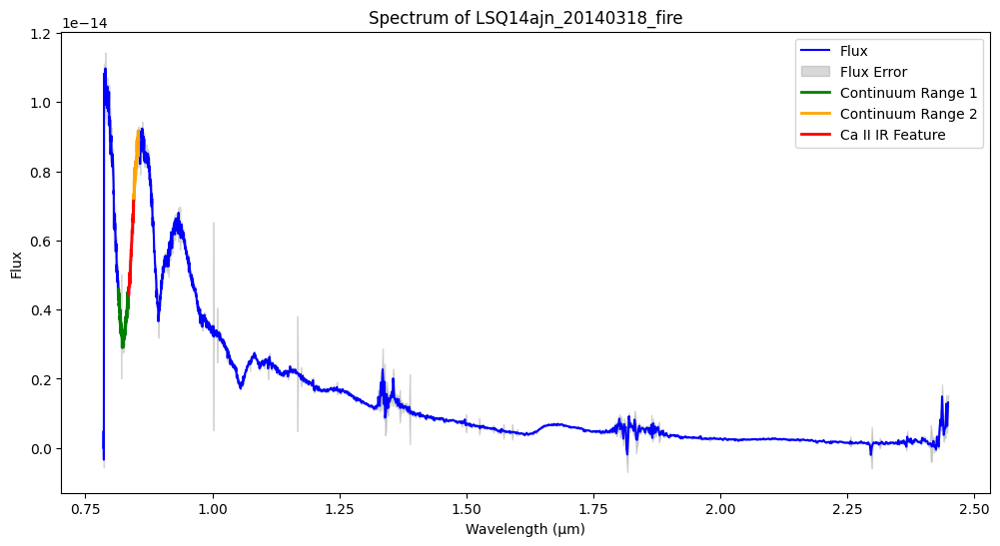

Pseudo-equivalent width for Ca II IR in LSQ14ajn_20140325_fire: 0.01 Å
Velocity shift for Ca II IR in LSQ14ajn_20140325_fire: -3747.31 km/s


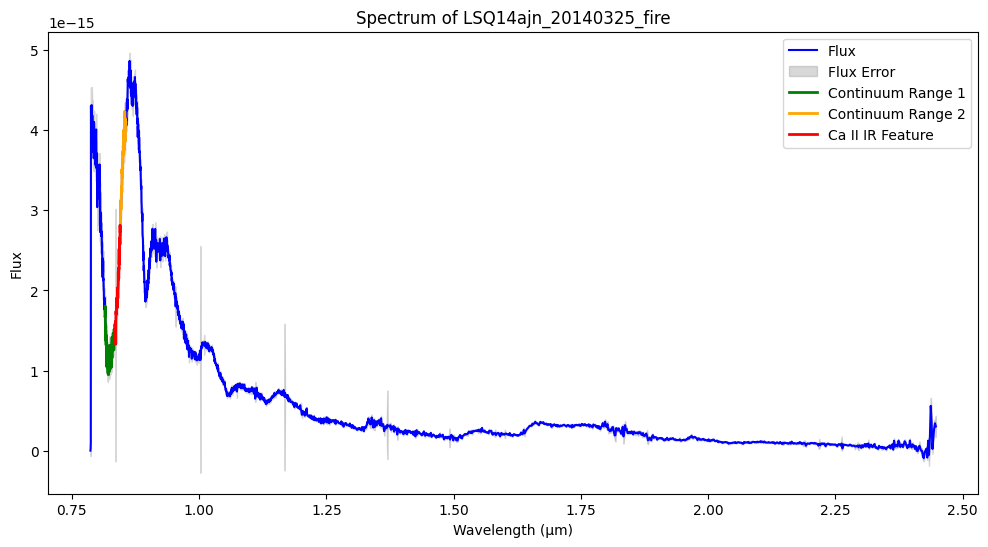

Pseudo-equivalent width for Ca II IR in LSQ14xi_20140227_fire: 0.00 Å
Velocity shift for Ca II IR in LSQ14xi_20140227_fire: -5960.29 km/s


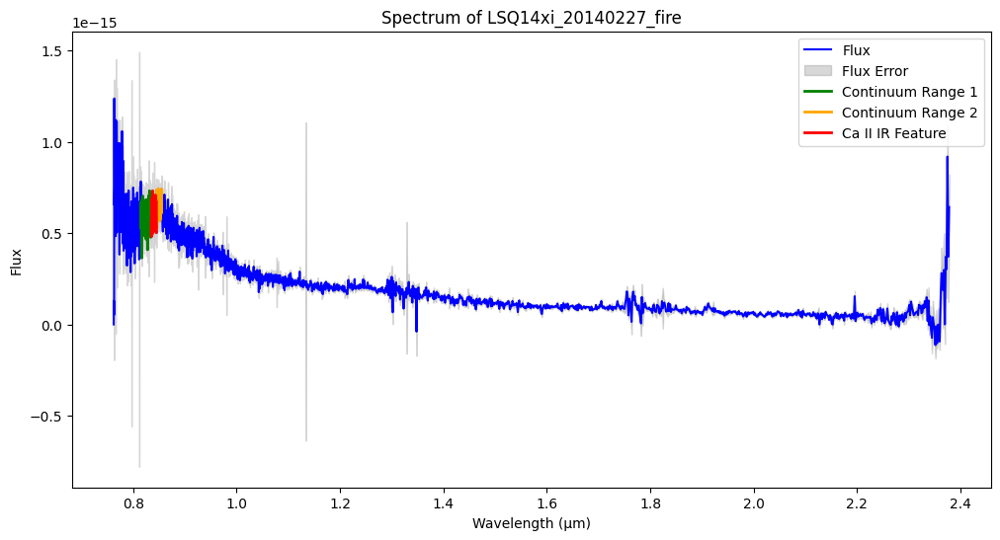

Pseudo-equivalent width for Ca II IR in LSQ15aae_20150602_fire: 0.01 Å
Velocity shift for Ca II IR in LSQ15aae_20150602_fire: -3658.43 km/s


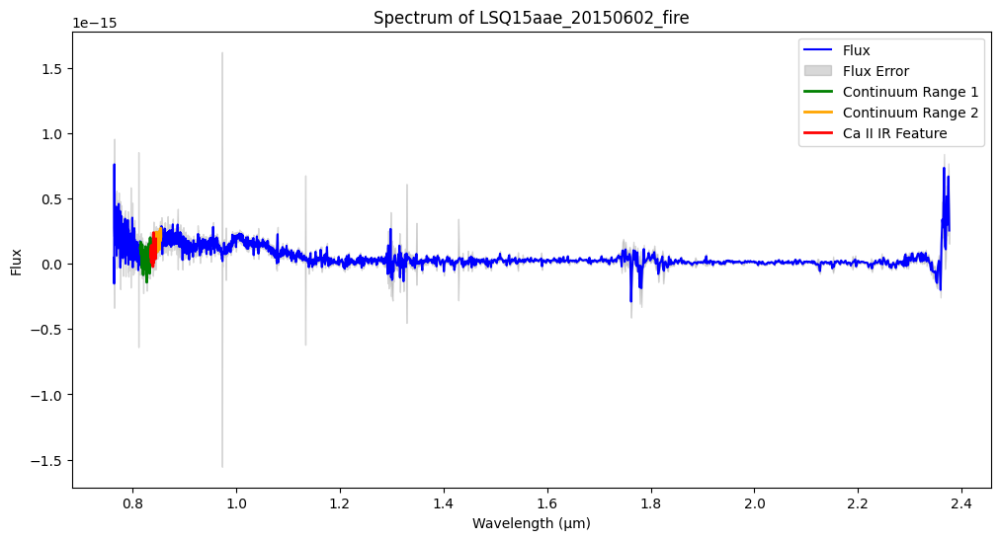

Pseudo-equivalent width for Ca II IR in CSP13abm_20140101_fire: 0.00 Å
Velocity shift for Ca II IR in CSP13abm_20140101_fire: -4826.34 km/s


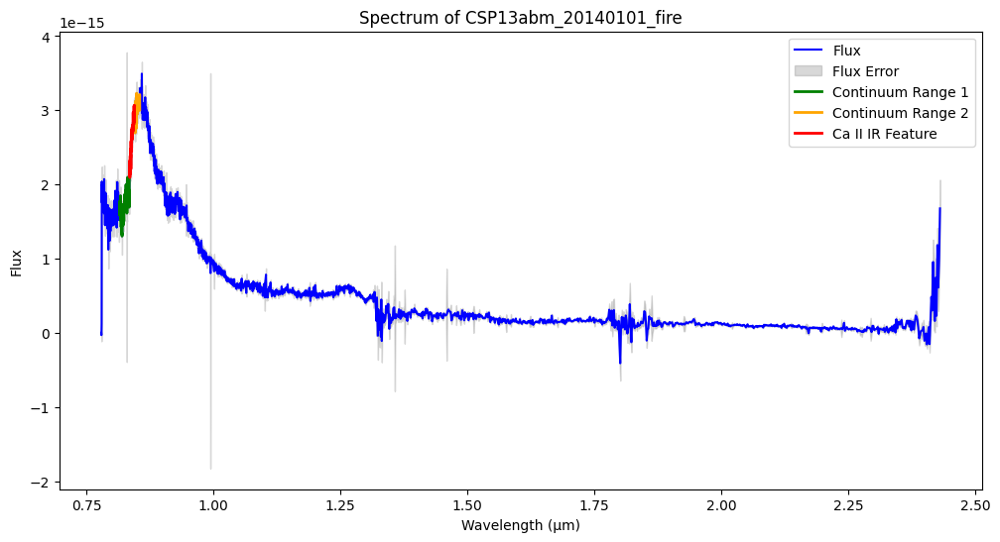

Pseudo-equivalent width for Ca II IR in CSP13abm_20140109_fire: 0.01 Å
Velocity shift for Ca II IR in CSP13abm_20140109_fire: -3574.41 km/s


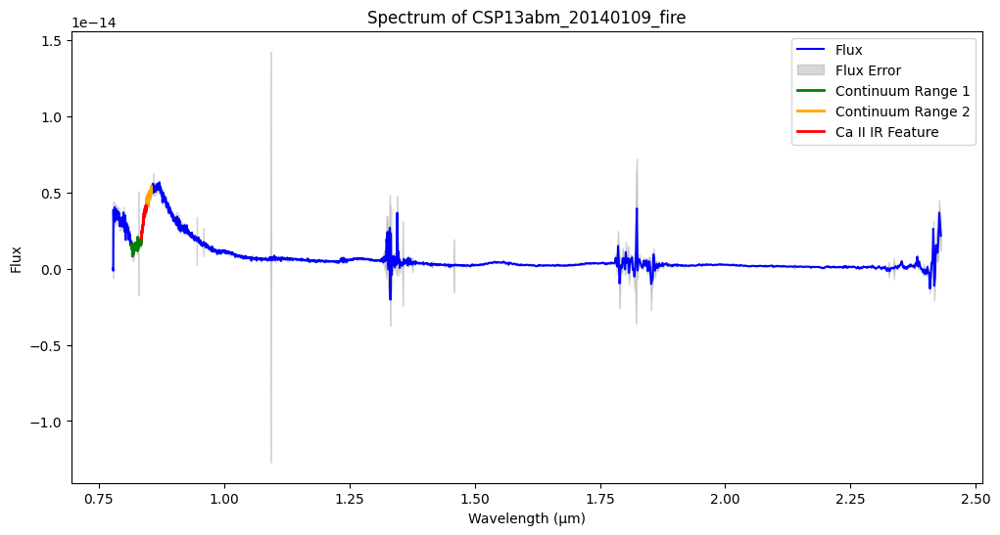

Pseudo-equivalent width for Ca II IR in CSP13abm_20140114_fire: 0.01 Å
Velocity shift for Ca II IR in CSP13abm_20140114_fire: -3502.34 km/s


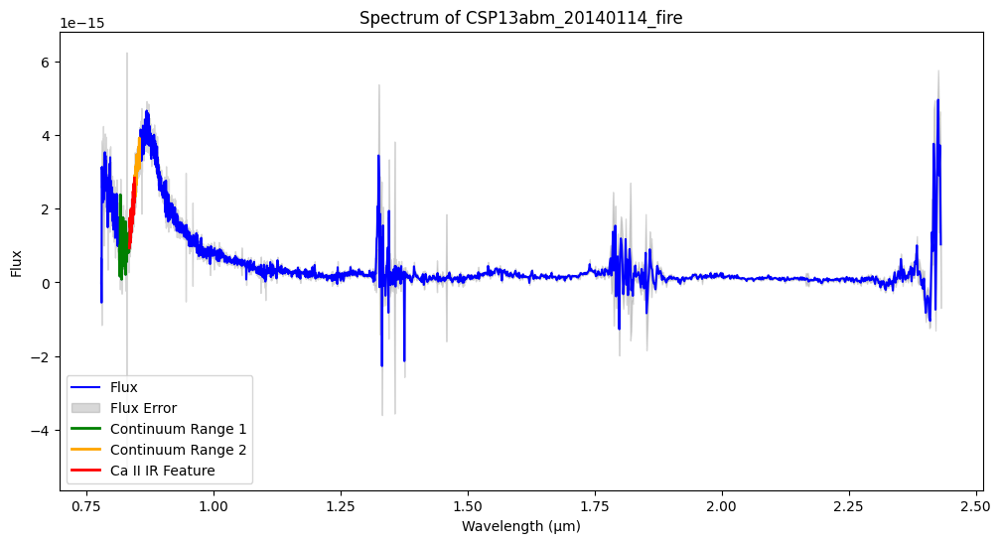

Pseudo-equivalent width for Ca II IR in CSP14aaq_20140227_fire: -0.00 Å
Velocity shift for Ca II IR in CSP14aaq_20140227_fire: -6244.94 km/s


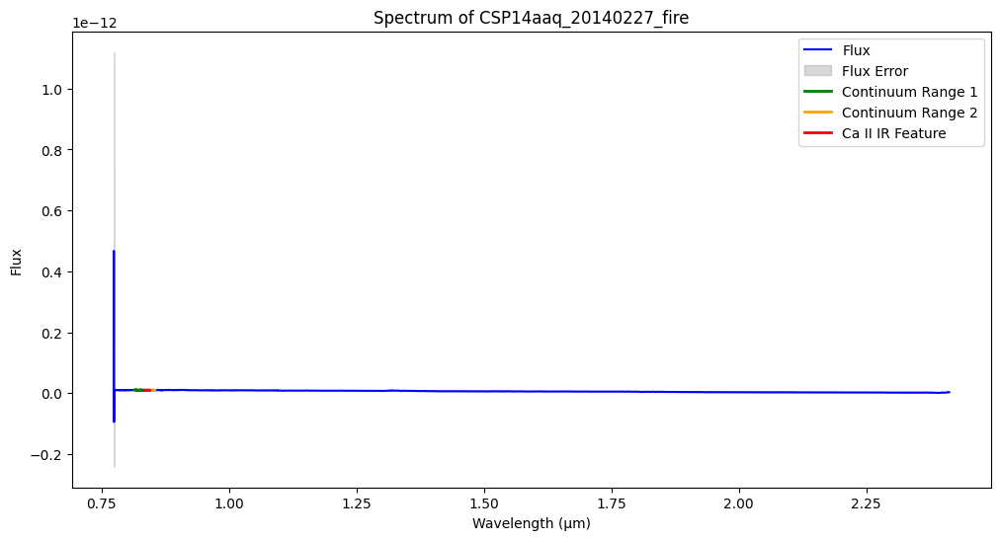

Pseudo-equivalent width for Ca II IR in PS1-14ra_20140310_fire: 0.01 Å
Velocity shift for Ca II IR in PS1-14ra_20140310_fire: -4474.50 km/s


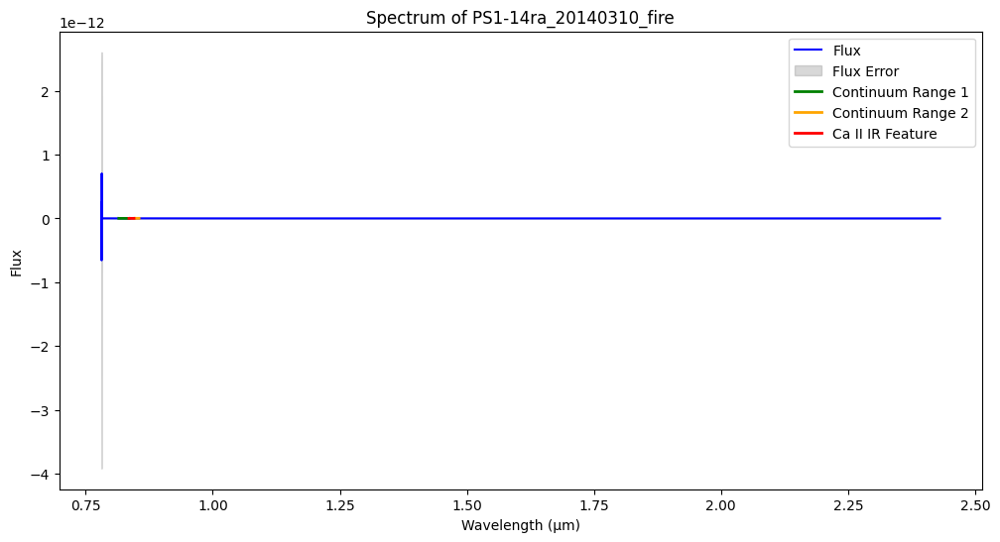

Pseudo-equivalent width for Ca II IR in PS1-14ra_20140318_fire: 0.01 Å
Velocity shift for Ca II IR in PS1-14ra_20140318_fire: -4132.71 km/s


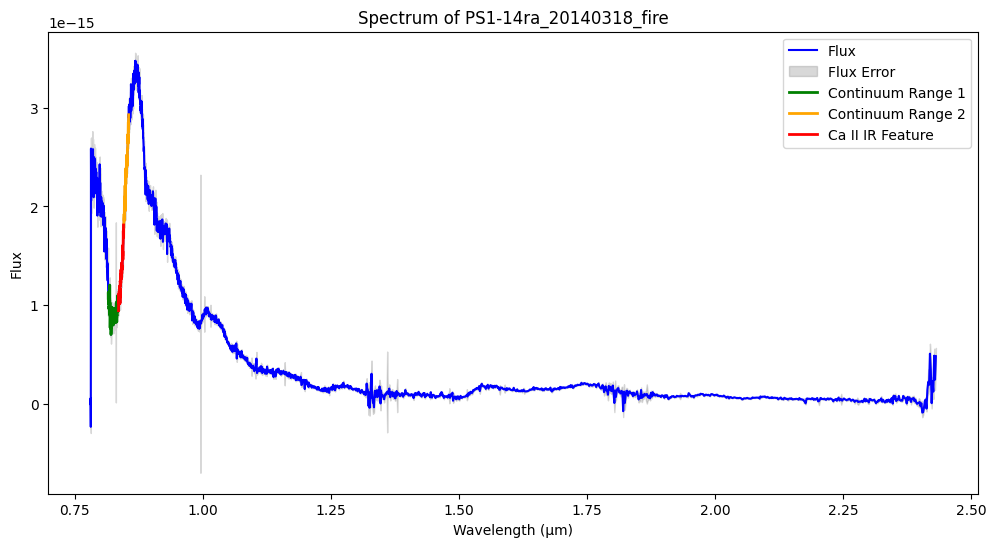

Pseudo-equivalent width for Ca II IR in PS1-14ra_20140325_fire: 0.01 Å
Velocity shift for Ca II IR in PS1-14ra_20140325_fire: -3870.68 km/s


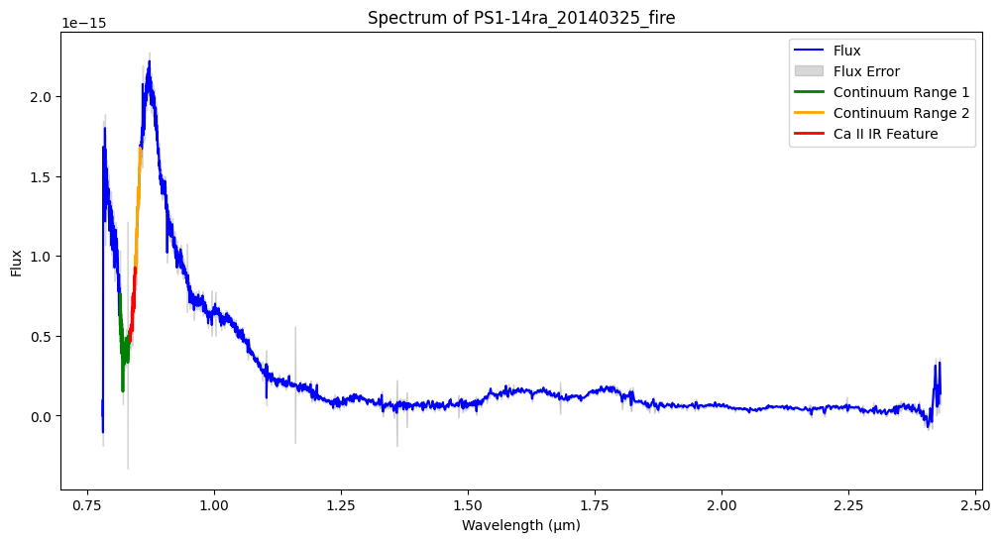

Pseudo-equivalent width for Ca II IR in PS15sv_20150402_fire: 0.00 Å
Velocity shift for Ca II IR in PS15sv_20150402_fire: -6003.74 km/s


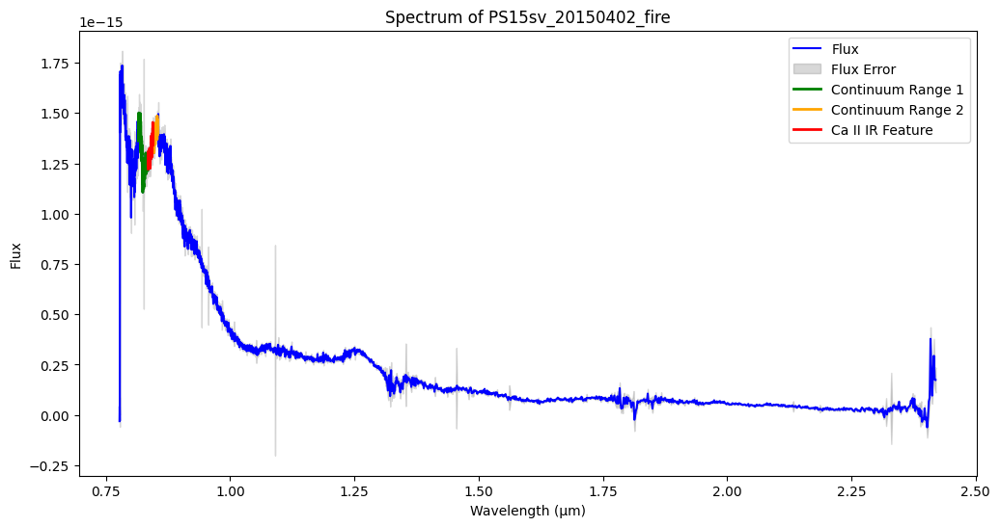

Pseudo-equivalent width for Ca II IR in PS15sv_20150407_fire: 0.00 Å
Velocity shift for Ca II IR in PS15sv_20150407_fire: -5514.66 km/s


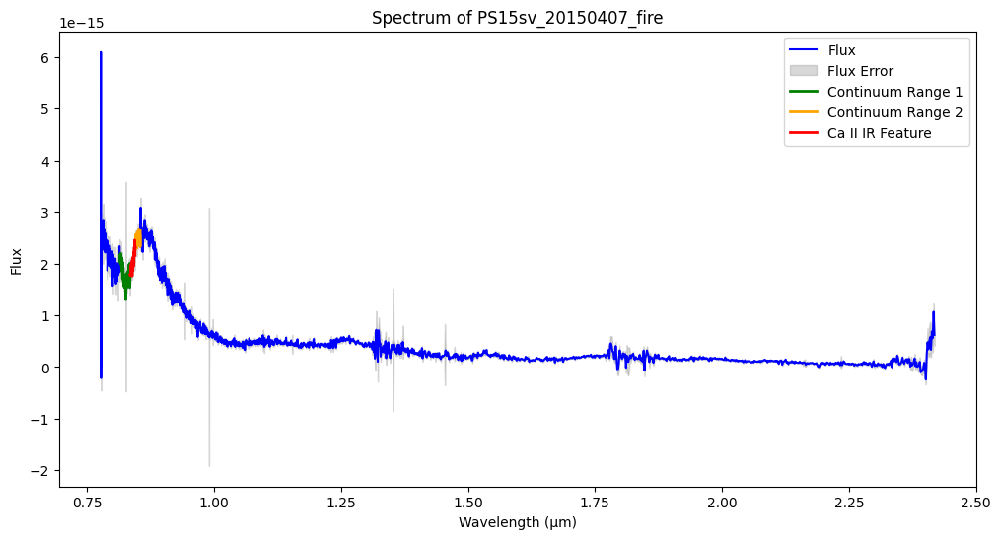

Pseudo-equivalent width for Ca II IR in PS15sv_20150601_fire: 0.01 Å
Velocity shift for Ca II IR in PS15sv_20150601_fire: -4120.51 km/s


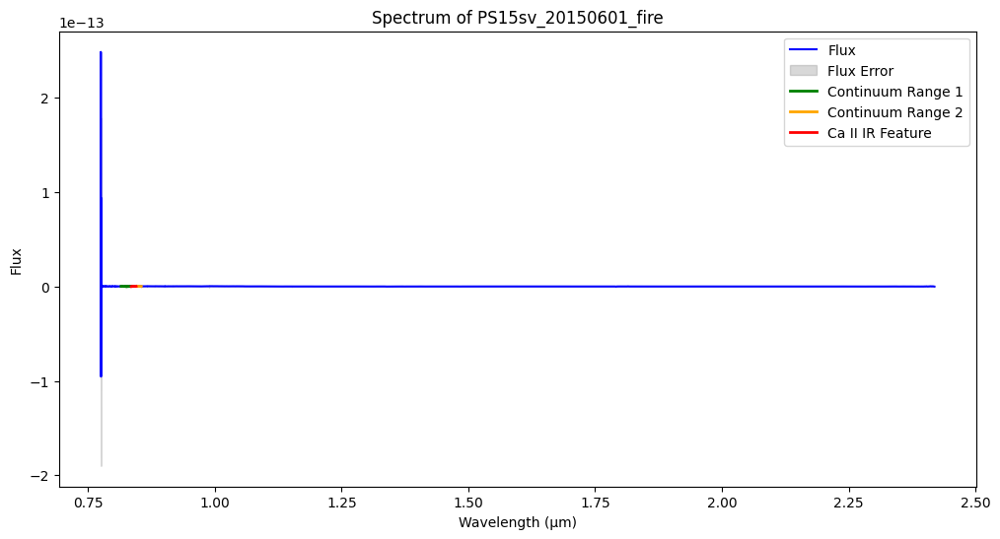

Pseudo-equivalent width for Ca II IR in CSP15B_20150307_fire: 0.01 Å
Velocity shift for Ca II IR in CSP15B_20150307_fire: -2920.20 km/s


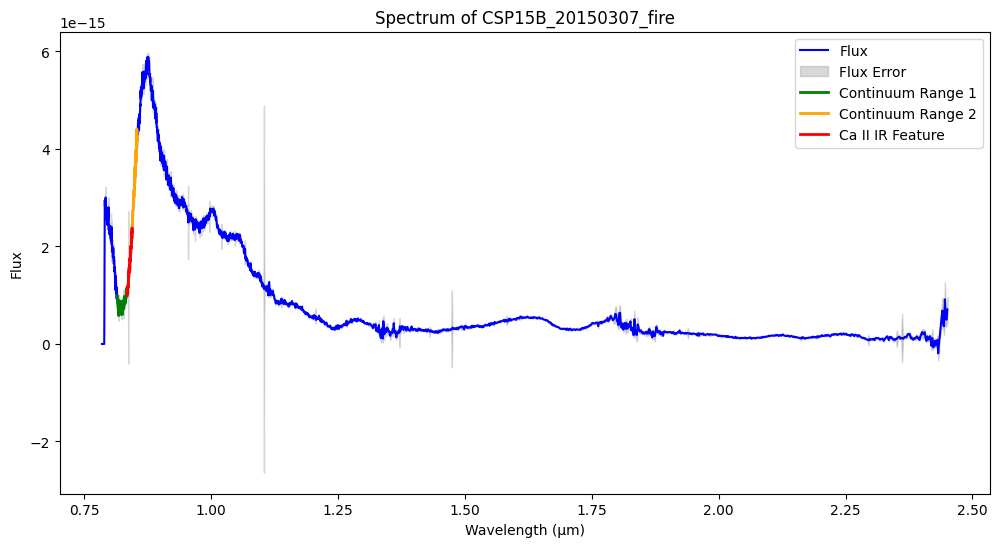

Pseudo-equivalent width for Ca II IR in PTF11qnr_20111216_fire: 0.01 Å
Velocity shift for Ca II IR in PTF11qnr_20111216_fire: -4138.08 km/s


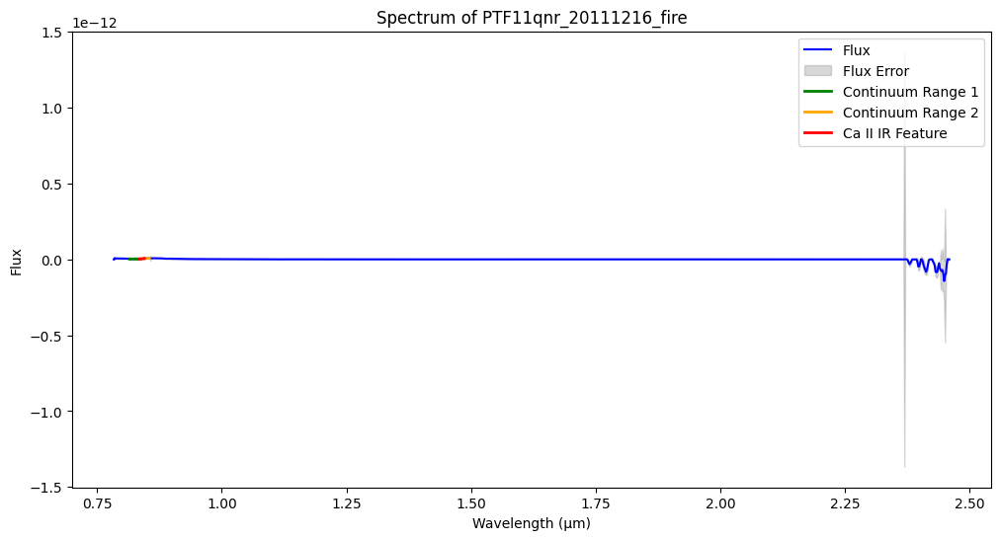

Pseudo-equivalent width for Ca II IR in PTF11qnr_20111218_fire: 0.01 Å
Velocity shift for Ca II IR in PTF11qnr_20111218_fire: -4166.04 km/s


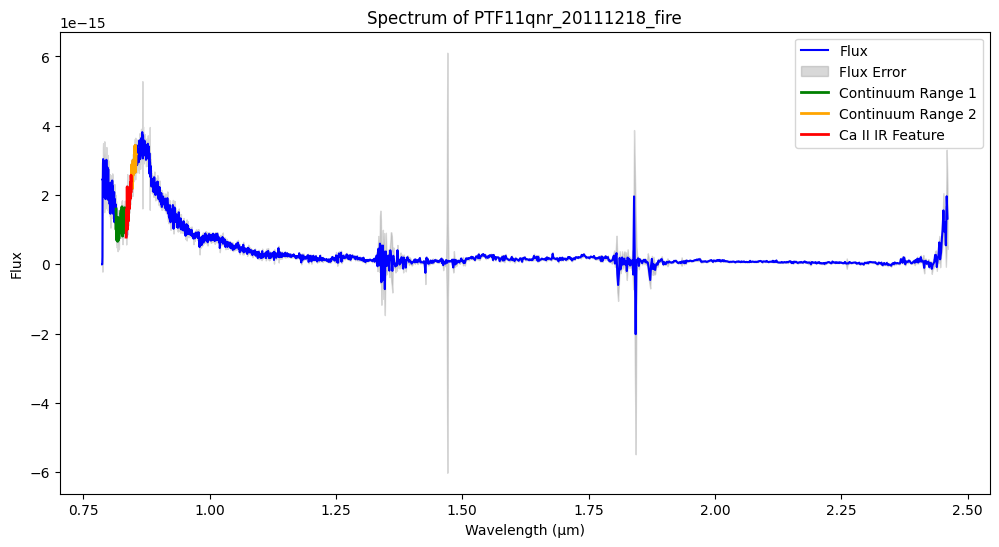

Pseudo-equivalent width for Ca II IR in PTF11qnr_20111221_fire: 0.01 Å
Velocity shift for Ca II IR in PTF11qnr_20111221_fire: -3707.60 km/s


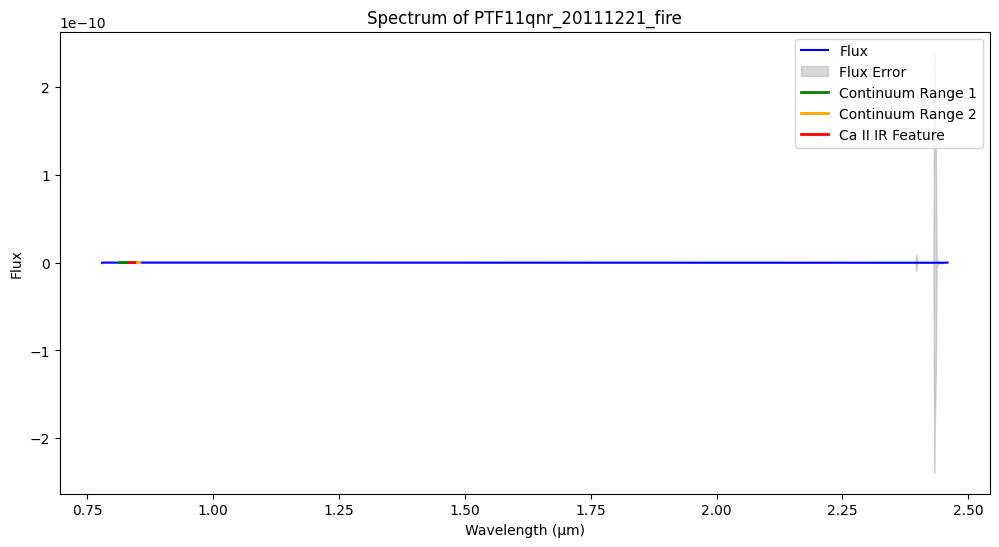

Pseudo-equivalent width for Ca II IR in PTF13duj_20131025_fire: 0.00 Å
Velocity shift for Ca II IR in PTF13duj_20131025_fire: -5675.55 km/s


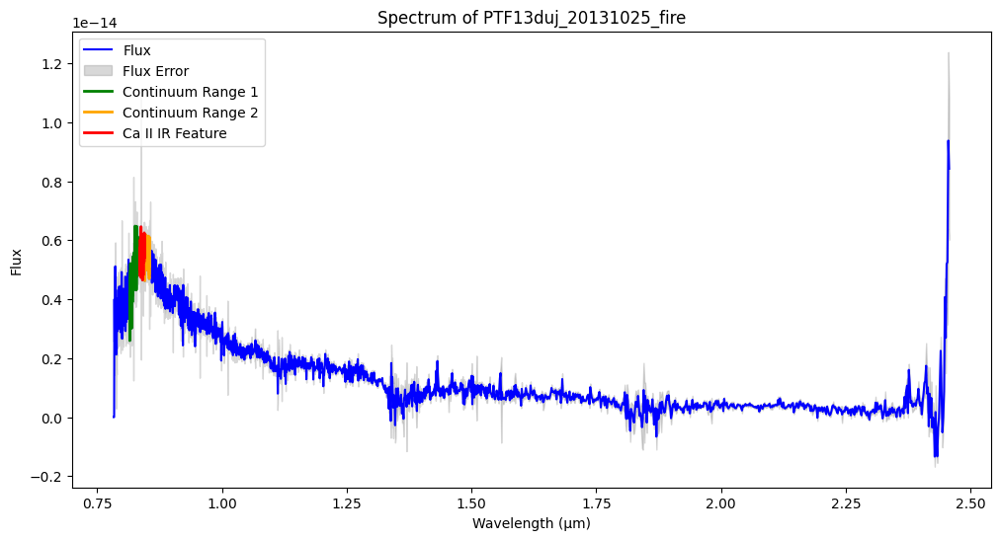

Pseudo-equivalent width for Ca II IR in PTF13duj_20131114_fire: 0.01 Å
Velocity shift for Ca II IR in PTF13duj_20131114_fire: -3769.80 km/s


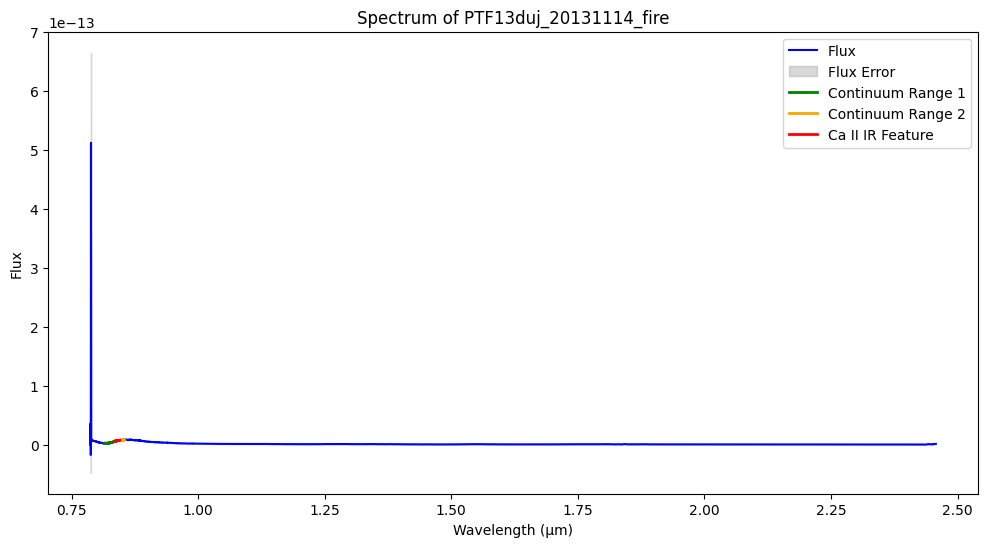

Pseudo-equivalent width for Ca II IR in PTF13duj_20131120_fire: 0.01 Å
Velocity shift for Ca II IR in PTF13duj_20131120_fire: -3027.80 km/s


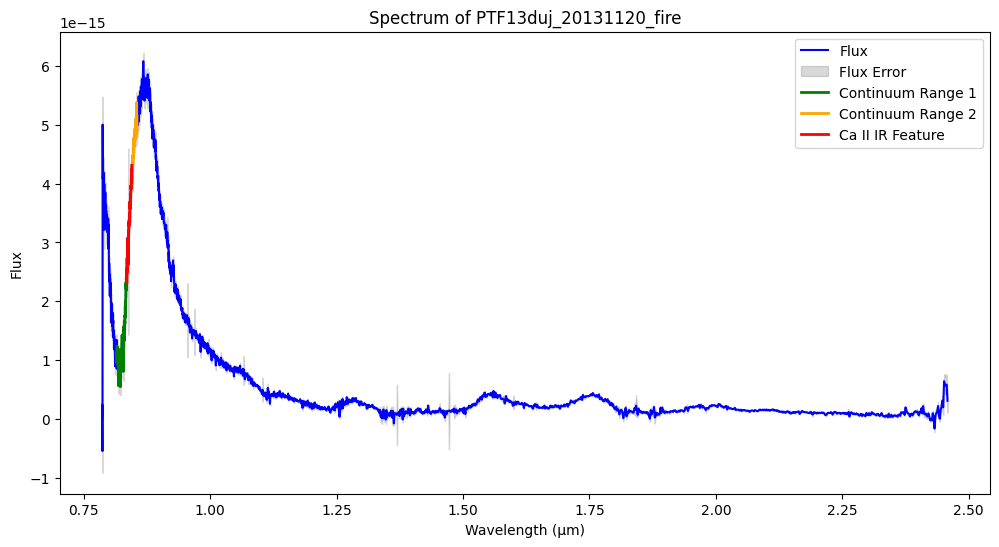

Pseudo-equivalent width for Ca II IR in PTF13duj_20131130_fire: 0.01 Å
Velocity shift for Ca II IR in PTF13duj_20131130_fire: -2730.25 km/s


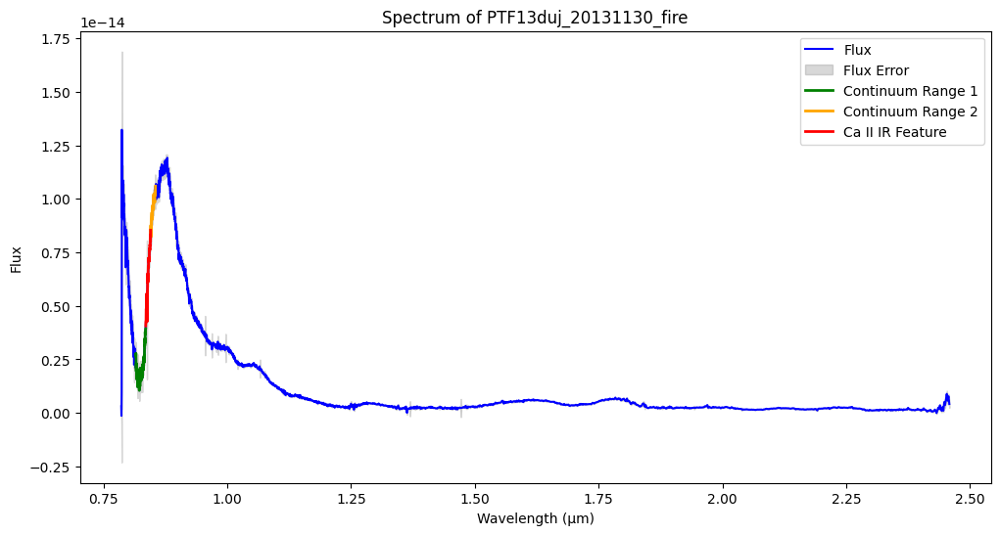

Pseudo-equivalent width for Ca II IR in PTF13dym_20131120_fire: 0.00 Å
Velocity shift for Ca II IR in PTF13dym_20131120_fire: -5997.70 km/s


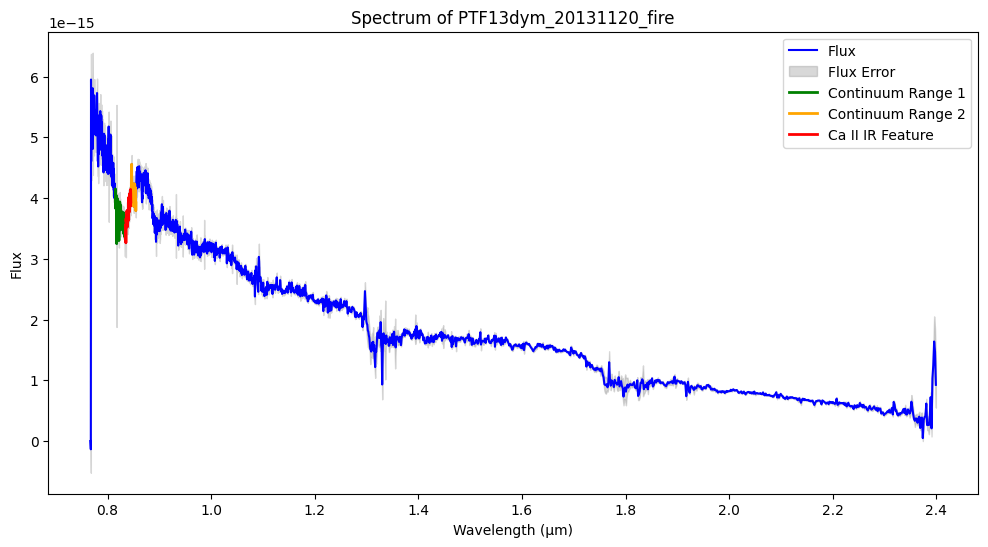

Pseudo-equivalent width for Ca II IR in PTF13ebh_20131114_fire: 0.00 Å
Velocity shift for Ca II IR in PTF13ebh_20131114_fire: -4421.68 km/s


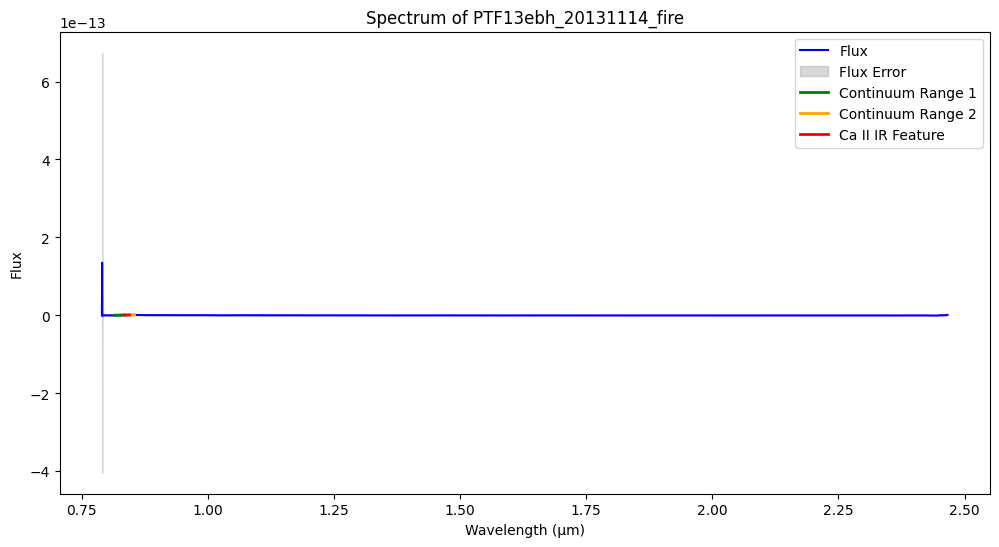

Pseudo-equivalent width for Ca II IR in PTF13ebh_20131116_fire: 0.00 Å
Velocity shift for Ca II IR in PTF13ebh_20131116_fire: -4984.49 km/s


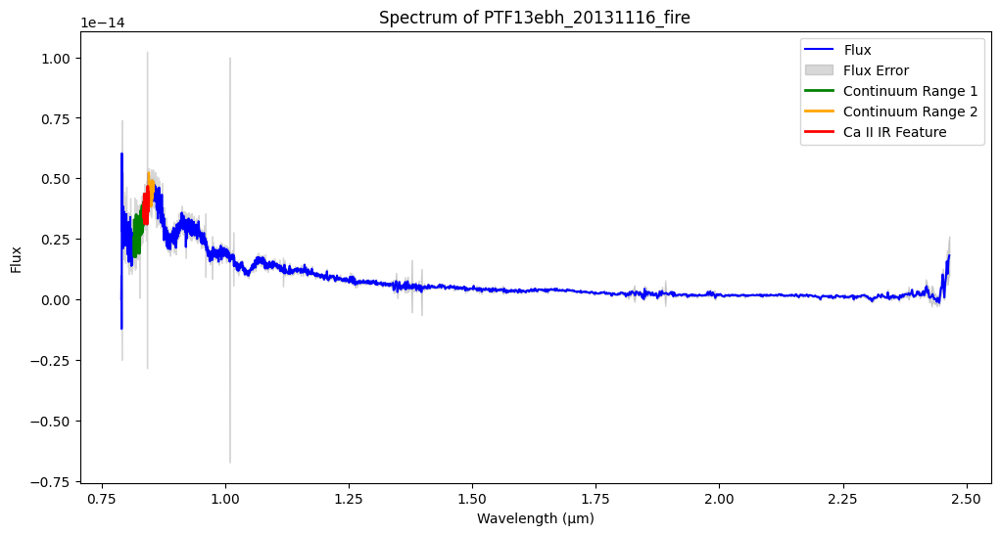

Pseudo-equivalent width for Ca II IR in PTF13ebh_20131120_fire: 0.00 Å
Velocity shift for Ca II IR in PTF13ebh_20131120_fire: -4819.48 km/s


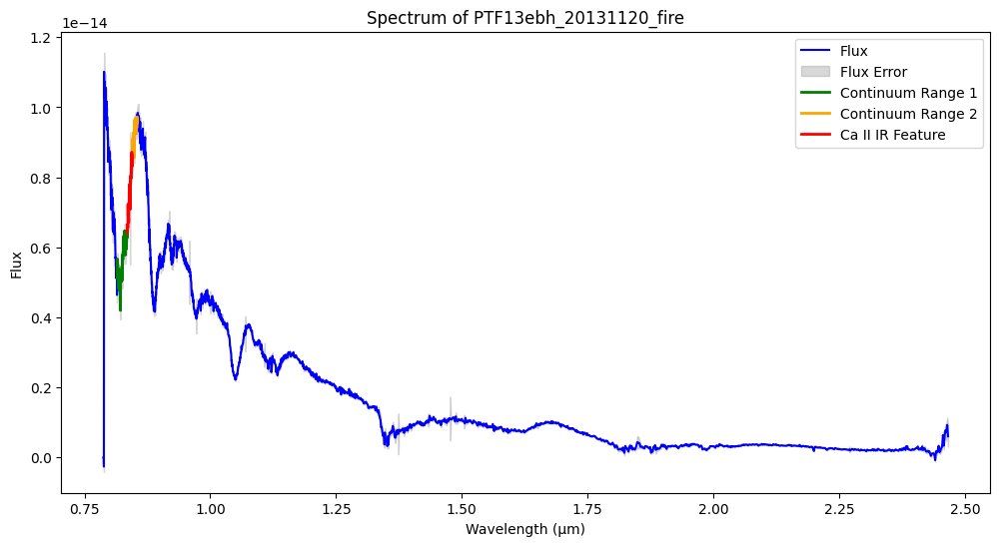

Pseudo-equivalent width for Ca II IR in PTF13ebh_20131130_fire: 0.01 Å
Velocity shift for Ca II IR in PTF13ebh_20131130_fire: -4475.93 km/s


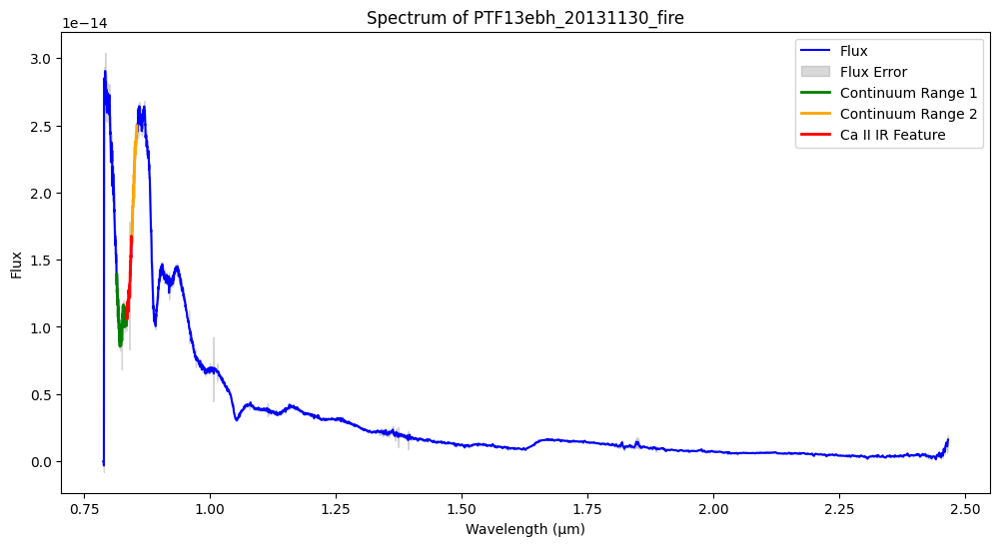

Pseudo-equivalent width for Ca II IR in PTF13ebh_20131209_fire: 0.01 Å
Velocity shift for Ca II IR in PTF13ebh_20131209_fire: -4265.74 km/s


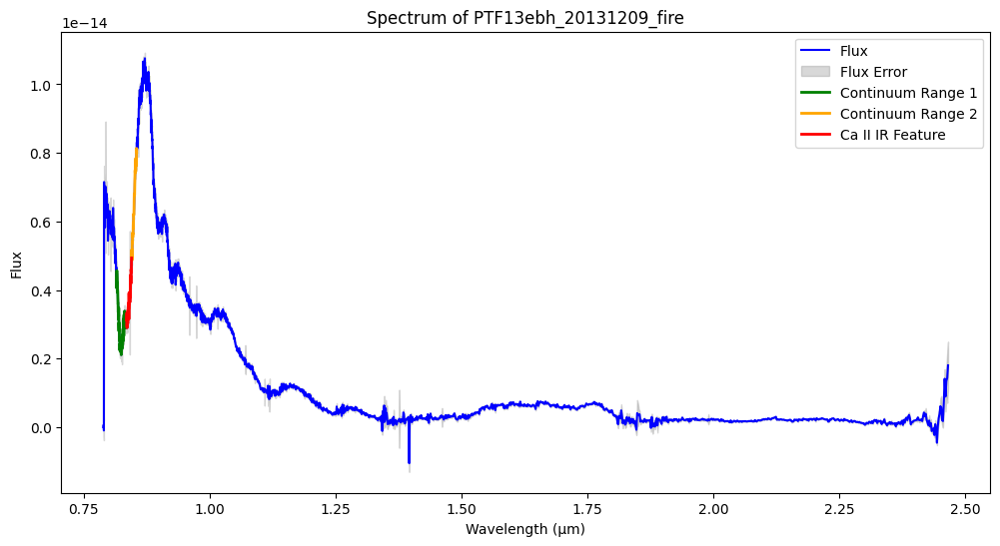

Pseudo-equivalent width for Ca II IR in PTF13ebh_20131214_fire: 0.01 Å
Velocity shift for Ca II IR in PTF13ebh_20131214_fire: -4458.67 km/s


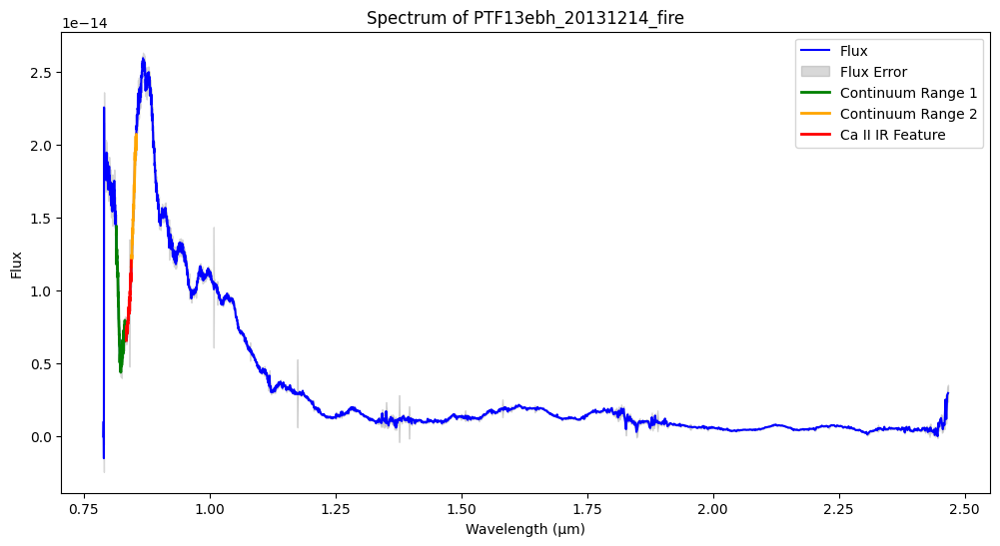

Pseudo-equivalent width for Ca II IR in PTF13ebh_20131220_fire: 0.01 Å
Velocity shift for Ca II IR in PTF13ebh_20131220_fire: -4362.72 km/s


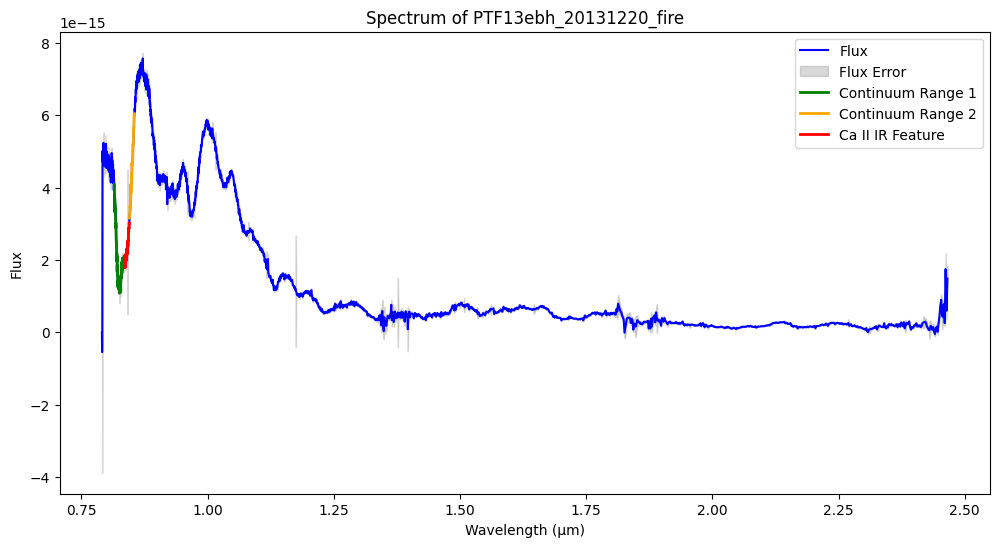

Pseudo-equivalent width for Ca II IR in PTF13ebh_20131227_fire: 0.01 Å
Velocity shift for Ca II IR in PTF13ebh_20131227_fire: -4297.41 km/s


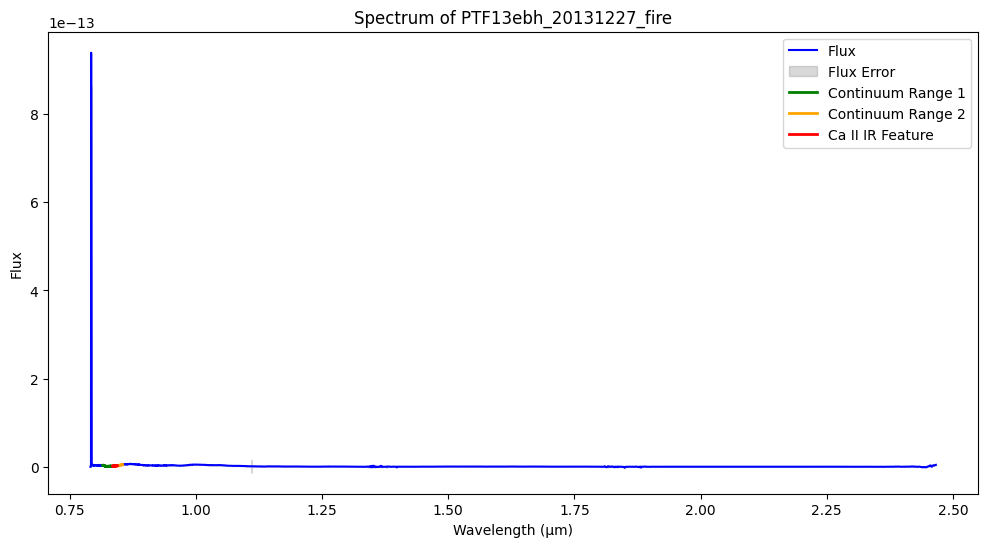

Pseudo-equivalent width for Ca II IR in PTF13ebh_20140101_fire: 0.01 Å
Velocity shift for Ca II IR in PTF13ebh_20140101_fire: -4575.48 km/s


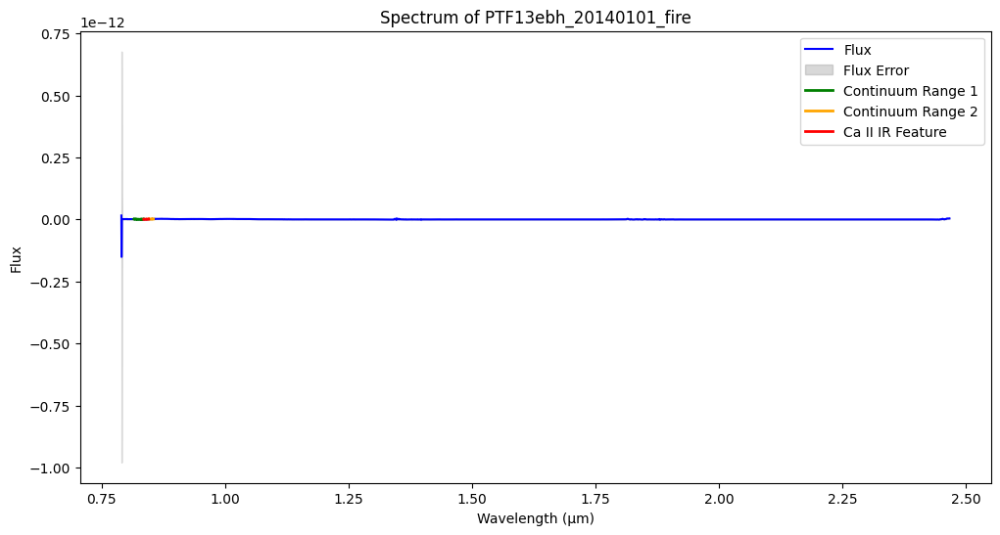

Pseudo-equivalent width for Ca II IR in PTF14aaf_20140318_fire: 0.00 Å
Velocity shift for Ca II IR in PTF14aaf_20140318_fire: -5654.38 km/s


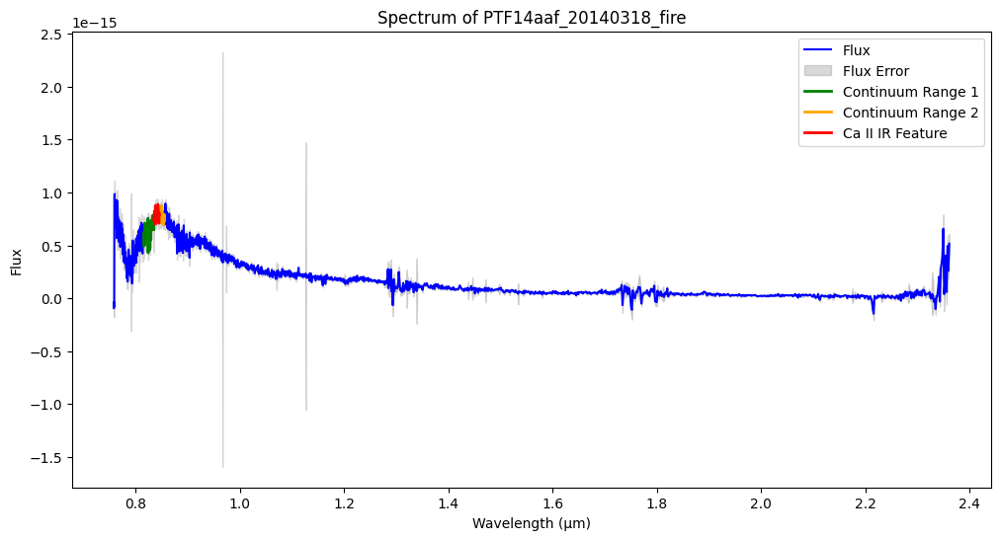

Pseudo-equivalent width for Ca II IR in PTF14w_20140109_fire: 0.01 Å
Velocity shift for Ca II IR in PTF14w_20140109_fire: -4561.17 km/s


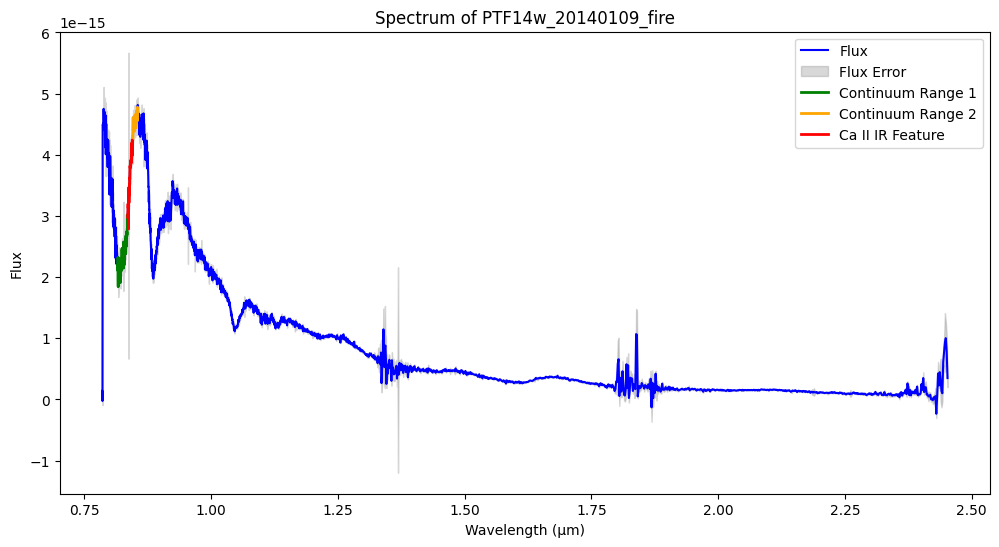

Pseudo-equivalent width for Ca II IR in PTF14w_20140114_fire: 0.01 Å
Velocity shift for Ca II IR in PTF14w_20140114_fire: -3880.97 km/s


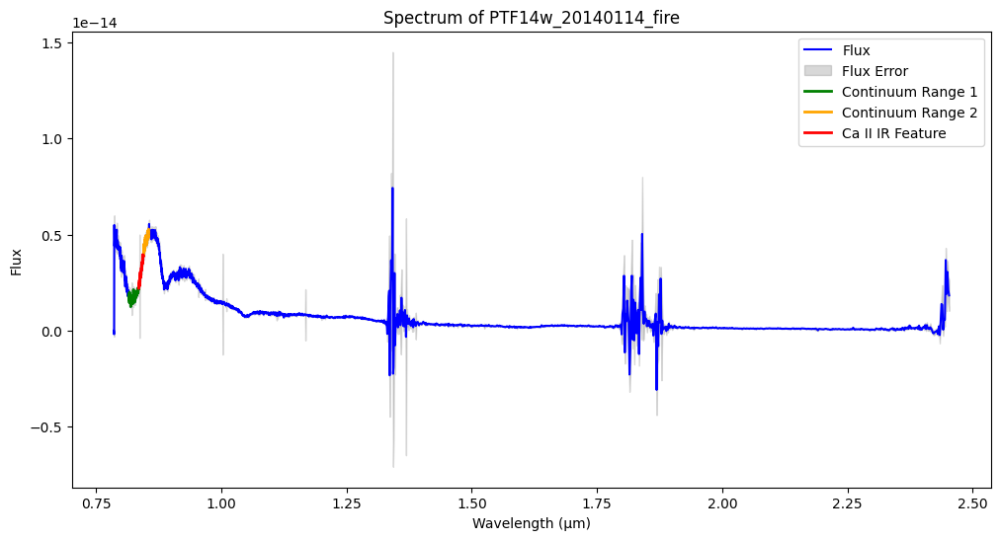

Pseudo-equivalent width for Ca II IR in PTF14w_20140208_fire: 0.01 Å
Velocity shift for Ca II IR in PTF14w_20140208_fire: -3354.35 km/s


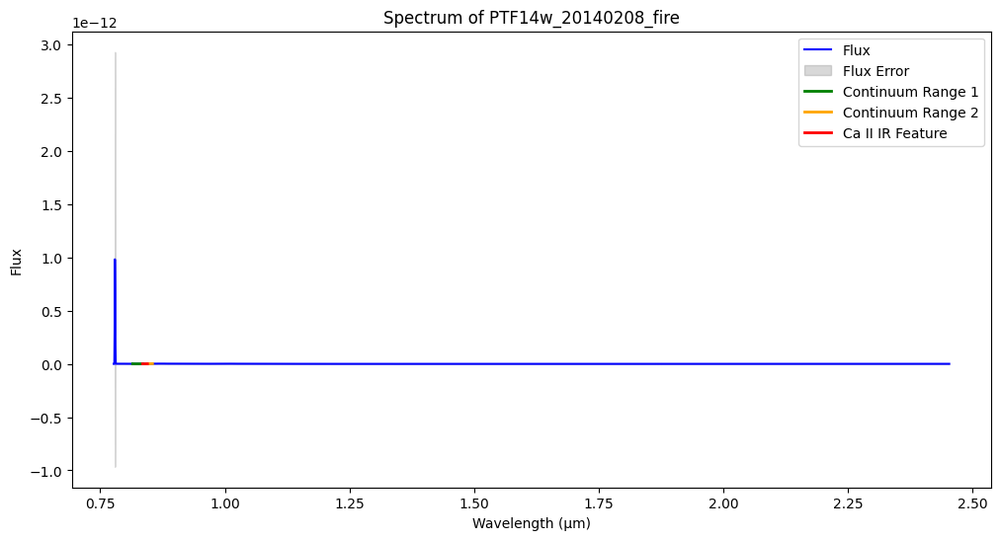

Pseudo-equivalent width for Ca II IR in PTF14w_20140215_fire: 0.01 Å
Velocity shift for Ca II IR in PTF14w_20140215_fire: -3381.35 km/s


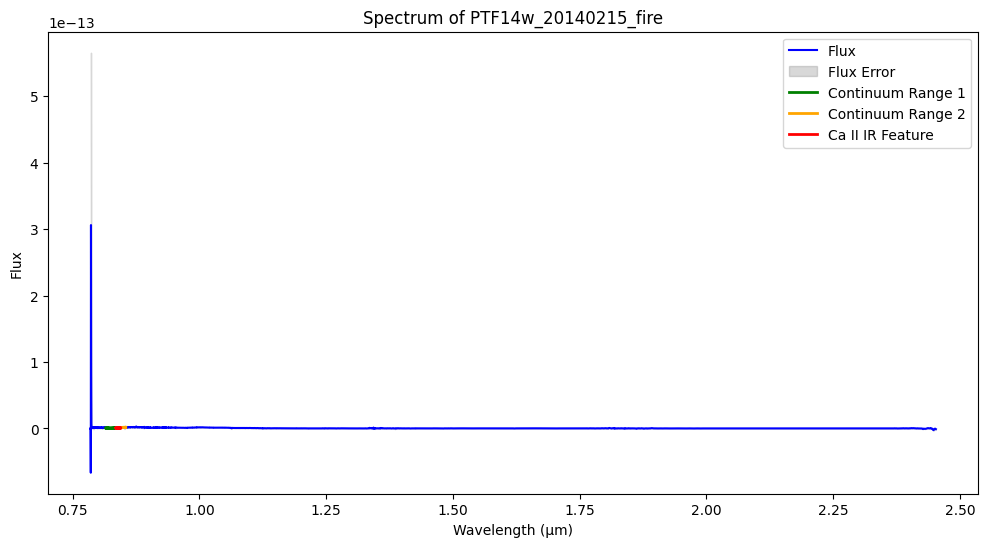

Pseudo-equivalent width for Ca II IR in PTF14w_20140222_fire: 0.01 Å
Velocity shift for Ca II IR in PTF14w_20140222_fire: -3851.15 km/s


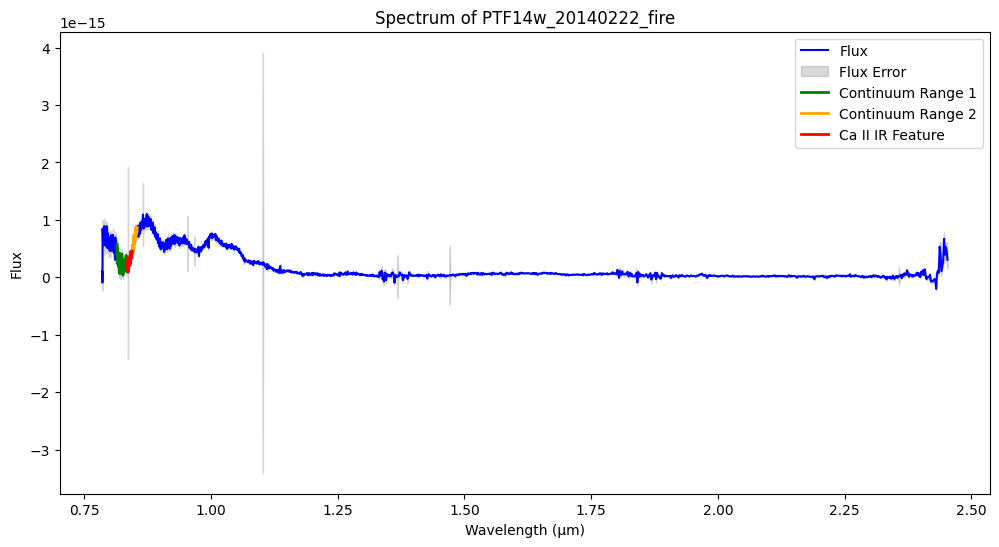

Pseudo-equivalent width for Ca II IR in PTF14w_20140227_fire: 0.01 Å
Velocity shift for Ca II IR in PTF14w_20140227_fire: -3870.87 km/s


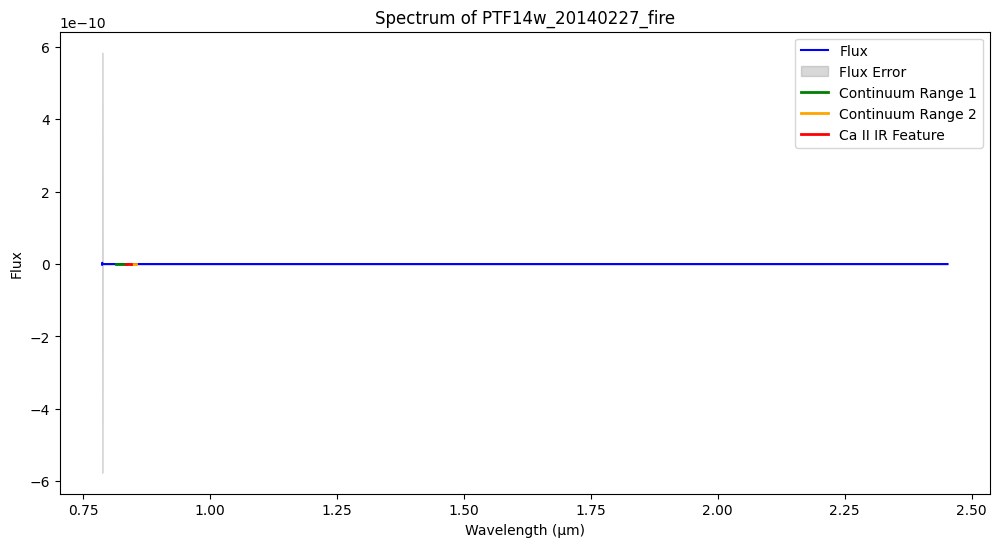

Pseudo-equivalent width for Ca II IR in PTF14w_20140318_fire: 0.00 Å
Velocity shift for Ca II IR in PTF14w_20140318_fire: -6290.10 km/s


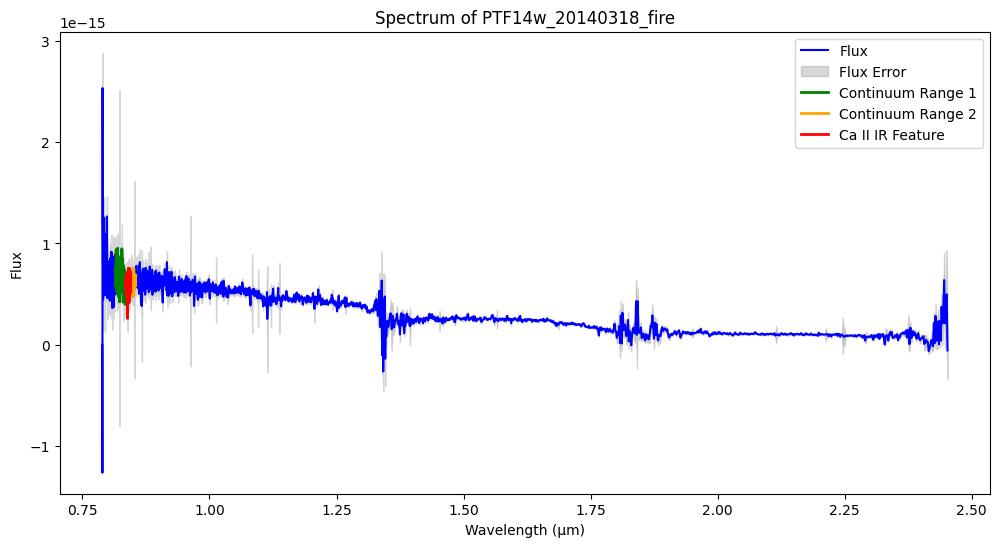

Pseudo-equivalent width for Ca II IR in PTF14yw_20140310_fire: 0.00 Å
Velocity shift for Ca II IR in PTF14yw_20140310_fire: -5202.61 km/s


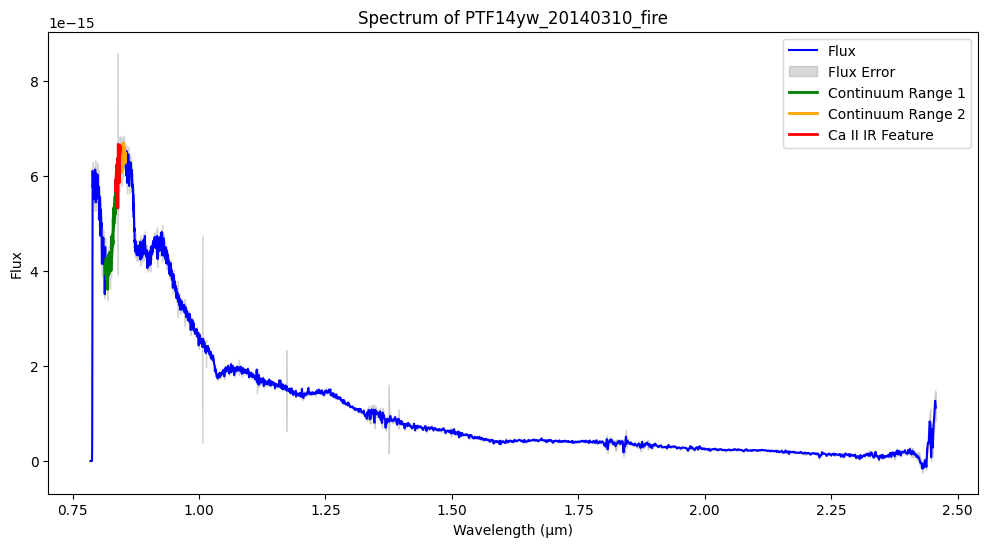

Pseudo-equivalent width for Ca II IR in PTF14yw_20140318_fire: 0.01 Å
Velocity shift for Ca II IR in PTF14yw_20140318_fire: -4015.07 km/s


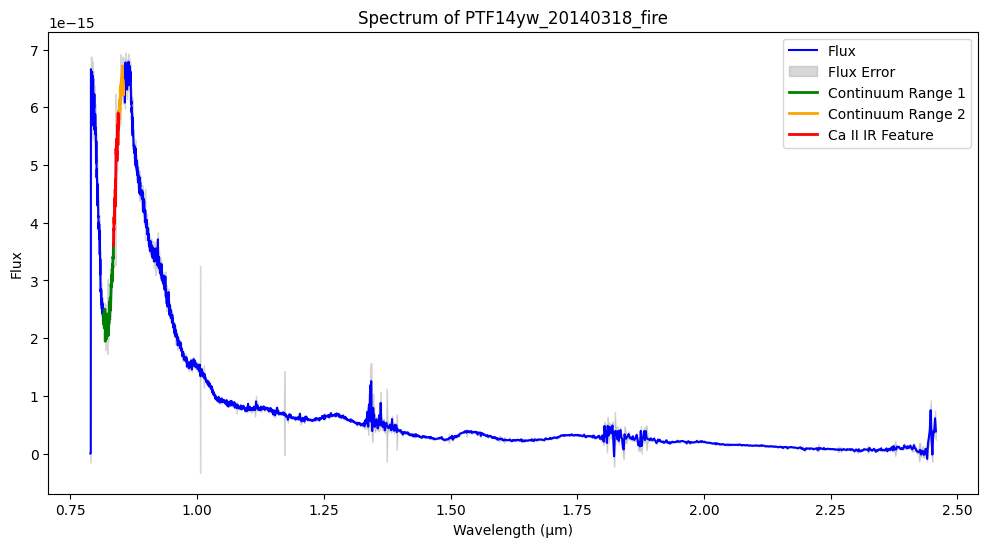

Pseudo-equivalent width for Ca II IR in PTF14yw_20140325_fire: 0.01 Å
Velocity shift for Ca II IR in PTF14yw_20140325_fire: -3683.01 km/s


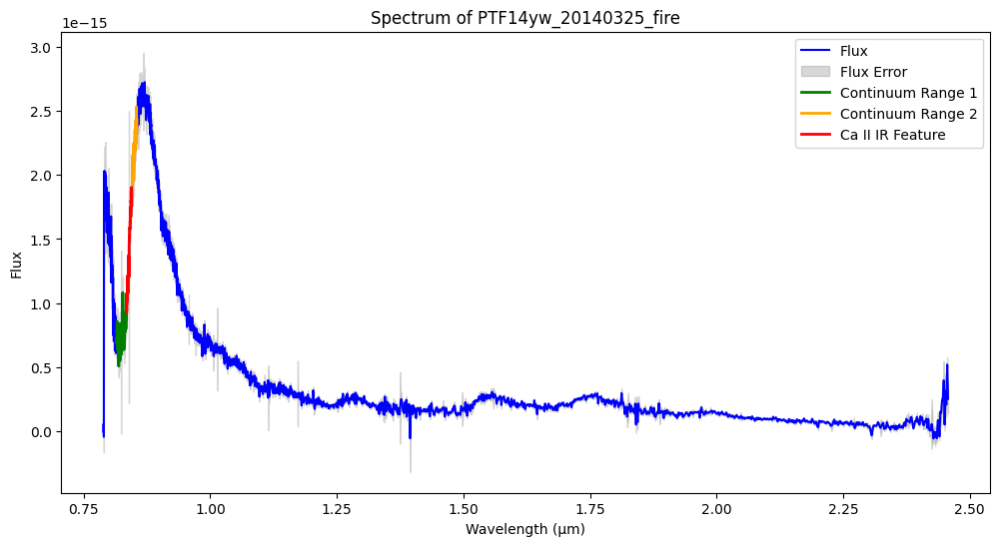

Pseudo-equivalent width for Ca II IR in PTF14yw_20140423_fire: 0.01 Å
Velocity shift for Ca II IR in PTF14yw_20140423_fire: -2939.01 km/s


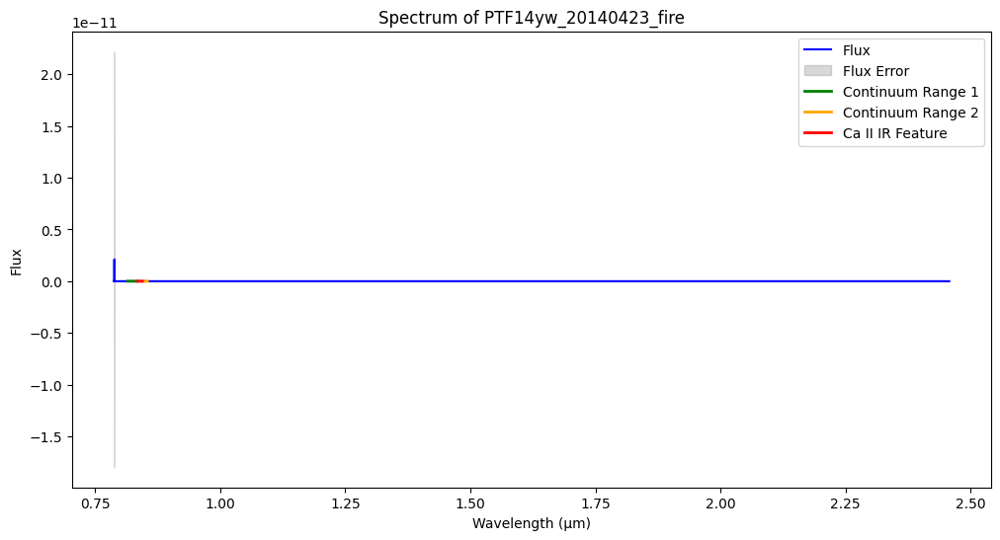

Pseudo-equivalent width for Ca II IR in PTF14yy_20140318_fire: 0.01 Å
Velocity shift for Ca II IR in PTF14yy_20140318_fire: -4223.28 km/s


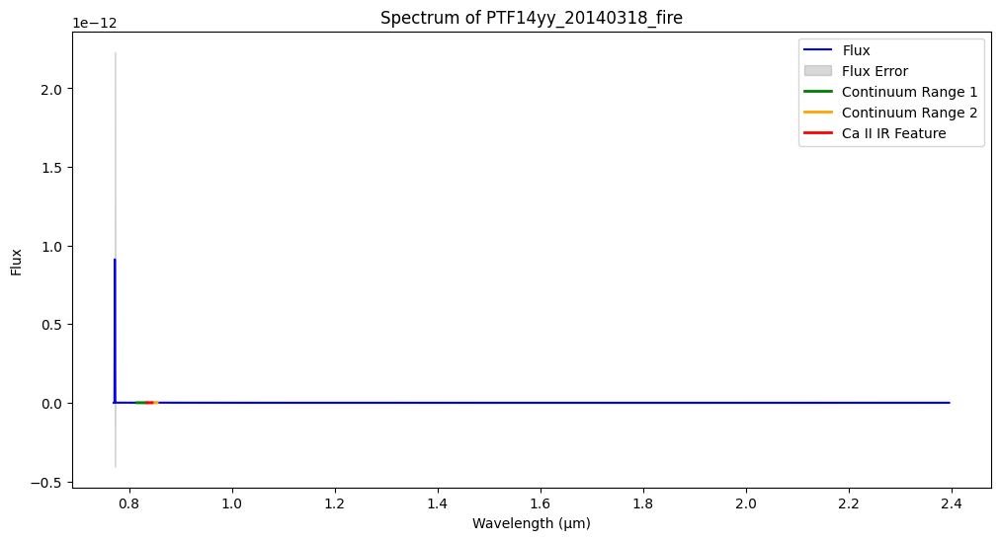

Pseudo-equivalent width for Ca II IR in SN2011iv_20111216_fire: 0.01 Å
Velocity shift for Ca II IR in SN2011iv_20111216_fire: -4158.51 km/s


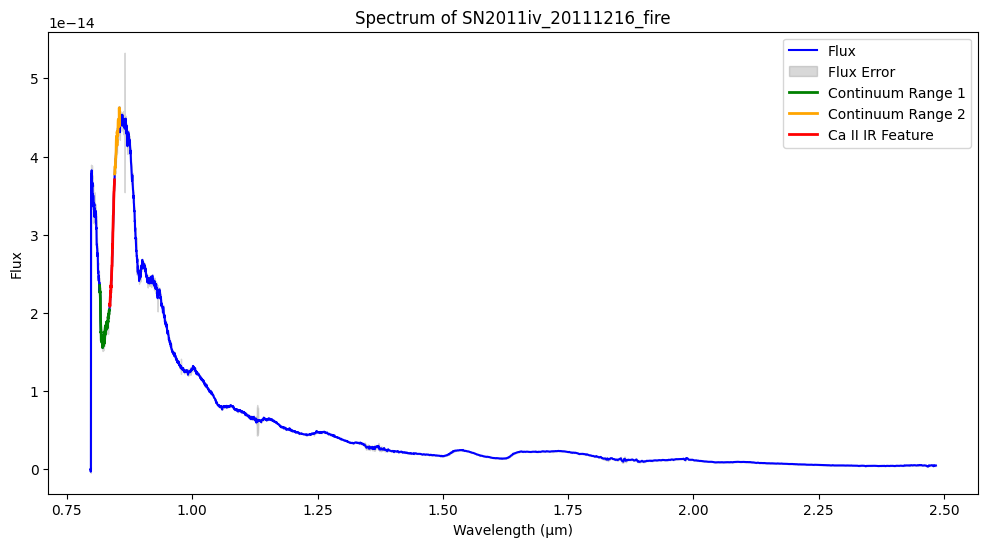

Pseudo-equivalent width for Ca II IR in SN2011iv_20111218_fire: 0.01 Å
Velocity shift for Ca II IR in SN2011iv_20111218_fire: -4210.93 km/s


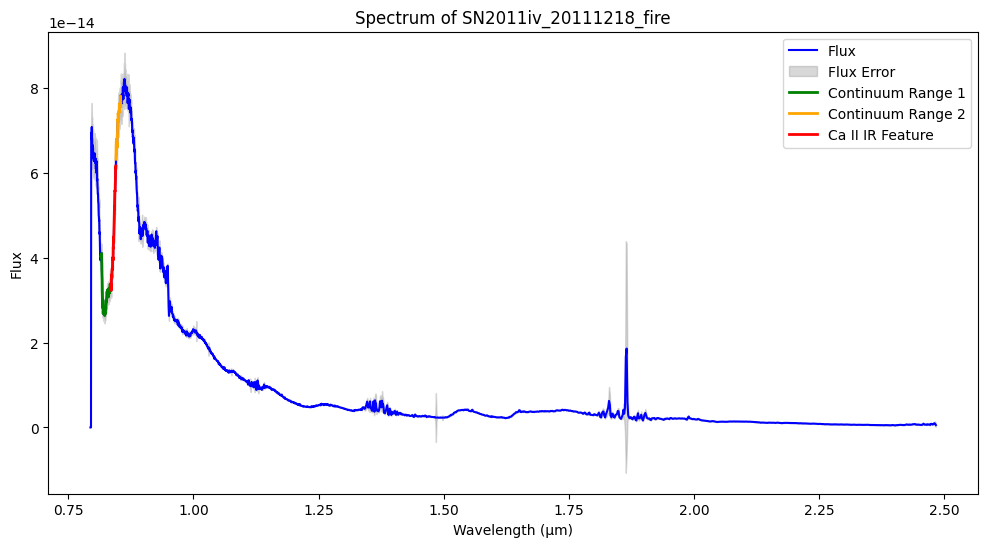

Pseudo-equivalent width for Ca II IR in SN2011iv_20111221_fire: 0.01 Å
Velocity shift for Ca II IR in SN2011iv_20111221_fire: -4088.44 km/s


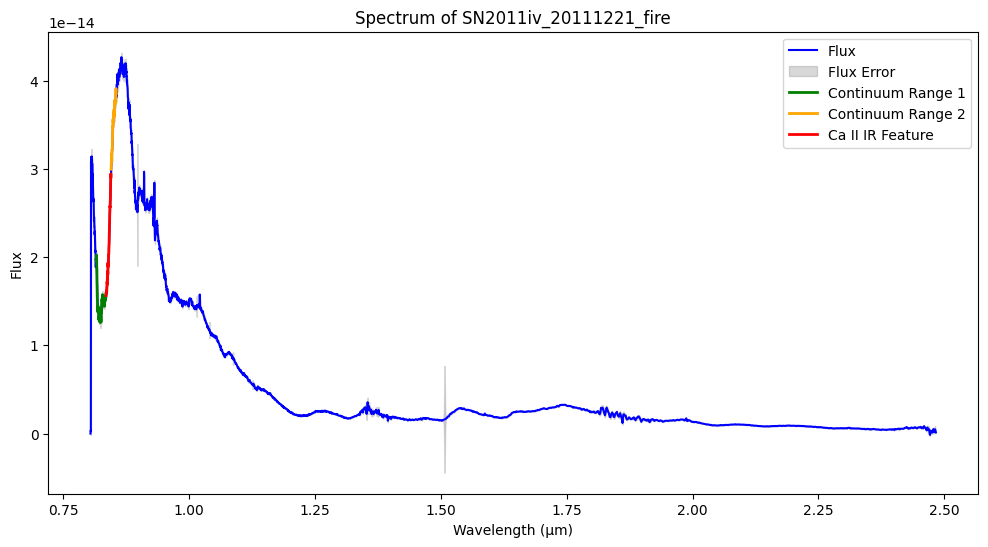

Pseudo-equivalent width for Ca II IR in SN2011iv_20120107_fire: 0.01 Å
Velocity shift for Ca II IR in SN2011iv_20120107_fire: -3045.18 km/s


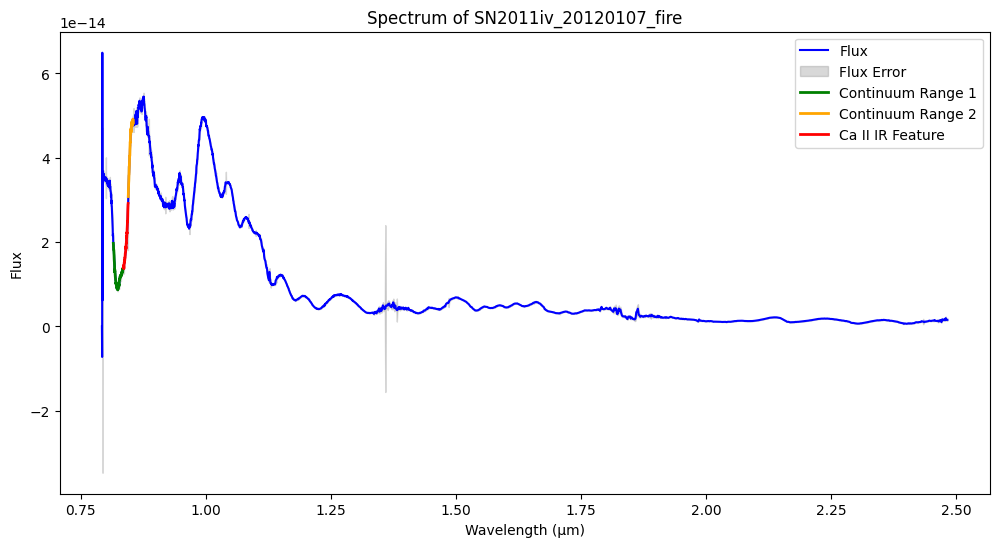

Pseudo-equivalent width for Ca II IR in SN2011iv_20120115_fire: 0.01 Å
Velocity shift for Ca II IR in SN2011iv_20120115_fire: -2743.80 km/s


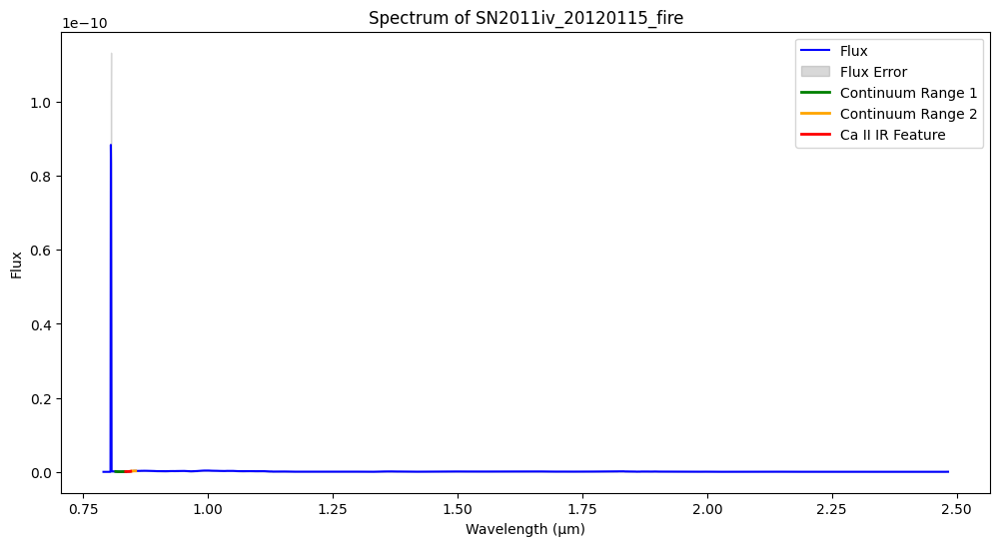

Pseudo-equivalent width for Ca II IR in SN2011iv_20120119_fire: 0.01 Å
Velocity shift for Ca II IR in SN2011iv_20120119_fire: -3164.05 km/s


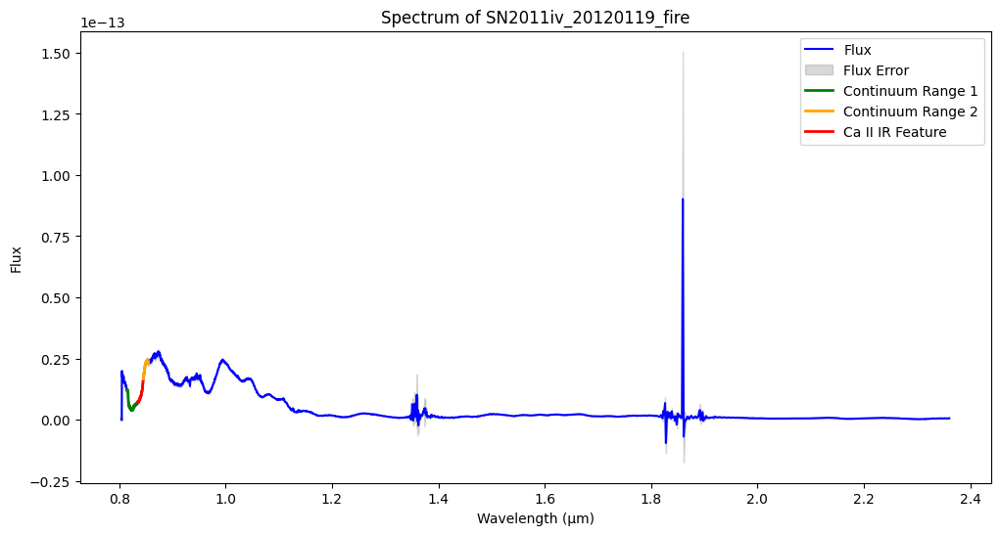

Pseudo-equivalent width for Ca II IR in SN2011iv_20120203_fire: 0.01 Å
Velocity shift for Ca II IR in SN2011iv_20120203_fire: -2865.91 km/s


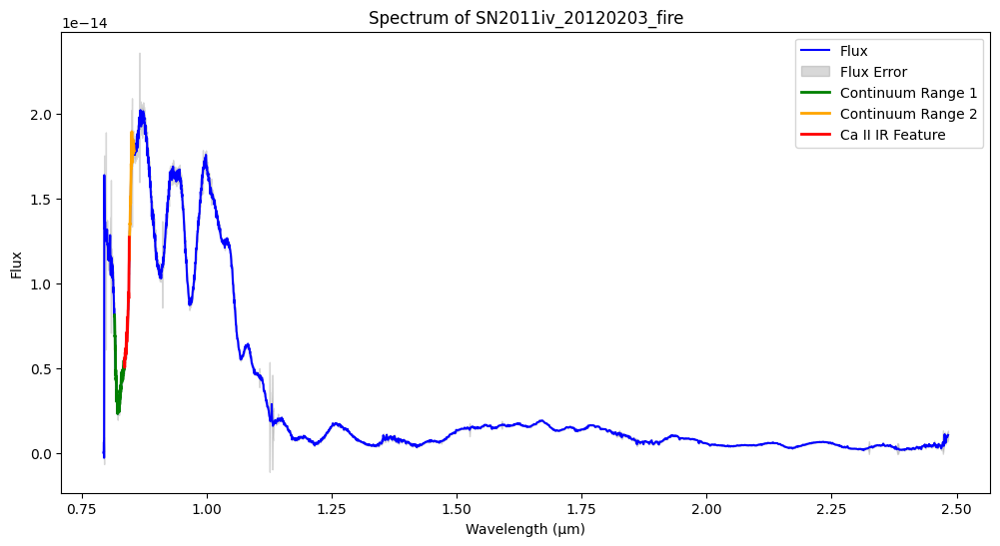

Pseudo-equivalent width for Ca II IR in SN2011iv_20120303_fire: 0.01 Å
Velocity shift for Ca II IR in SN2011iv_20120303_fire: -2659.32 km/s


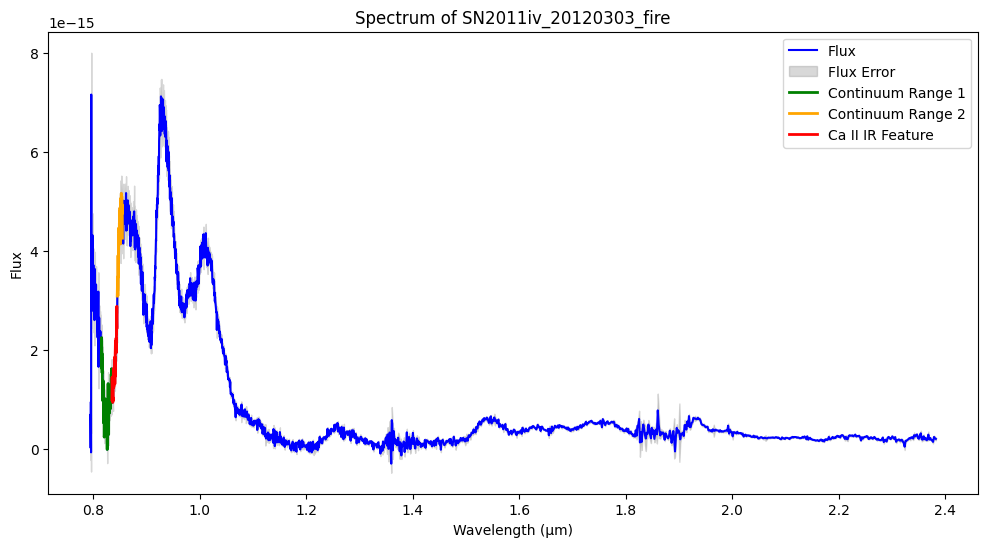

Pseudo-equivalent width for Ca II IR in SN2011iy_20111218_fire: 0.01 Å
Velocity shift for Ca II IR in SN2011iy_20111218_fire: -2549.84 km/s


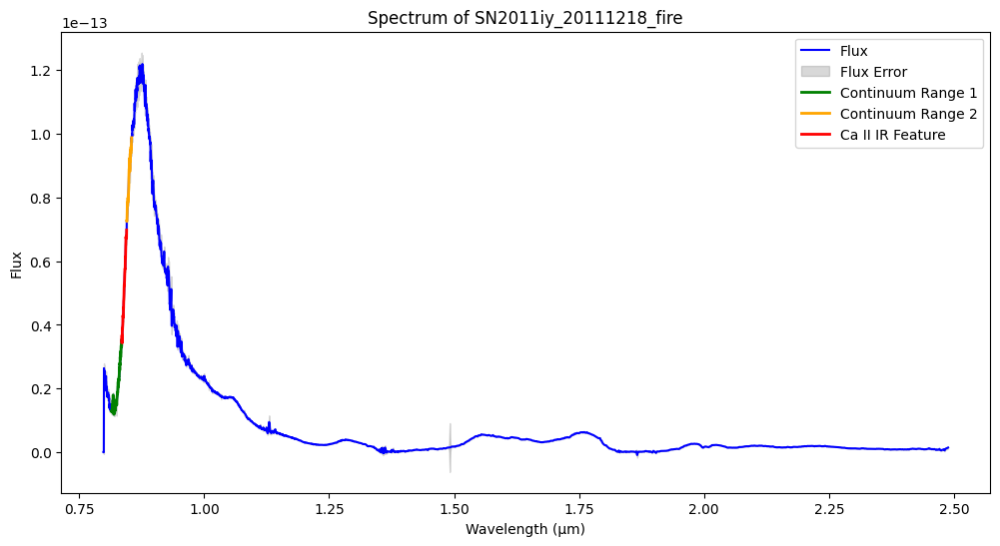

Pseudo-equivalent width for Ca II IR in SN2011iy_20111221_fire: 0.01 Å
Velocity shift for Ca II IR in SN2011iy_20111221_fire: -2272.88 km/s


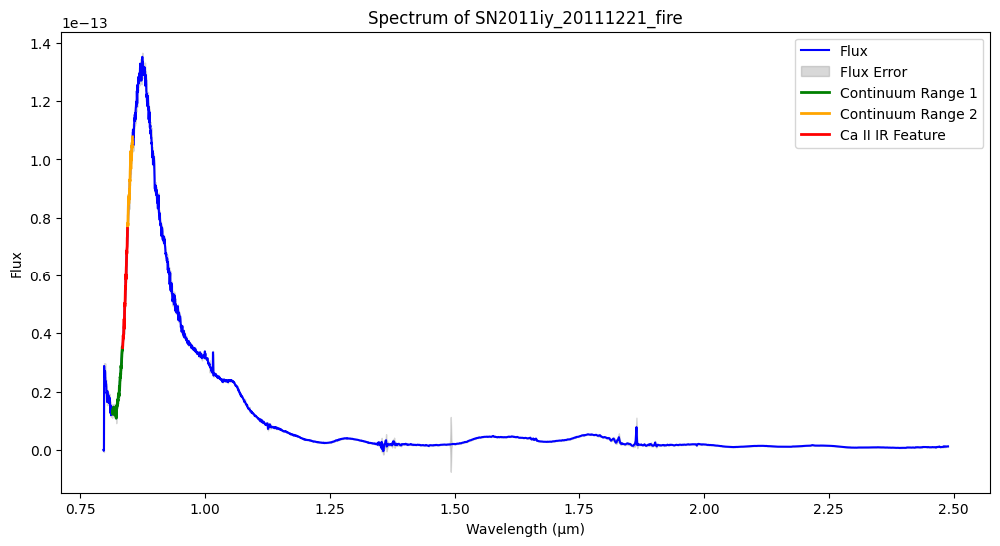

Pseudo-equivalent width for Ca II IR in SN2011iy_20120107_fire: 0.02 Å
Velocity shift for Ca II IR in SN2011iy_20120107_fire: -1950.50 km/s


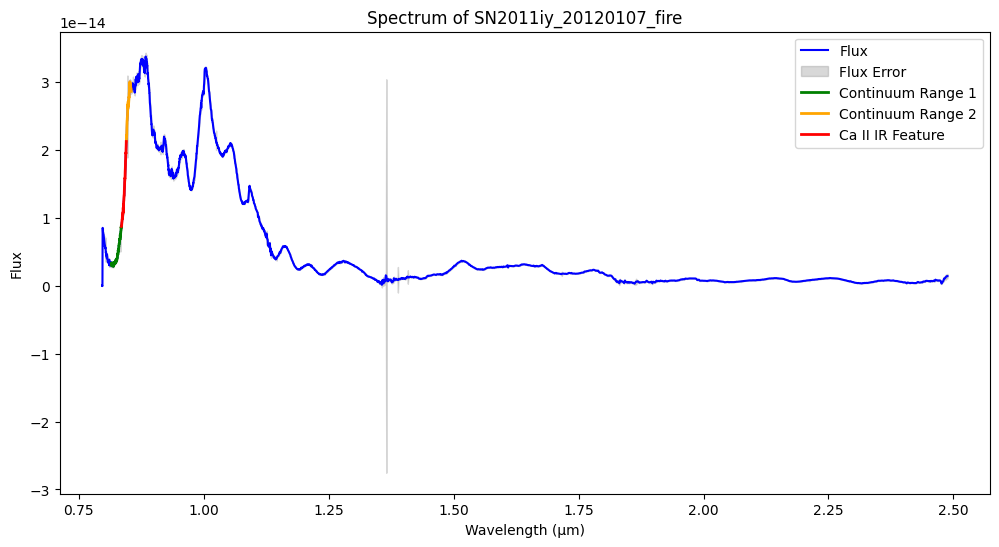

Pseudo-equivalent width for Ca II IR in SN2011iy_20120119_fire: 0.02 Å
Velocity shift for Ca II IR in SN2011iy_20120119_fire: -2276.78 km/s


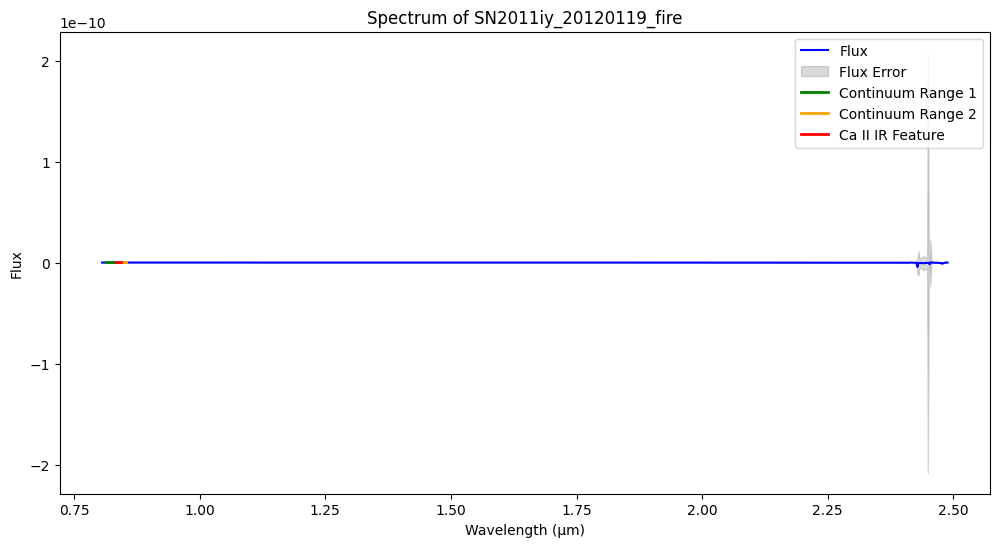

Pseudo-equivalent width for Ca II IR in SN2011iy_20120203_fire: 0.01 Å
Velocity shift for Ca II IR in SN2011iy_20120203_fire: -2599.96 km/s


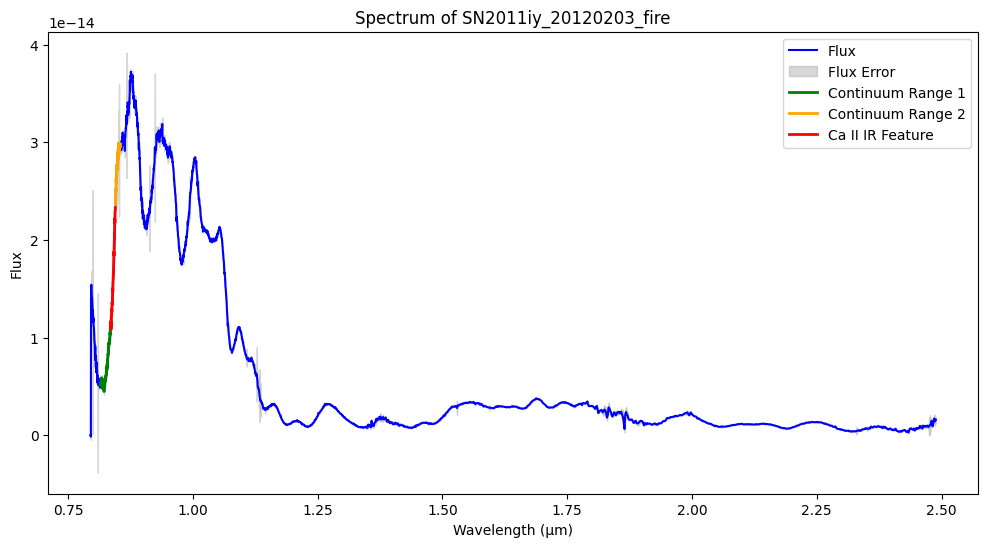

Pseudo-equivalent width for Ca II IR in SN2011iy_20120303_fire: 0.01 Å
Velocity shift for Ca II IR in SN2011iy_20120303_fire: -2993.34 km/s


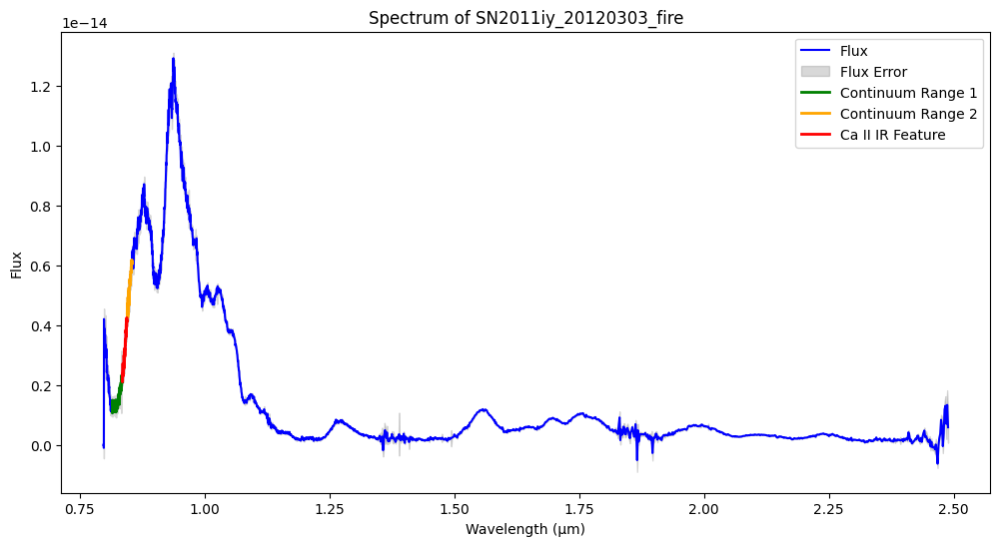

Pseudo-equivalent width for Ca II IR in SN2011jh_20120107_fire: 0.01 Å
Velocity shift for Ca II IR in SN2011jh_20120107_fire: -3604.54 km/s


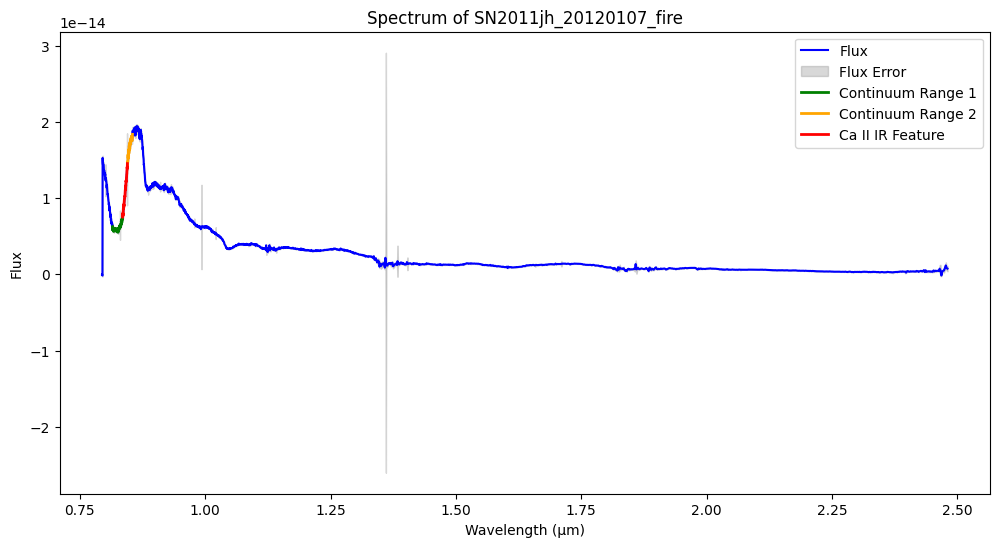

Pseudo-equivalent width for Ca II IR in SN2011jh_20120115_fire: 0.01 Å
Velocity shift for Ca II IR in SN2011jh_20120115_fire: -3630.13 km/s


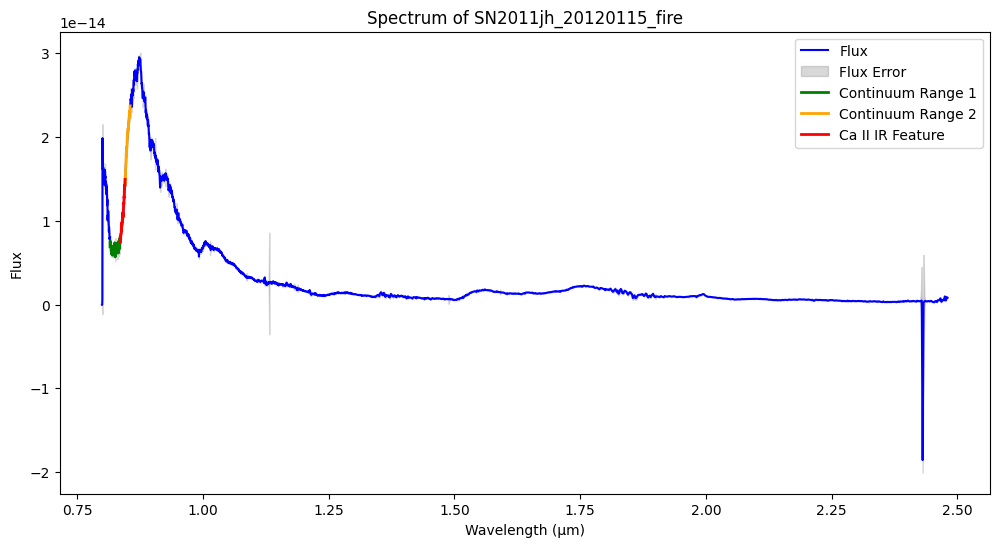

Pseudo-equivalent width for Ca II IR in SN2011jh_20120119_fire: 0.01 Å
Velocity shift for Ca II IR in SN2011jh_20120119_fire: -3287.80 km/s


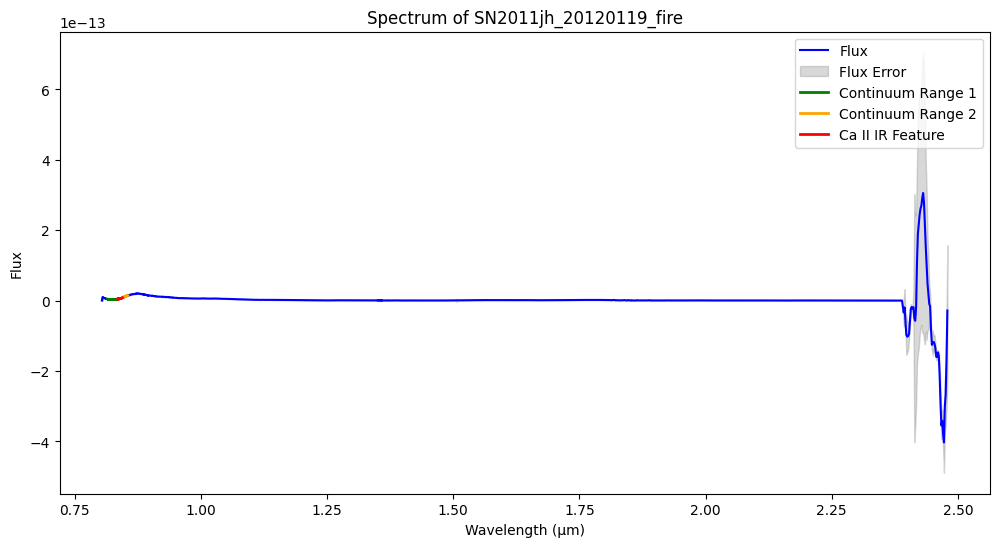

Pseudo-equivalent width for Ca II IR in SN2011jh_20120203_fire: 0.01 Å
Velocity shift for Ca II IR in SN2011jh_20120203_fire: -2681.10 km/s


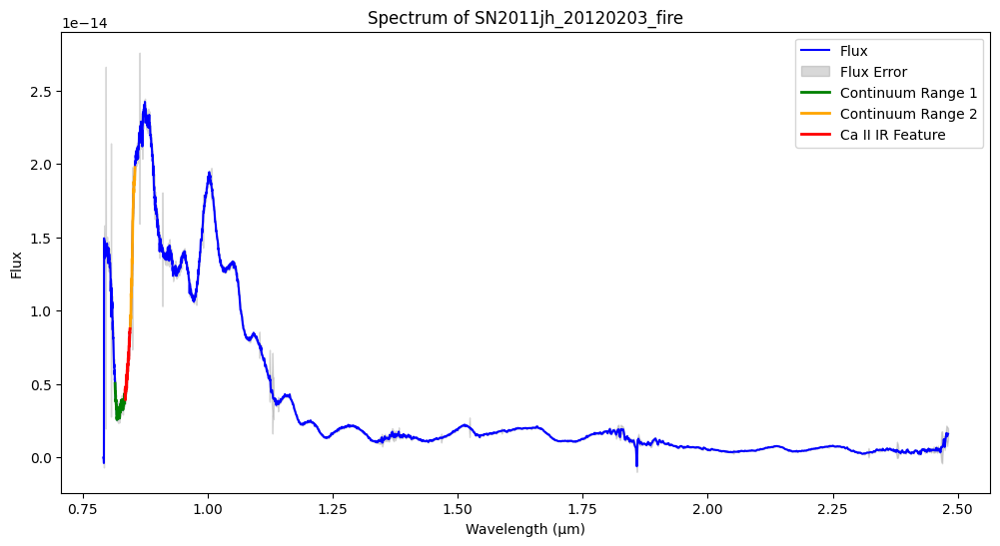

Pseudo-equivalent width for Ca II IR in SN2011jh_20120303_fire: 0.01 Å
Velocity shift for Ca II IR in SN2011jh_20120303_fire: -2528.77 km/s


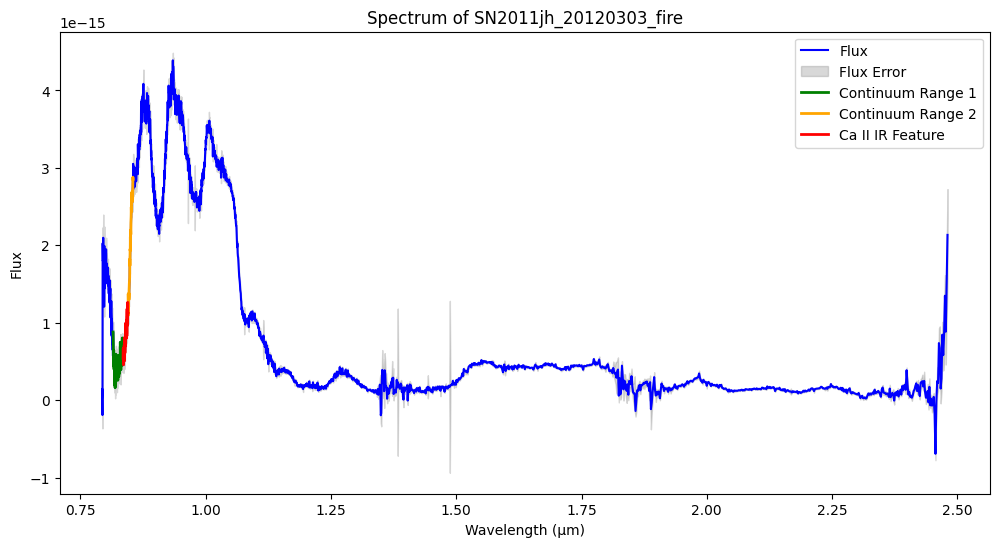

Pseudo-equivalent width for Ca II IR in SN2011jh_20120408_fire: 0.01 Å
Velocity shift for Ca II IR in SN2011jh_20120408_fire: -2853.07 km/s


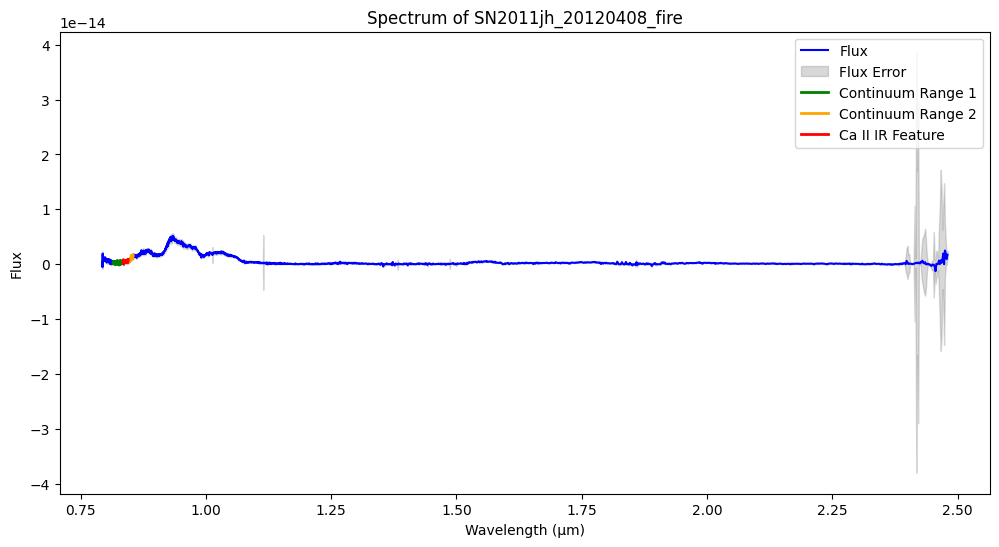

Pseudo-equivalent width for Ca II IR in SN2011jh_20120411_fire: 0.01 Å
Velocity shift for Ca II IR in SN2011jh_20120411_fire: -3282.85 km/s


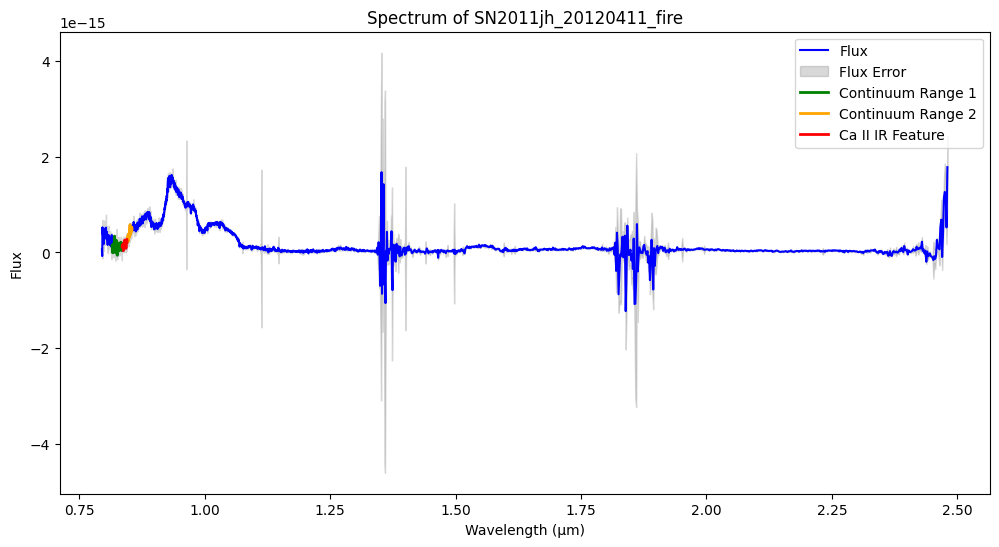

Pseudo-equivalent width for Ca II IR in SN2011jt_20120107_fire: 0.01 Å
Velocity shift for Ca II IR in SN2011jt_20120107_fire: -3840.15 km/s


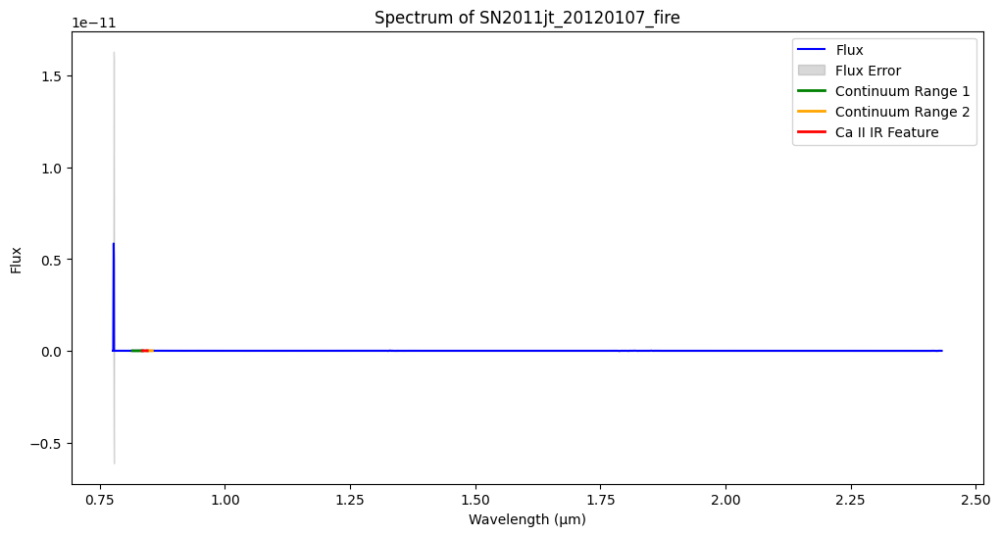

Pseudo-equivalent width for Ca II IR in SN2012G_20120204_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012G_20120204_fire: -4354.37 km/s


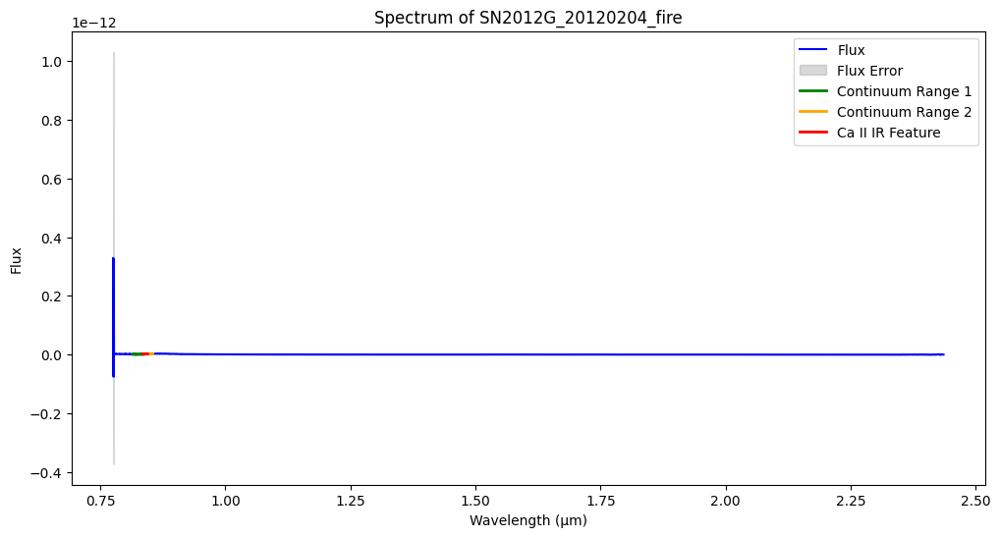

Pseudo-equivalent width for Ca II IR in SN2012U_20120203_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012U_20120203_fire: -4303.28 km/s


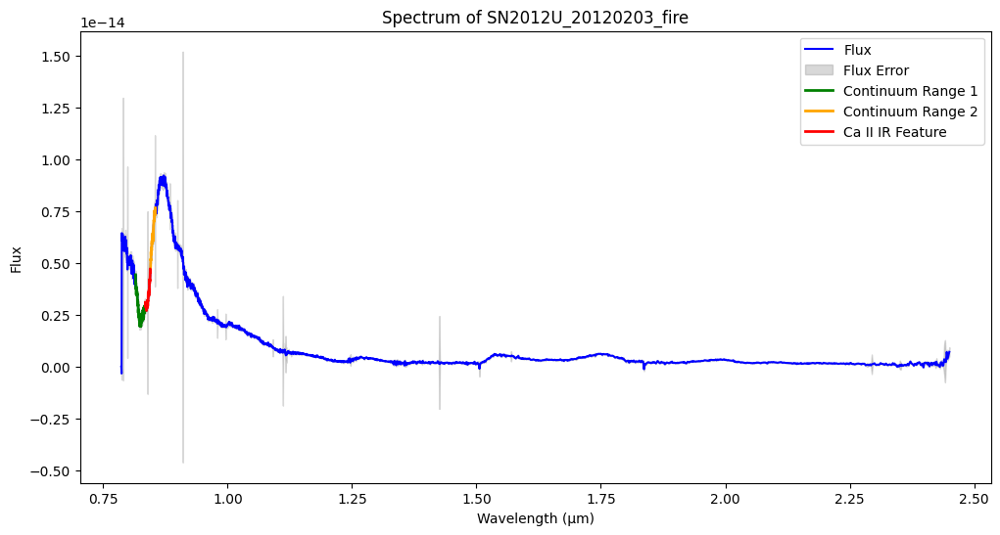

Pseudo-equivalent width for Ca II IR in SN2012ah_20120303_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012ah_20120303_fire: -3726.75 km/s


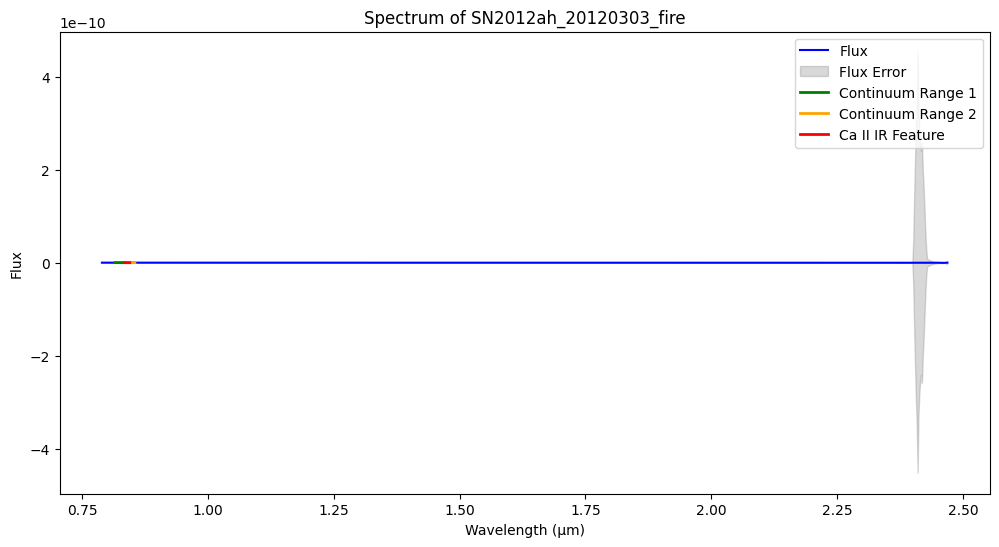

Pseudo-equivalent width for Ca II IR in SN2012ar_20120303_fire: 0.00 Å
Velocity shift for Ca II IR in SN2012ar_20120303_fire: -5265.92 km/s


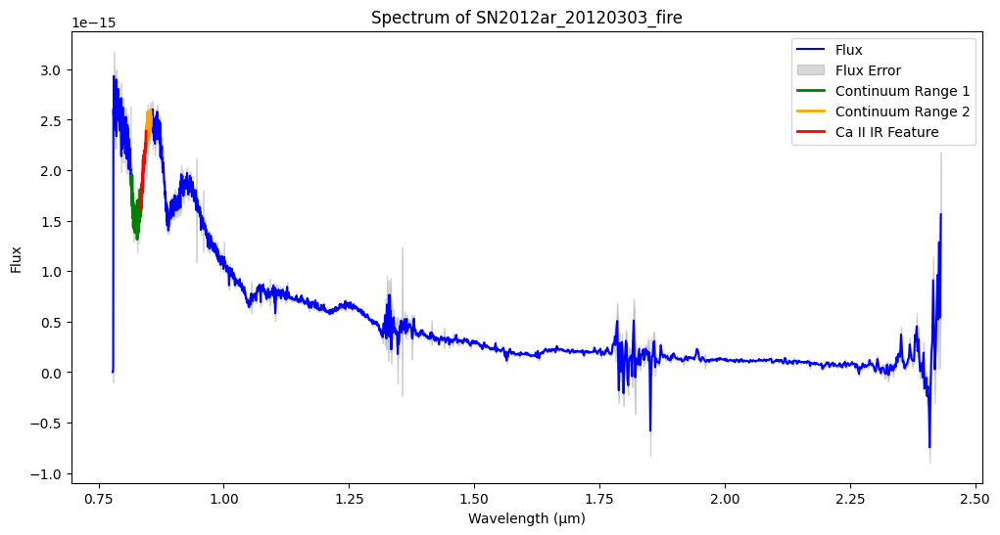

Pseudo-equivalent width for Ca II IR in SN2012ar_20120408_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012ar_20120408_fire: -3804.94 km/s


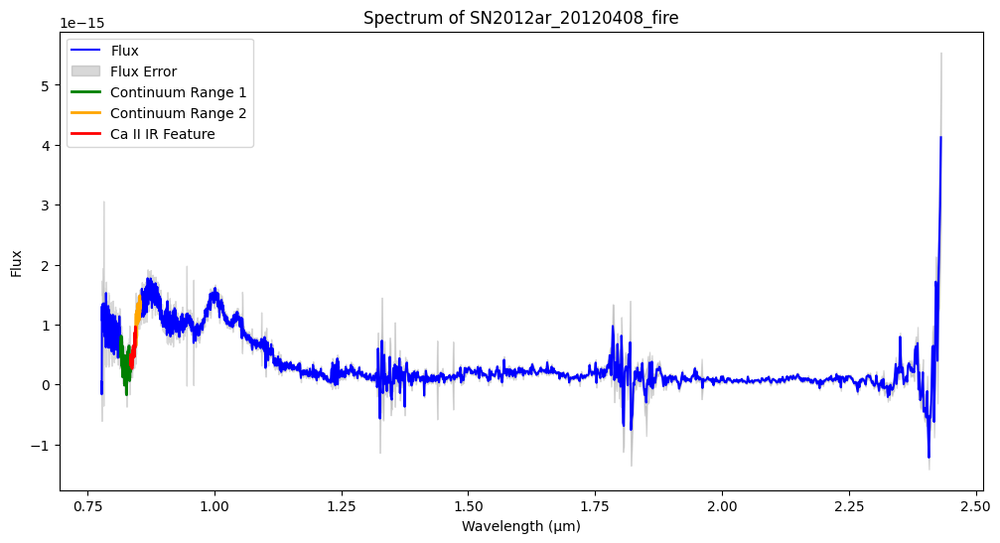

Pseudo-equivalent width for Ca II IR in SN2012ar_20120411_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012ar_20120411_fire: -3655.97 km/s


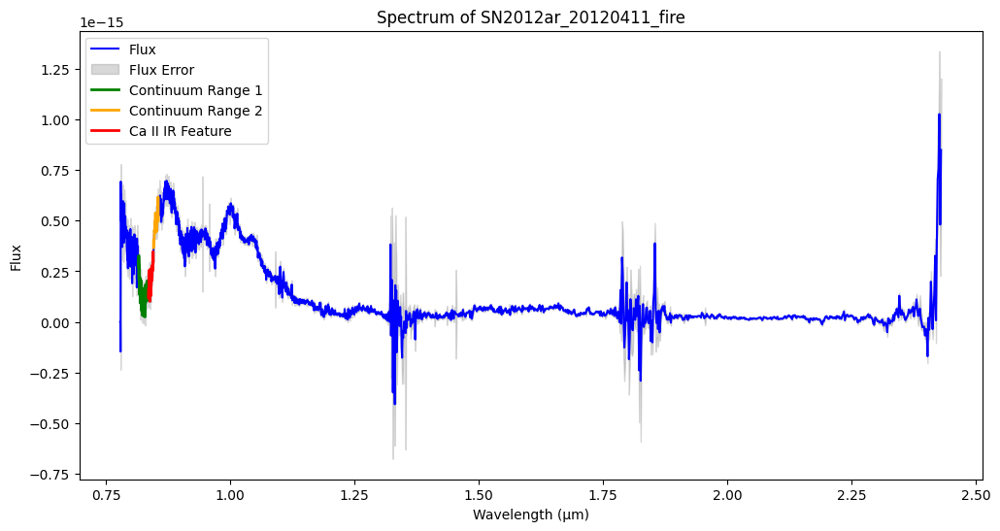

Pseudo-equivalent width for Ca II IR in SN2012ar_20120430_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012ar_20120430_fire: -3875.77 km/s


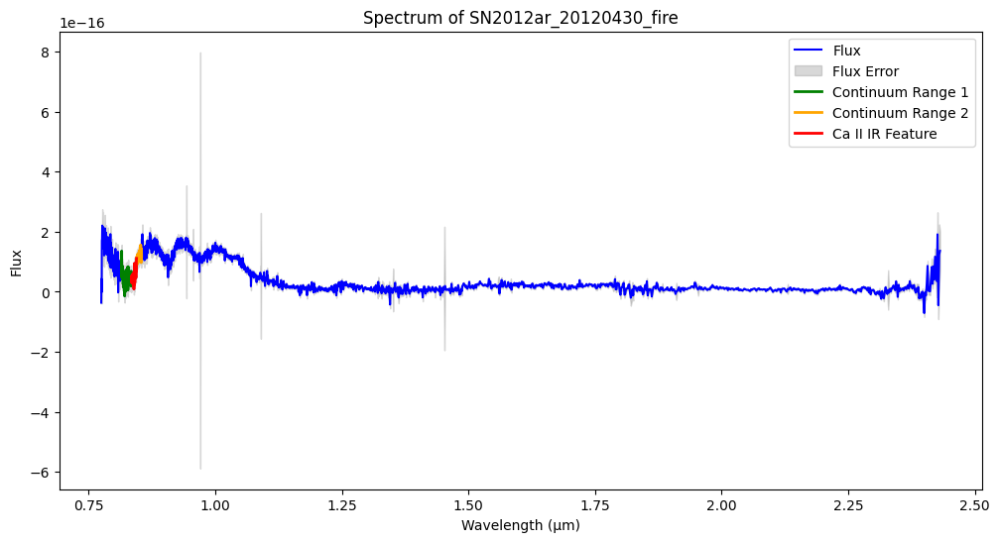

Pseudo-equivalent width for Ca II IR in SN2012bl_20120408_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012bl_20120408_fire: -4186.75 km/s


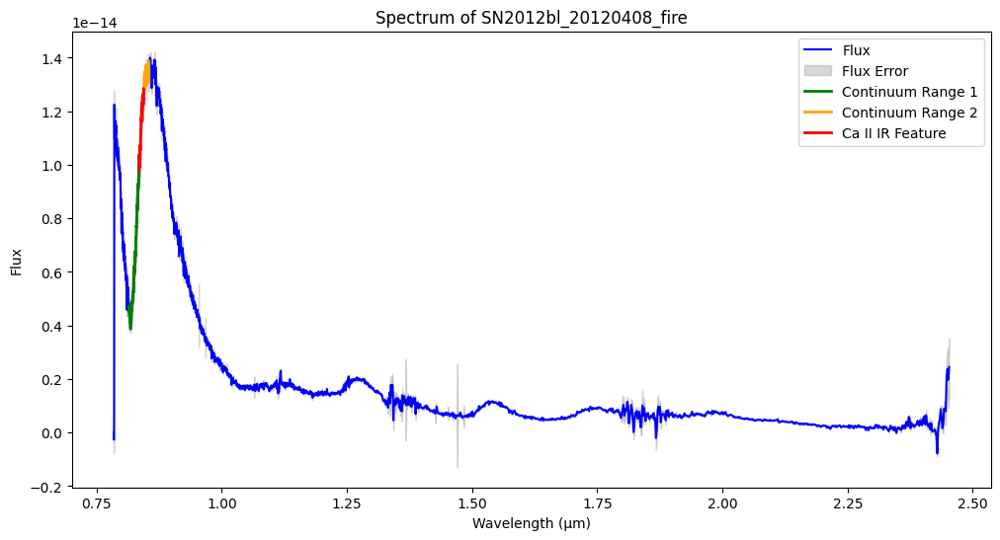

Pseudo-equivalent width for Ca II IR in SN2012bl_20120411_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012bl_20120411_fire: -3741.97 km/s


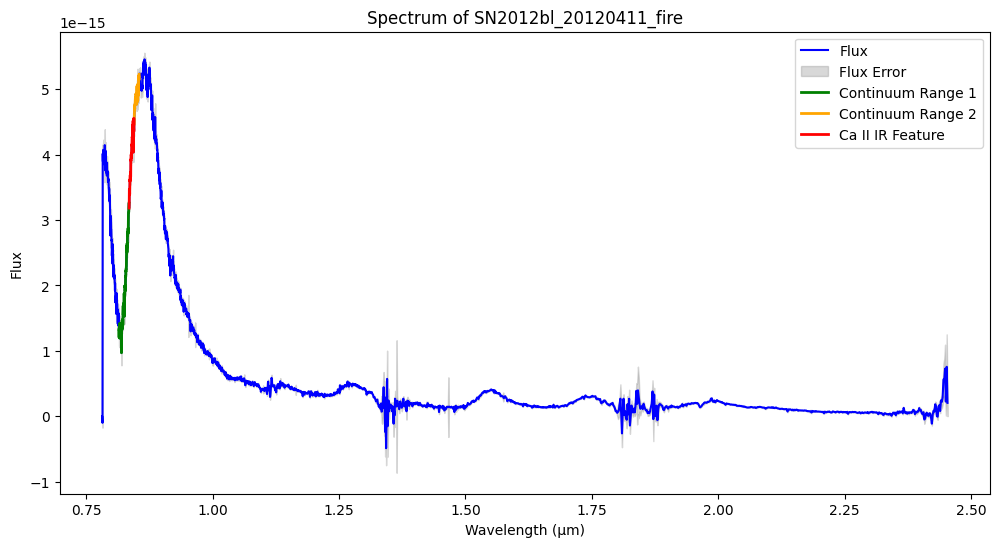

Pseudo-equivalent width for Ca II IR in SN2012bl_20120418_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012bl_20120418_fire: -2984.31 km/s


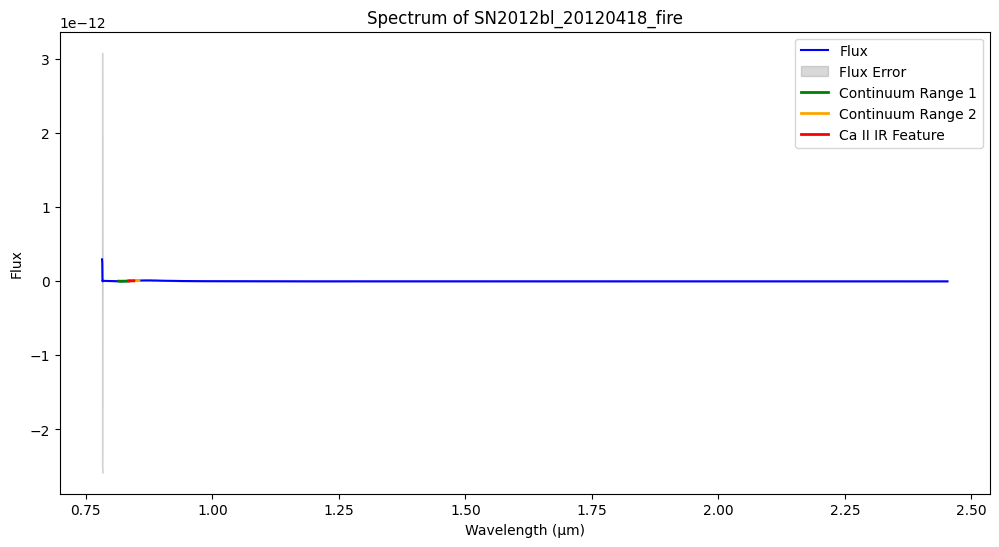

Pseudo-equivalent width for Ca II IR in SN2012bl_20120421_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012bl_20120421_fire: -2774.14 km/s


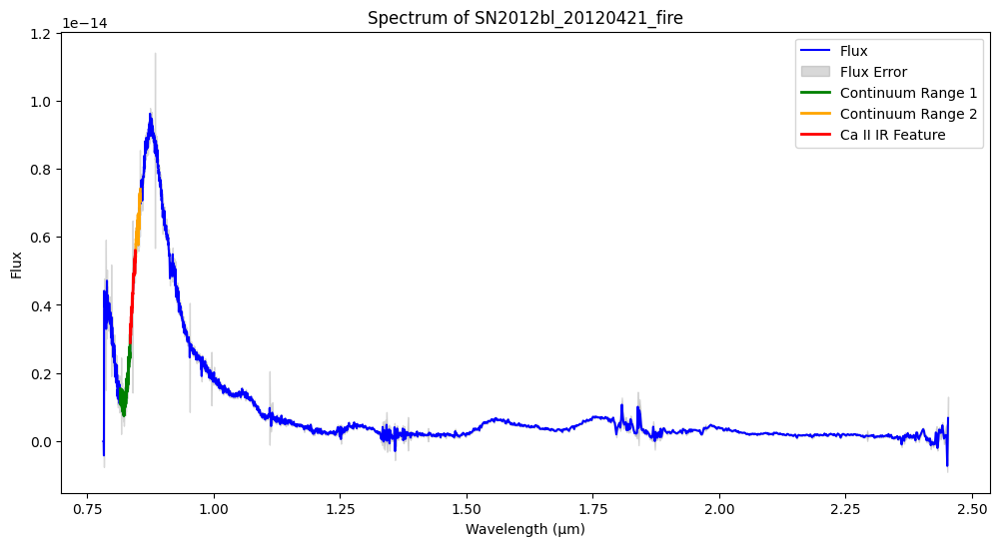

Pseudo-equivalent width for Ca II IR in SN2012bl_20120430_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012bl_20120430_fire: -2331.95 km/s


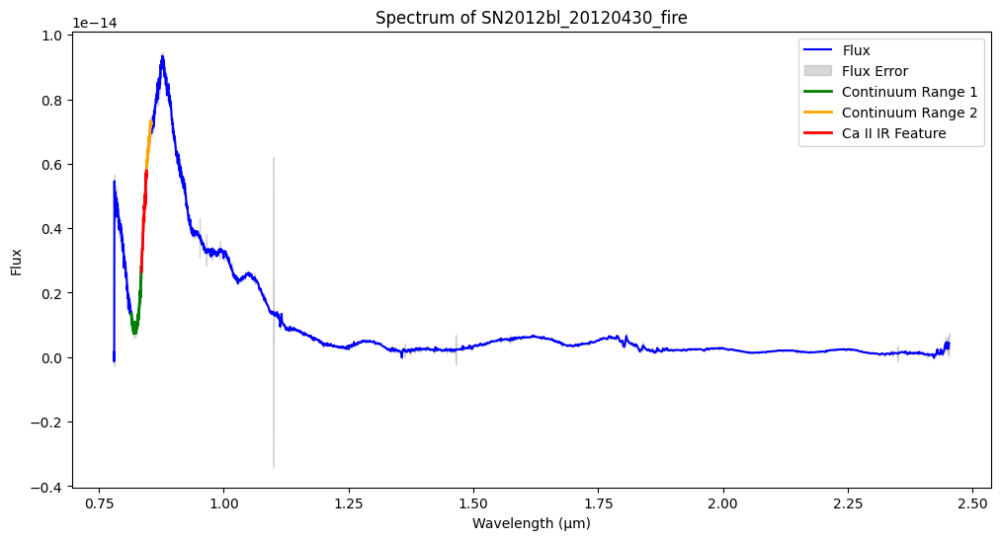

Pseudo-equivalent width for Ca II IR in SN2012bl_20120507_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012bl_20120507_fire: -2245.85 km/s


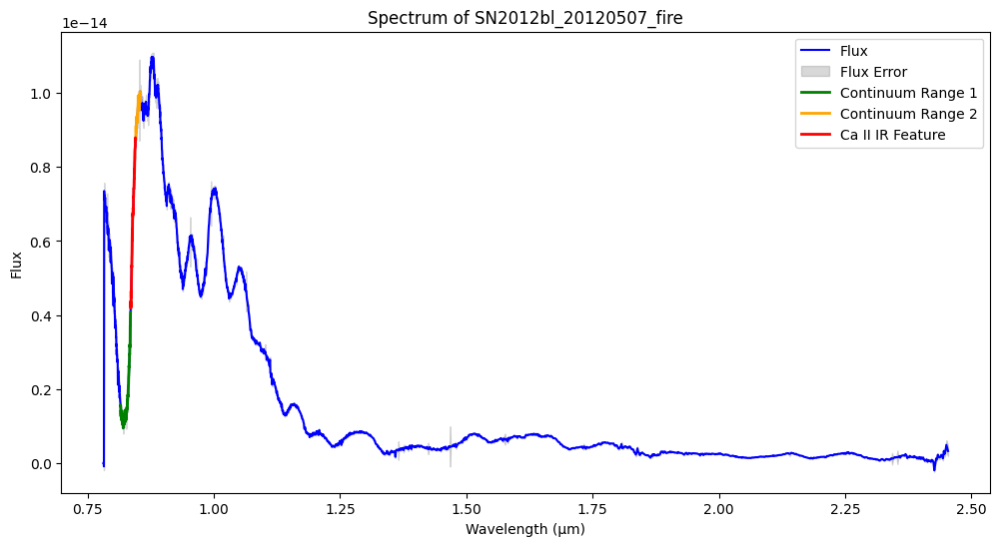

Pseudo-equivalent width for Ca II IR in SN2012bl_20120610_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012bl_20120610_fire: -2893.75 km/s


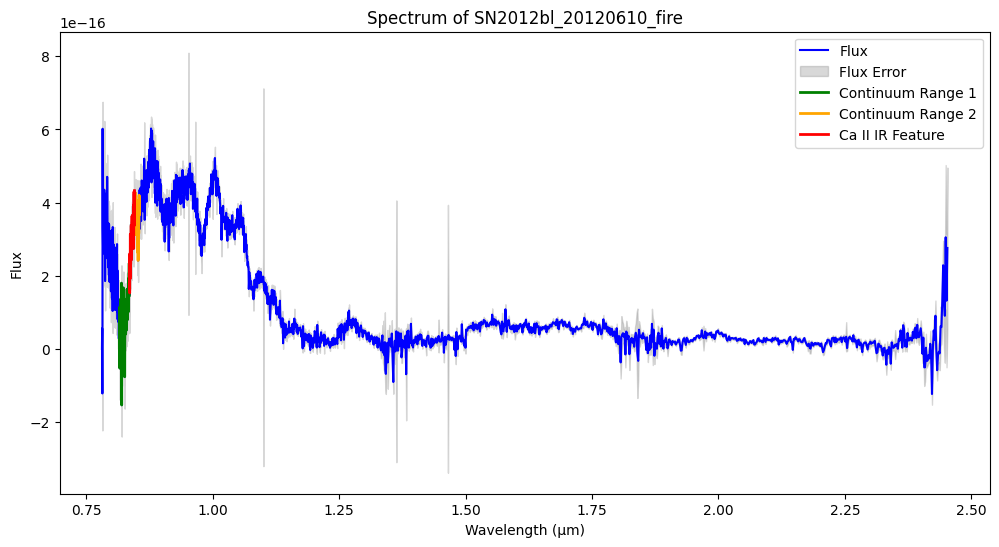

Pseudo-equivalent width for Ca II IR in SN2012bl_20120626_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012bl_20120626_fire: -3453.86 km/s


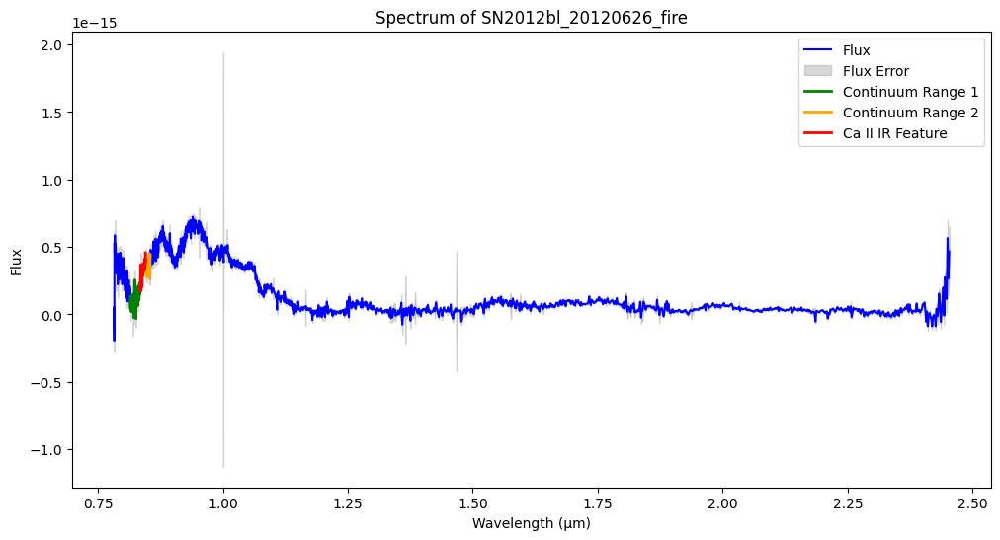

Pseudo-equivalent width for Ca II IR in SN2012bo_20120408_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012bo_20120408_fire: -5047.32 km/s


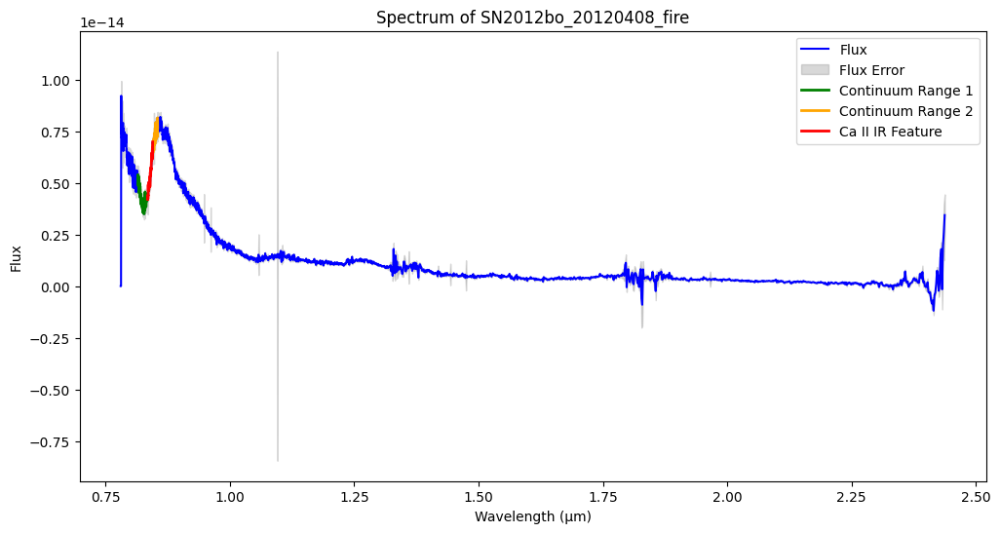

Pseudo-equivalent width for Ca II IR in SN2012bo_20120411_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012bo_20120411_fire: -4535.77 km/s


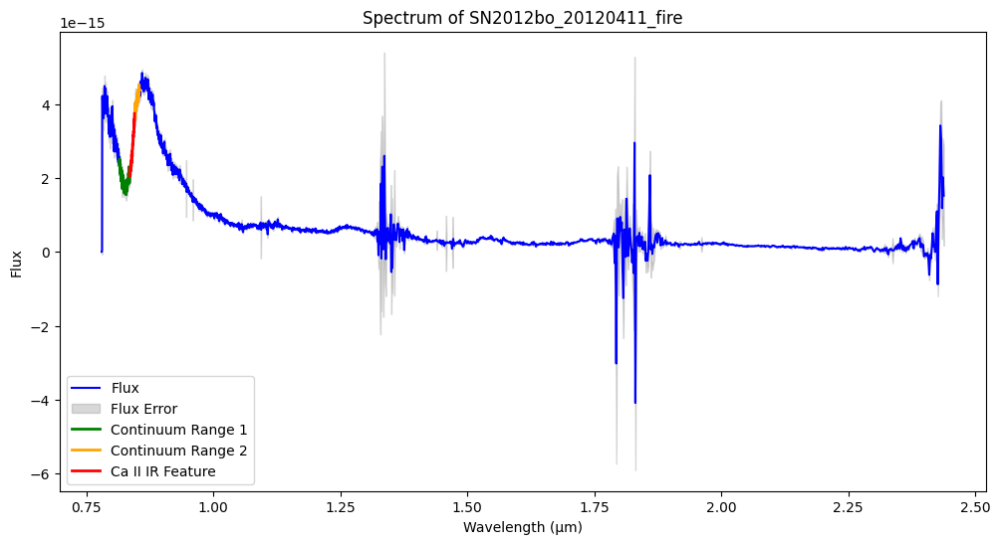

Pseudo-equivalent width for Ca II IR in SN2012bo_20120418_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012bo_20120418_fire: -3752.57 km/s


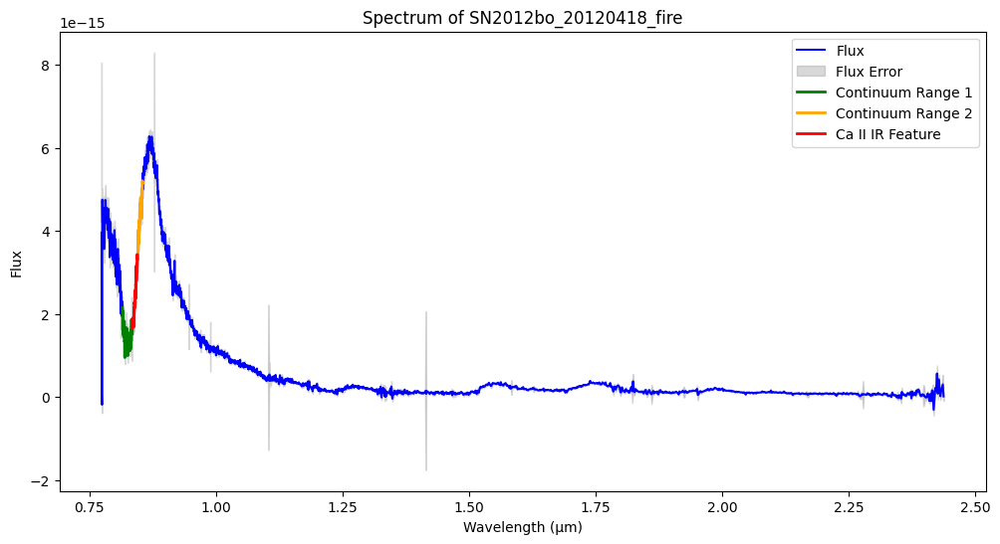

Pseudo-equivalent width for Ca II IR in SN2012bo_20120421_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012bo_20120421_fire: -3538.83 km/s


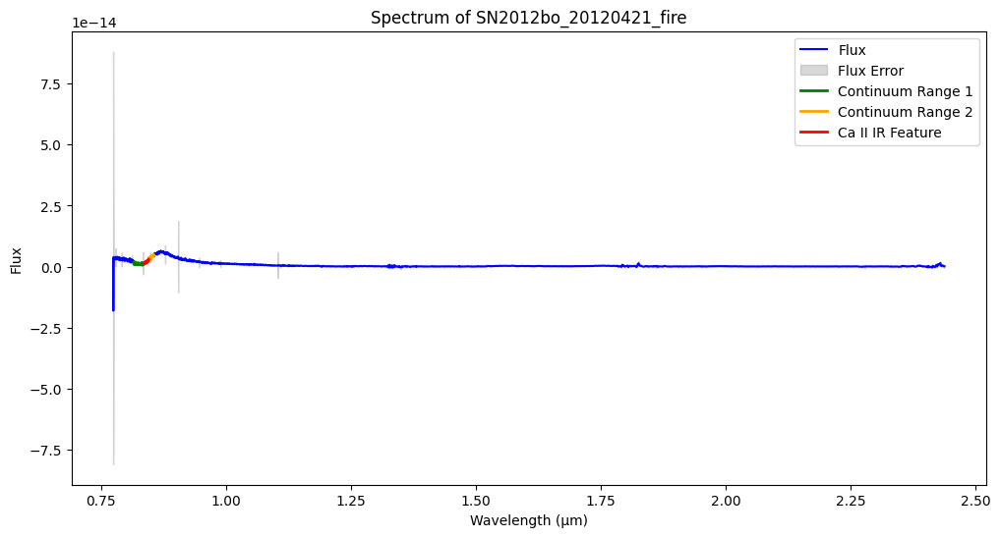

Pseudo-equivalent width for Ca II IR in SN2012bo_20120430_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012bo_20120430_fire: -3611.53 km/s


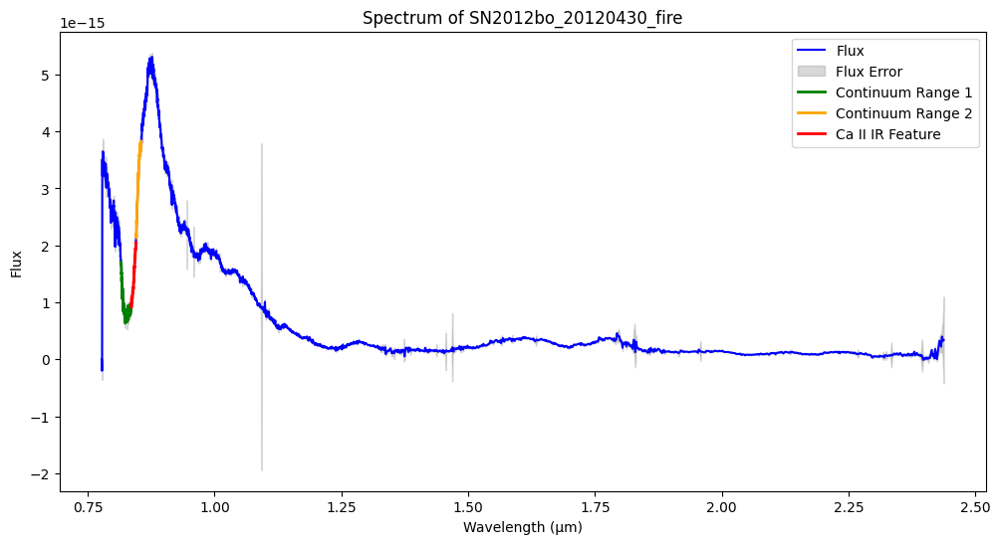

Pseudo-equivalent width for Ca II IR in SN2012bo_20120507_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012bo_20120507_fire: -3260.13 km/s


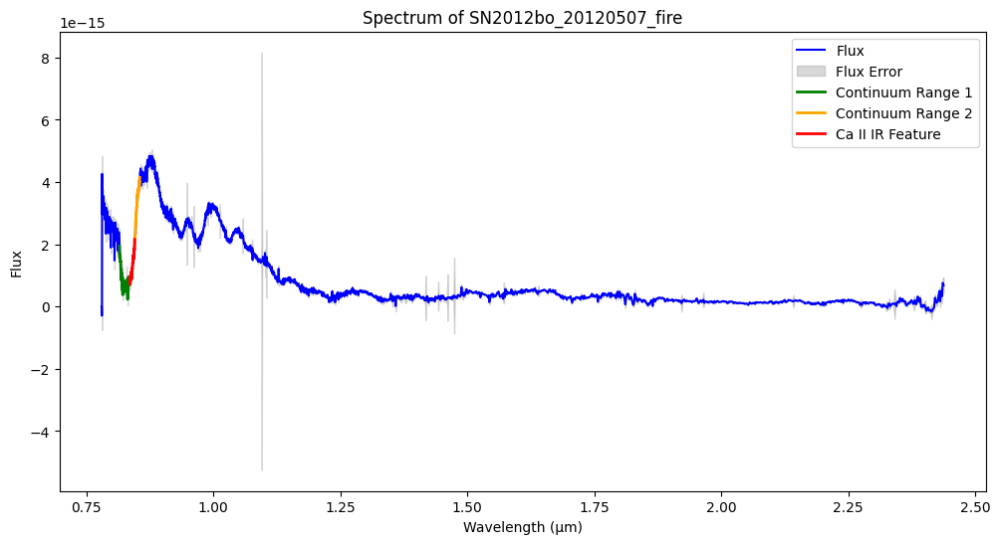

Pseudo-equivalent width for Ca II IR in SN2012fr_20121031_fire: -0.00 Å
Velocity shift for Ca II IR in SN2012fr_20121031_fire: -5800.60 km/s


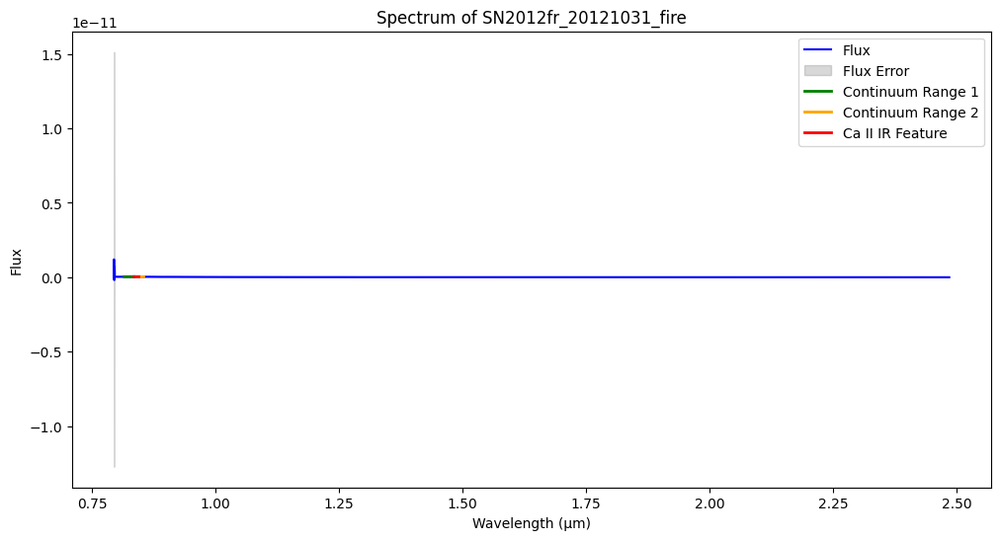

Pseudo-equivalent width for Ca II IR in SN2012fr_20121102_fire: -0.00 Å
Velocity shift for Ca II IR in SN2012fr_20121102_fire: -5921.72 km/s


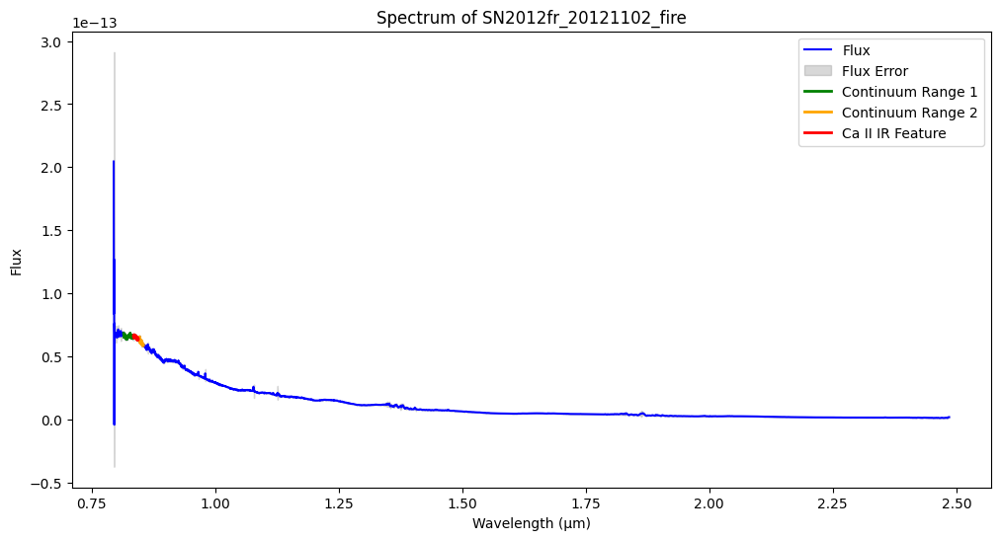

Pseudo-equivalent width for Ca II IR in SN2012fr_20121103_fire: -0.00 Å
Velocity shift for Ca II IR in SN2012fr_20121103_fire: -5992.06 km/s


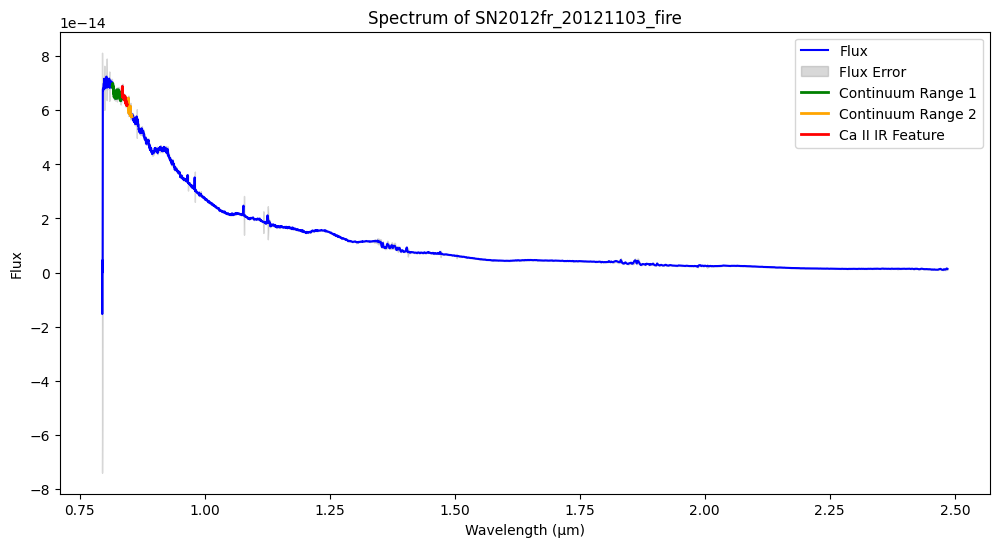

Pseudo-equivalent width for Ca II IR in SN2012fr_20121104_fire: -0.00 Å
Velocity shift for Ca II IR in SN2012fr_20121104_fire: -6078.79 km/s


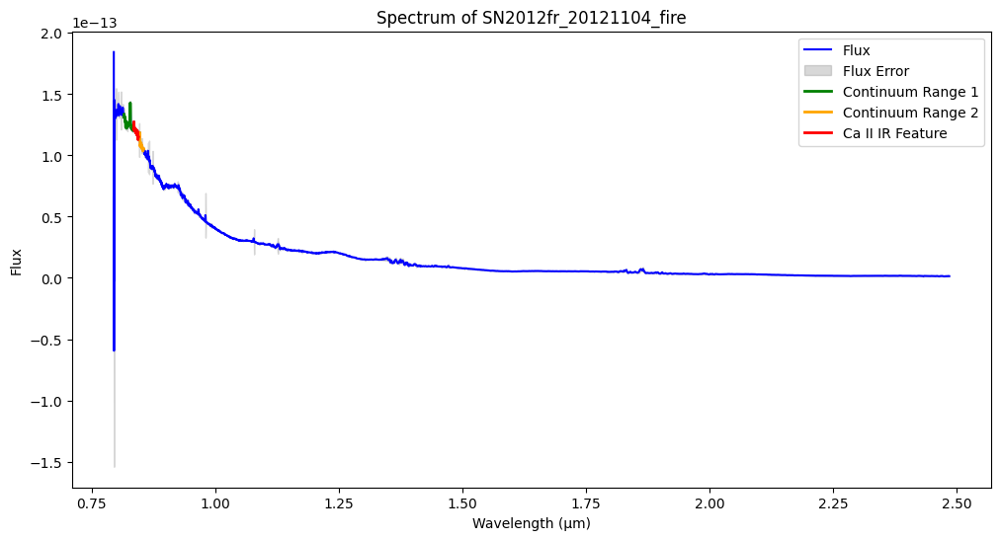

Pseudo-equivalent width for Ca II IR in SN2012fr_20121105_fire: -0.00 Å
Velocity shift for Ca II IR in SN2012fr_20121105_fire: -5865.18 km/s


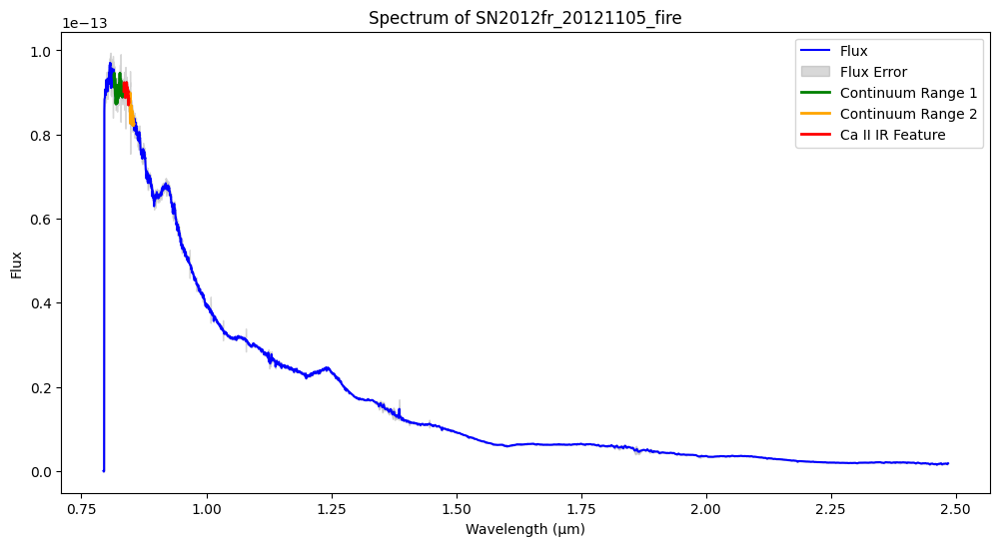

Pseudo-equivalent width for Ca II IR in SN2012fr_20121107_fire: -0.00 Å
Velocity shift for Ca II IR in SN2012fr_20121107_fire: -5776.25 km/s


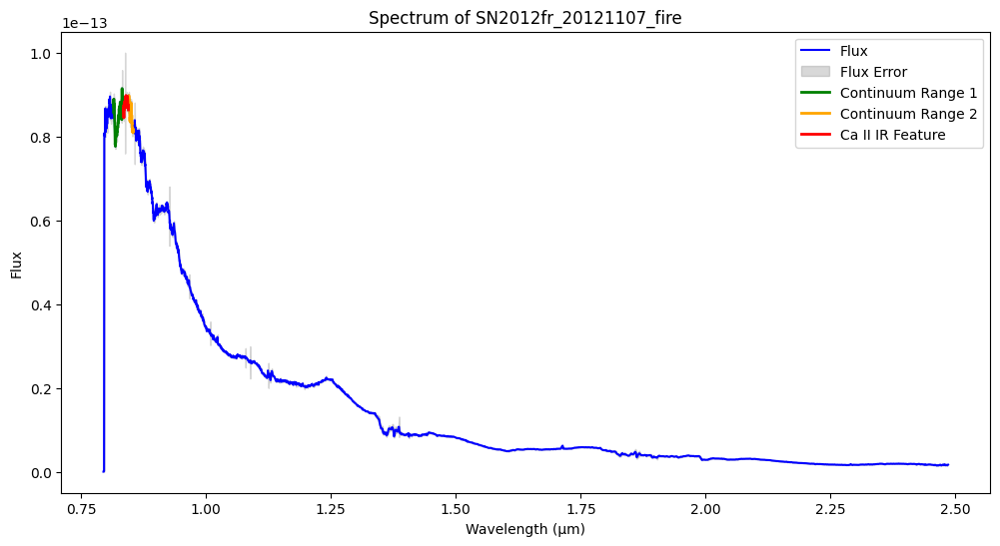

Pseudo-equivalent width for Ca II IR in SN2012fr_20121108_fire: -0.00 Å
Velocity shift for Ca II IR in SN2012fr_20121108_fire: -5708.31 km/s


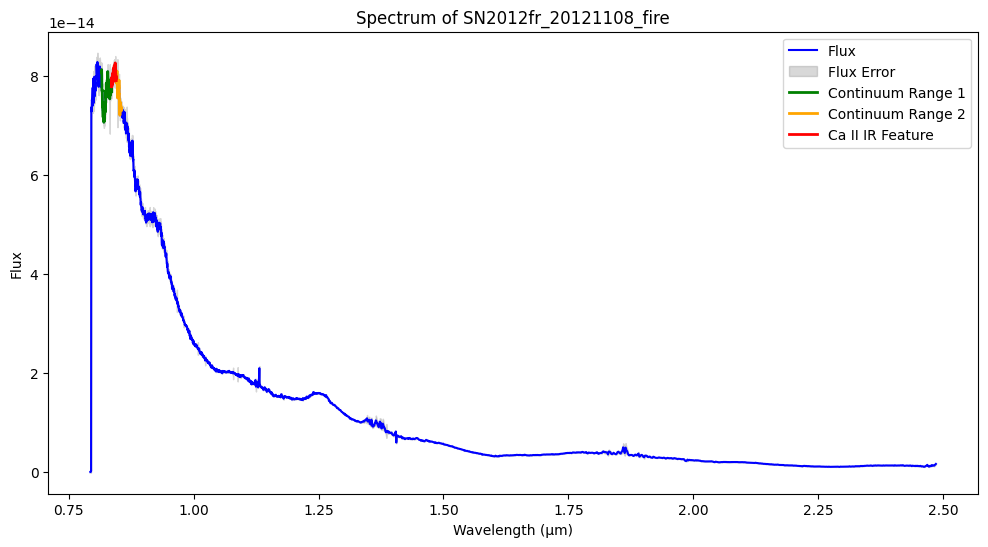

Pseudo-equivalent width for Ca II IR in SN2012fr_20121111_fire: 0.00 Å
Velocity shift for Ca II IR in SN2012fr_20121111_fire: -5465.89 km/s


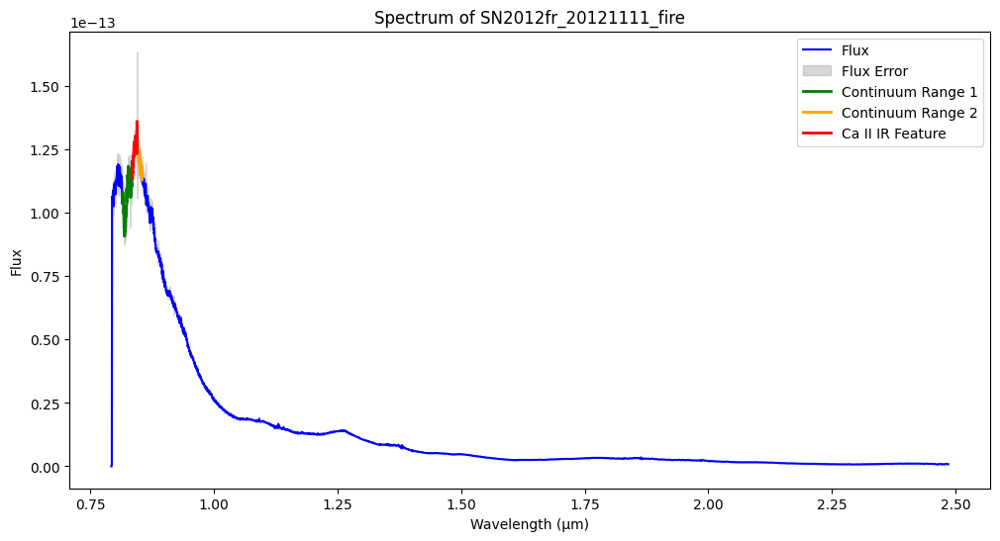

Pseudo-equivalent width for Ca II IR in SN2012fr_20121114_fire: 0.00 Å
Velocity shift for Ca II IR in SN2012fr_20121114_fire: -4875.30 km/s


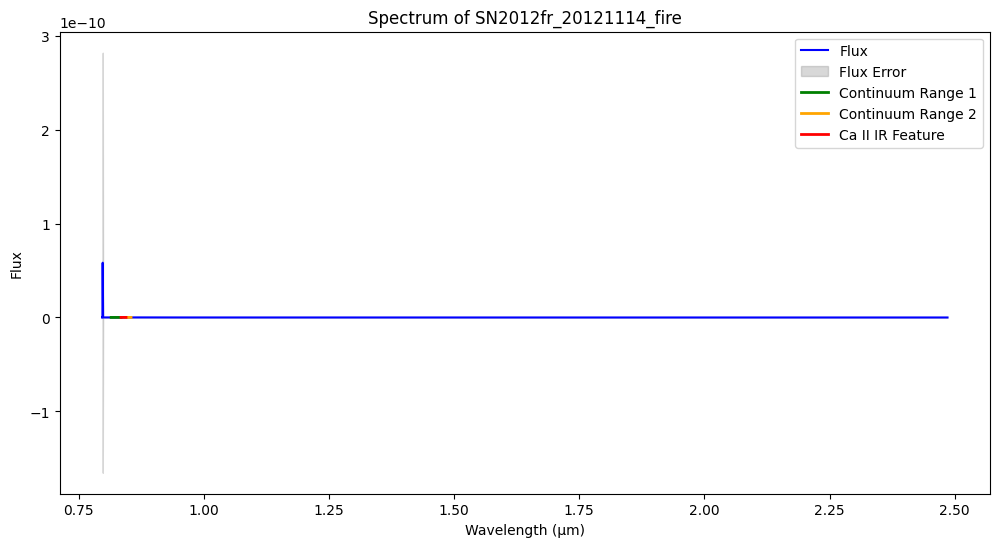

Pseudo-equivalent width for Ca II IR in SN2012fr_20121116_fire: 0.00 Å
Velocity shift for Ca II IR in SN2012fr_20121116_fire: -4568.22 km/s


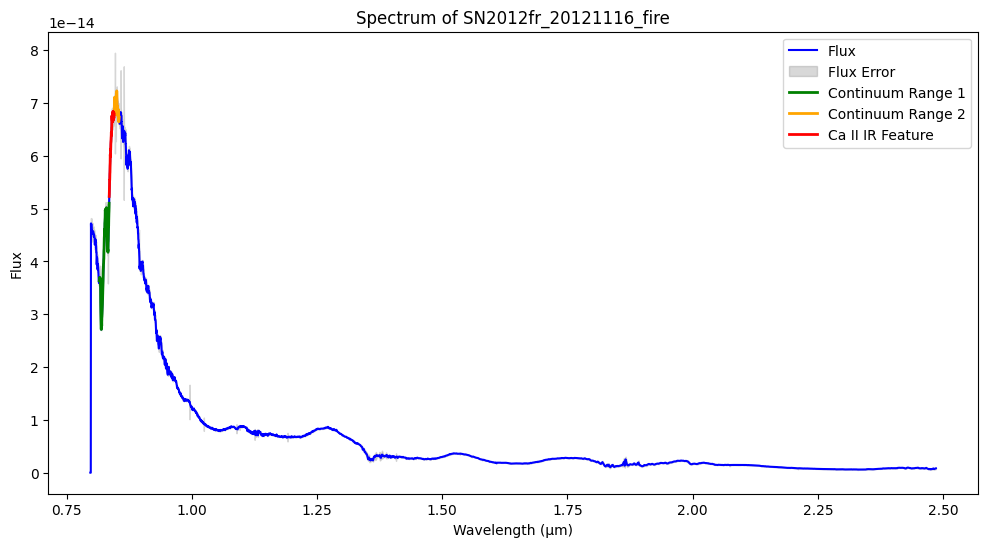

Pseudo-equivalent width for Ca II IR in SN2012fr_20121119_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012fr_20121119_fire: -4202.21 km/s


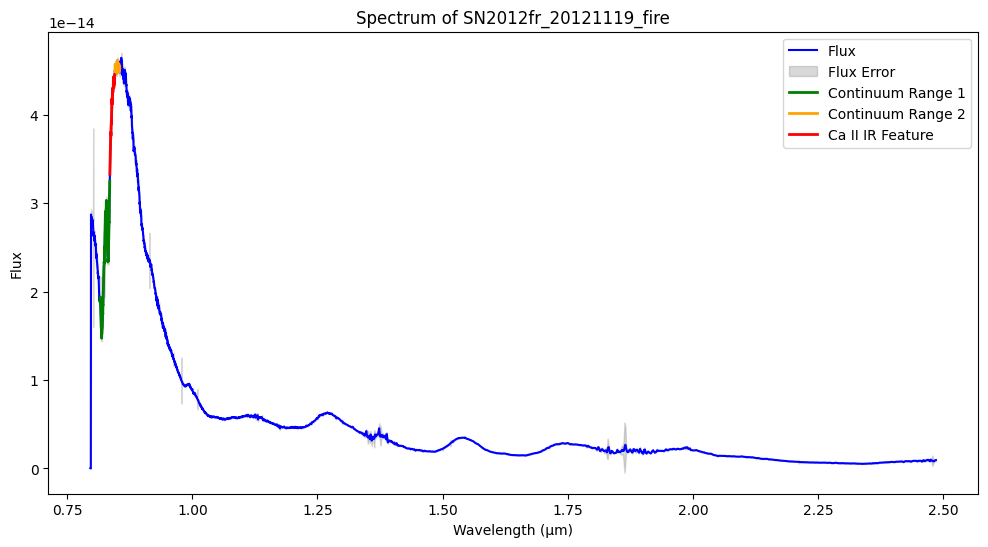

Pseudo-equivalent width for Ca II IR in SN2012fr_20121120_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012fr_20121120_fire: -4108.87 km/s


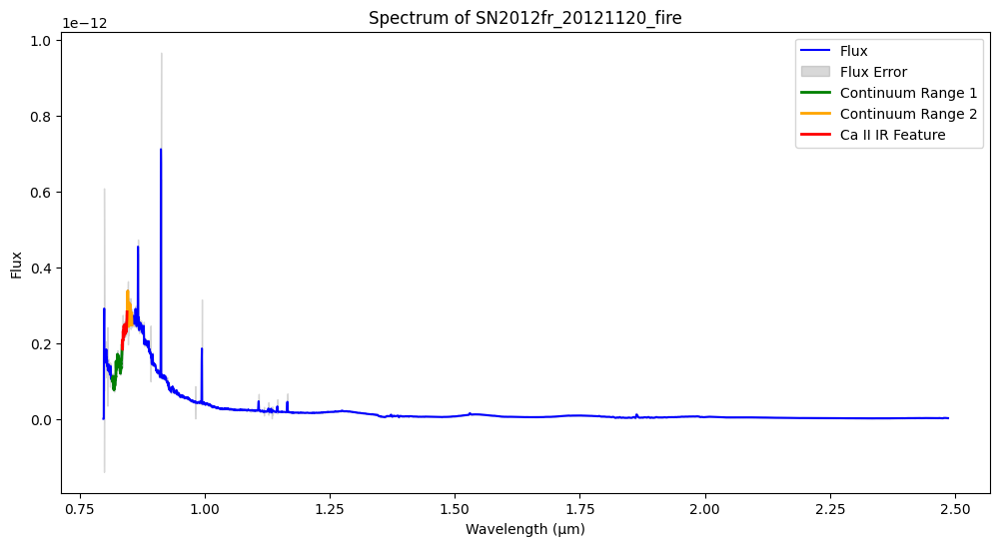

Pseudo-equivalent width for Ca II IR in SN2012fr_20121121_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012fr_20121121_fire: -4104.62 km/s


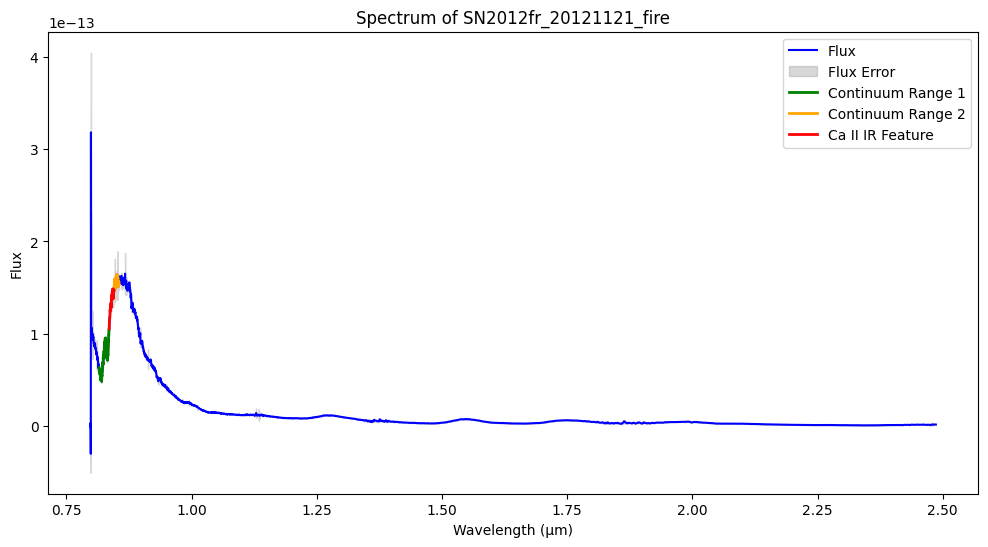

Pseudo-equivalent width for Ca II IR in SN2012fr_20121125_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012fr_20121125_fire: -3489.93 km/s


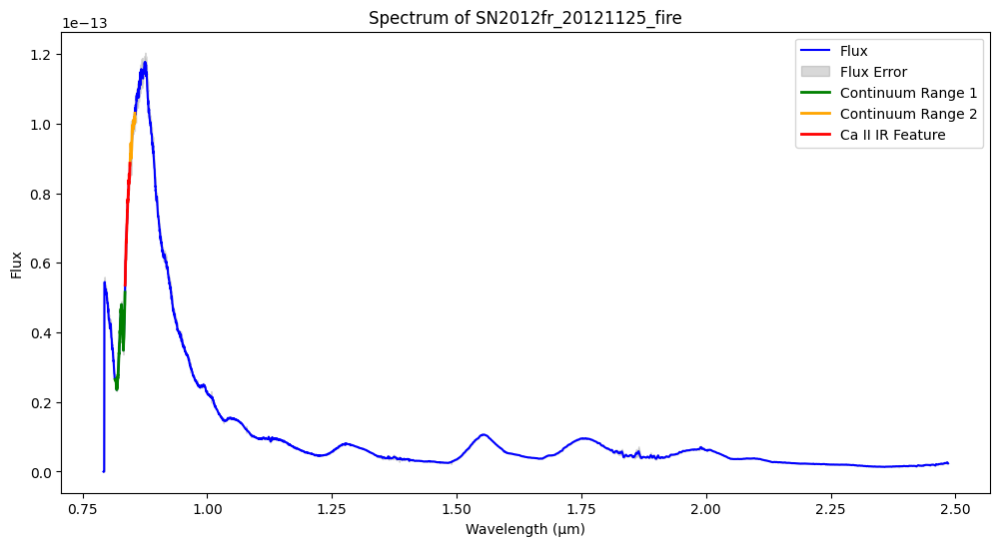

Pseudo-equivalent width for Ca II IR in SN2012fr_20121128_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012fr_20121128_fire: -3212.93 km/s


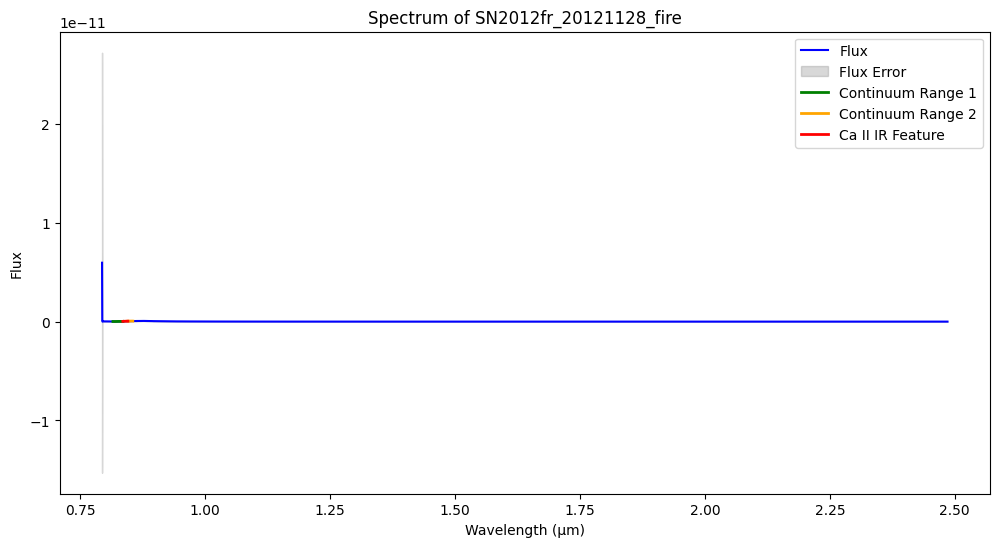

Pseudo-equivalent width for Ca II IR in SN2012fr_20121201_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012fr_20121201_fire: -3235.00 km/s


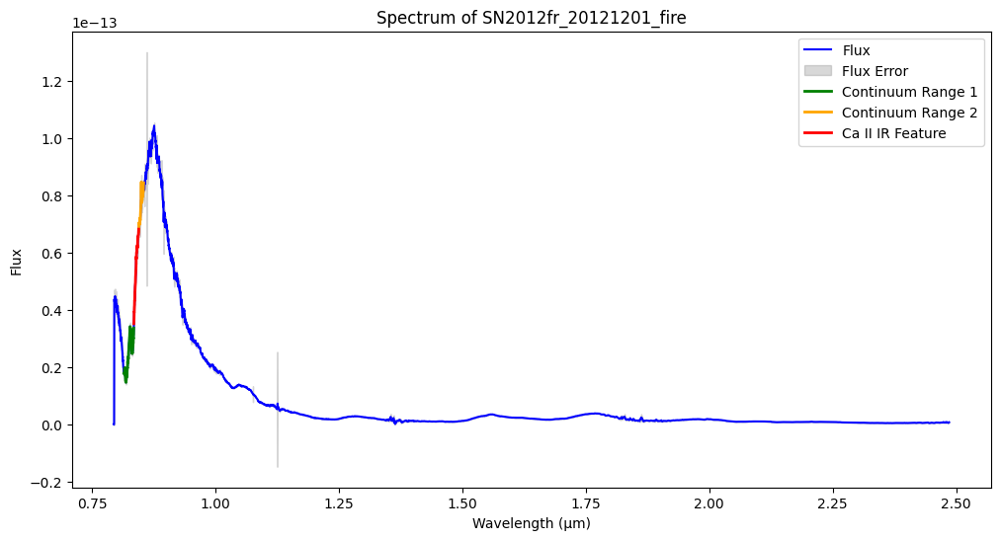

Pseudo-equivalent width for Ca II IR in SN2012fr_20121203_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012fr_20121203_fire: -2965.10 km/s


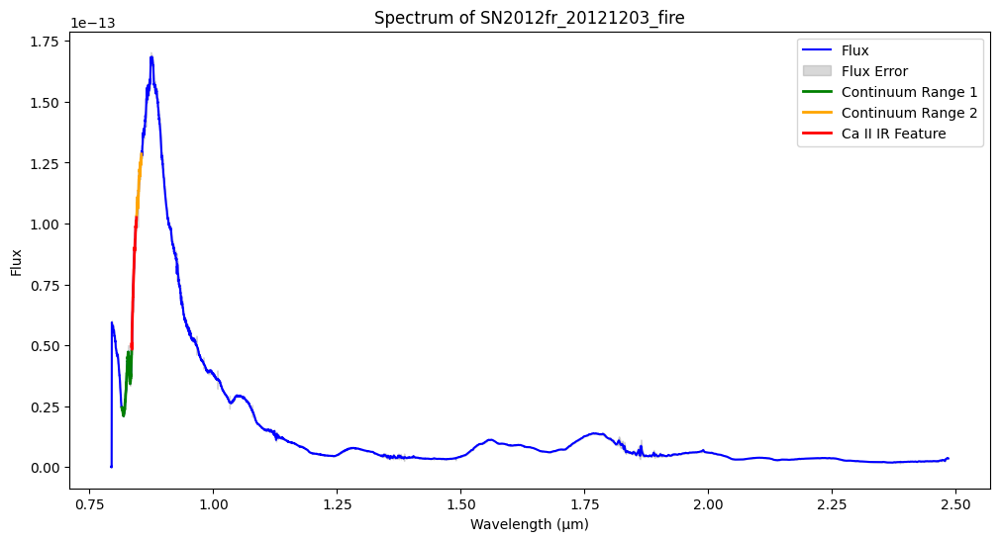

Pseudo-equivalent width for Ca II IR in SN2012fr_20121213_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012fr_20121213_fire: -2602.72 km/s


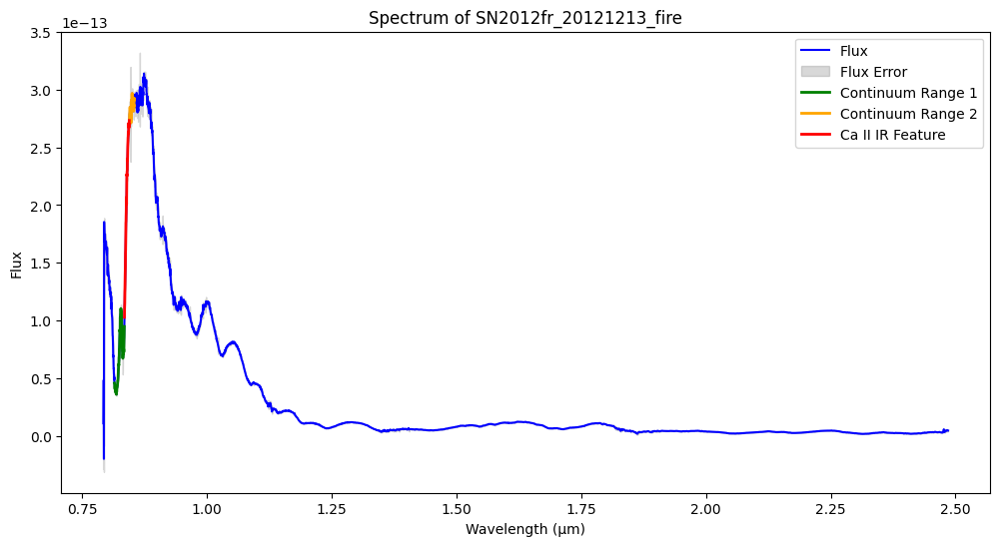

Pseudo-equivalent width for Ca II IR in SN2012fr_20121220_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012fr_20121220_fire: -2607.18 km/s


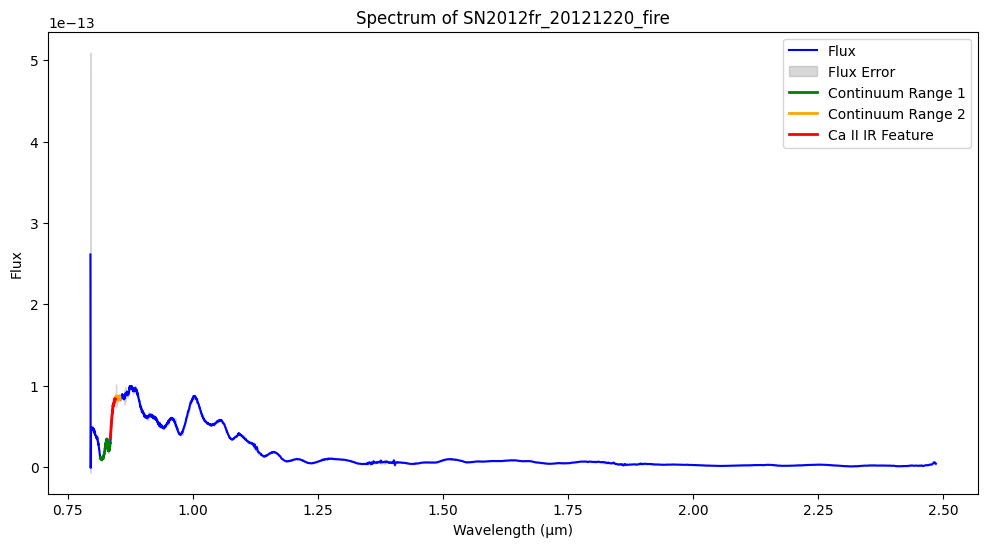

Pseudo-equivalent width for Ca II IR in SN2012fr_20121227_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012fr_20121227_fire: -2771.32 km/s


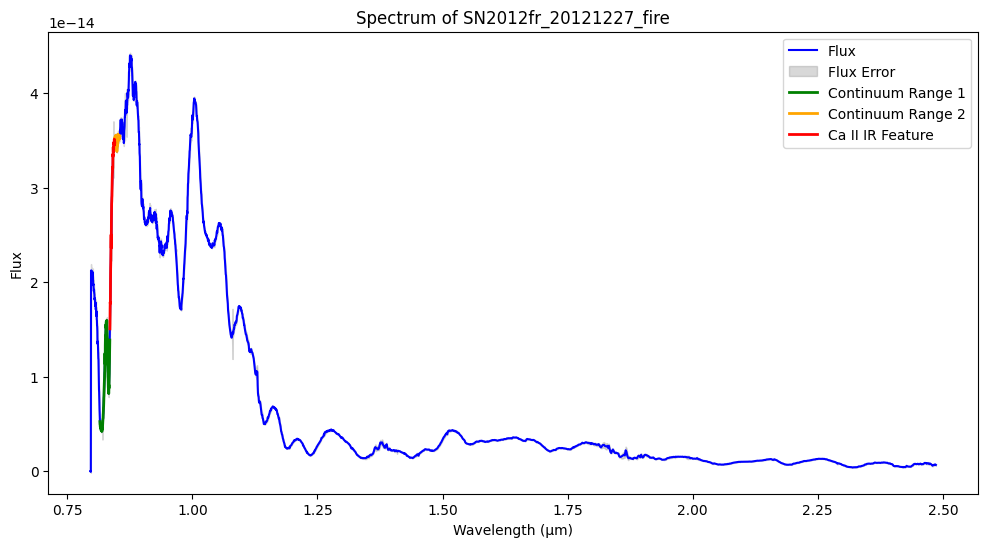

Pseudo-equivalent width for Ca II IR in SN2012fr_20121230_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012fr_20121230_fire: -2901.24 km/s


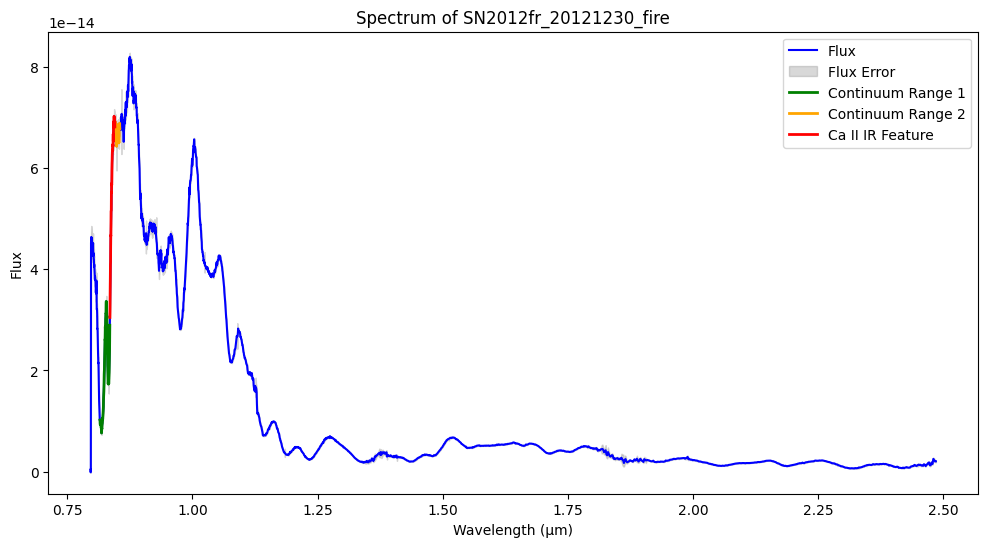

Pseudo-equivalent width for Ca II IR in SN2012fr_20130103_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012fr_20130103_fire: -2891.54 km/s


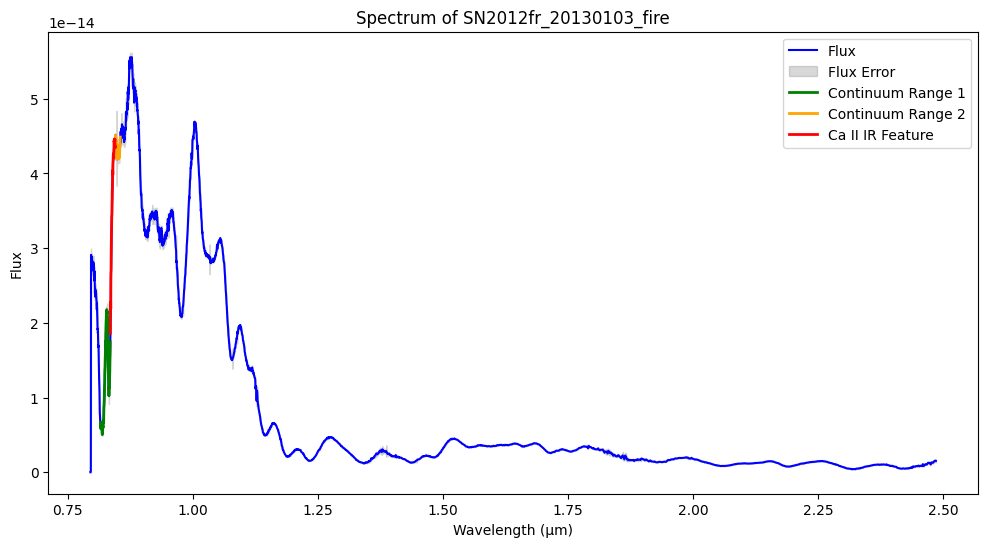

Pseudo-equivalent width for Ca II IR in SN2012fr_20130106_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012fr_20130106_fire: -2885.25 km/s


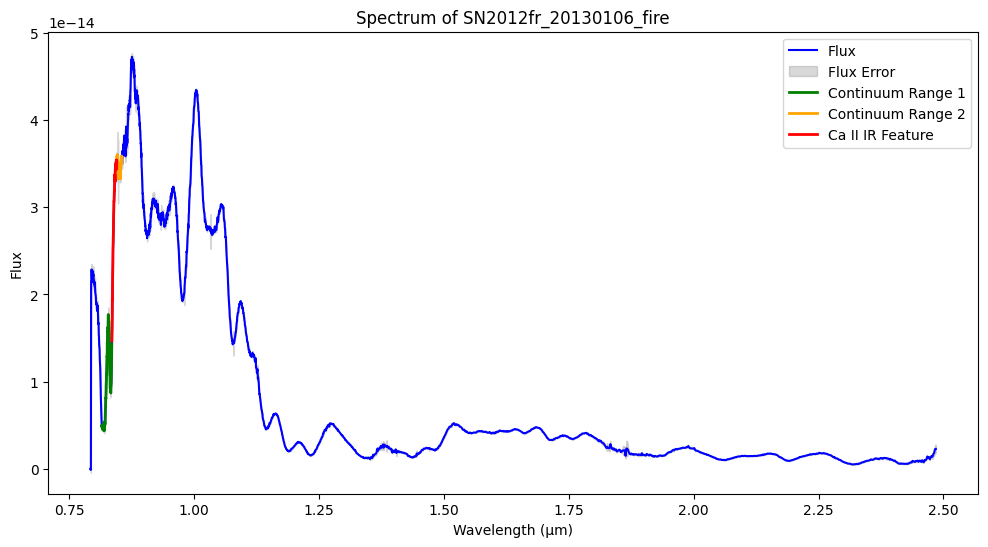

Pseudo-equivalent width for Ca II IR in SN2012fr_20130111_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012fr_20130111_fire: -3084.87 km/s


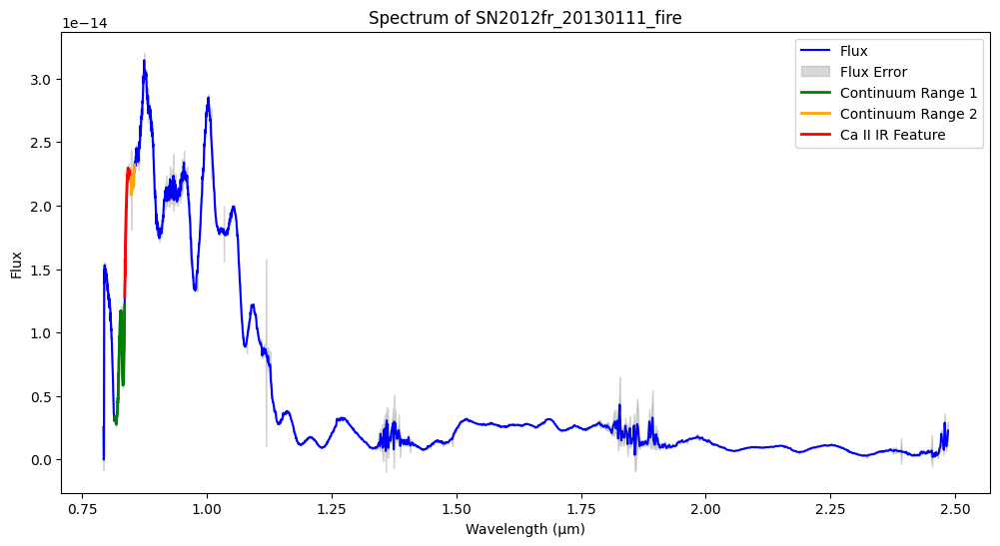

Pseudo-equivalent width for Ca II IR in SN2012fr_20130202_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012fr_20130202_fire: -3504.40 km/s


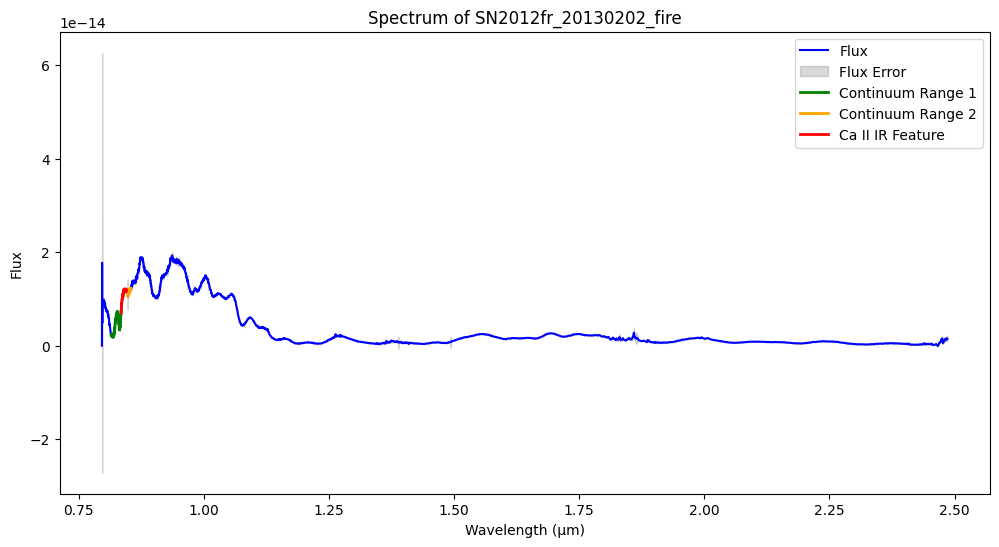

Pseudo-equivalent width for Ca II IR in SN2012fr_20130216_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012fr_20130216_fire: -3758.50 km/s


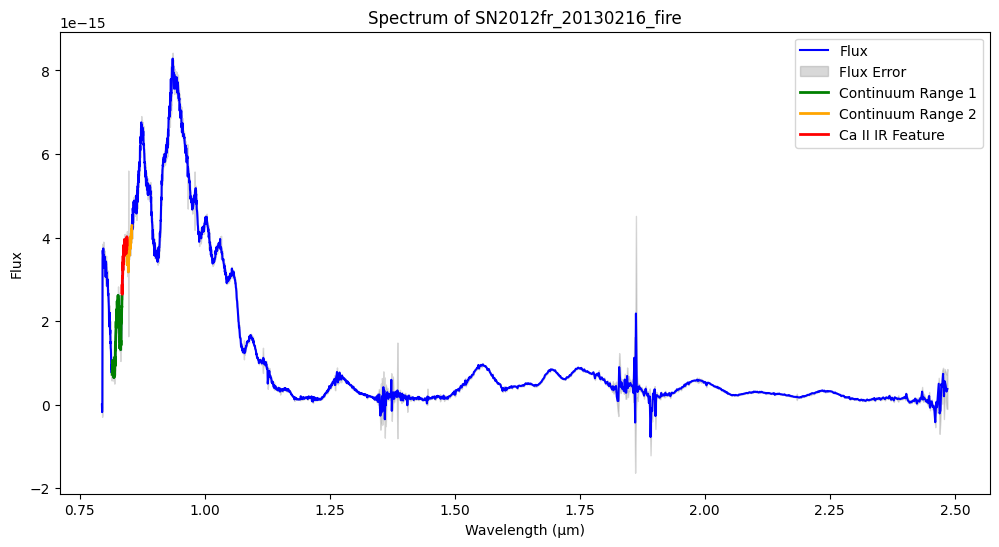

Pseudo-equivalent width for Ca II IR in SN2012gm_20121125_fire: 0.00 Å
Velocity shift for Ca II IR in SN2012gm_20121125_fire: -5782.31 km/s


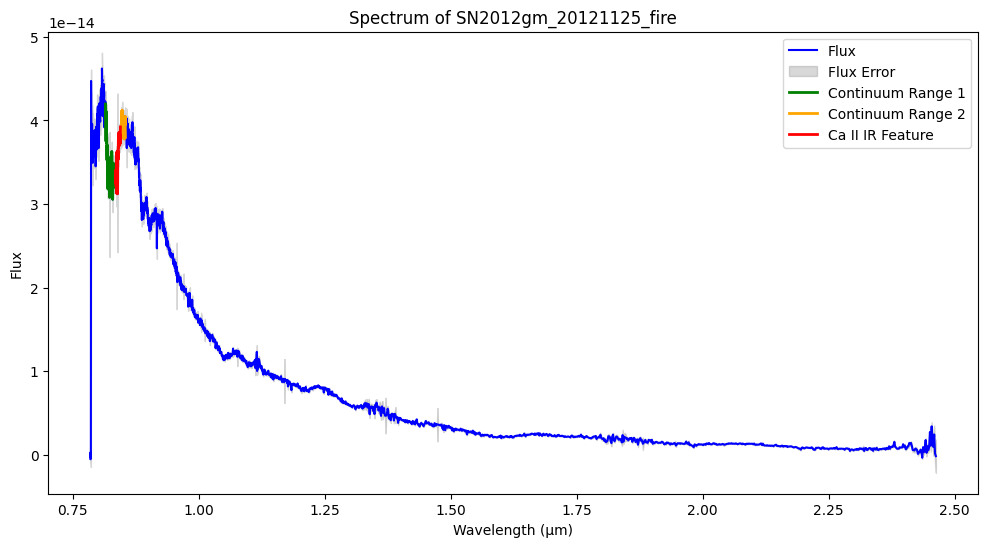

Pseudo-equivalent width for Ca II IR in SN2012gm_20121203_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012gm_20121203_fire: -4884.12 km/s


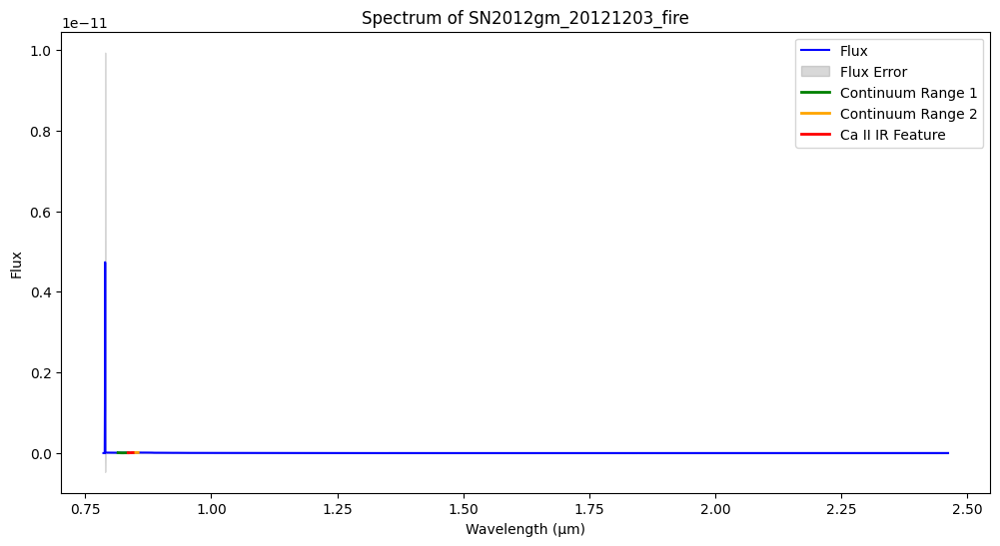

Pseudo-equivalent width for Ca II IR in SN2012hd_20121125_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012hd_20121125_fire: -4540.00 km/s


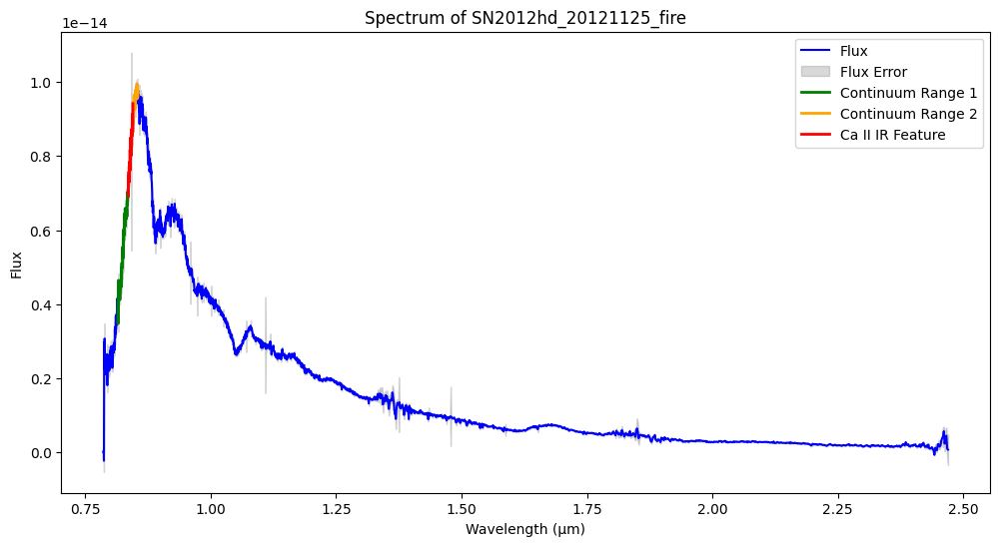

Pseudo-equivalent width for Ca II IR in SN2012hd_20121203_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012hd_20121203_fire: -4413.01 km/s


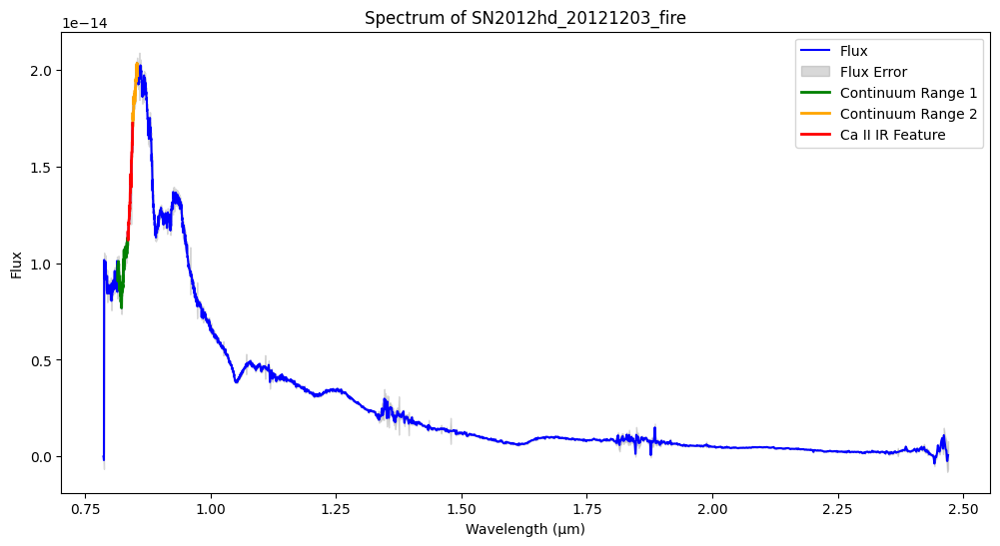

Pseudo-equivalent width for Ca II IR in SN2012hd_20121227_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012hd_20121227_fire: -3716.13 km/s


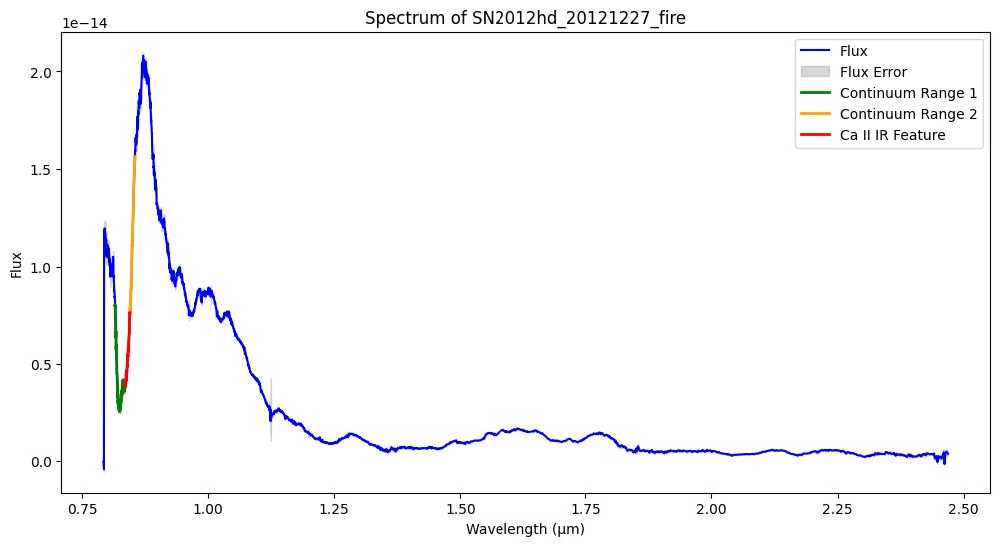

Pseudo-equivalent width for Ca II IR in SN2012hd_20130103_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012hd_20130103_fire: -3250.30 km/s


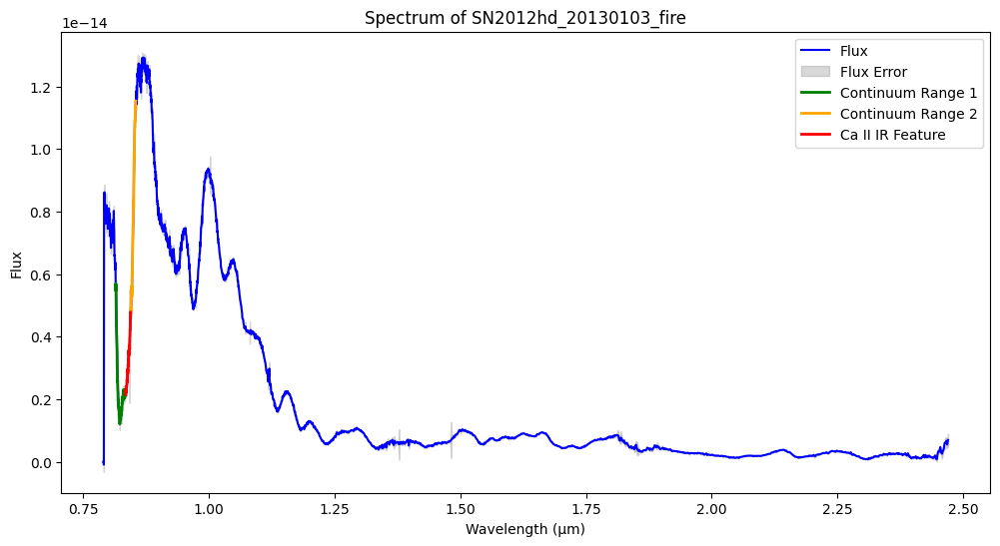

Pseudo-equivalent width for Ca II IR in SN2012hd_20130106_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012hd_20130106_fire: -3061.28 km/s


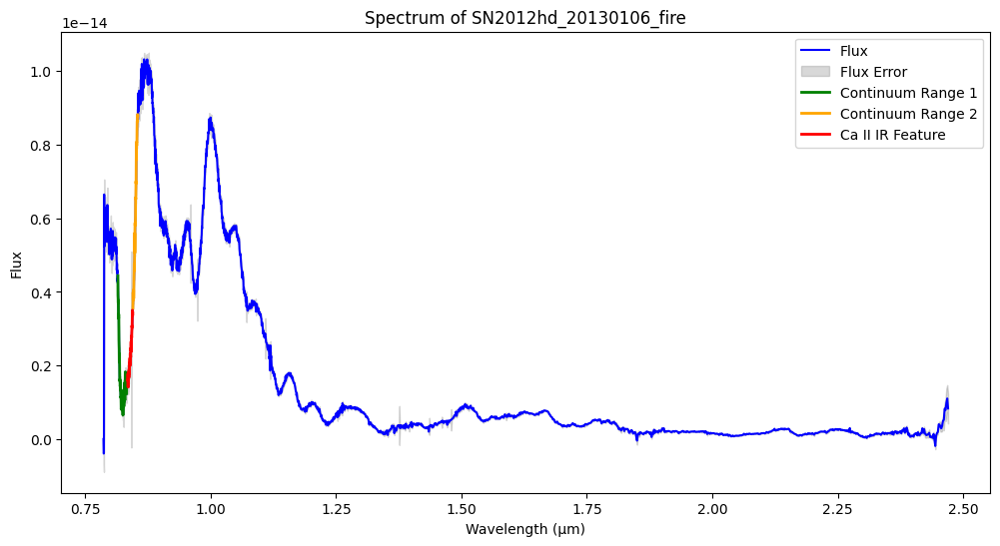

Pseudo-equivalent width for Ca II IR in SN2012hr_20121220_fire: 0.00 Å
Velocity shift for Ca II IR in SN2012hr_20121220_fire: -4487.88 km/s


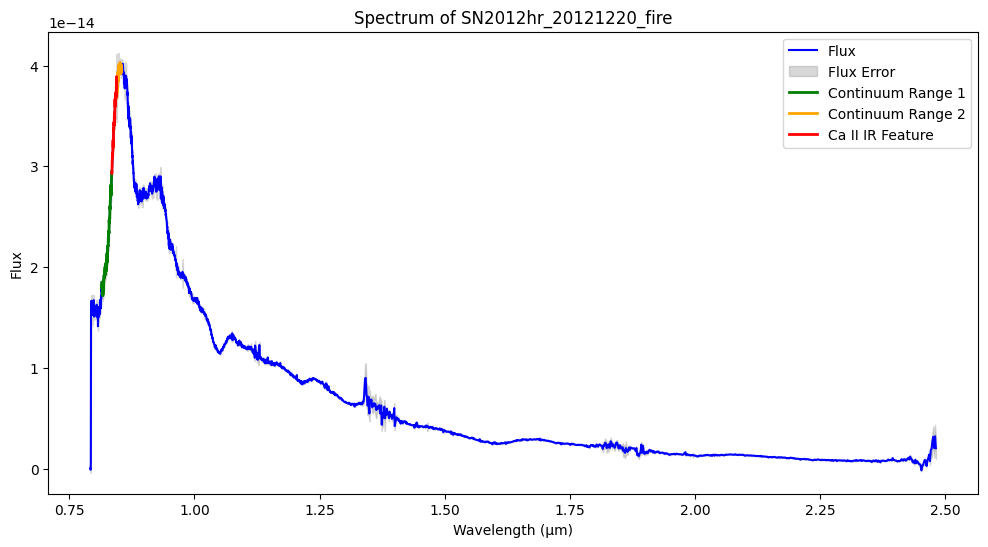

Pseudo-equivalent width for Ca II IR in SN2012hr_20121227_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012hr_20121227_fire: -3947.44 km/s


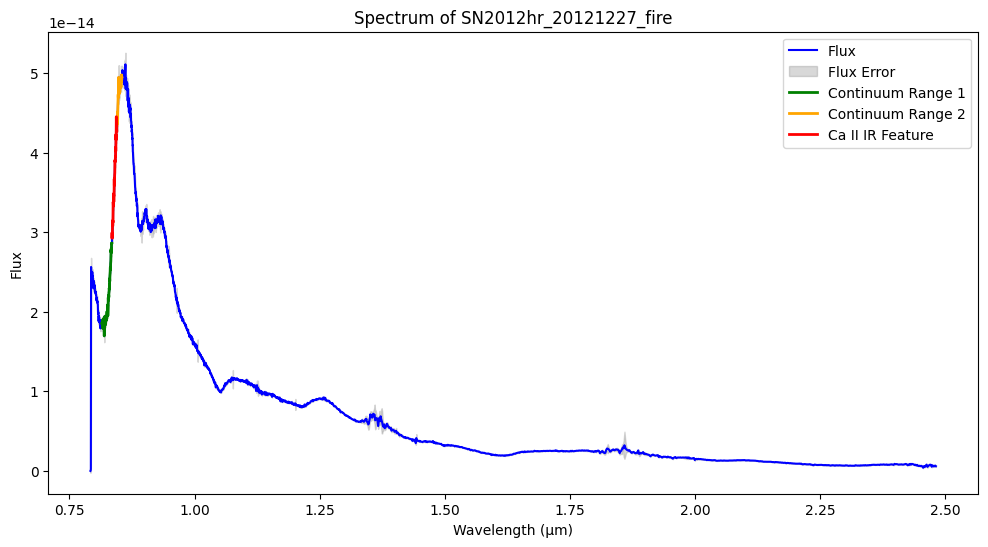

Pseudo-equivalent width for Ca II IR in SN2012hr_20121230_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012hr_20121230_fire: -3631.73 km/s


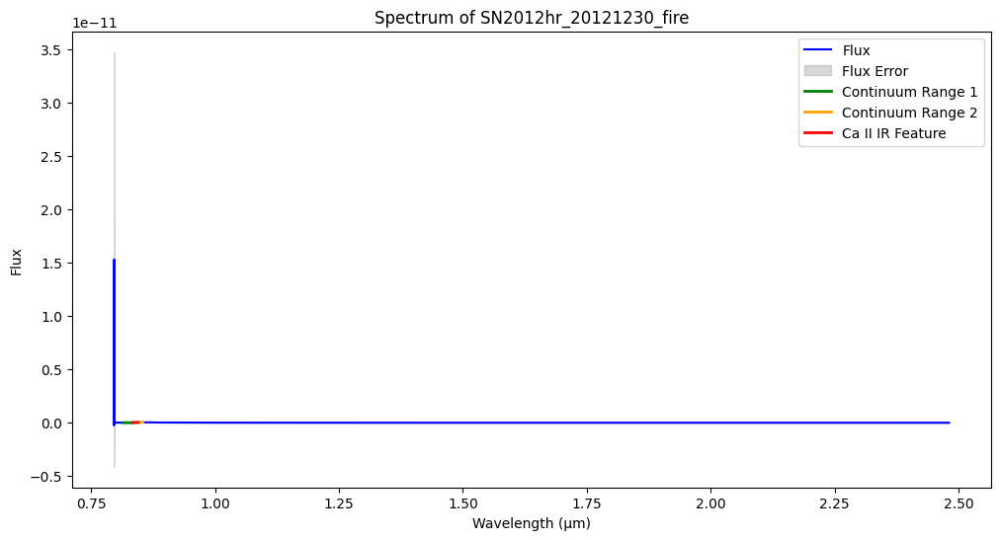

Pseudo-equivalent width for Ca II IR in SN2012hr_20130103_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012hr_20130103_fire: -3188.14 km/s


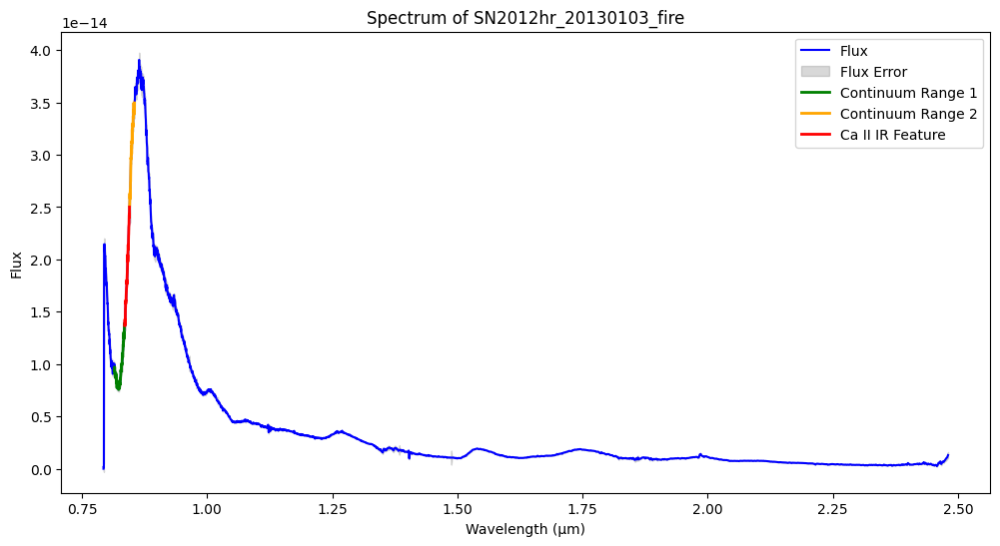

Pseudo-equivalent width for Ca II IR in SN2012hr_20130106_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012hr_20130106_fire: -2926.09 km/s


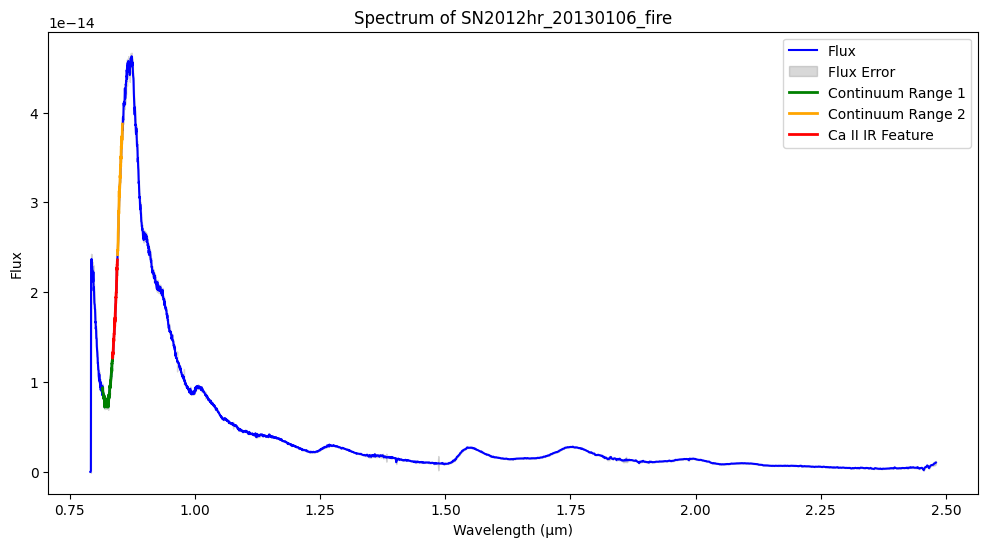

Pseudo-equivalent width for Ca II IR in SN2012hr_20130202_fire: 0.02 Å
Velocity shift for Ca II IR in SN2012hr_20130202_fire: -2411.17 km/s


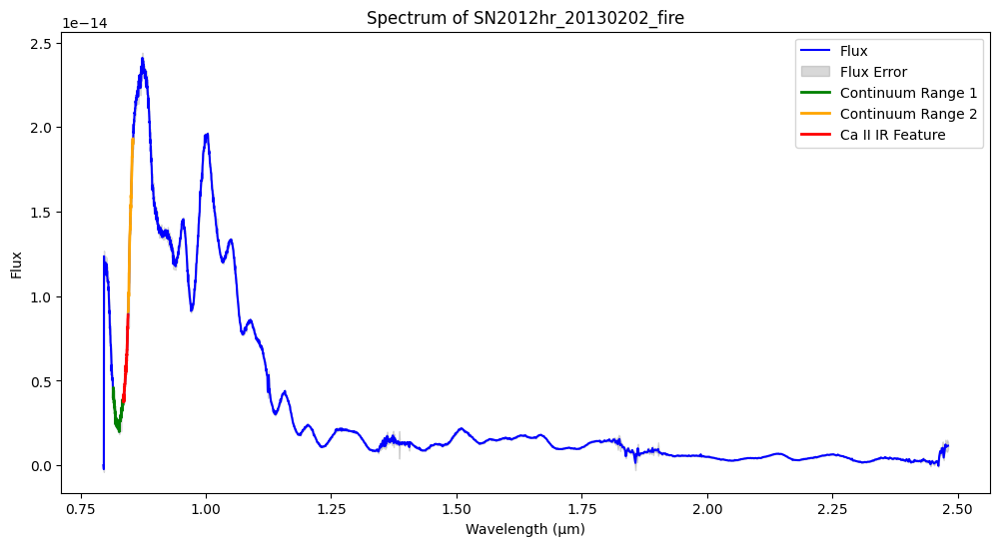

Pseudo-equivalent width for Ca II IR in SN2012hr_20130205_fire: 0.02 Å
Velocity shift for Ca II IR in SN2012hr_20130205_fire: -2549.12 km/s


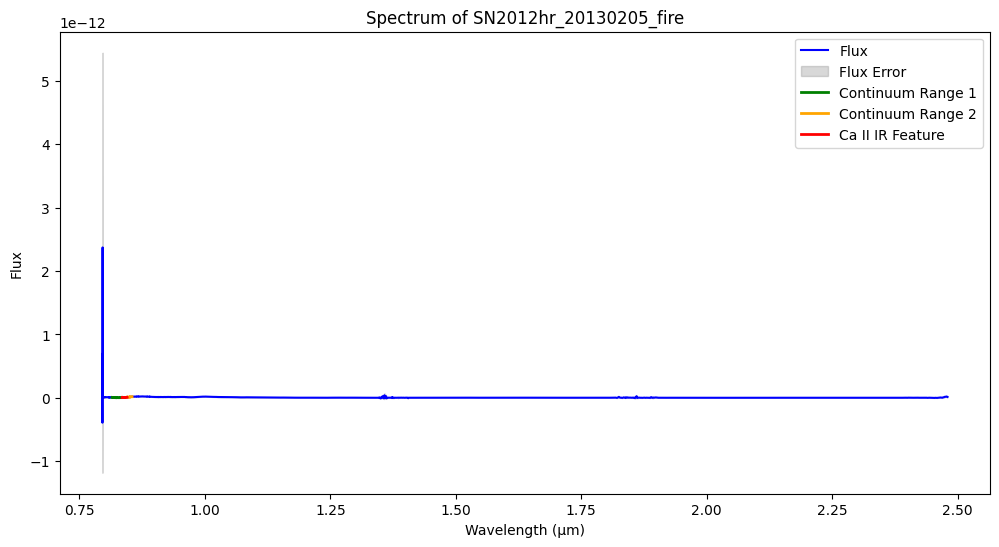

Pseudo-equivalent width for Ca II IR in SN2012hr_20130216_fire: 0.02 Å
Velocity shift for Ca II IR in SN2012hr_20130216_fire: -2459.02 km/s


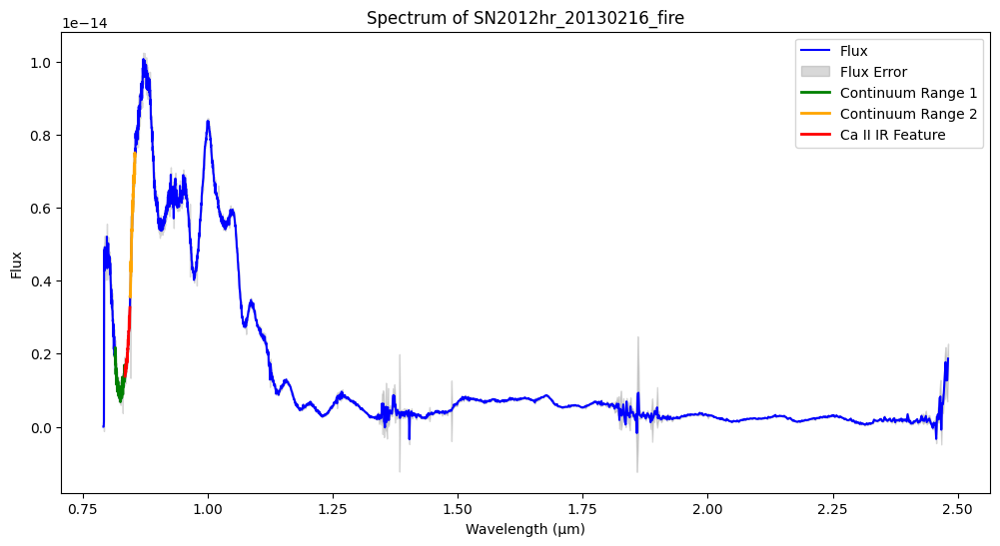

Pseudo-equivalent width for Ca II IR in SN2012hr_20130228_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012hr_20130228_fire: -2563.64 km/s


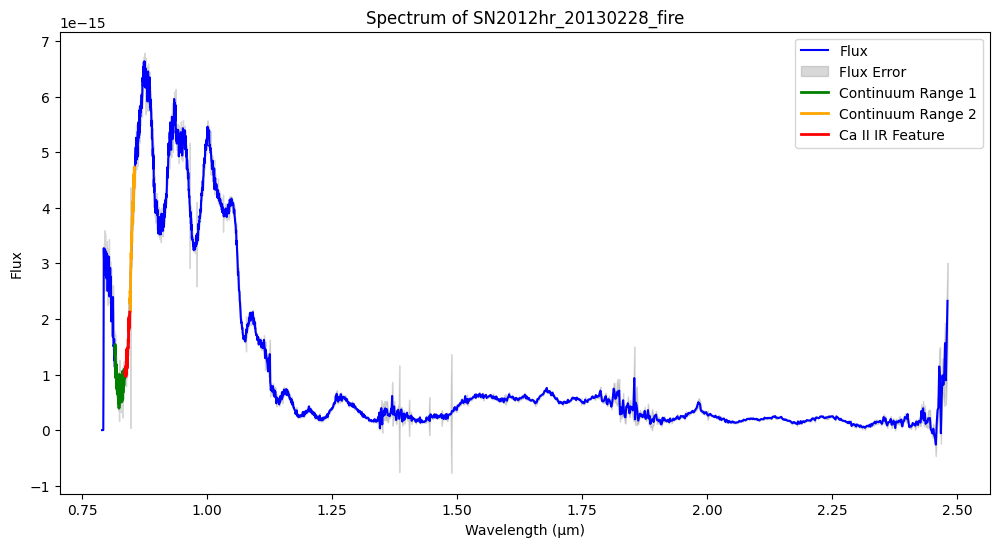

Pseudo-equivalent width for Ca II IR in SN2012hr_20130320_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012hr_20130320_fire: -3205.61 km/s


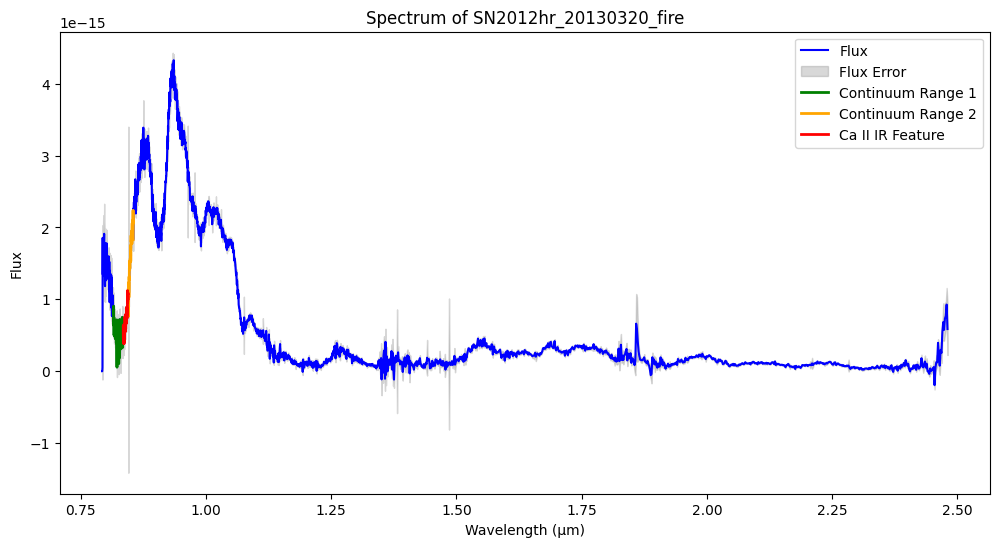

Pseudo-equivalent width for Ca II IR in SN2012hr_20130325_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012hr_20130325_fire: -3162.07 km/s


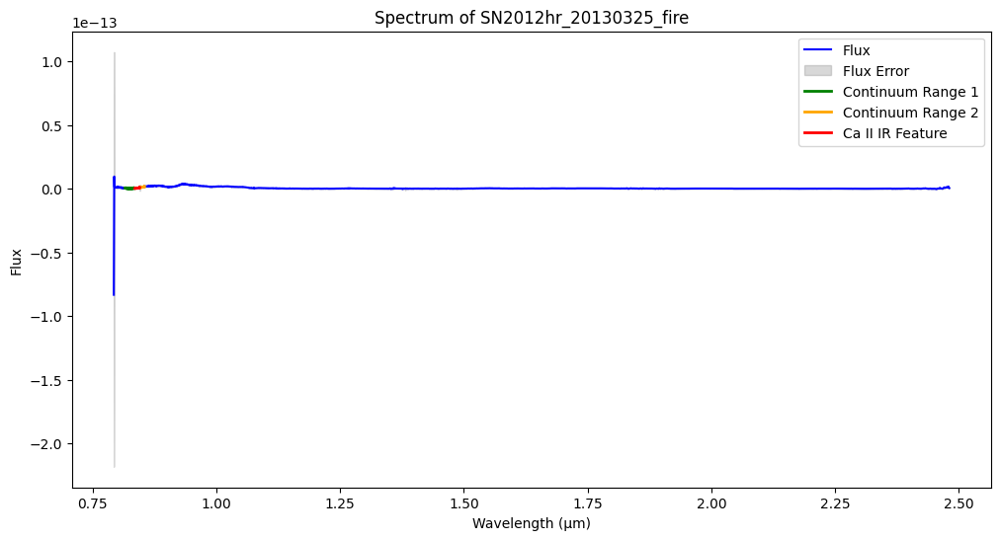

Pseudo-equivalent width for Ca II IR in SN2012hr_20130401_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012hr_20130401_fire: -3530.62 km/s


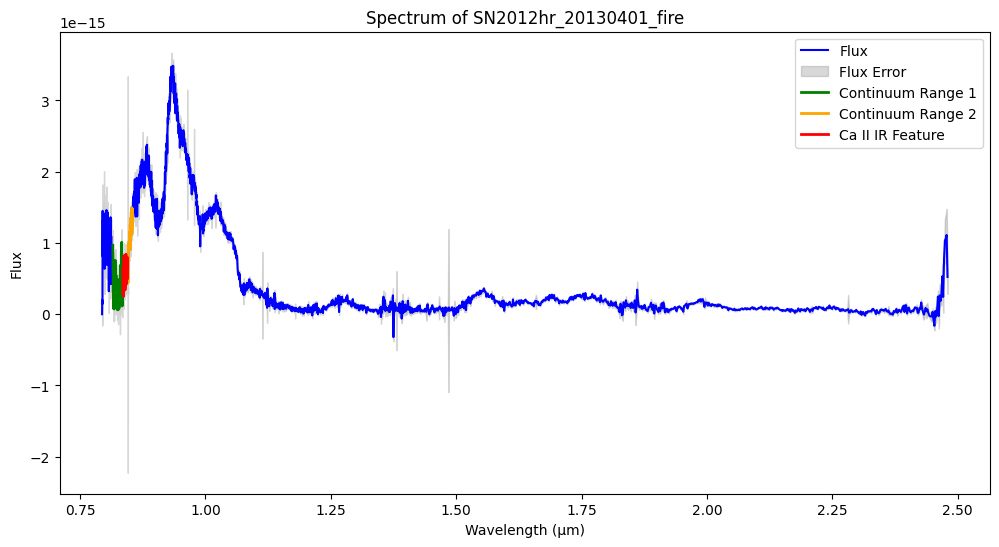

Pseudo-equivalent width for Ca II IR in SN2012ht_20121230_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012ht_20121230_fire: -4343.24 km/s


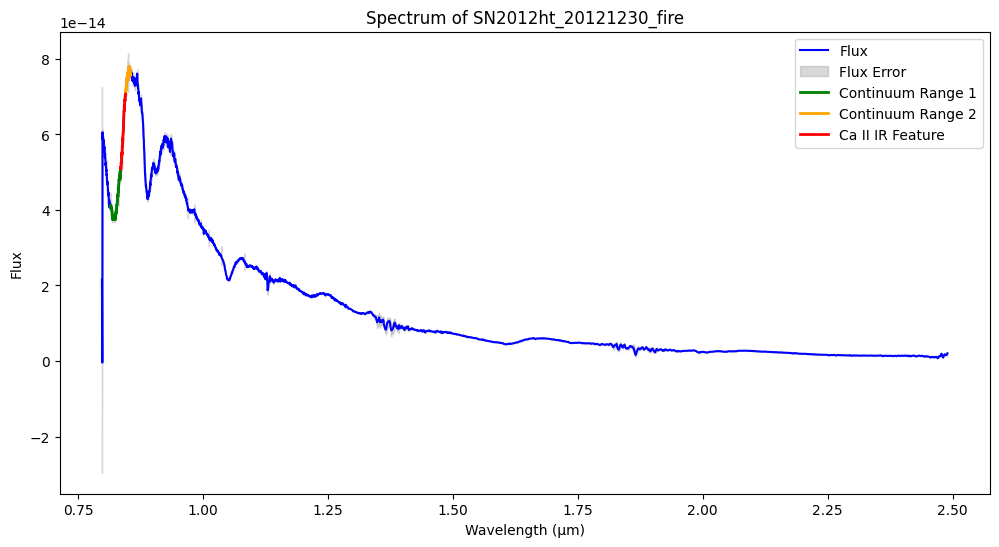

Pseudo-equivalent width for Ca II IR in SN2012ht_20130103_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012ht_20130103_fire: -4067.13 km/s


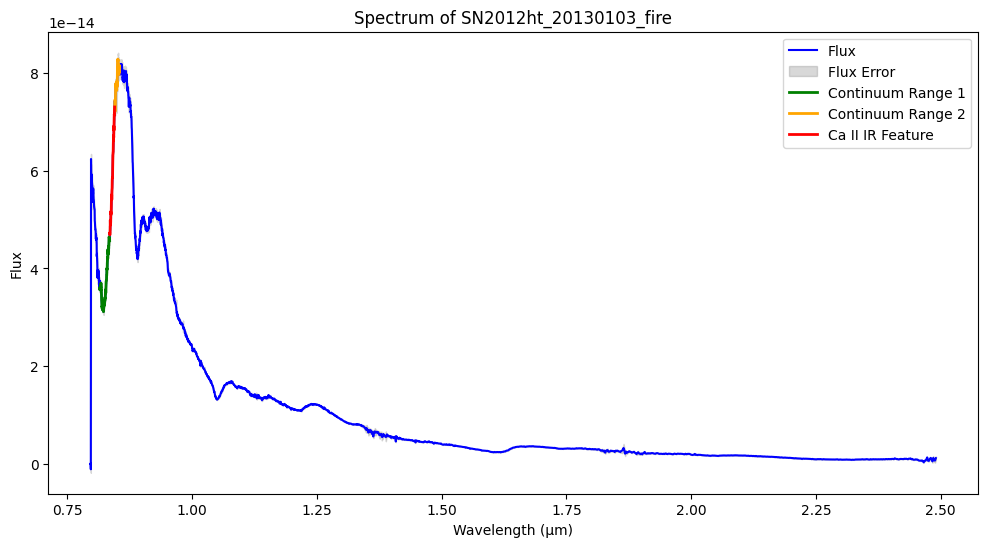

Pseudo-equivalent width for Ca II IR in SN2012ht_20130106_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012ht_20130106_fire: -3516.35 km/s


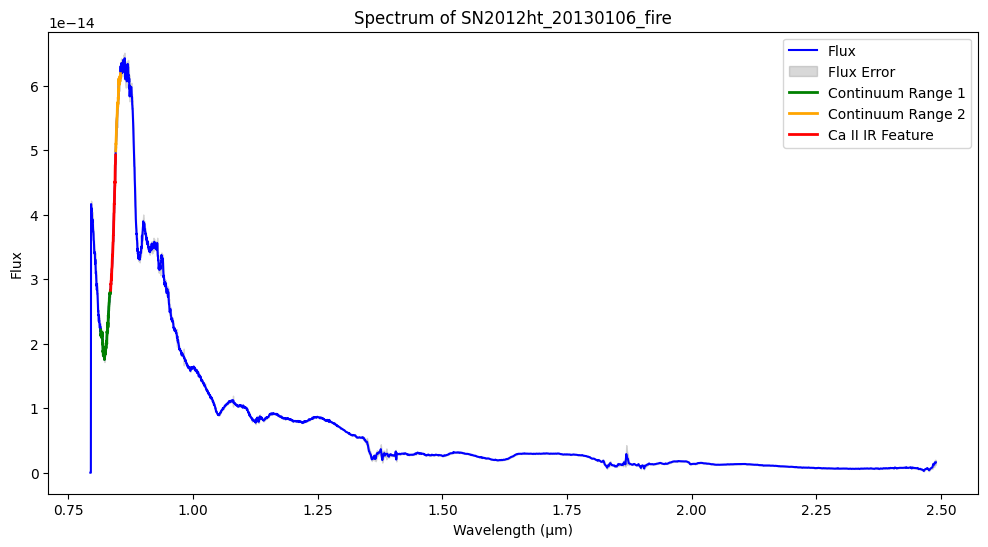

Pseudo-equivalent width for Ca II IR in SN2012ht_20130112_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012ht_20130112_fire: -3283.72 km/s


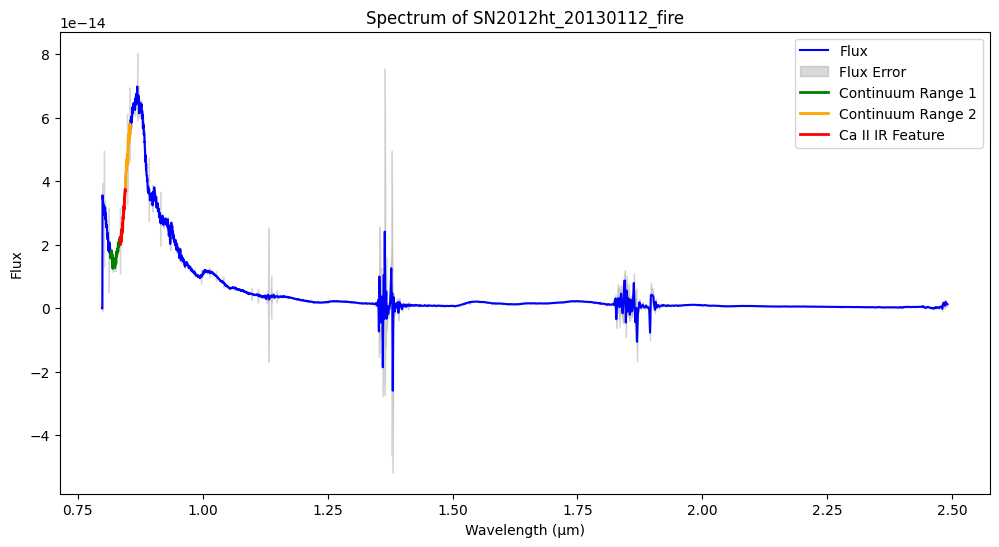

Pseudo-equivalent width for Ca II IR in SN2012ht_20130202_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012ht_20130202_fire: -3175.58 km/s


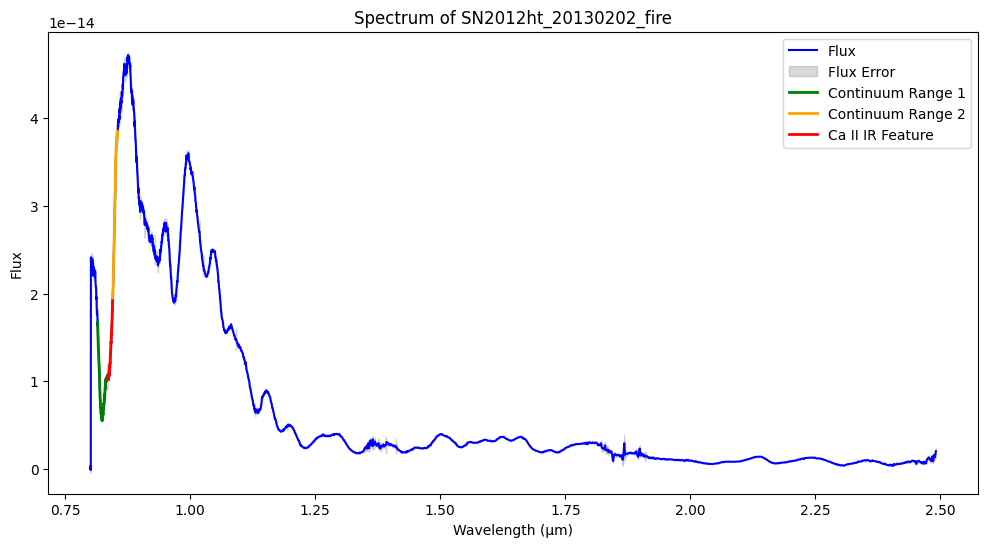

Pseudo-equivalent width for Ca II IR in SN2012ht_20130205_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012ht_20130205_fire: -3217.27 km/s


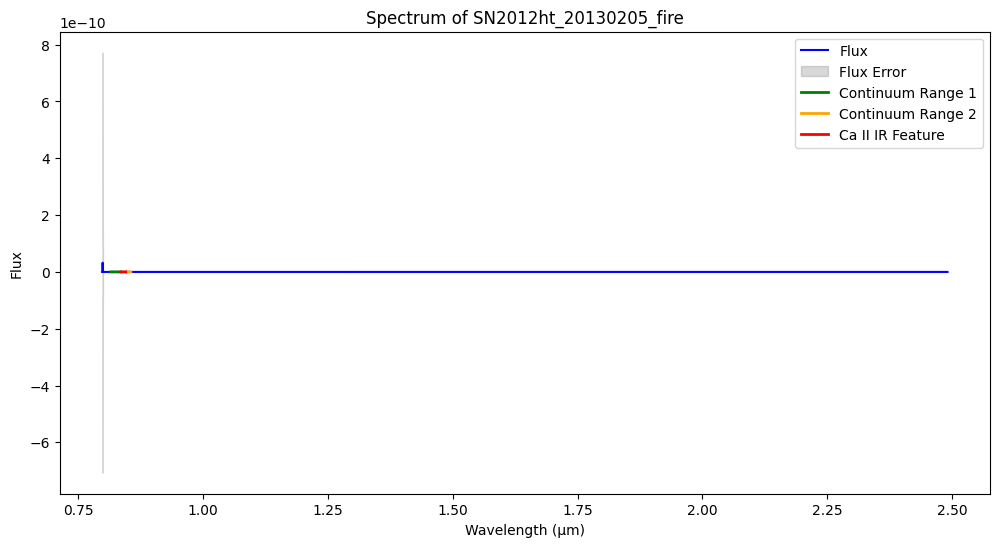

Pseudo-equivalent width for Ca II IR in SN2012ht_20130216_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012ht_20130216_fire: -3103.32 km/s


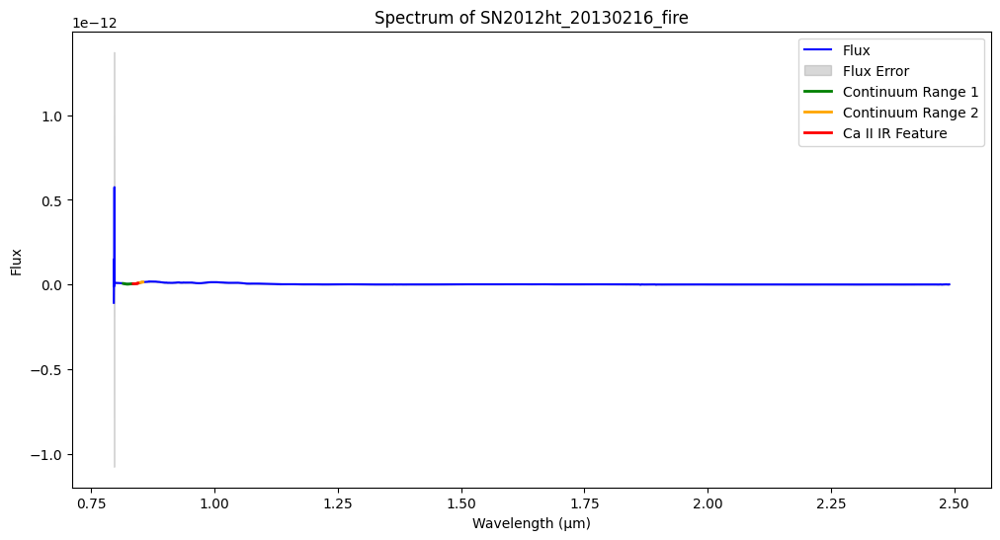

Pseudo-equivalent width for Ca II IR in SN2012ht_20130228_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012ht_20130228_fire: -3254.93 km/s


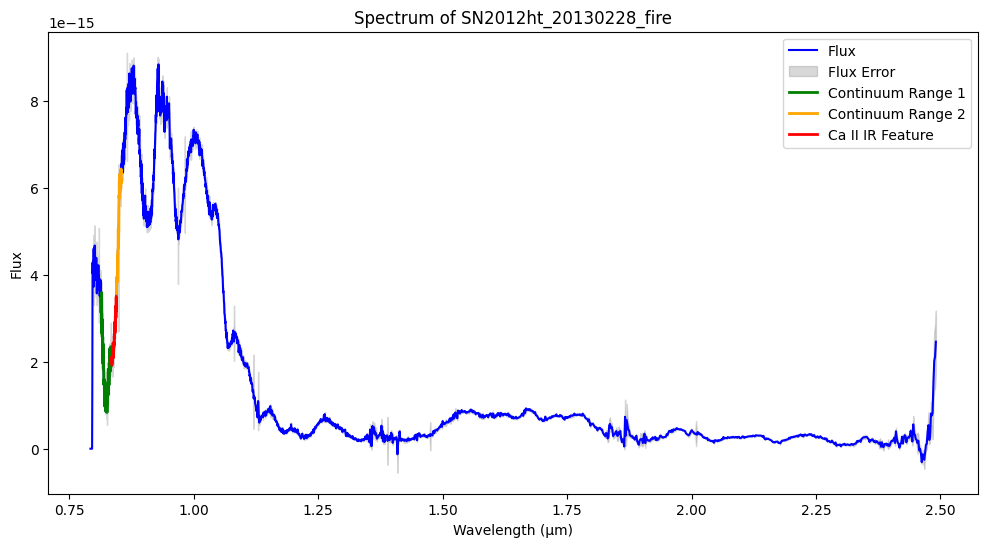

Pseudo-equivalent width for Ca II IR in SN2012ht_20130320_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012ht_20130320_fire: -3342.21 km/s


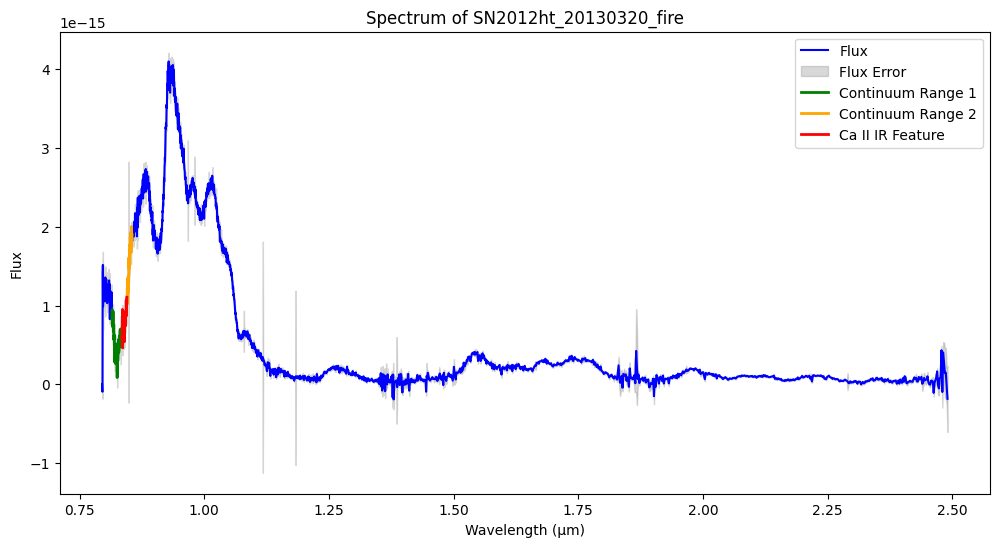

Pseudo-equivalent width for Ca II IR in SN2012ht_20130325_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012ht_20130325_fire: -3745.84 km/s


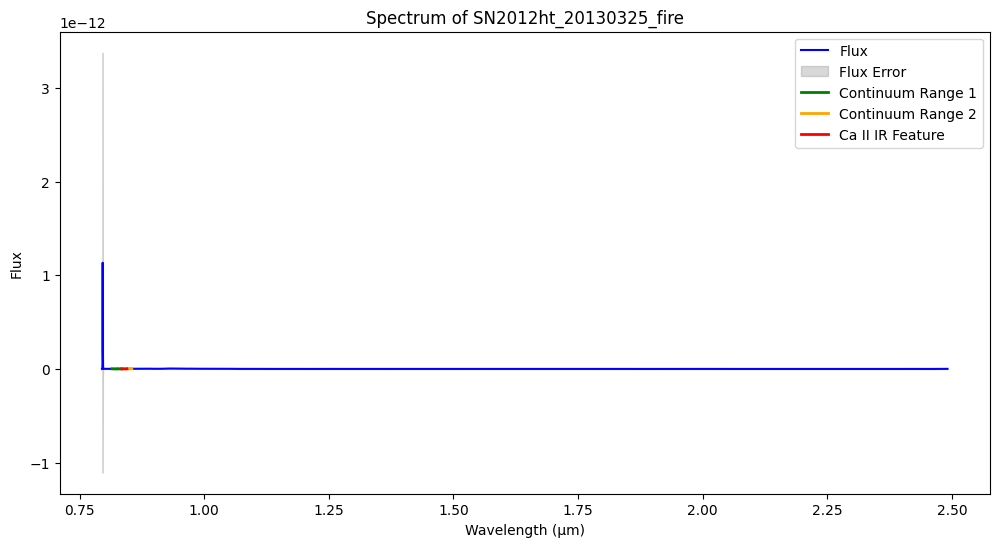

Pseudo-equivalent width for Ca II IR in SN2012ht_20130401_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012ht_20130401_fire: -3943.00 km/s


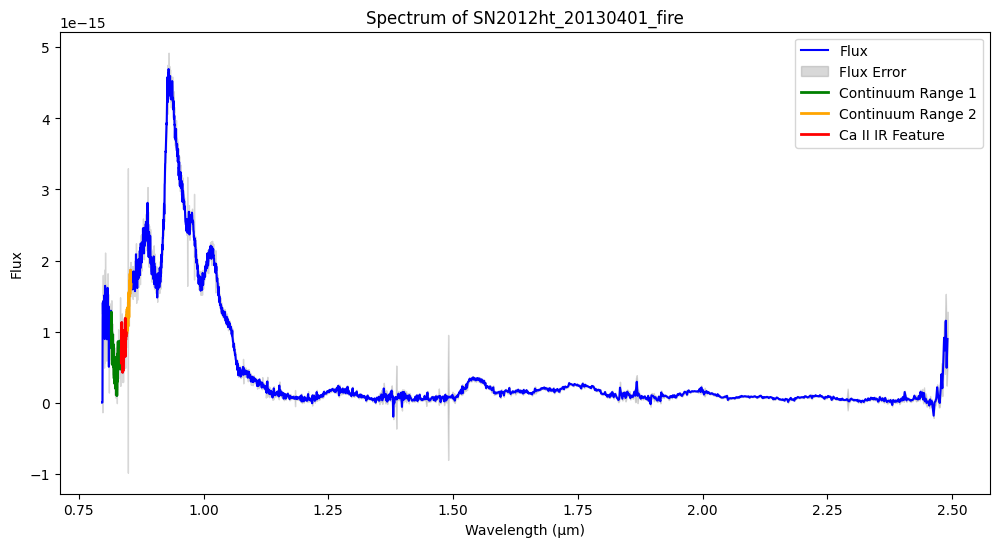

Pseudo-equivalent width for Ca II IR in SN2012id_20121230_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012id_20121230_fire: -4611.94 km/s


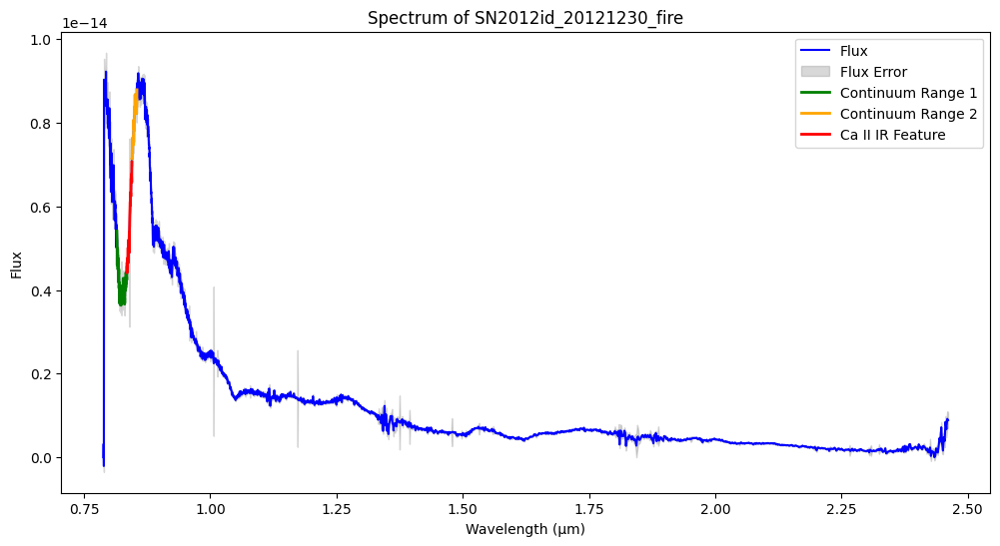

Pseudo-equivalent width for Ca II IR in SN2012id_20130103_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012id_20130103_fire: -4261.09 km/s


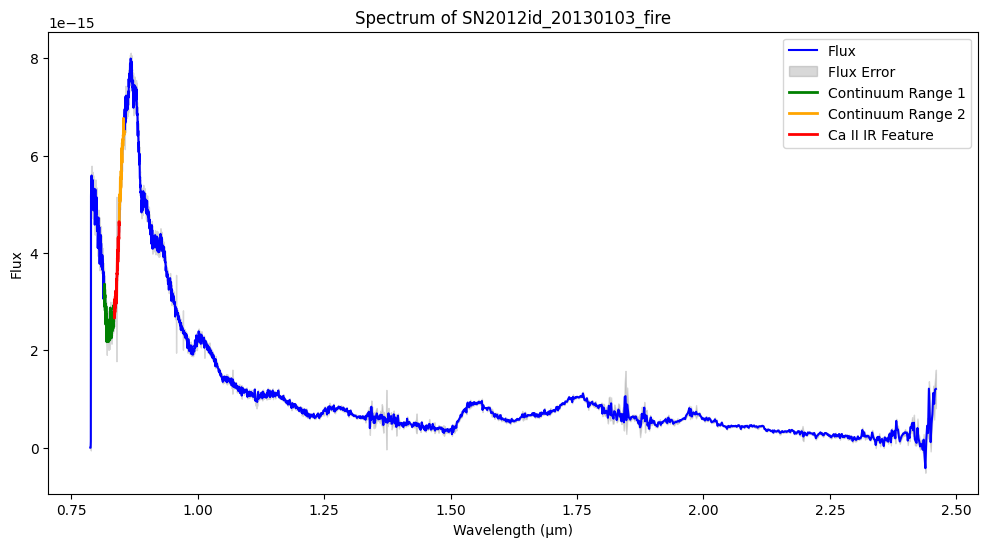

Pseudo-equivalent width for Ca II IR in SN2012id_20130106_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012id_20130106_fire: -4053.51 km/s


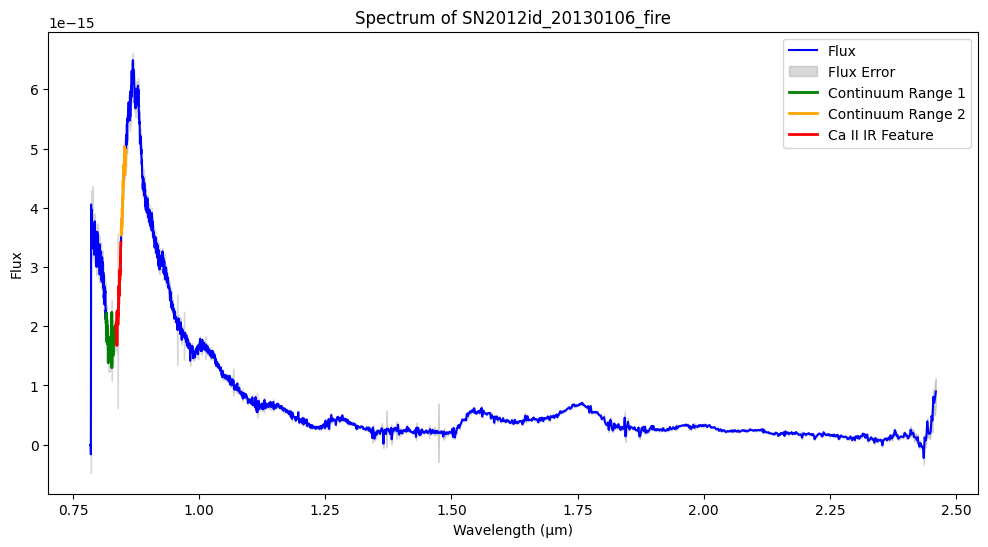

Pseudo-equivalent width for Ca II IR in SN2012ij_20130106_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012ij_20130106_fire: -3957.69 km/s


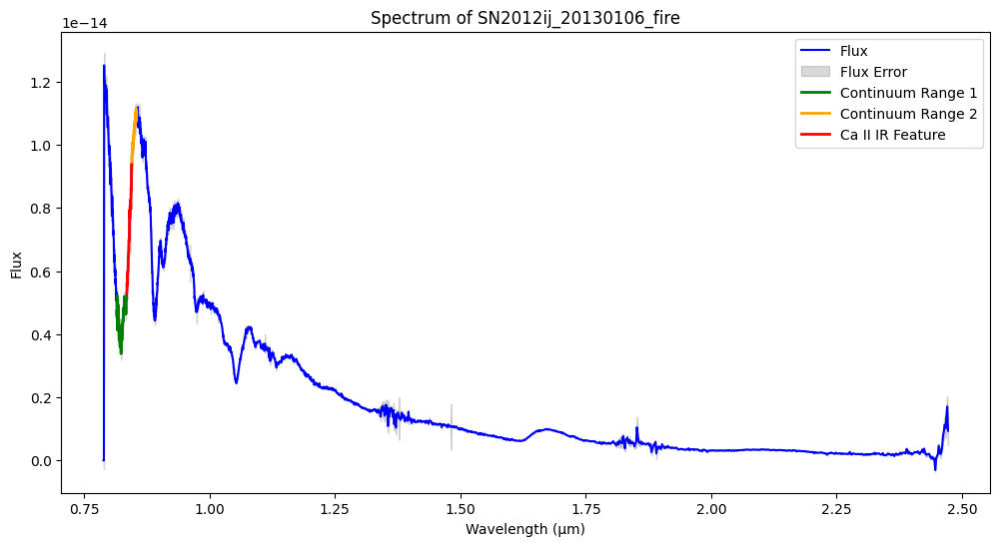

Pseudo-equivalent width for Ca II IR in SN2012ij_20130202_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012ij_20130202_fire: -3329.94 km/s


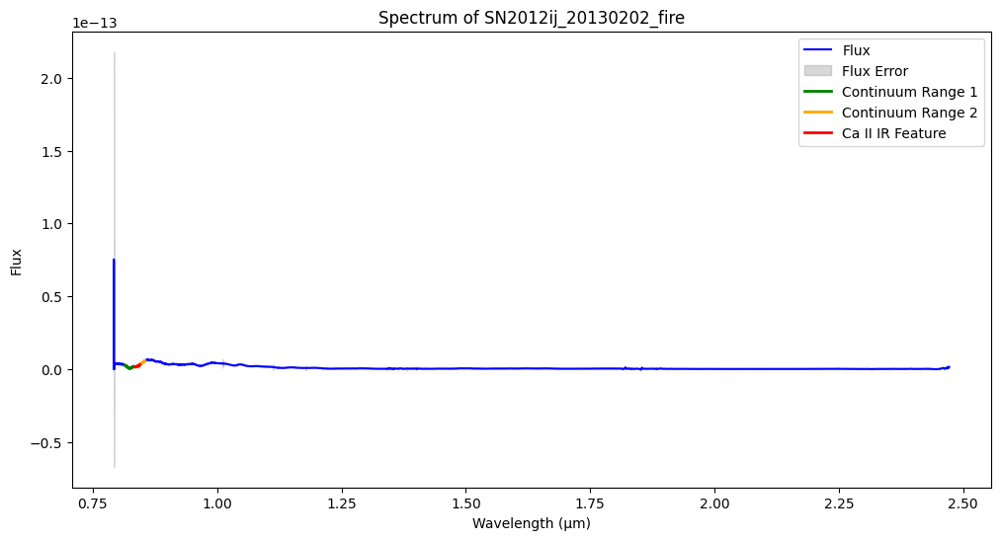

Pseudo-equivalent width for Ca II IR in SN2012ij_20130205_fire: 0.01 Å
Velocity shift for Ca II IR in SN2012ij_20130205_fire: -3306.04 km/s


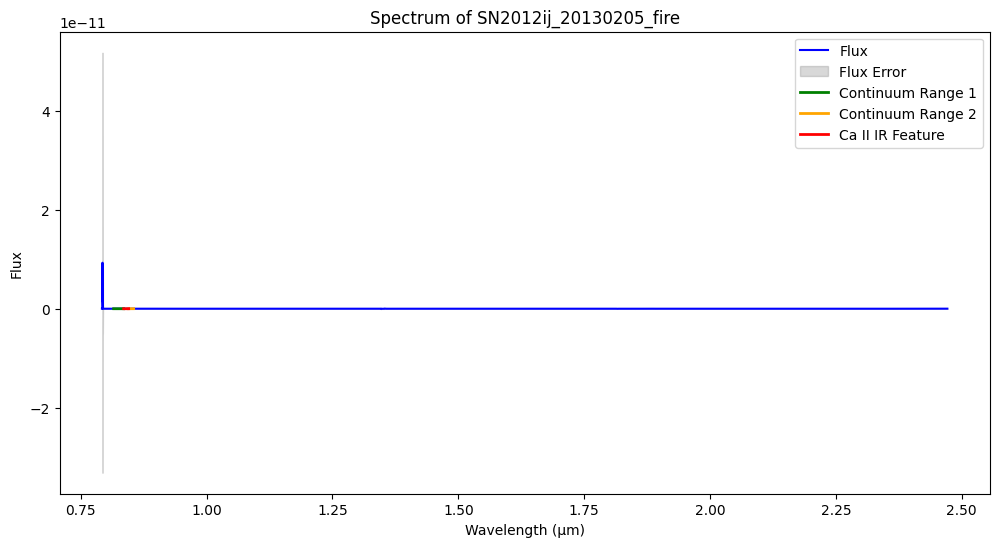

Pseudo-equivalent width for Ca II IR in SN2013E_20130106_fire: -0.00 Å
Velocity shift for Ca II IR in SN2013E_20130106_fire: -5907.37 km/s


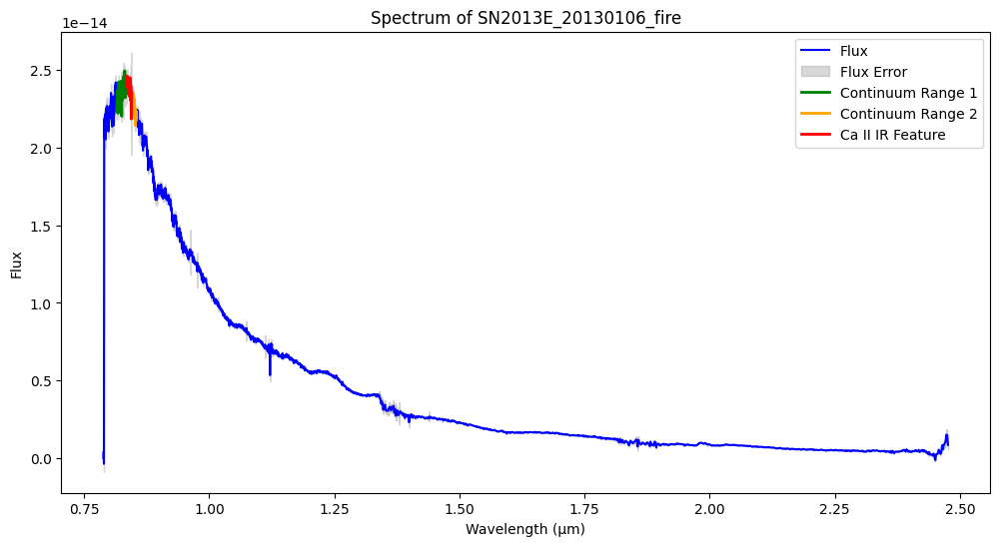

Pseudo-equivalent width for Ca II IR in SN2013E_20130112_fire: -0.00 Å
Velocity shift for Ca II IR in SN2013E_20130112_fire: -5995.89 km/s


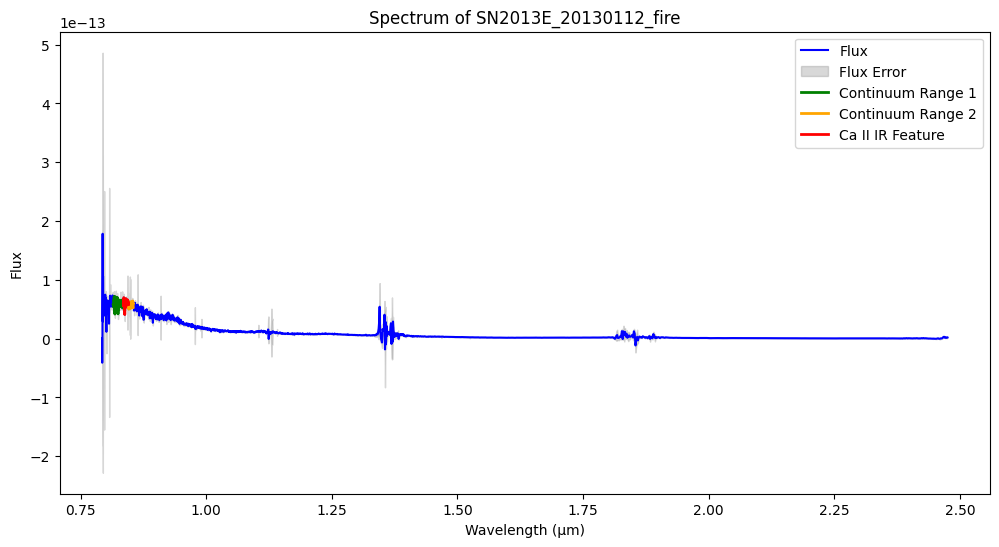

Pseudo-equivalent width for Ca II IR in SN2013E_20130202_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013E_20130202_fire: -2995.53 km/s


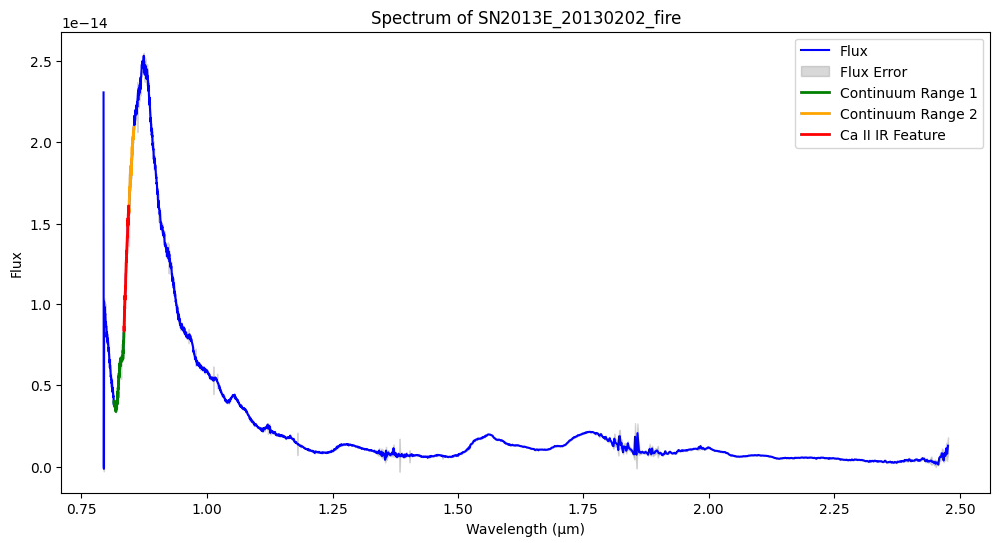

Pseudo-equivalent width for Ca II IR in SN2013E_20130205_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013E_20130205_fire: -2947.15 km/s


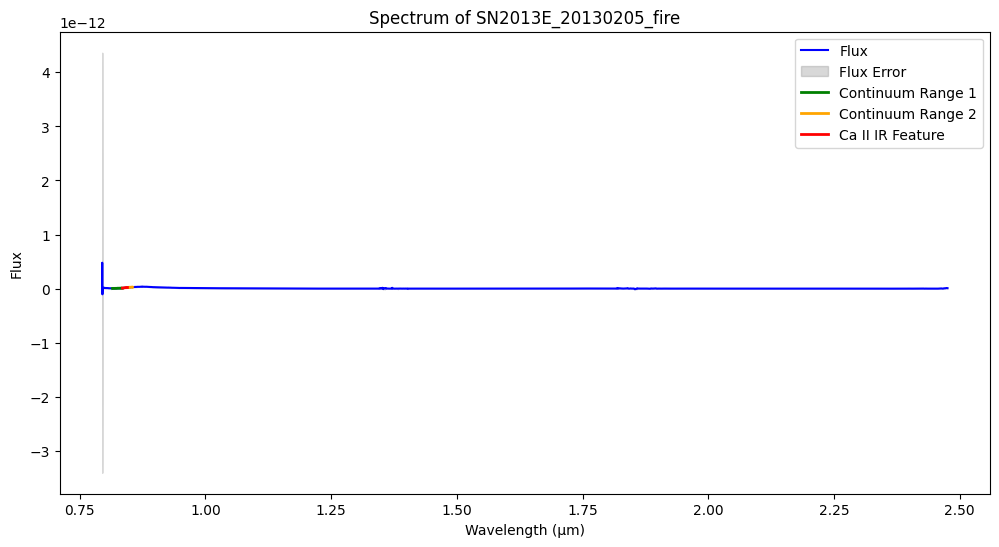

Pseudo-equivalent width for Ca II IR in SN2013E_20130216_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013E_20130216_fire: -2431.01 km/s


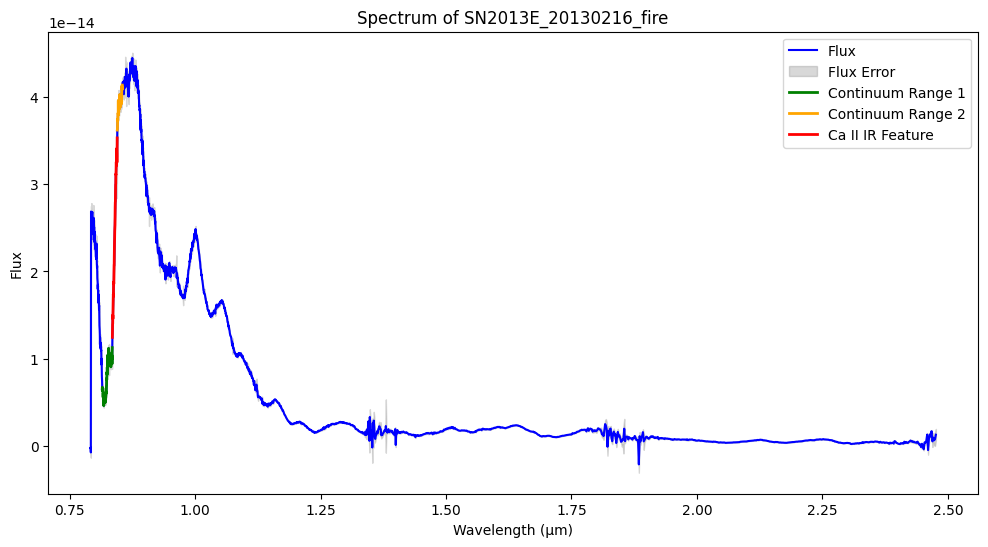

Pseudo-equivalent width for Ca II IR in SN2013E_20130228_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013E_20130228_fire: -2472.55 km/s


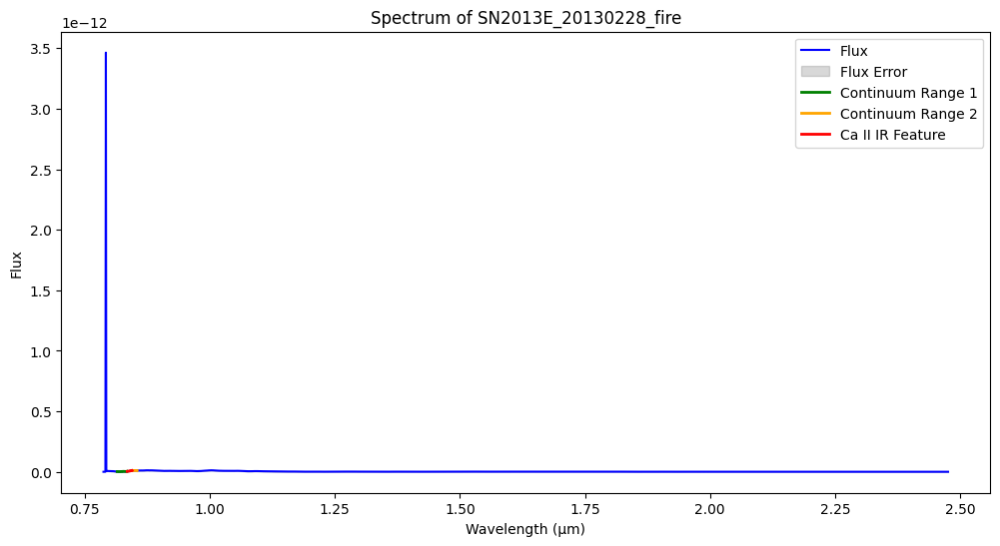

Pseudo-equivalent width for Ca II IR in SN2013E_20130306_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013E_20130306_fire: -2667.21 km/s


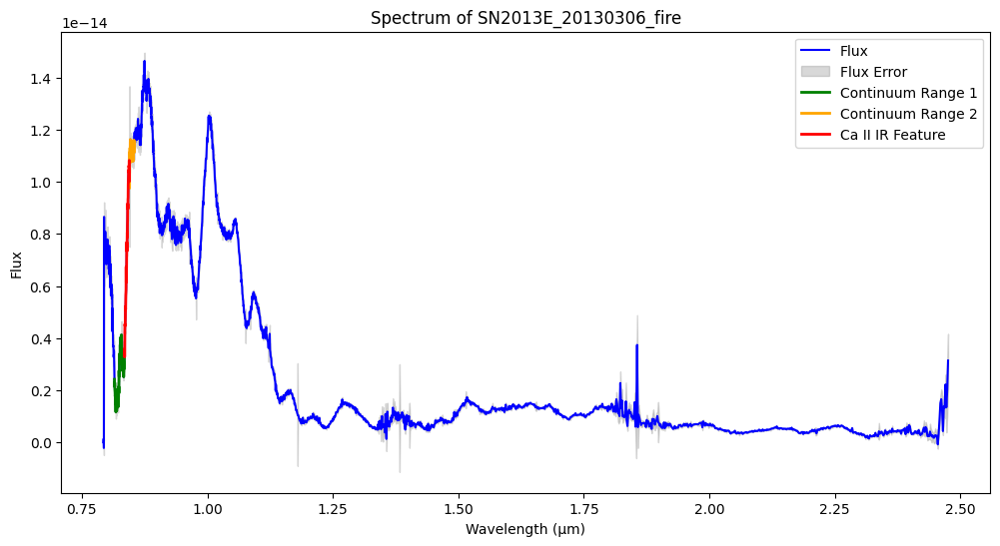

Pseudo-equivalent width for Ca II IR in SN2013E_20130320_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013E_20130320_fire: -2788.71 km/s


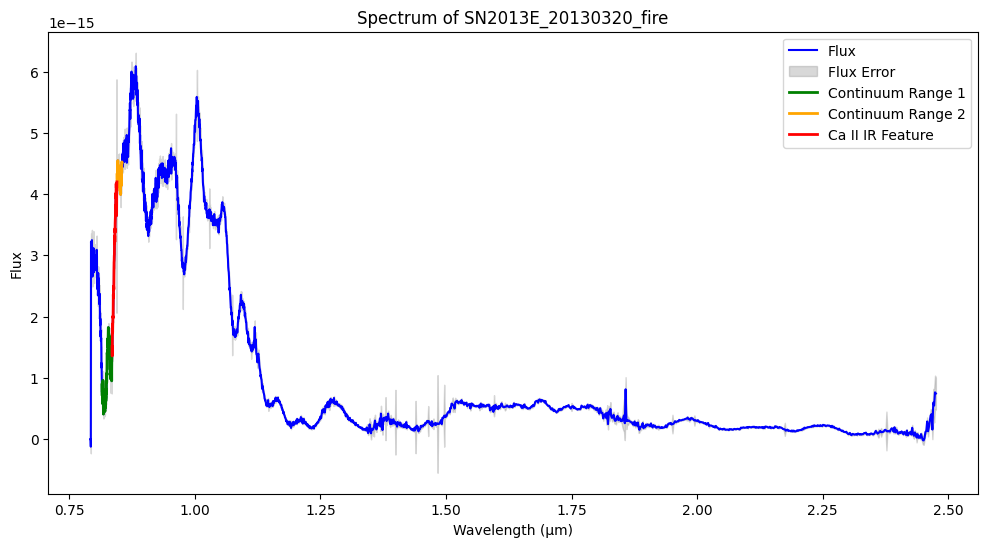

Pseudo-equivalent width for Ca II IR in SN2013E_20130325_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013E_20130325_fire: -2810.67 km/s


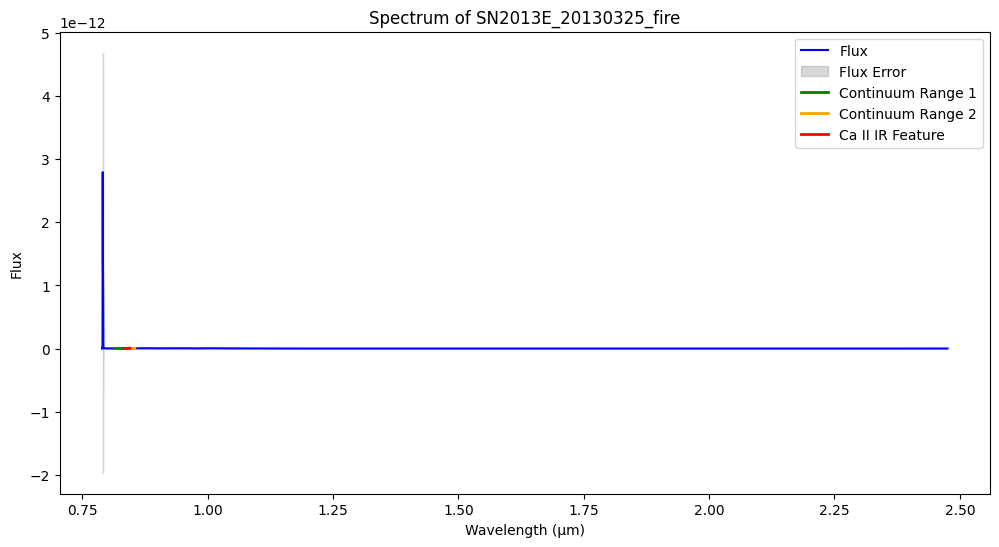

Pseudo-equivalent width for Ca II IR in SN2013E_20130401_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013E_20130401_fire: -3109.38 km/s


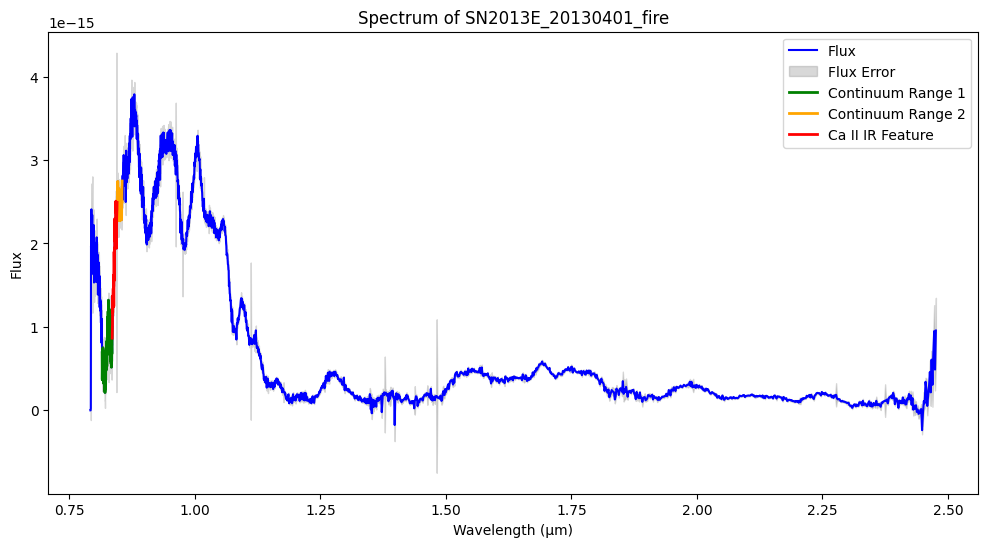

Pseudo-equivalent width for Ca II IR in SN2013H_20130202_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013H_20130202_fire: -3220.86 km/s


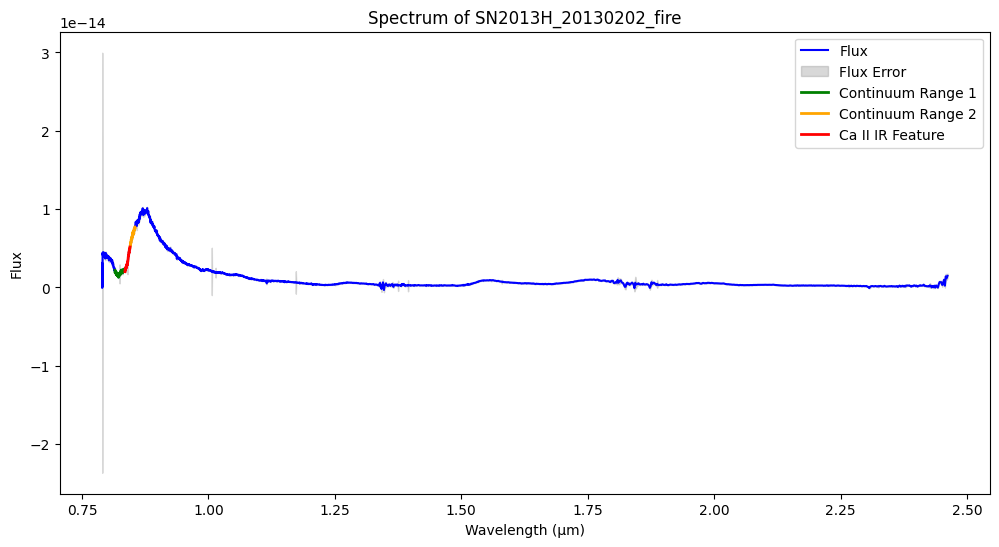

Pseudo-equivalent width for Ca II IR in SN2013H_20130205_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013H_20130205_fire: -3172.45 km/s


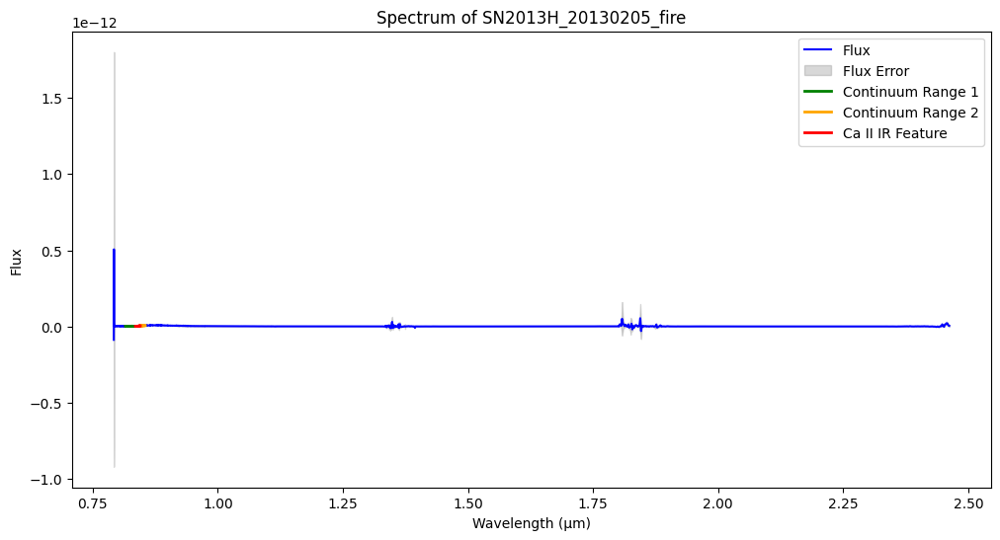

Pseudo-equivalent width for Ca II IR in SN2013H_20130216_fire: 0.02 Å
Velocity shift for Ca II IR in SN2013H_20130216_fire: -2702.14 km/s


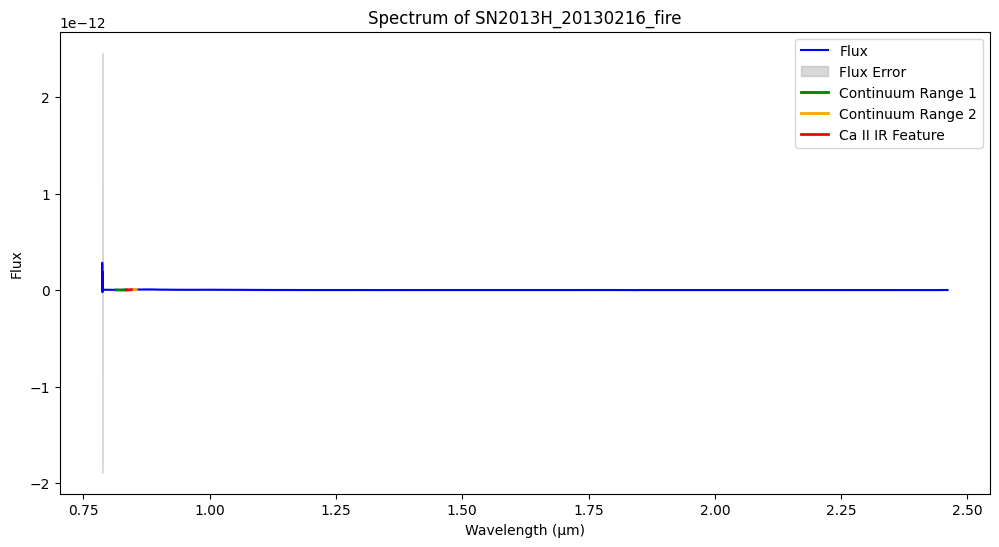

Pseudo-equivalent width for Ca II IR in SN2013H_20130228_fire: 0.02 Å
Velocity shift for Ca II IR in SN2013H_20130228_fire: -2357.09 km/s


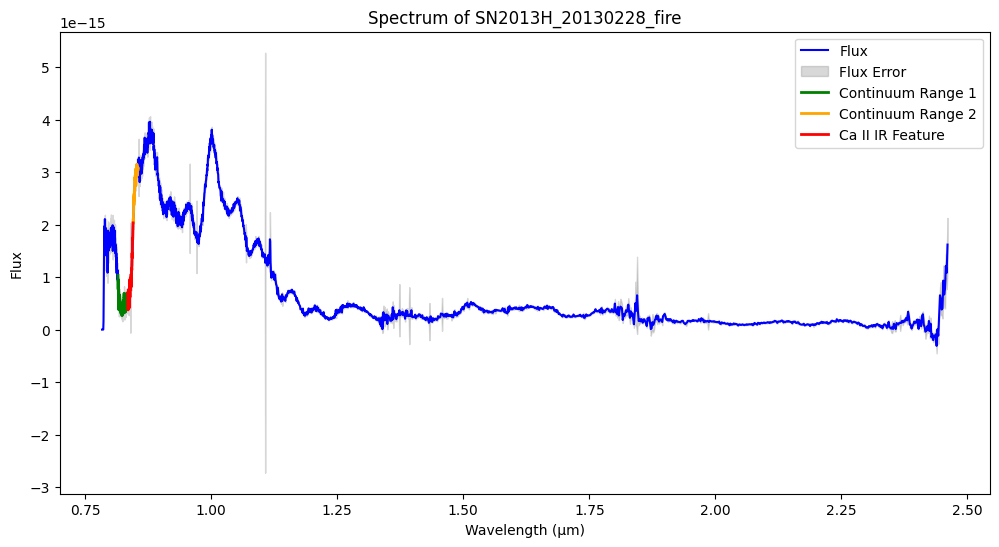

Pseudo-equivalent width for Ca II IR in SN2013M_20130202_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013M_20130202_fire: -4216.10 km/s


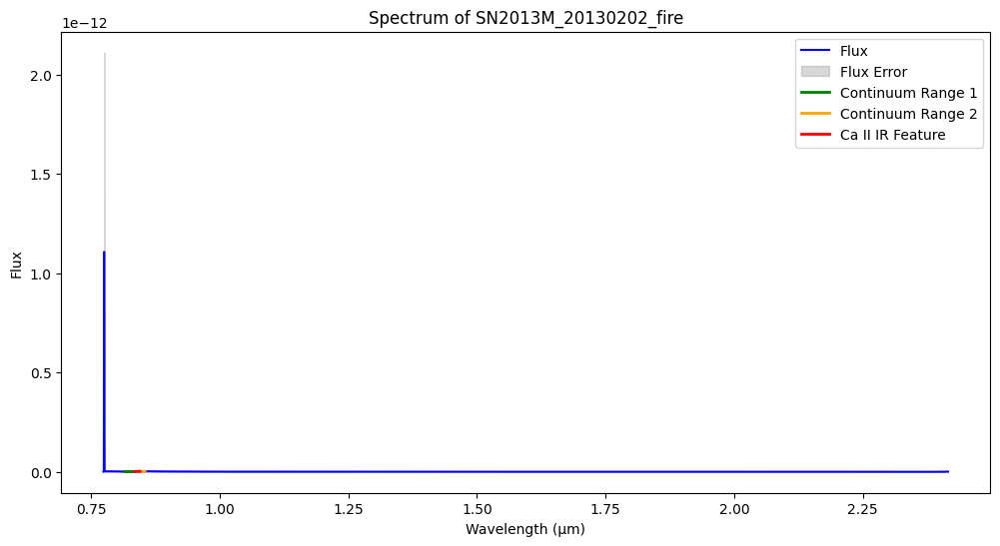

Pseudo-equivalent width for Ca II IR in SN2013M_20130205_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013M_20130205_fire: -3604.58 km/s


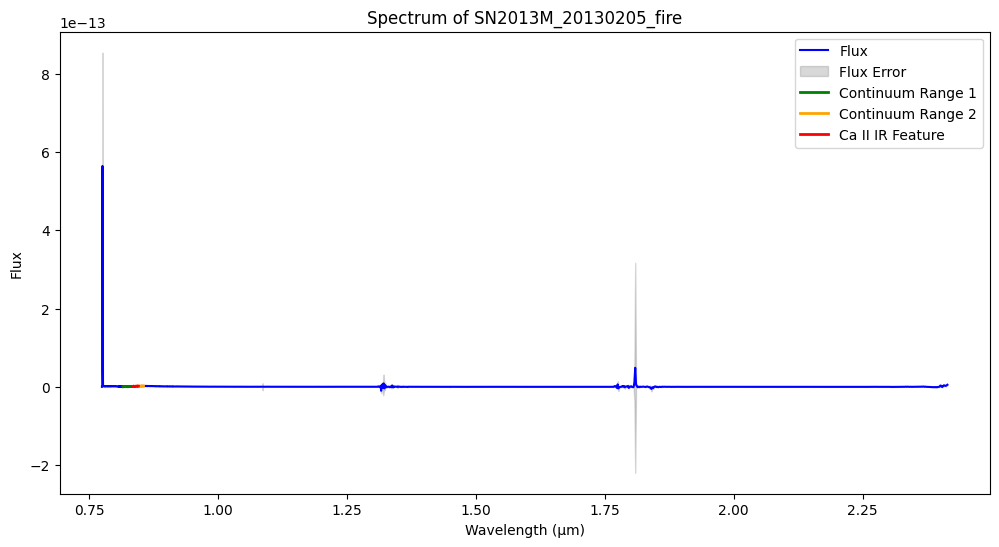

Pseudo-equivalent width for Ca II IR in SN2013M_20130228_fire: 0.02 Å
Velocity shift for Ca II IR in SN2013M_20130228_fire: -2084.27 km/s


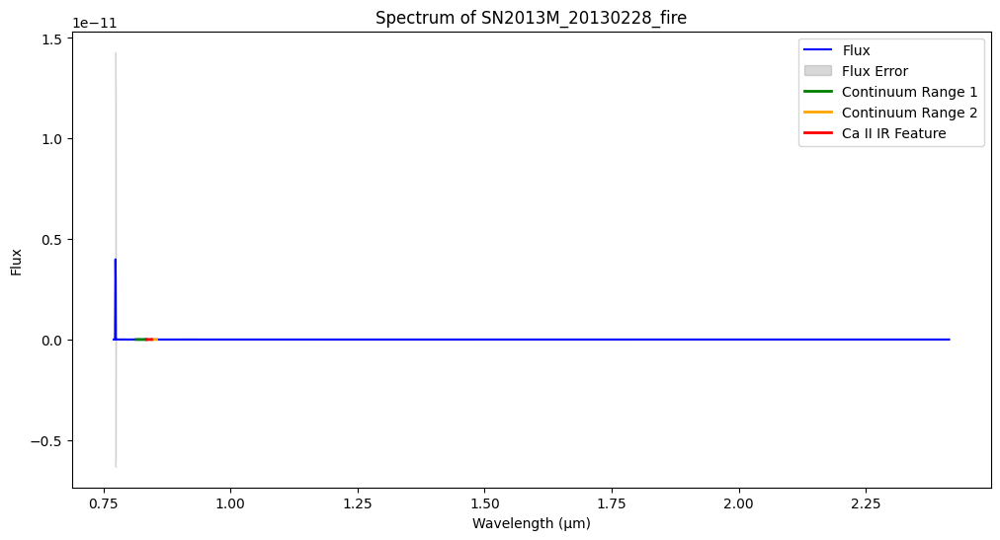

Pseudo-equivalent width for Ca II IR in SN2013U_20130216_fire: 0.00 Å
Velocity shift for Ca II IR in SN2013U_20130216_fire: -5792.01 km/s


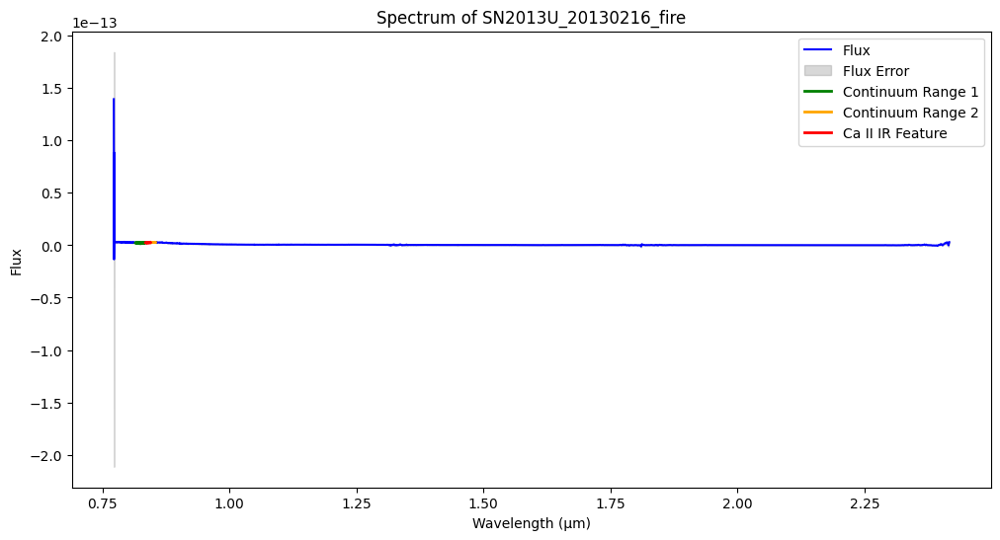

Pseudo-equivalent width for Ca II IR in SN2013U_20130228_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013U_20130228_fire: -4677.13 km/s


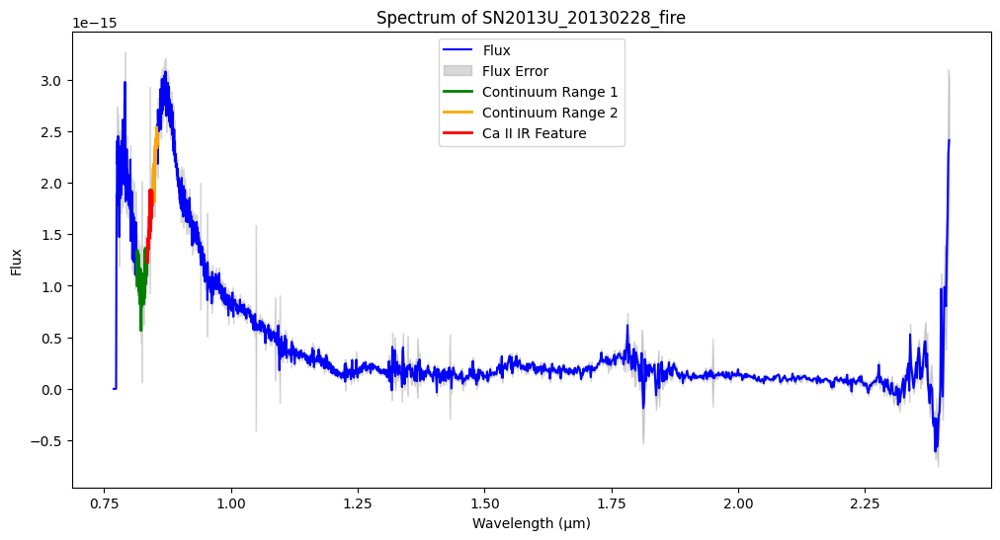

Pseudo-equivalent width for Ca II IR in SN2013aa_20130228_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013aa_20130228_fire: -3593.39 km/s


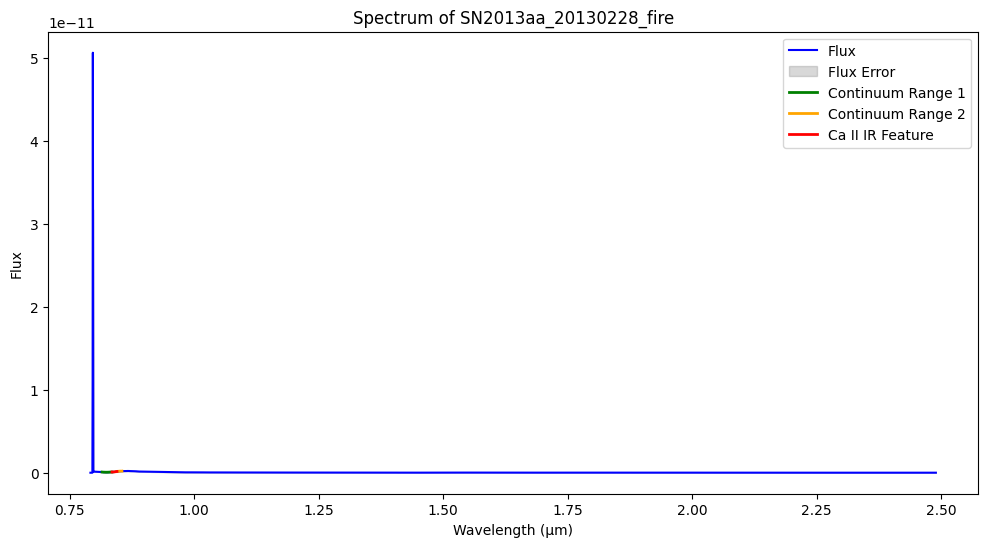

Pseudo-equivalent width for Ca II IR in SN2013aa_20130306_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013aa_20130306_fire: -3277.51 km/s


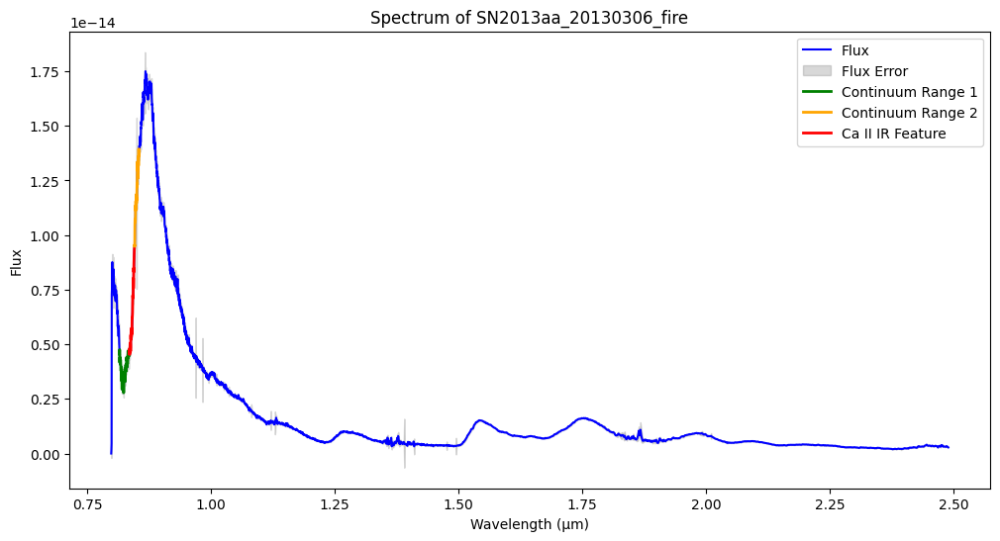

Pseudo-equivalent width for Ca II IR in SN2013aa_20130320_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013aa_20130320_fire: -3024.10 km/s


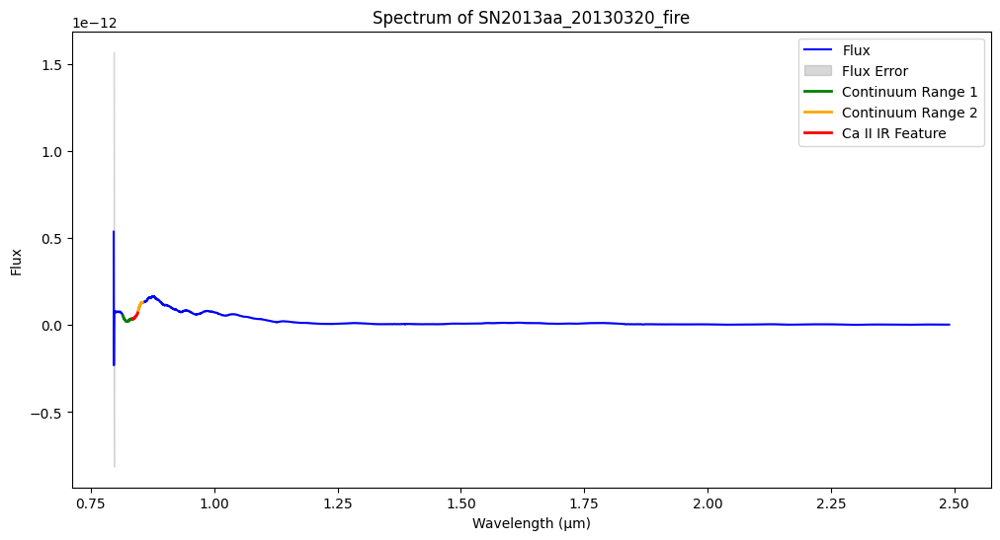

Pseudo-equivalent width for Ca II IR in SN2013aa_20130325_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013aa_20130325_fire: -2556.32 km/s


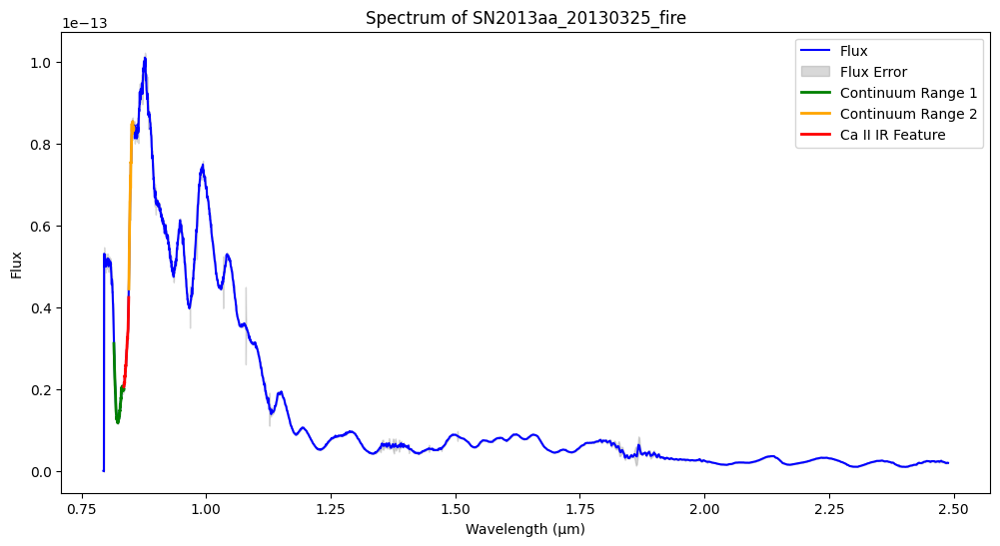

Pseudo-equivalent width for Ca II IR in SN2013aa_20130401_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013aa_20130401_fire: -2750.28 km/s


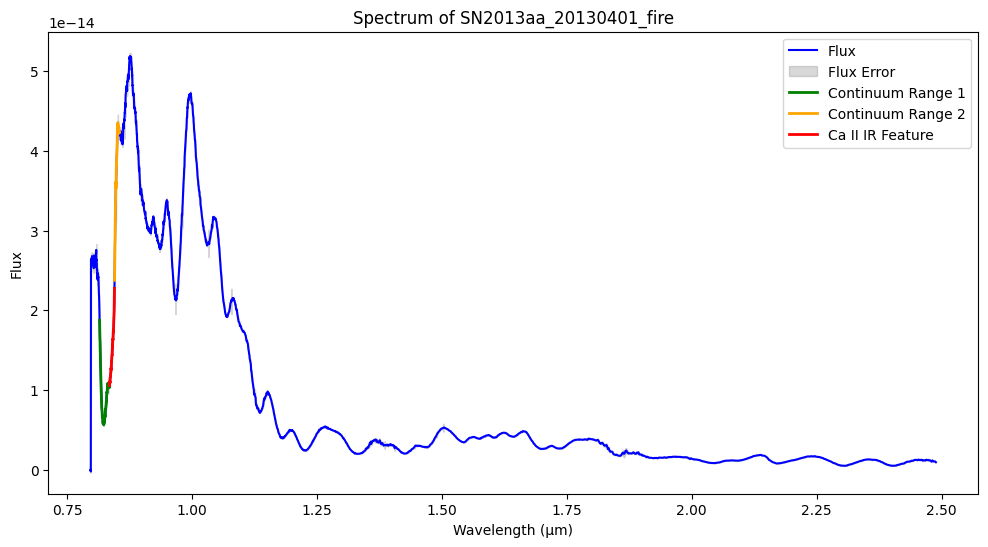

Pseudo-equivalent width for Ca II IR in SN2013aa_20130403_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013aa_20130403_fire: -2755.69 km/s


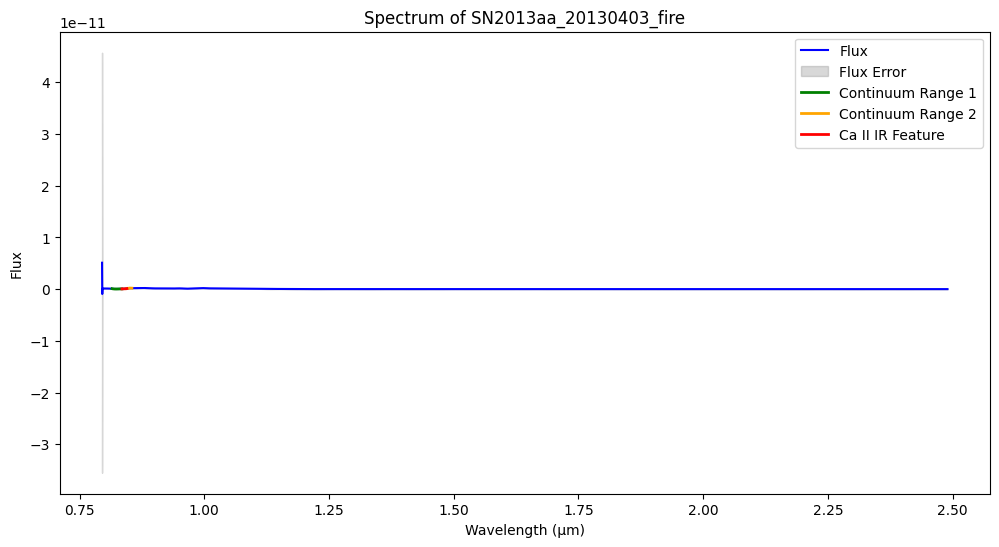

Pseudo-equivalent width for Ca II IR in SN2013aa_20130519_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013aa_20130519_fire: -2773.13 km/s


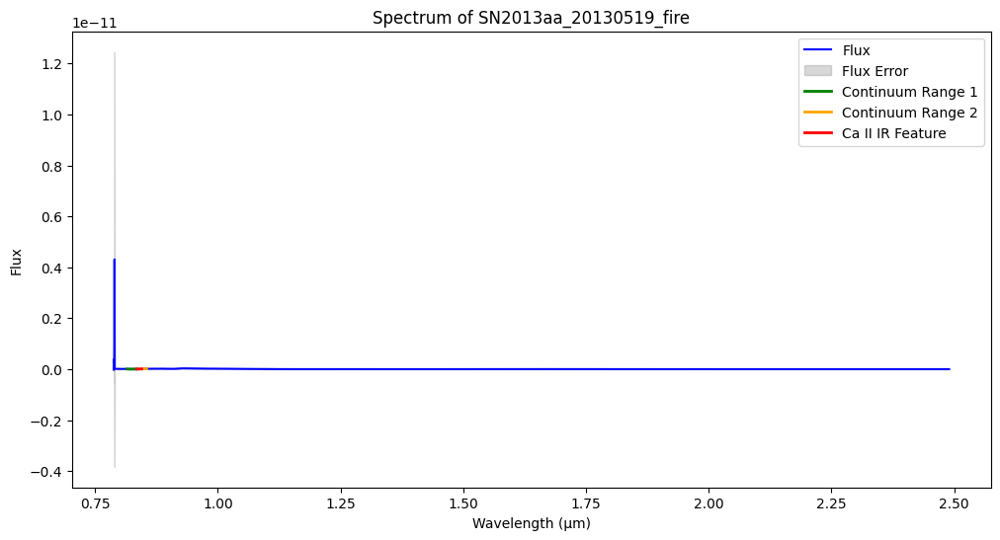

Pseudo-equivalent width for Ca II IR in SN2013aj_20130306_fire: 0.00 Å
Velocity shift for Ca II IR in SN2013aj_20130306_fire: -5142.51 km/s


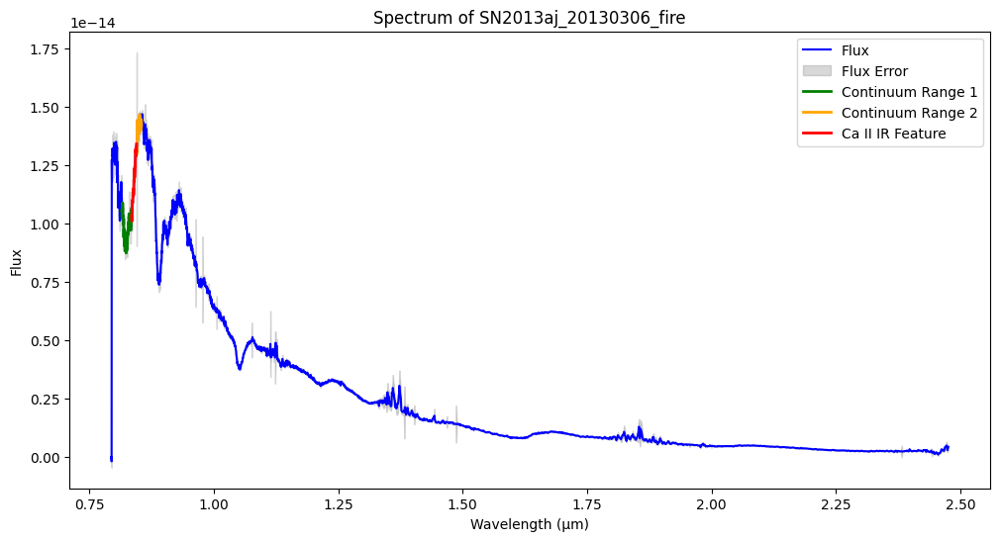

Pseudo-equivalent width for Ca II IR in SN2013aj_20130320_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013aj_20130320_fire: -4177.20 km/s


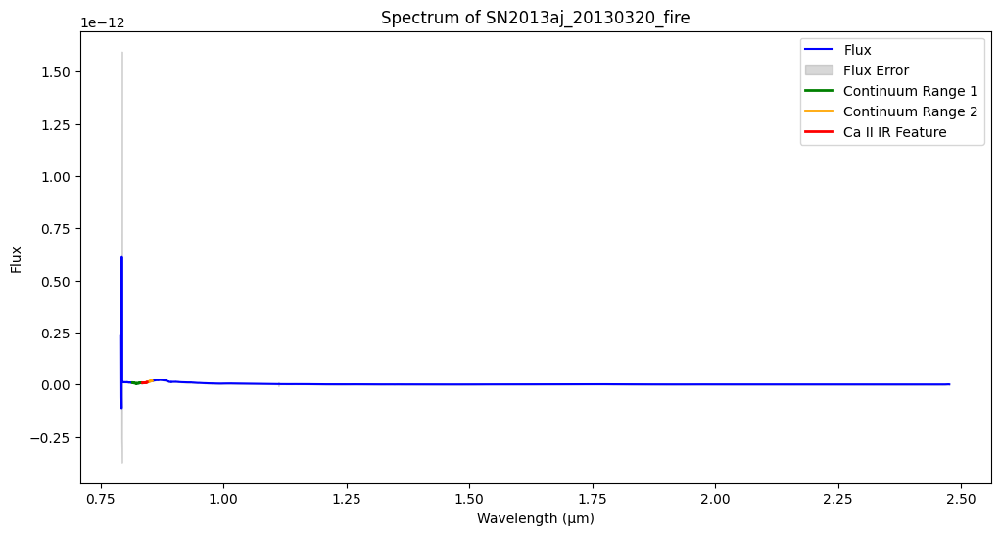

Pseudo-equivalent width for Ca II IR in SN2013aj_20130325_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013aj_20130325_fire: -4162.80 km/s


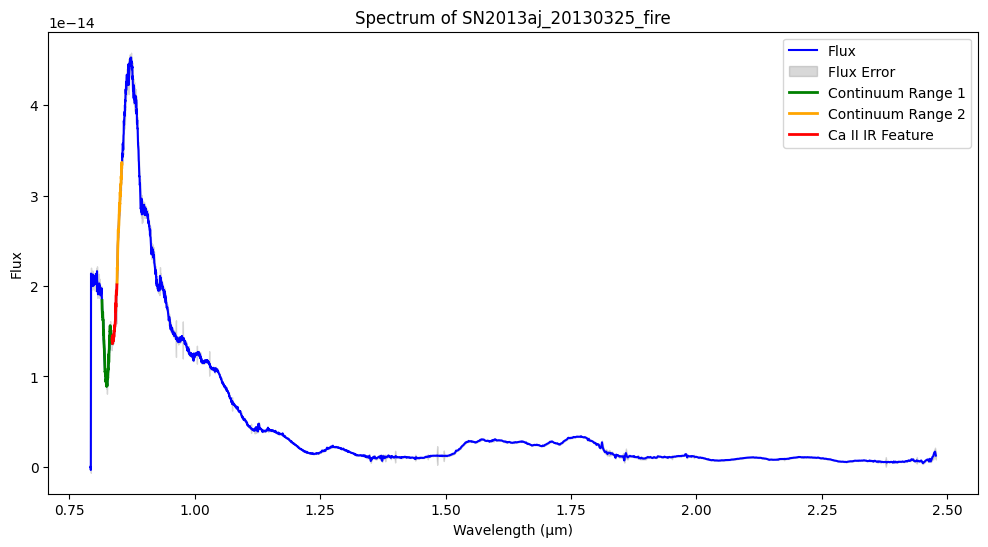

Pseudo-equivalent width for Ca II IR in SN2013aj_20130401_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013aj_20130401_fire: -4008.55 km/s


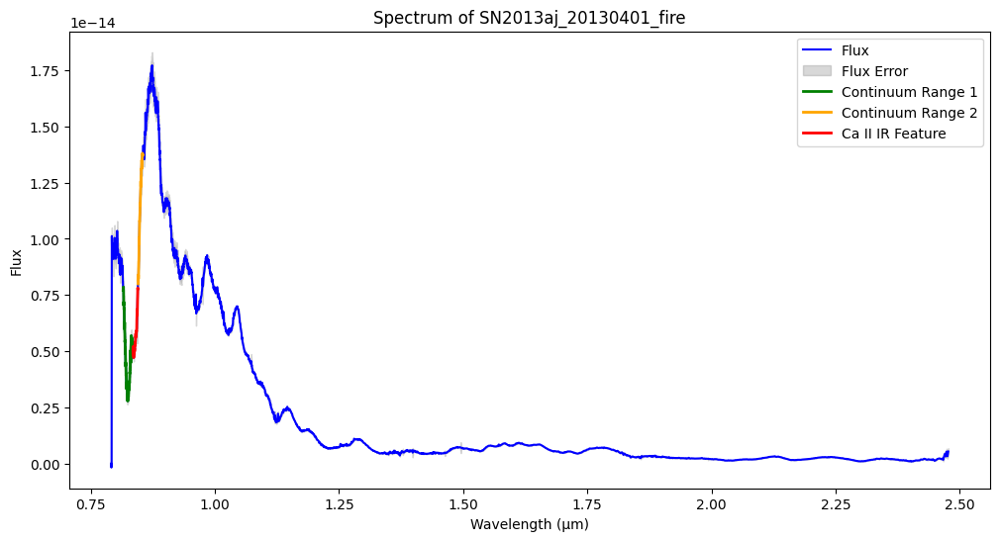

Pseudo-equivalent width for Ca II IR in SN2013aj_20130403_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013aj_20130403_fire: -3889.74 km/s


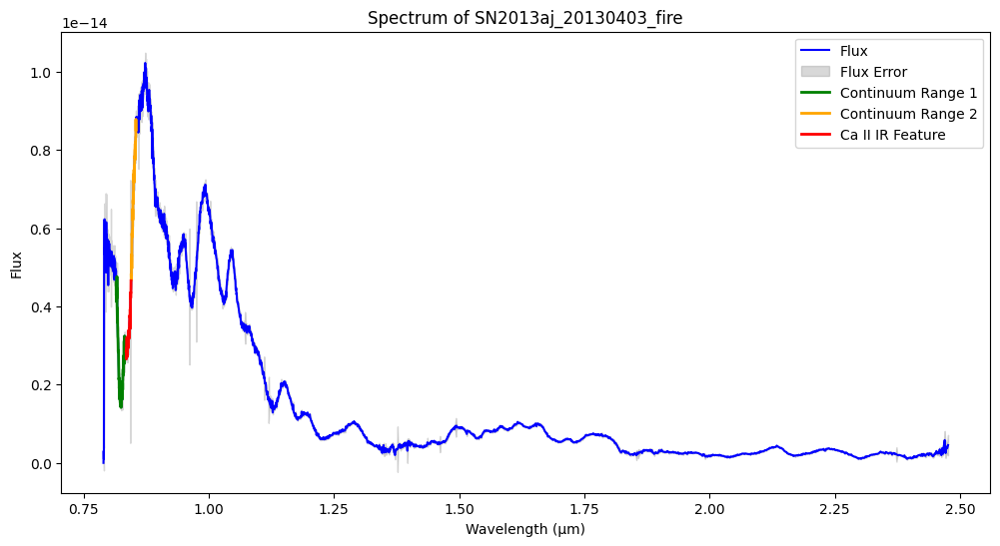

Pseudo-equivalent width for Ca II IR in SN2013aj_20130519_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013aj_20130519_fire: -4341.49 km/s


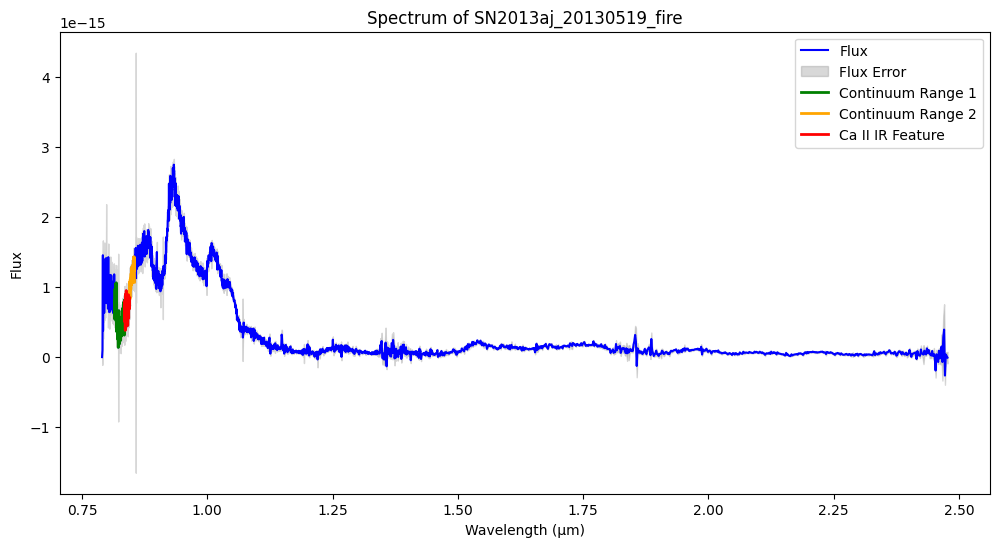

Pseudo-equivalent width for Ca II IR in SN2013ay_20130401_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013ay_20130401_fire: -2936.99 km/s


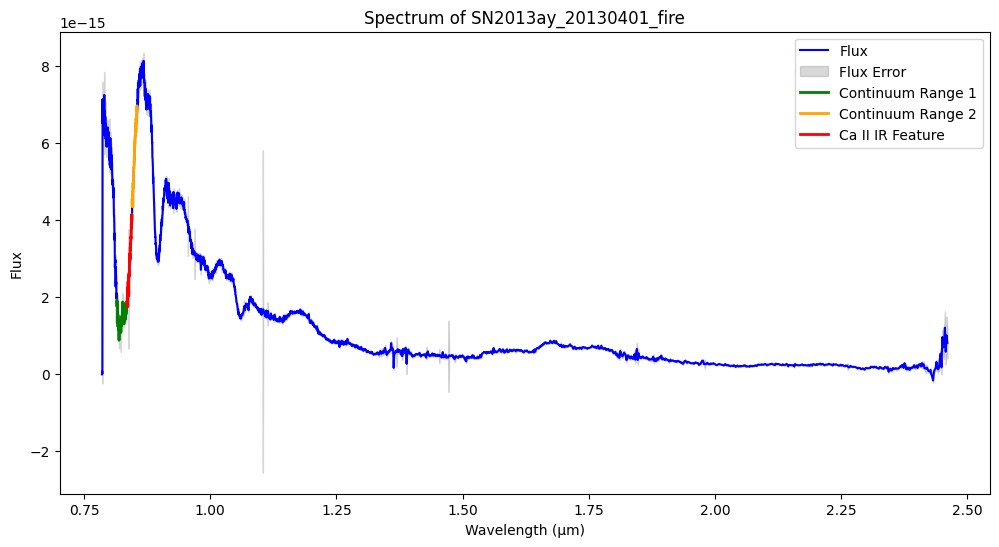

Pseudo-equivalent width for Ca II IR in SN2013ay_20130403_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013ay_20130403_fire: -2809.64 km/s


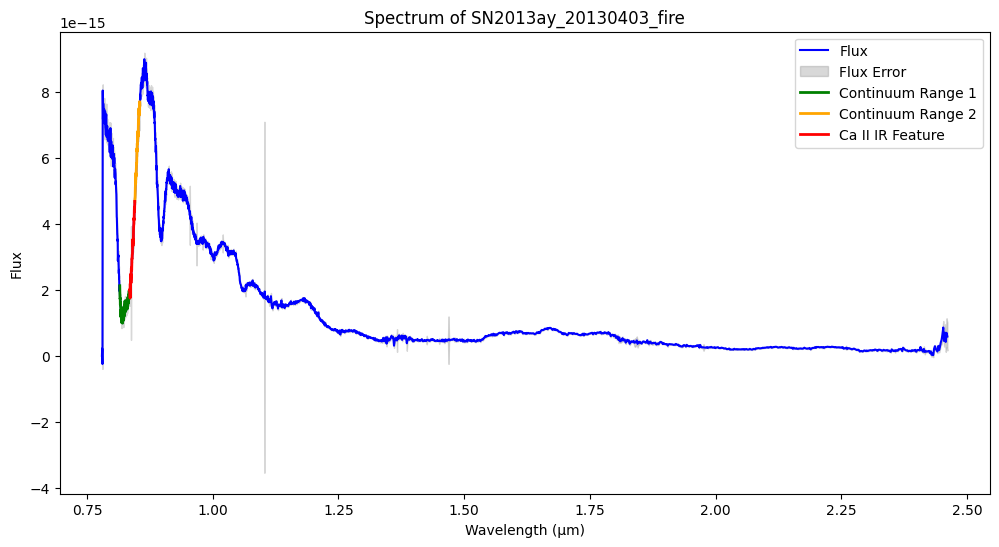

Pseudo-equivalent width for Ca II IR in SN2013az_20130401_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013az_20130401_fire: -3927.70 km/s


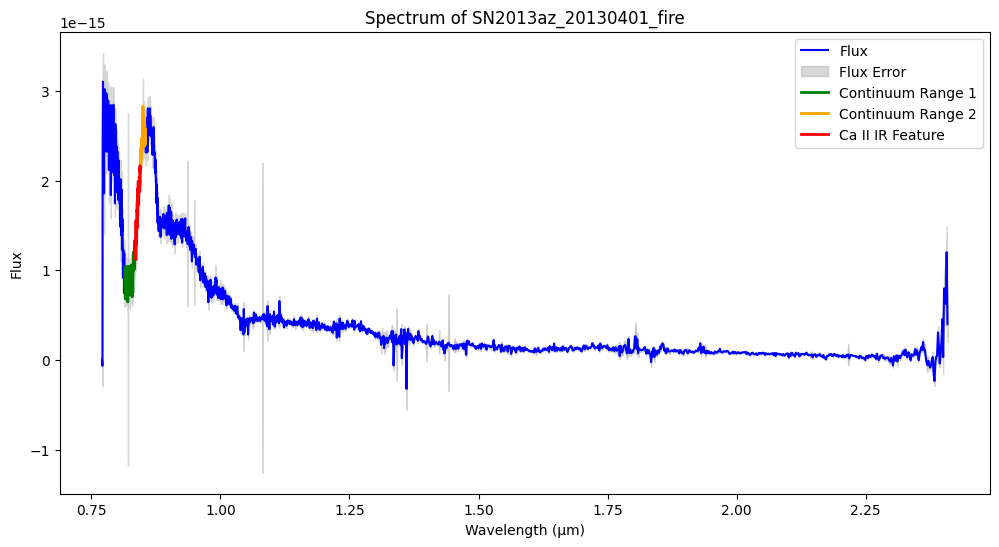

Pseudo-equivalent width for Ca II IR in SN2013bc_20130403_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013bc_20130403_fire: -3858.66 km/s


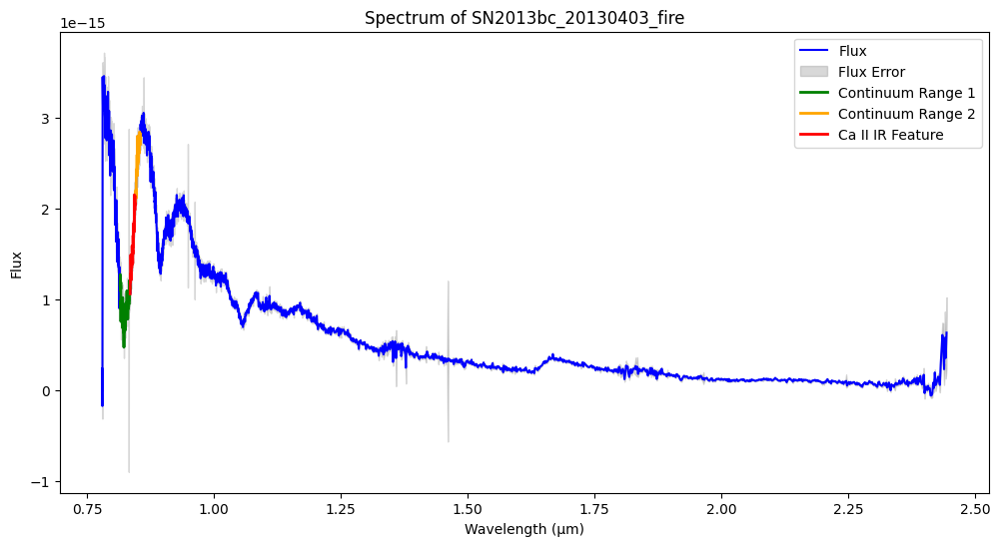

Pseudo-equivalent width for Ca II IR in SN2013bz_20130519_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013bz_20130519_fire: -4723.32 km/s


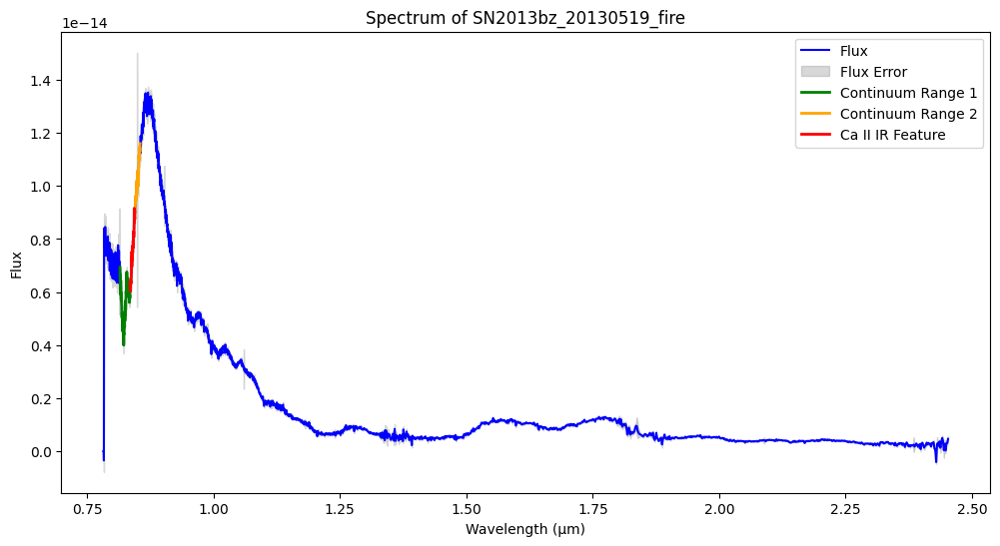

Pseudo-equivalent width for Ca II IR in SN2013ct_20130522_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013ct_20130522_fire: -3348.74 km/s


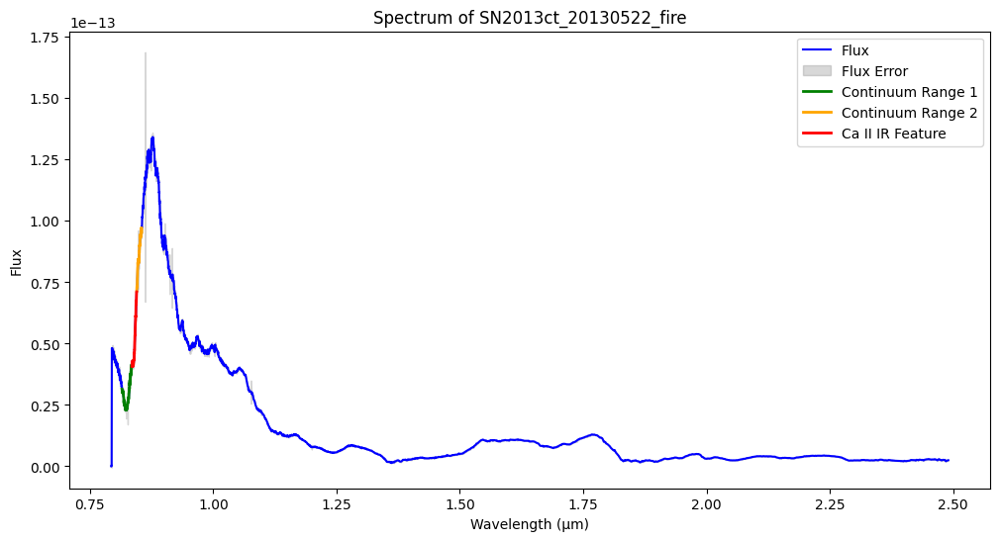

Pseudo-equivalent width for Ca II IR in SN2013ct_20130716_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013ct_20130716_fire: -3612.05 km/s


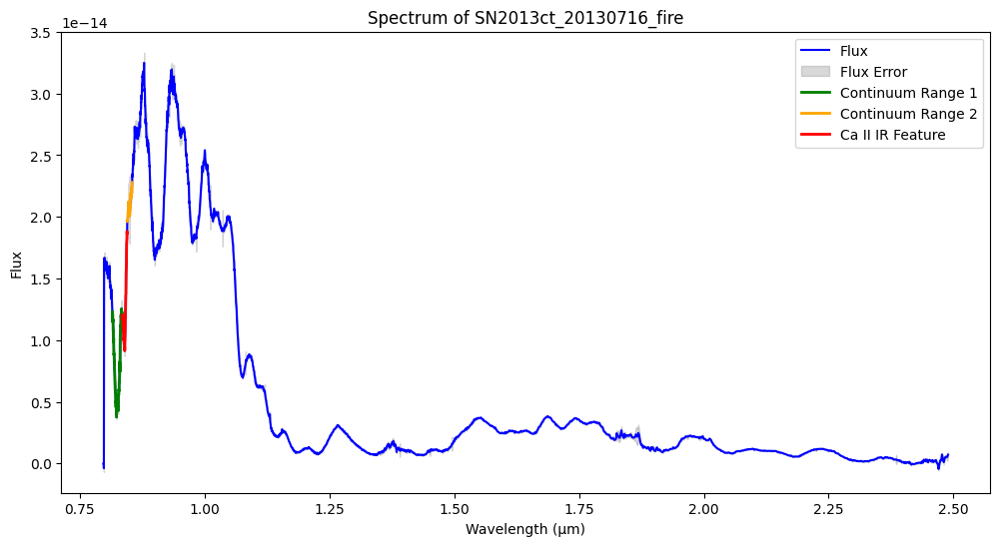

Pseudo-equivalent width for Ca II IR in SN2013ct_20130729_fire: 0.00 Å
Velocity shift for Ca II IR in SN2013ct_20130729_fire: -6054.60 km/s


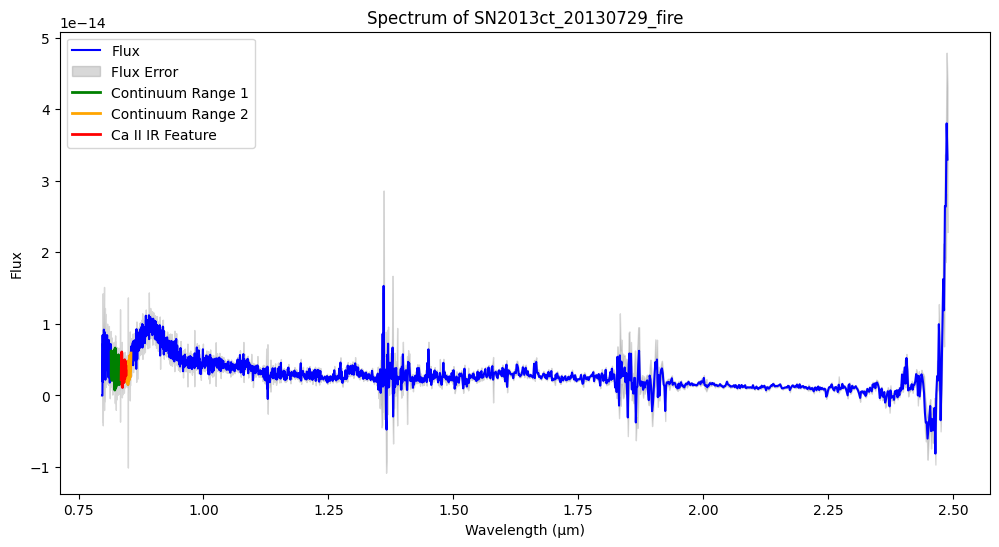

Pseudo-equivalent width for Ca II IR in SN2013fy_20131114_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013fy_20131114_fire: -4135.05 km/s


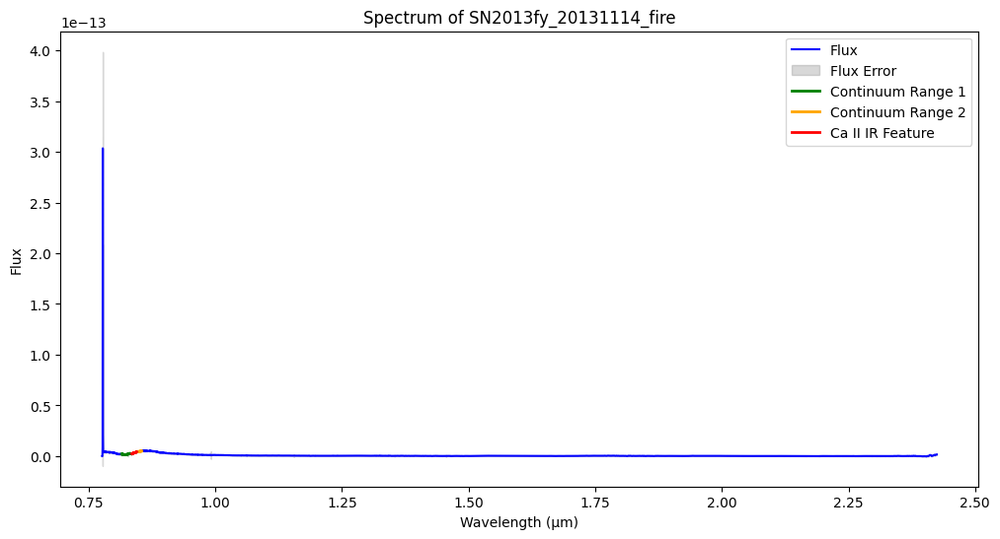

Pseudo-equivalent width for Ca II IR in SN2013fy_20131120_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013fy_20131120_fire: -3525.95 km/s


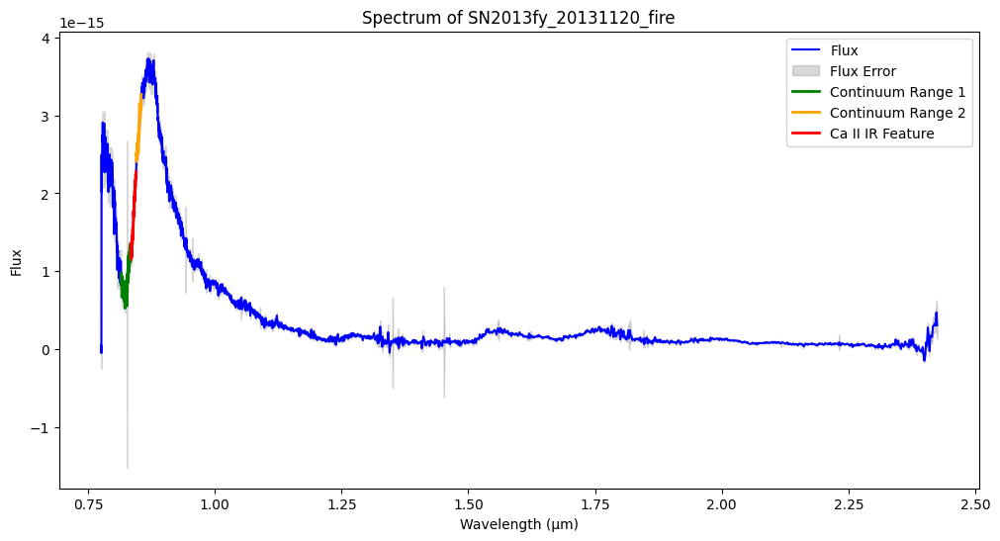

Pseudo-equivalent width for Ca II IR in SN2013fy_20131130_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013fy_20131130_fire: -3502.93 km/s


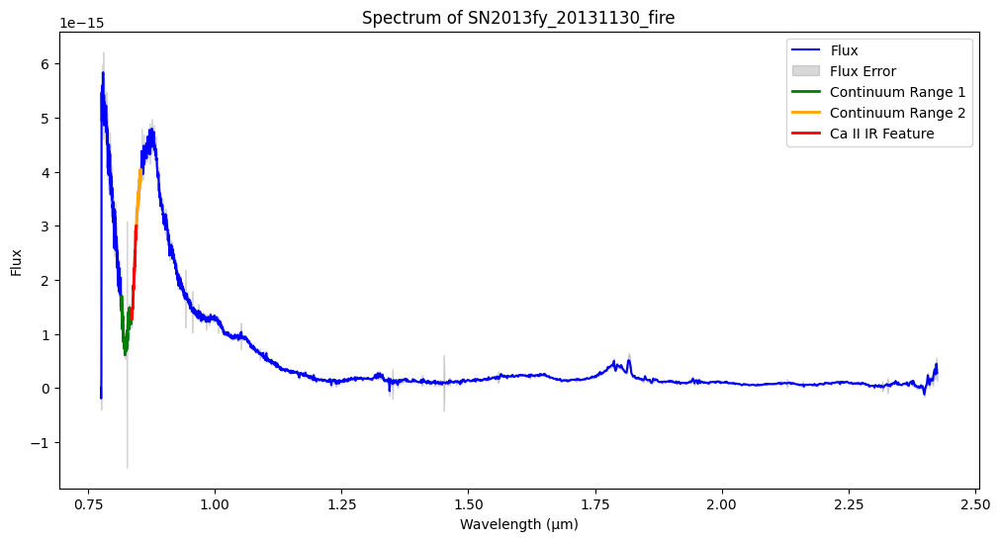

Pseudo-equivalent width for Ca II IR in SN2013fy_20131209_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013fy_20131209_fire: -3151.30 km/s


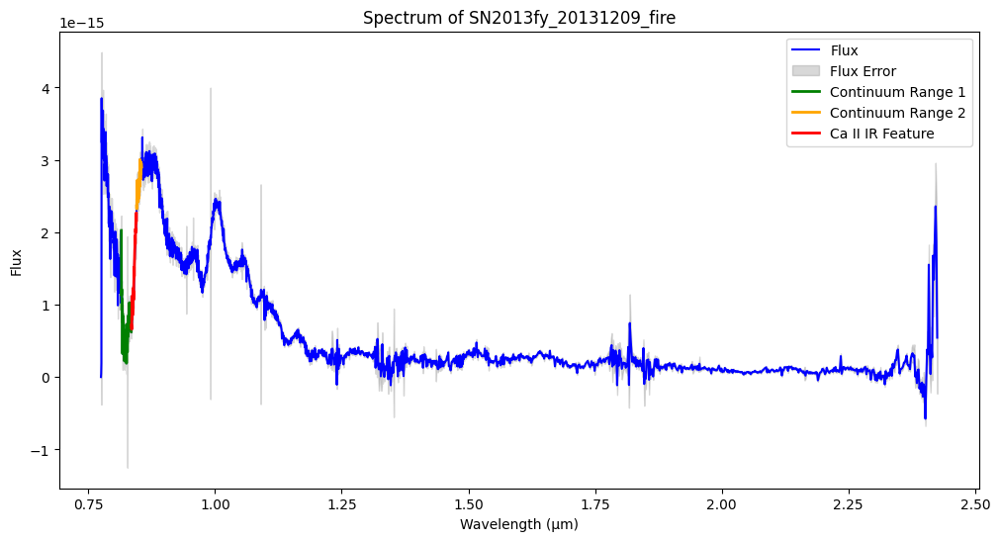

Pseudo-equivalent width for Ca II IR in SN2013fy_20131214_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013fy_20131214_fire: -3271.41 km/s


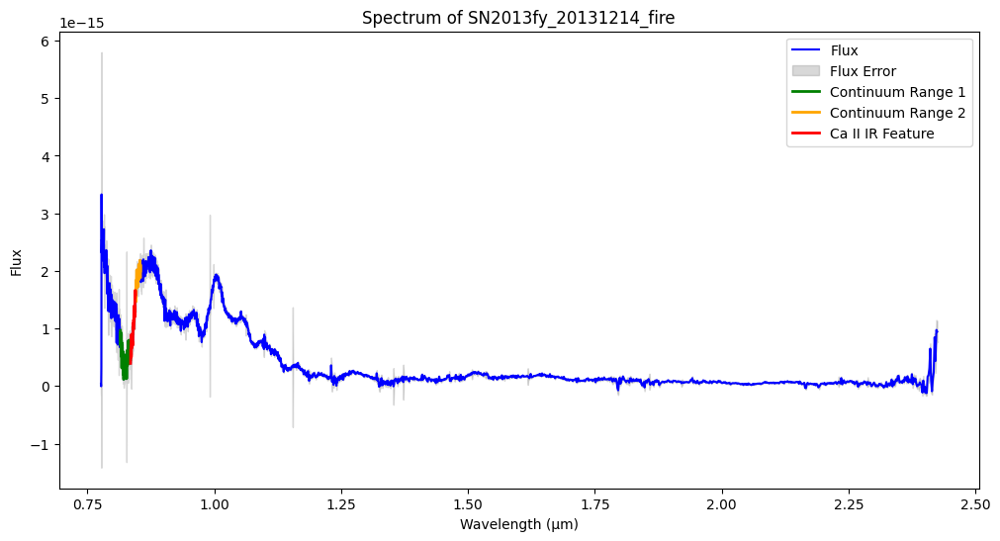

Pseudo-equivalent width for Ca II IR in SN2013fy_20131220_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013fy_20131220_fire: -3357.68 km/s


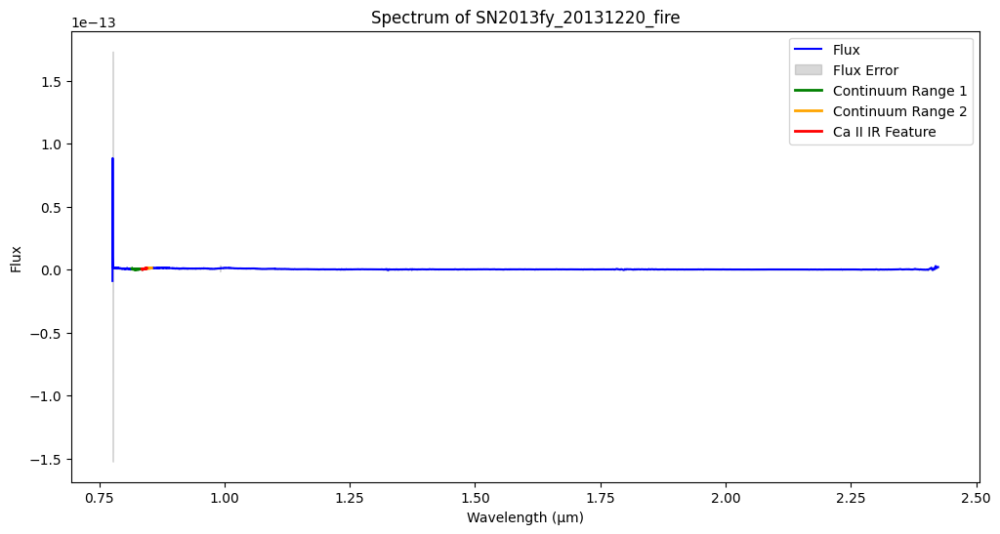

Pseudo-equivalent width for Ca II IR in SN2013fz_20131114_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013fz_20131114_fire: -4275.86 km/s


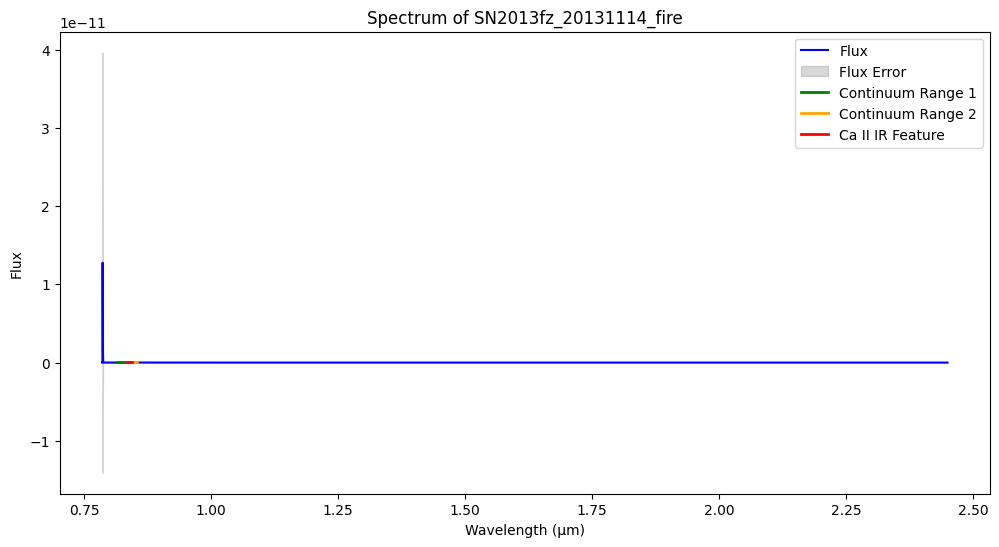

Pseudo-equivalent width for Ca II IR in SN2013fz_20131120_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013fz_20131120_fire: -3719.62 km/s


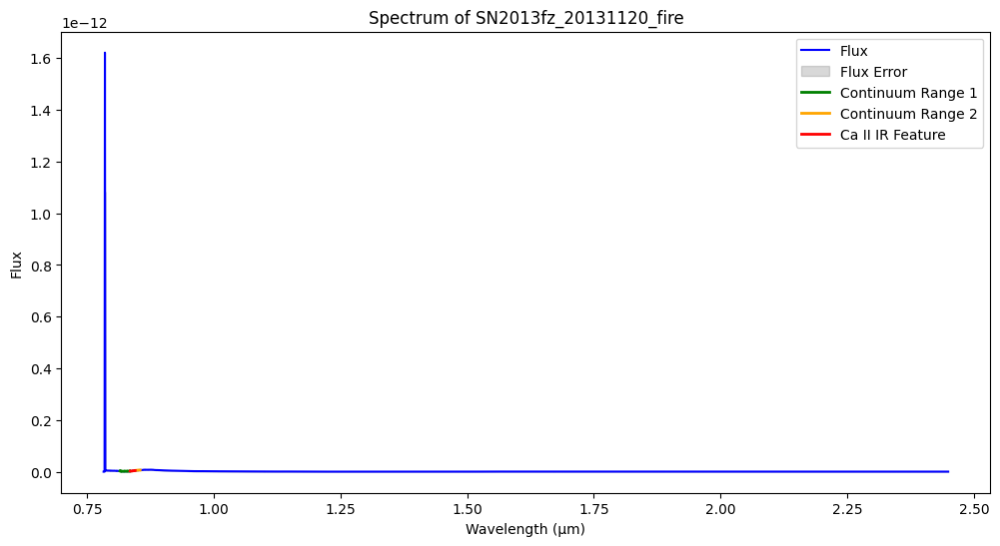

Pseudo-equivalent width for Ca II IR in SN2013fz_20131130_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013fz_20131130_fire: -3600.29 km/s


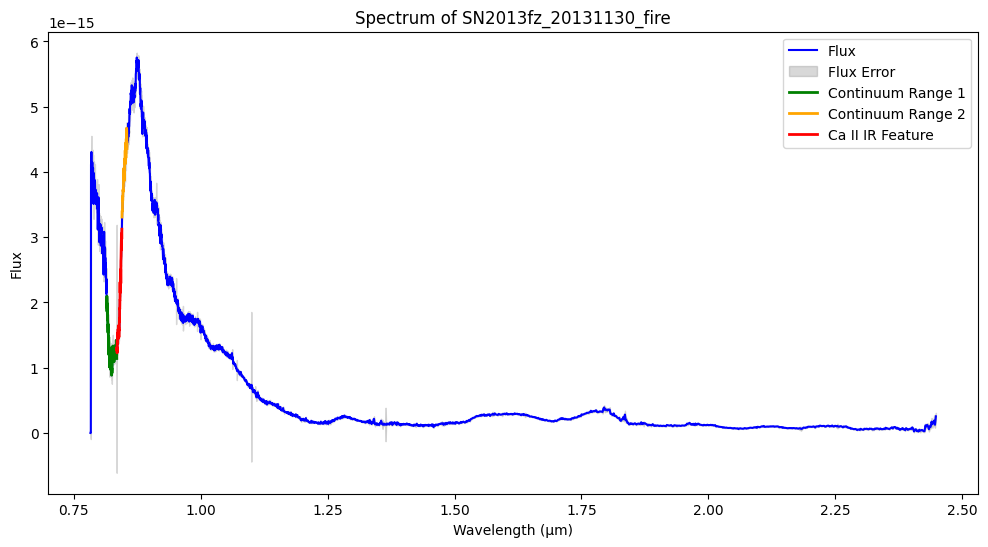

Pseudo-equivalent width for Ca II IR in SN2013fz_20131214_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013fz_20131214_fire: -3117.93 km/s


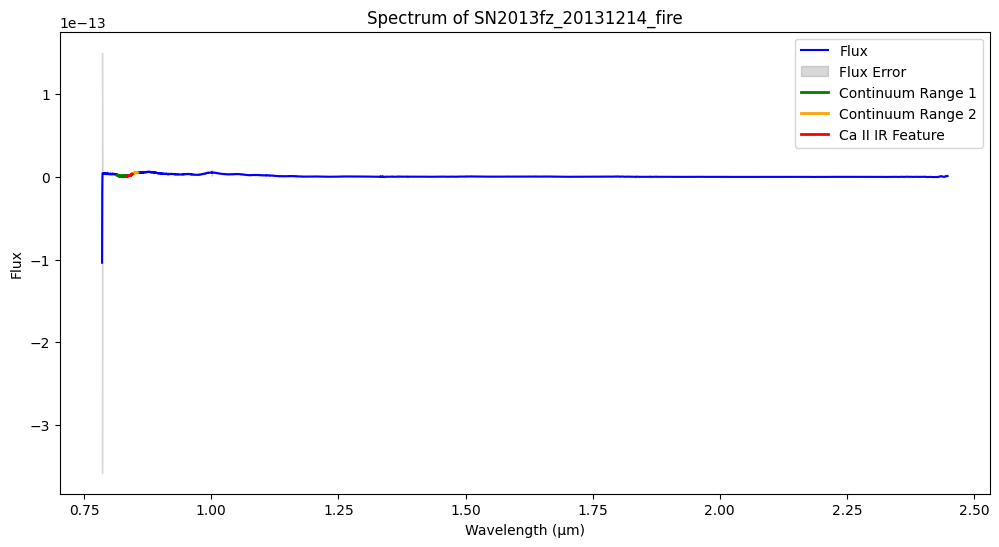

Pseudo-equivalent width for Ca II IR in SN2013fz_20131220_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013fz_20131220_fire: -3077.51 km/s


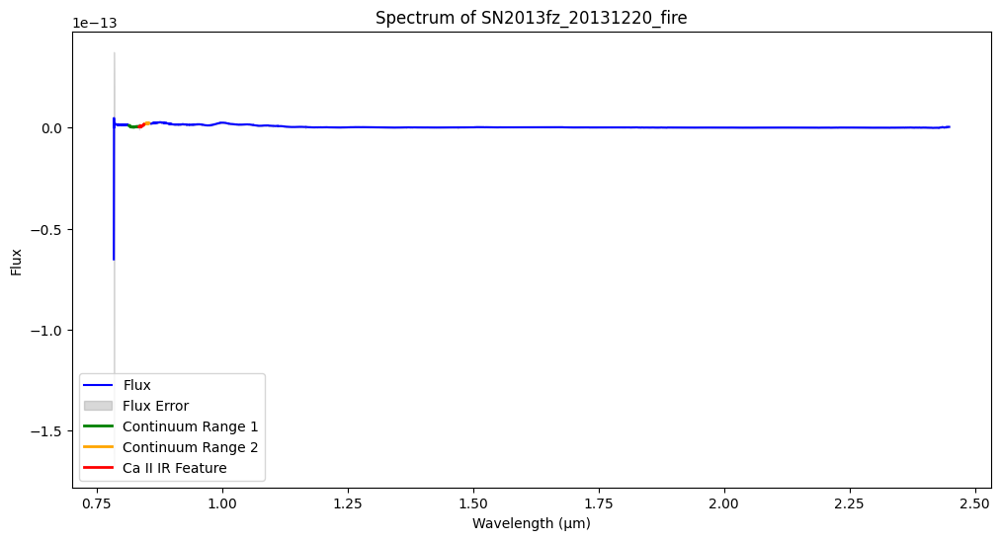

Pseudo-equivalent width for Ca II IR in SN2013fz_20131227_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013fz_20131227_fire: -3355.43 km/s


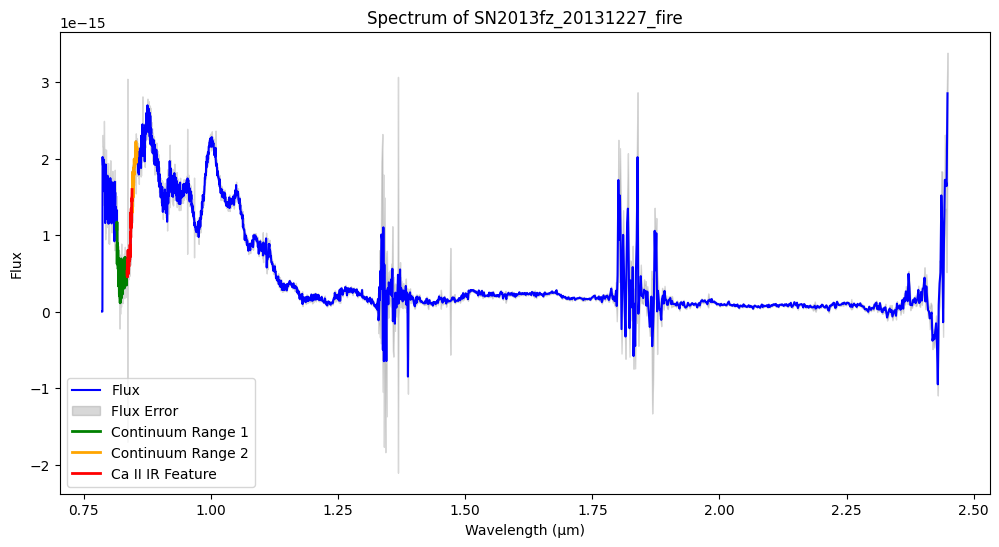

Pseudo-equivalent width for Ca II IR in SN2013fz_20140101_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013fz_20140101_fire: -3077.78 km/s


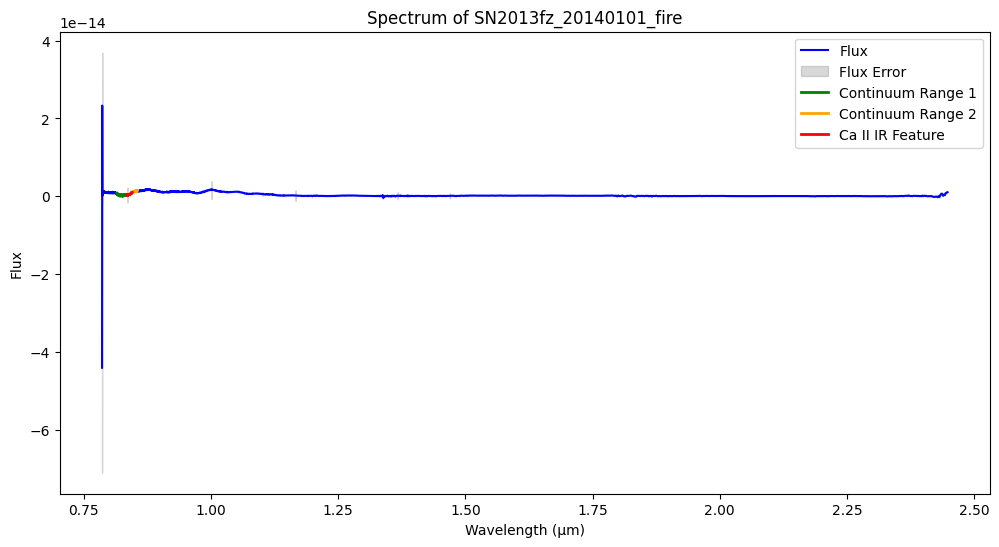

Pseudo-equivalent width for Ca II IR in SN2013gv_20131209_fire: 0.00 Å
Velocity shift for Ca II IR in SN2013gv_20131209_fire: -5551.88 km/s


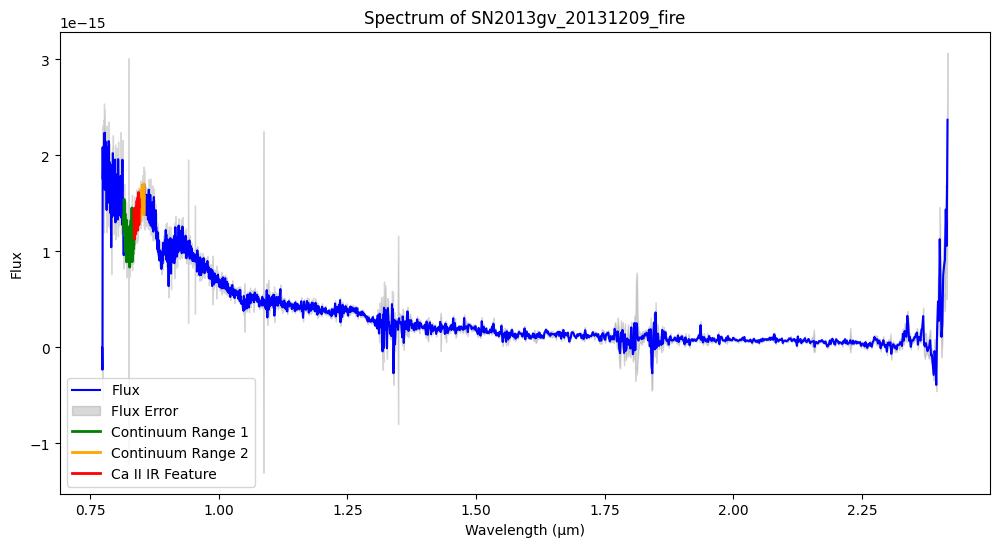

Pseudo-equivalent width for Ca II IR in SN2013gv_20131214_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013gv_20131214_fire: -5042.44 km/s


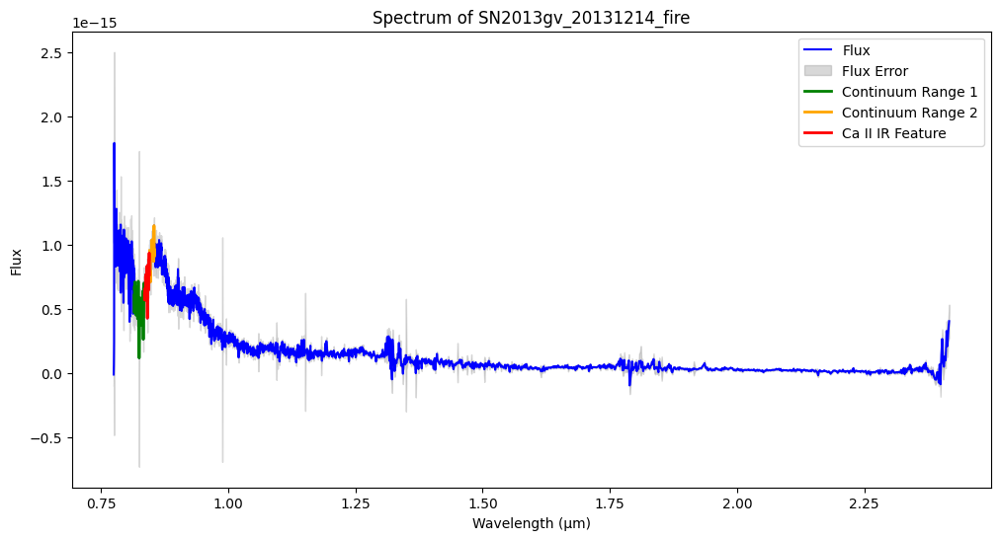

Pseudo-equivalent width for Ca II IR in SN2013gv_20131220_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013gv_20131220_fire: -4367.37 km/s


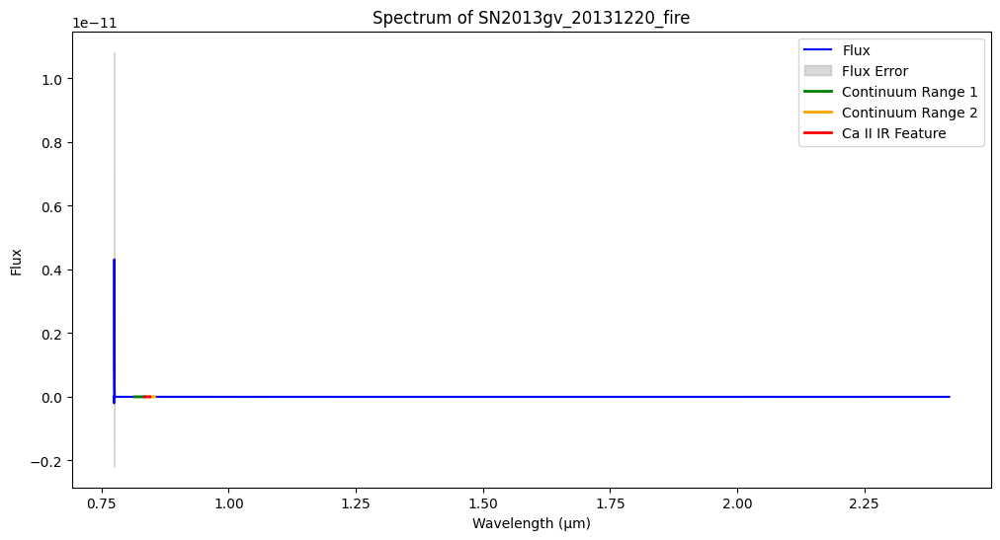

Pseudo-equivalent width for Ca II IR in SN2013gv_20140101_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013gv_20140101_fire: -3860.31 km/s


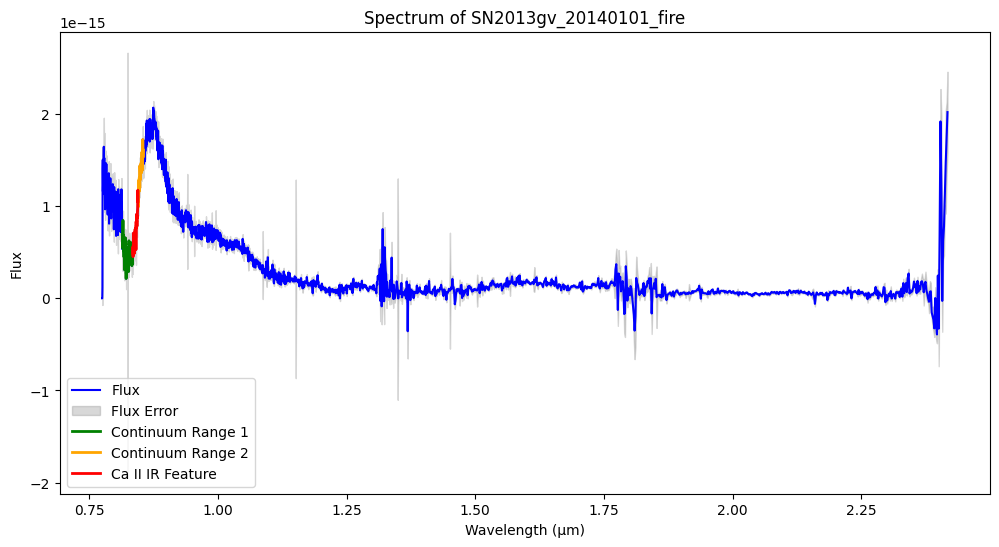

Pseudo-equivalent width for Ca II IR in SN2013gy_20131209_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013gy_20131209_fire: -4284.87 km/s


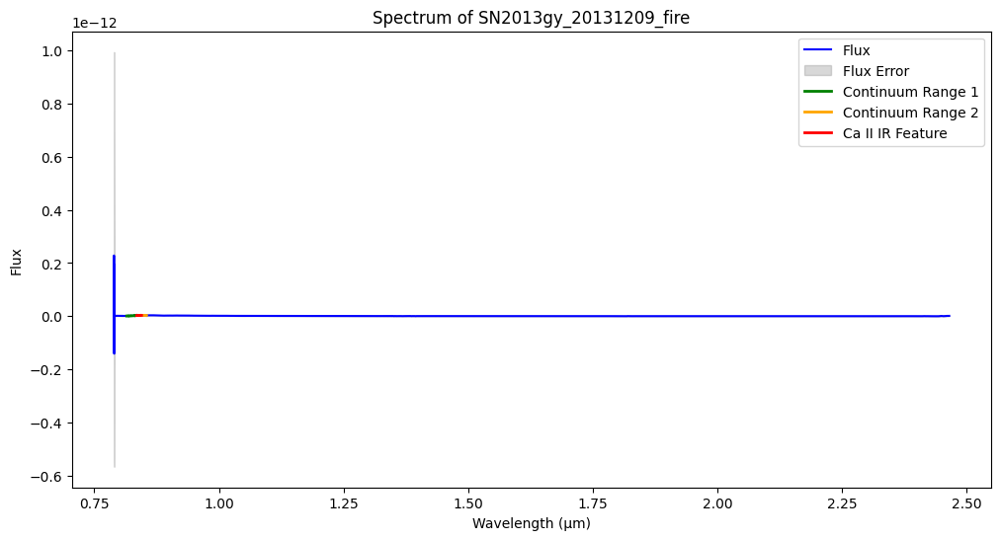

Pseudo-equivalent width for Ca II IR in SN2013gy_20131214_fire: 0.00 Å
Velocity shift for Ca II IR in SN2013gy_20131214_fire: -4757.53 km/s


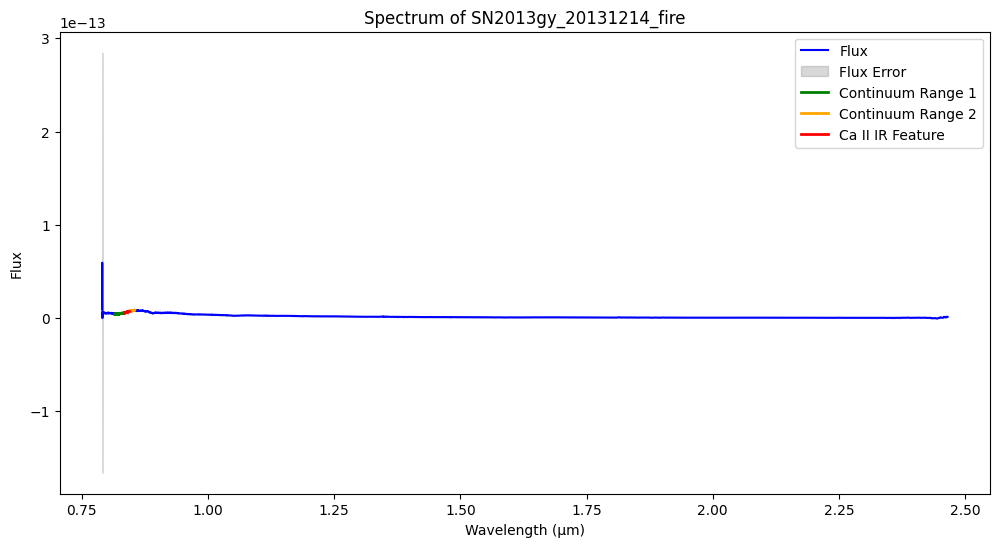

Pseudo-equivalent width for Ca II IR in SN2013gy_20131220_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013gy_20131220_fire: -4878.37 km/s


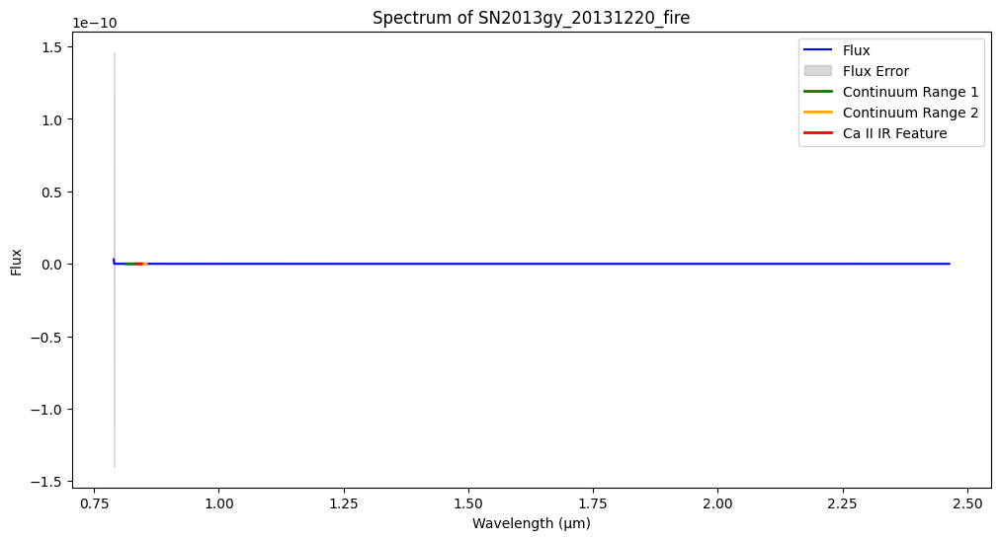

Pseudo-equivalent width for Ca II IR in SN2013gy_20131227_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013gy_20131227_fire: -3988.79 km/s


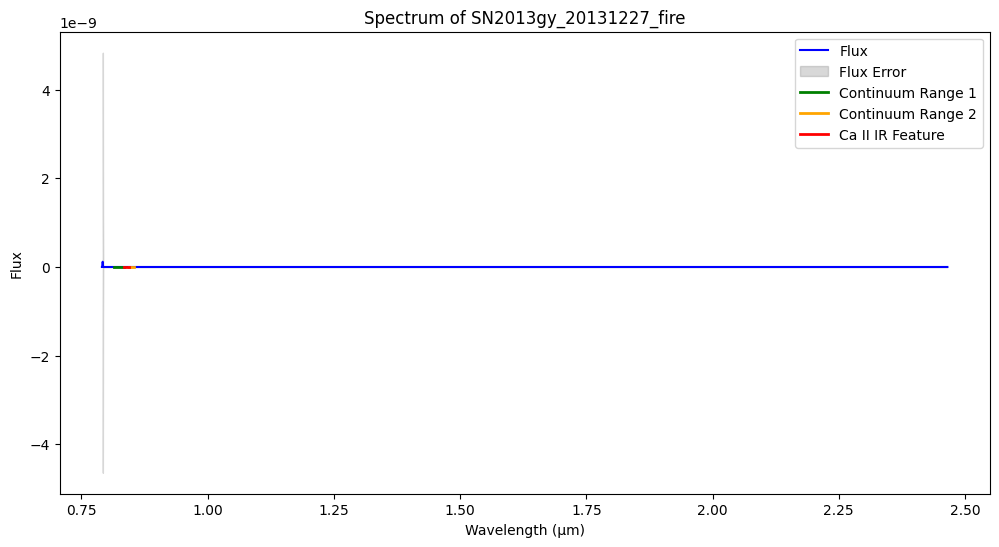

Pseudo-equivalent width for Ca II IR in SN2013gy_20140101_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013gy_20140101_fire: -3698.07 km/s


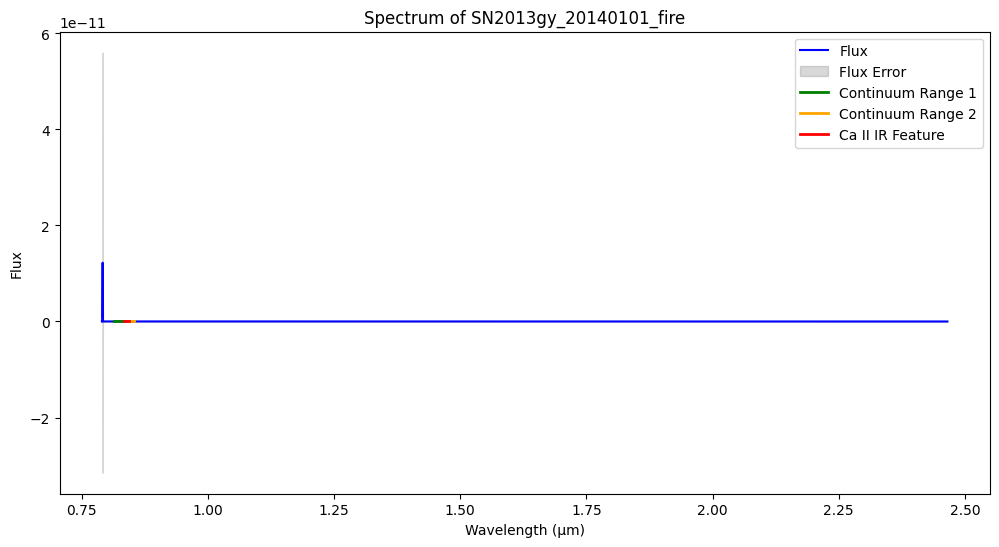

Pseudo-equivalent width for Ca II IR in SN2013gy_20140109_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013gy_20140109_fire: -3697.50 km/s


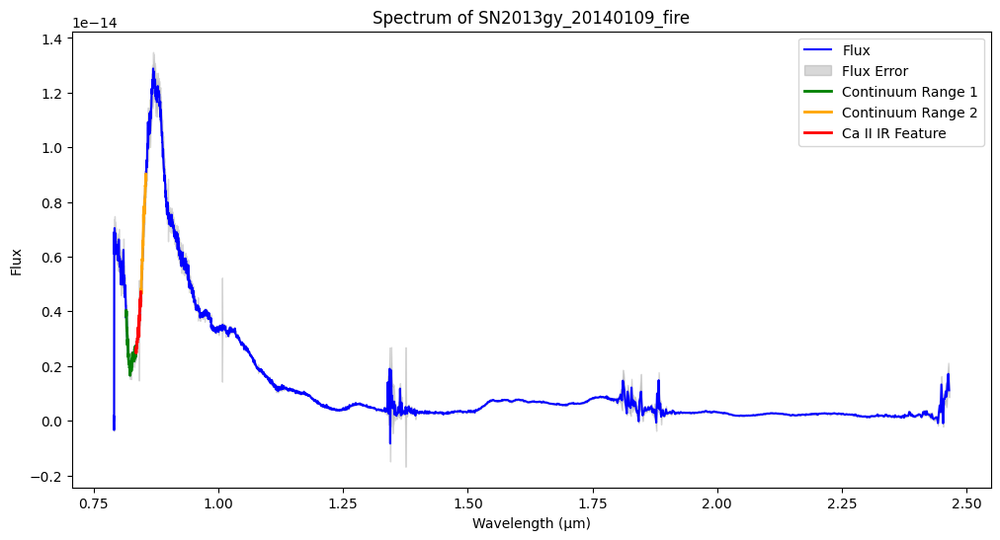

Pseudo-equivalent width for Ca II IR in SN2013gy_20140114_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013gy_20140114_fire: -3773.99 km/s


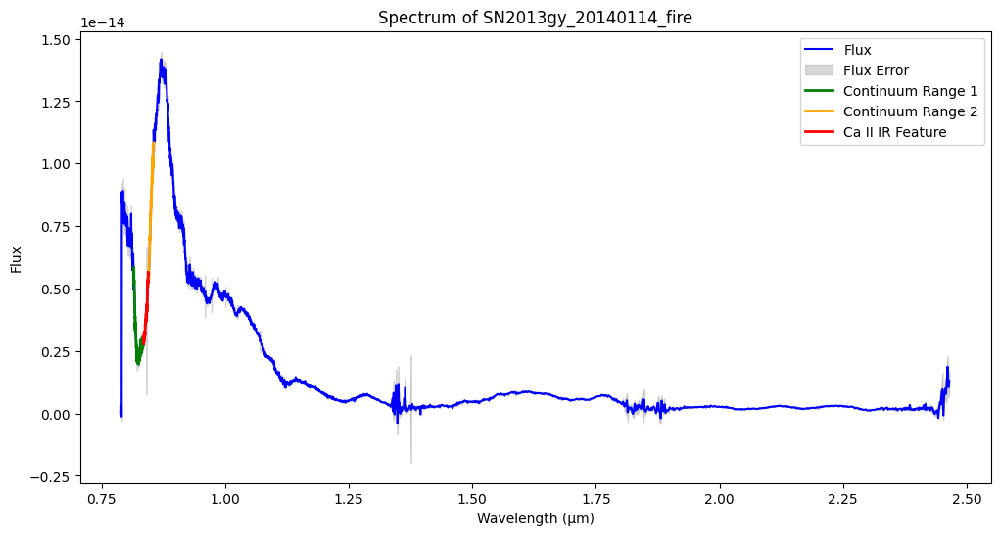

Pseudo-equivalent width for Ca II IR in SN2013gy_20140208_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013gy_20140208_fire: -3829.86 km/s


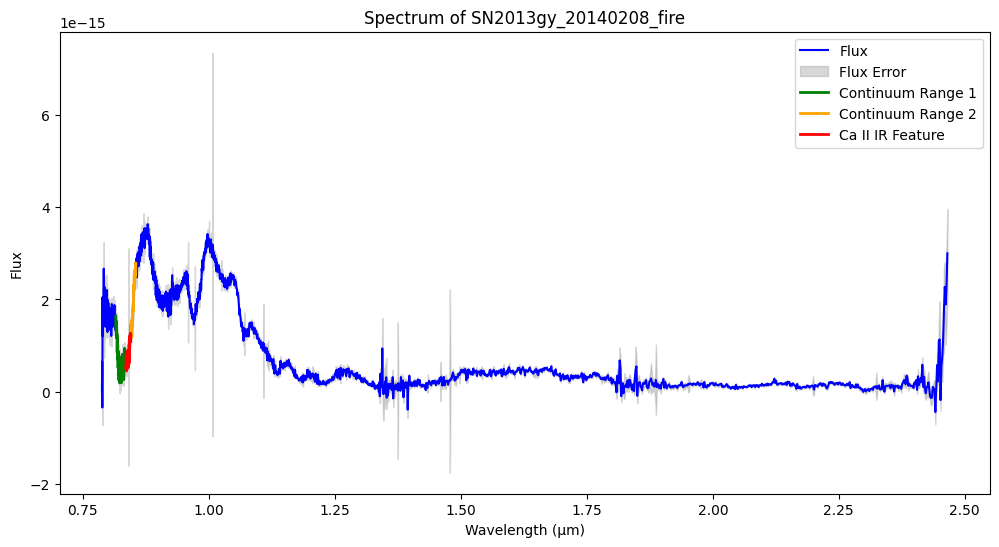

Pseudo-equivalent width for Ca II IR in SN2013gy_20140215_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013gy_20140215_fire: -4072.51 km/s


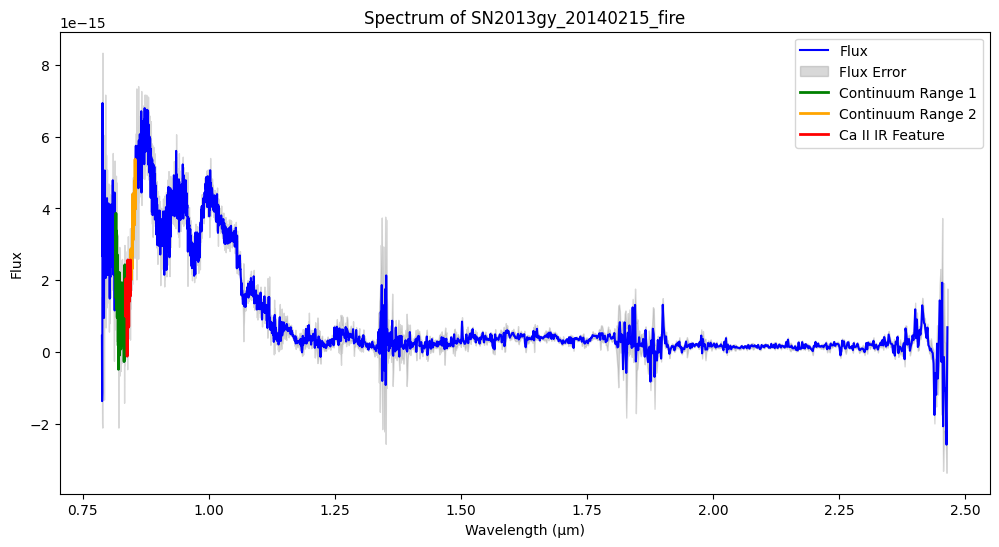

Pseudo-equivalent width for Ca II IR in SN2013gy_20140222_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013gy_20140222_fire: -4113.00 km/s


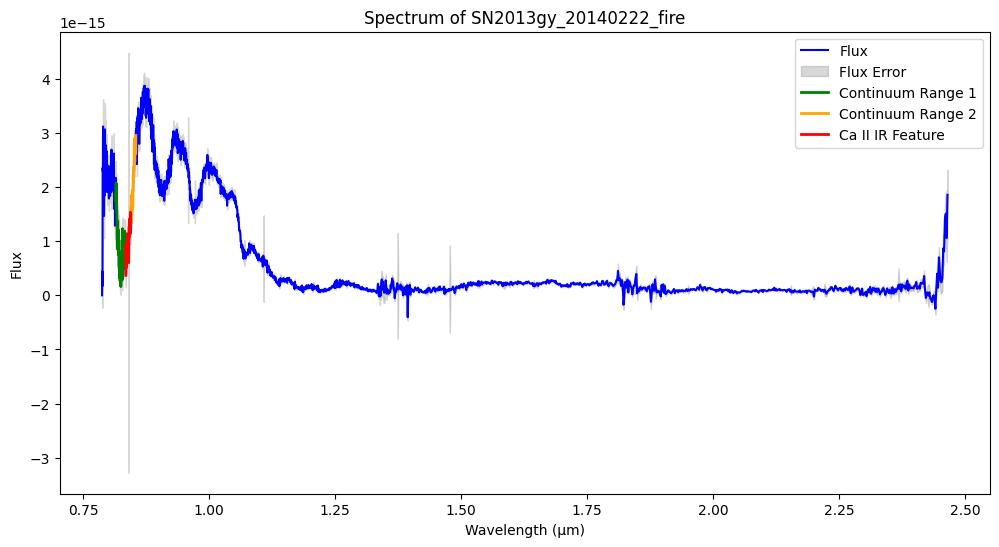

Pseudo-equivalent width for Ca II IR in SN2013gy_20140227_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013gy_20140227_fire: -3778.03 km/s


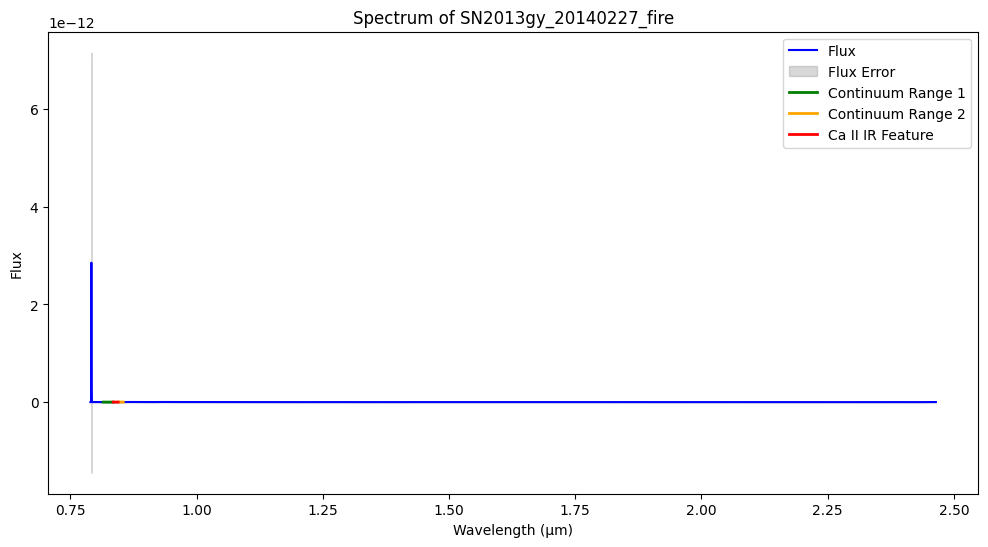

Pseudo-equivalent width for Ca II IR in SN2013gy_20140318_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013gy_20140318_fire: -4213.49 km/s


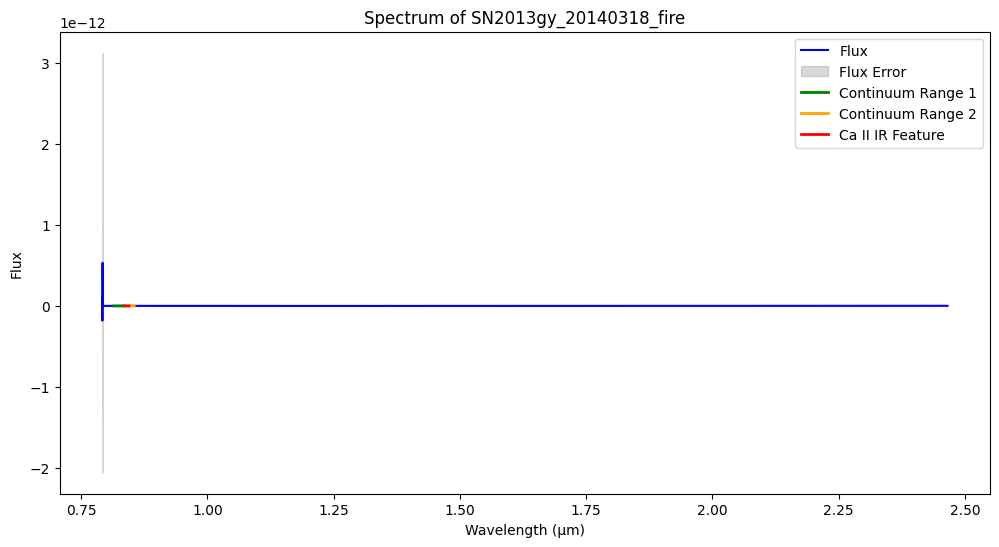

Pseudo-equivalent width for Ca II IR in SN2013hh_20131214_fire: 0.00 Å
Velocity shift for Ca II IR in SN2013hh_20131214_fire: -5528.67 km/s


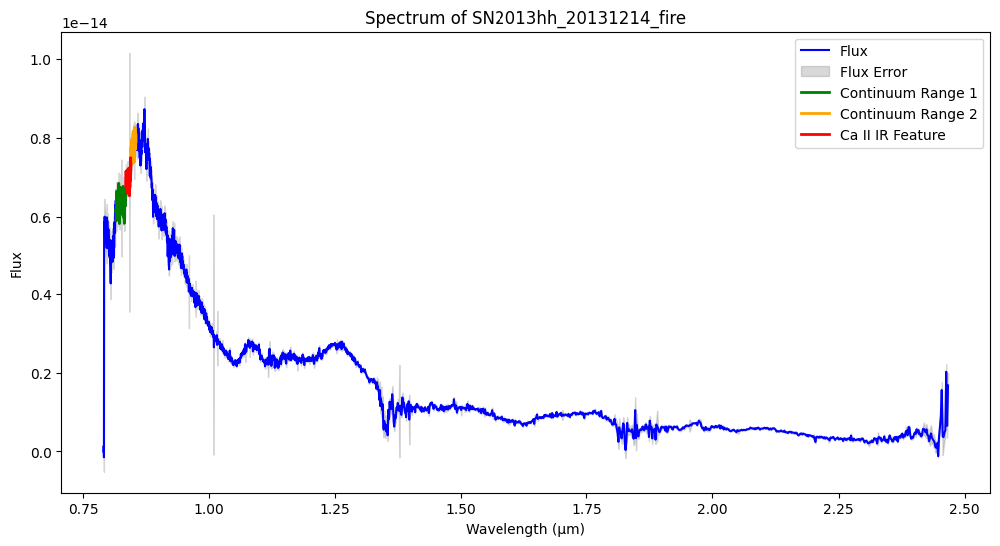

Pseudo-equivalent width for Ca II IR in SN2013hh_20131220_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013hh_20131220_fire: -4724.50 km/s


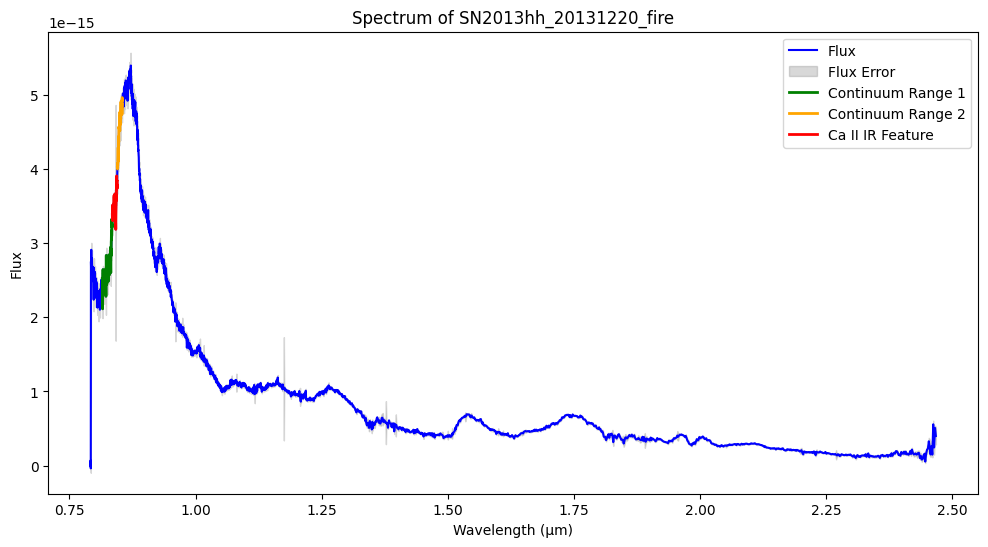

Pseudo-equivalent width for Ca II IR in SN2013hh_20131227_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013hh_20131227_fire: -3881.54 km/s


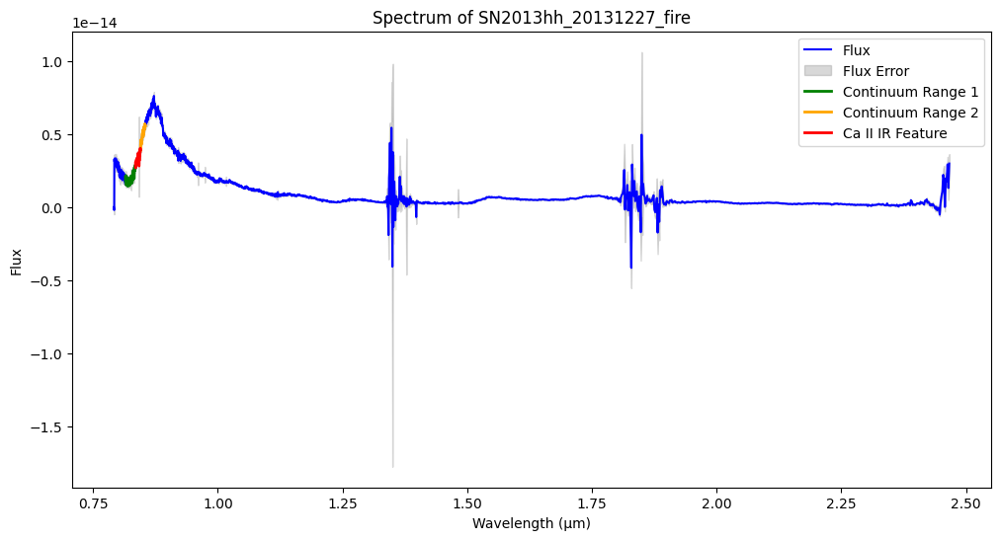

Pseudo-equivalent width for Ca II IR in SN2013hh_20140101_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013hh_20140101_fire: -3632.15 km/s


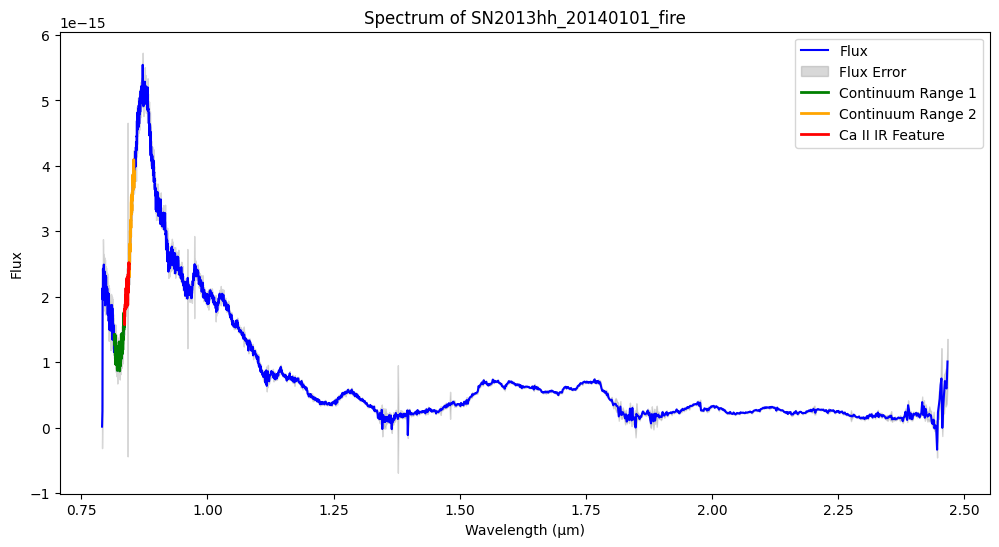

Pseudo-equivalent width for Ca II IR in SN2013hh_20140109_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013hh_20140109_fire: -3762.92 km/s


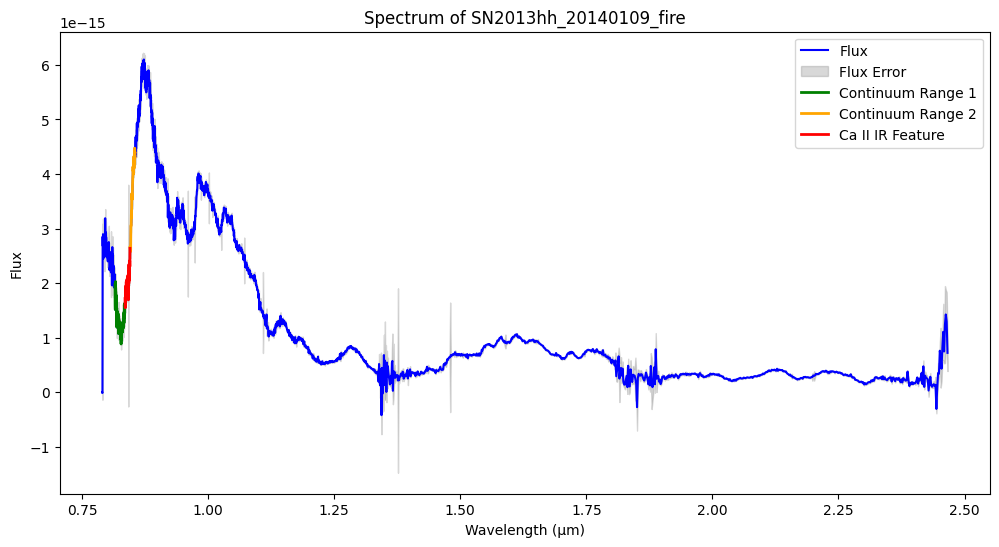

Pseudo-equivalent width for Ca II IR in SN2013hh_20140114_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013hh_20140114_fire: -4048.92 km/s


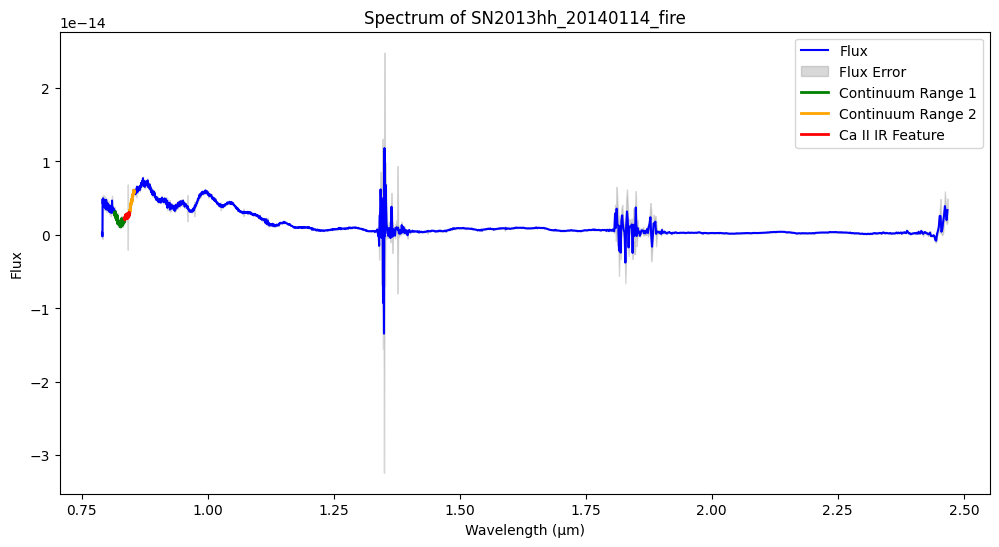

Pseudo-equivalent width for Ca II IR in SN2013hn_20131220_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013hn_20131220_fire: -4186.96 km/s


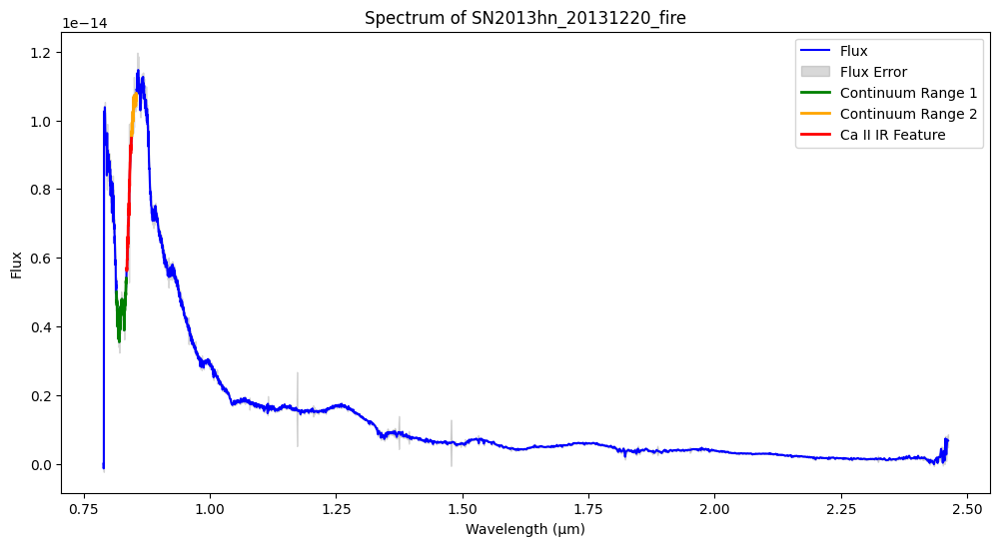

Pseudo-equivalent width for Ca II IR in SN2013hn_20131227_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013hn_20131227_fire: -3709.90 km/s


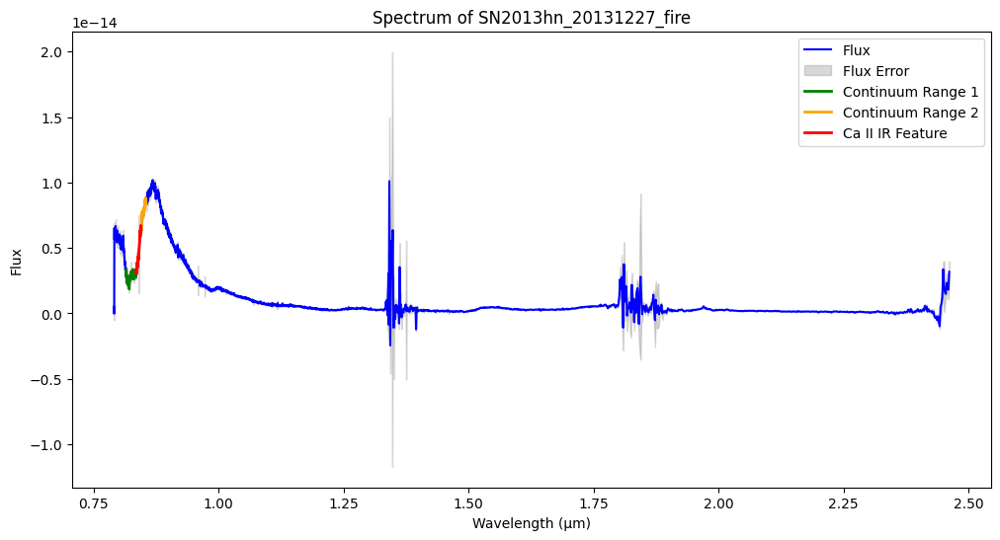

Pseudo-equivalent width for Ca II IR in SN2013hn_20140101_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013hn_20140101_fire: -3445.65 km/s


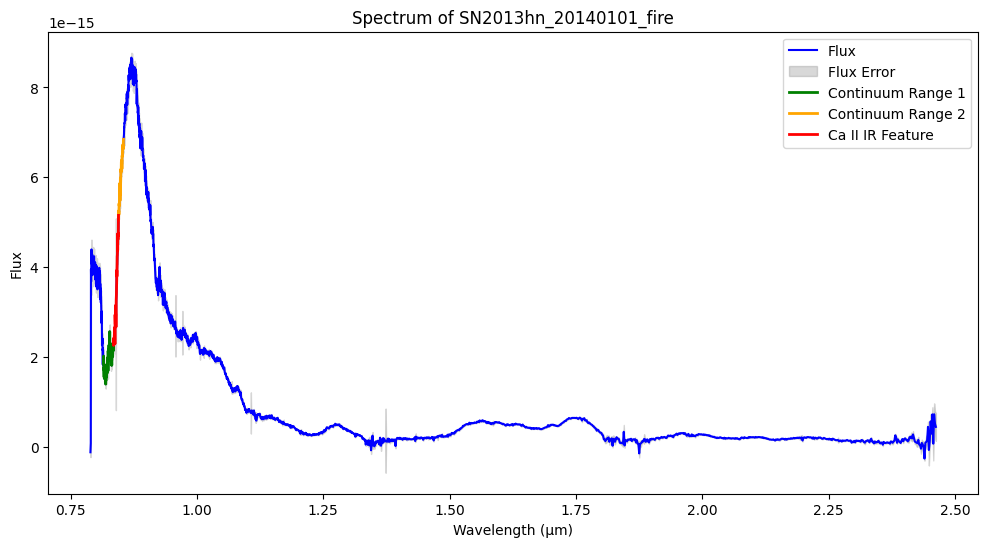

Pseudo-equivalent width for Ca II IR in SN2013hn_20140114_fire: 0.01 Å
Velocity shift for Ca II IR in SN2013hn_20140114_fire: -2887.94 km/s


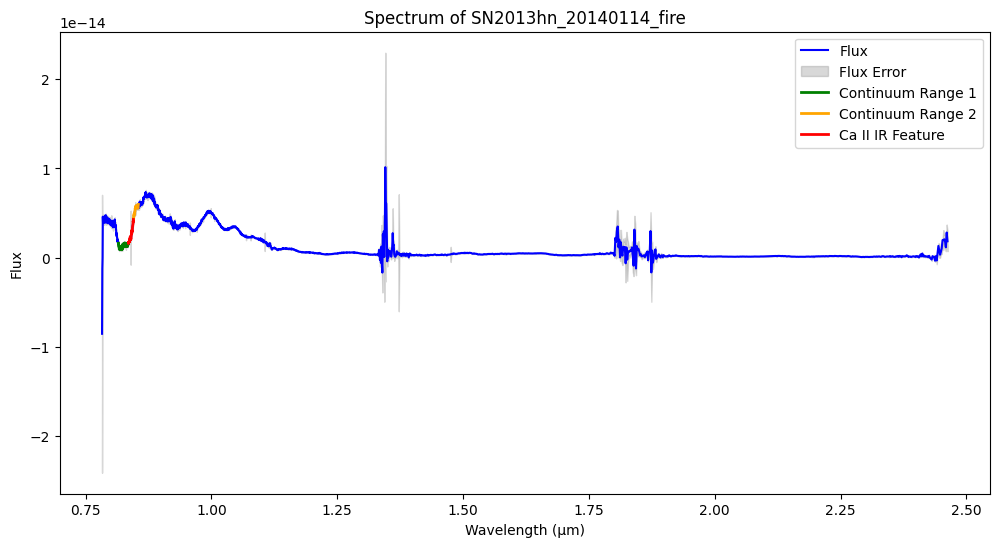

Pseudo-equivalent width for Ca II IR in SN2014D_20140109_fire: 0.01 Å
Velocity shift for Ca II IR in SN2014D_20140109_fire: -4550.33 km/s


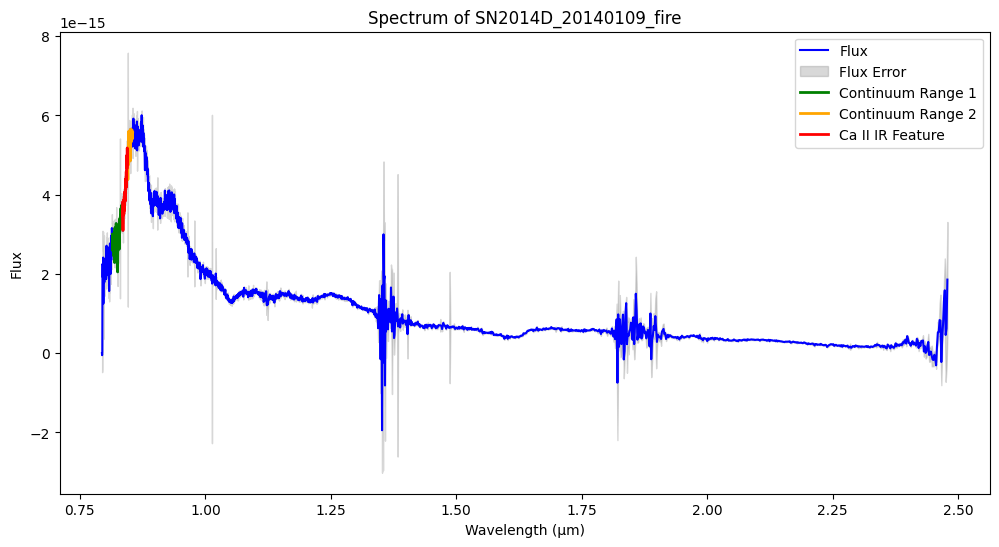

Pseudo-equivalent width for Ca II IR in SN2014D_20140114_fire: 0.01 Å
Velocity shift for Ca II IR in SN2014D_20140114_fire: -3854.75 km/s


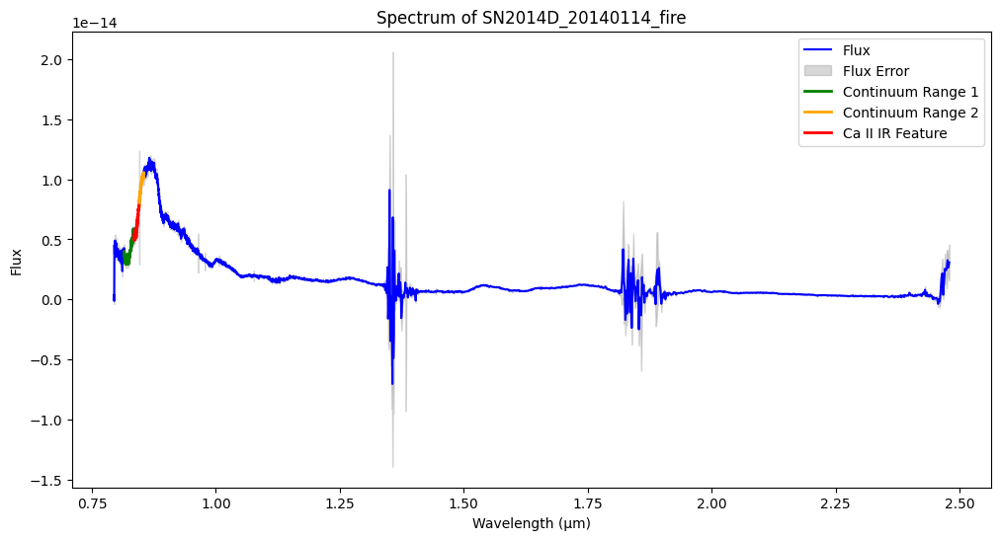

Pseudo-equivalent width for Ca II IR in SN2014I_20140208_fire: 0.01 Å
Velocity shift for Ca II IR in SN2014I_20140208_fire: -4280.05 km/s


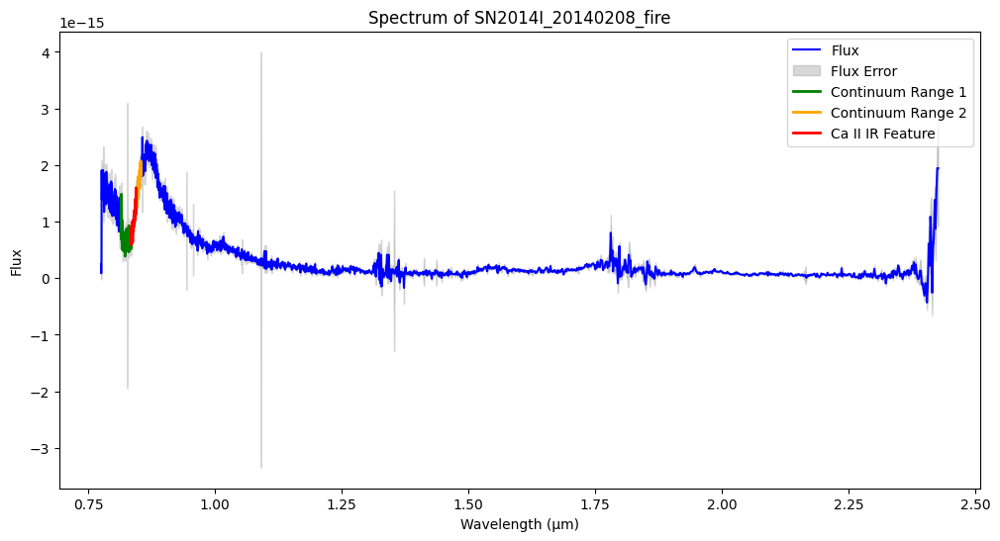

Pseudo-equivalent width for Ca II IR in SN2014I_20140215_fire: 0.01 Å
Velocity shift for Ca II IR in SN2014I_20140215_fire: -4351.49 km/s


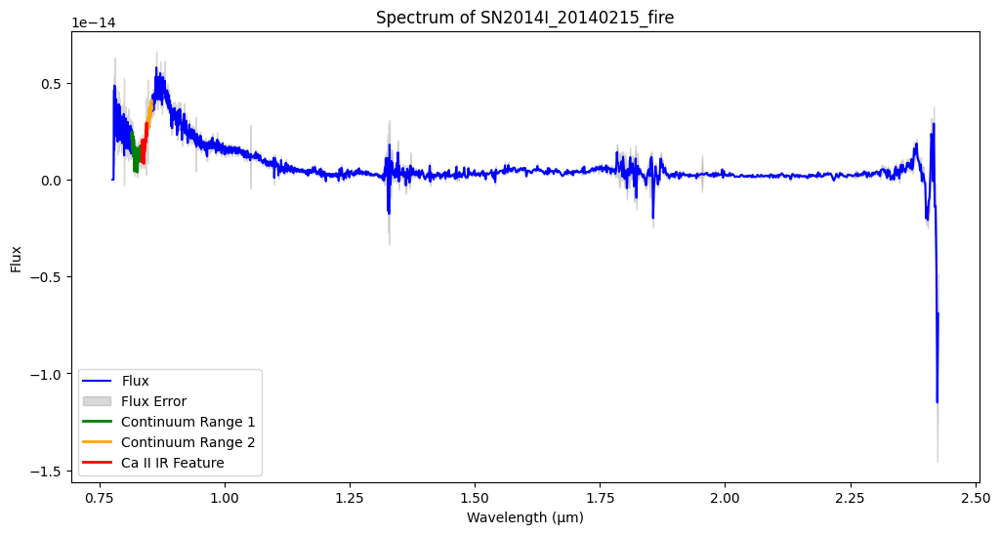

Pseudo-equivalent width for Ca II IR in SN2014I_20140222_fire: 0.01 Å
Velocity shift for Ca II IR in SN2014I_20140222_fire: -3996.49 km/s


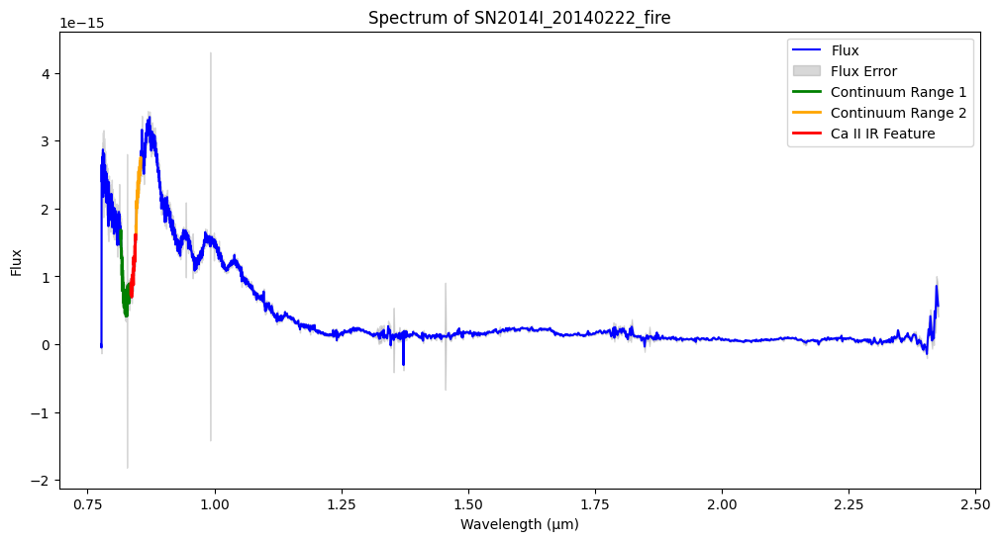

Pseudo-equivalent width for Ca II IR in SN2014I_20140227_fire: 0.01 Å
Velocity shift for Ca II IR in SN2014I_20140227_fire: -3593.54 km/s


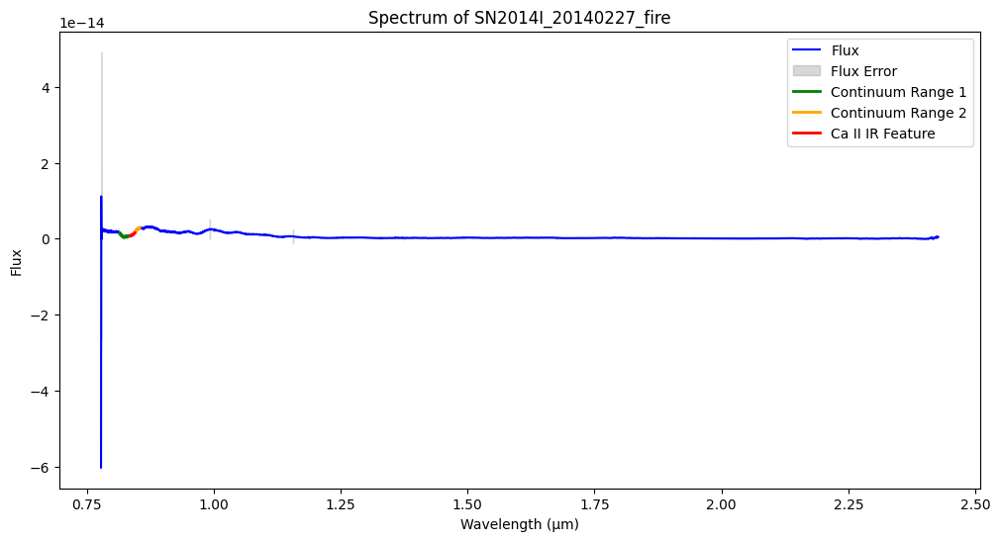

Pseudo-equivalent width for Ca II IR in SN2014I_20140310_fire: 0.01 Å
Velocity shift for Ca II IR in SN2014I_20140310_fire: -3588.76 km/s


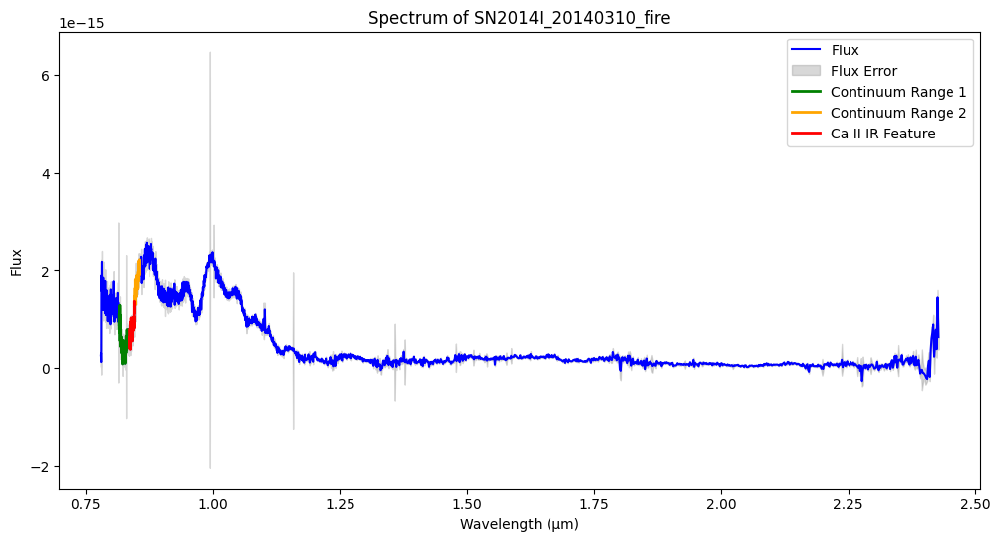

Pseudo-equivalent width for Ca II IR in SN2014Z_20140308_fire: 0.01 Å
Velocity shift for Ca II IR in SN2014Z_20140308_fire: -4487.94 km/s


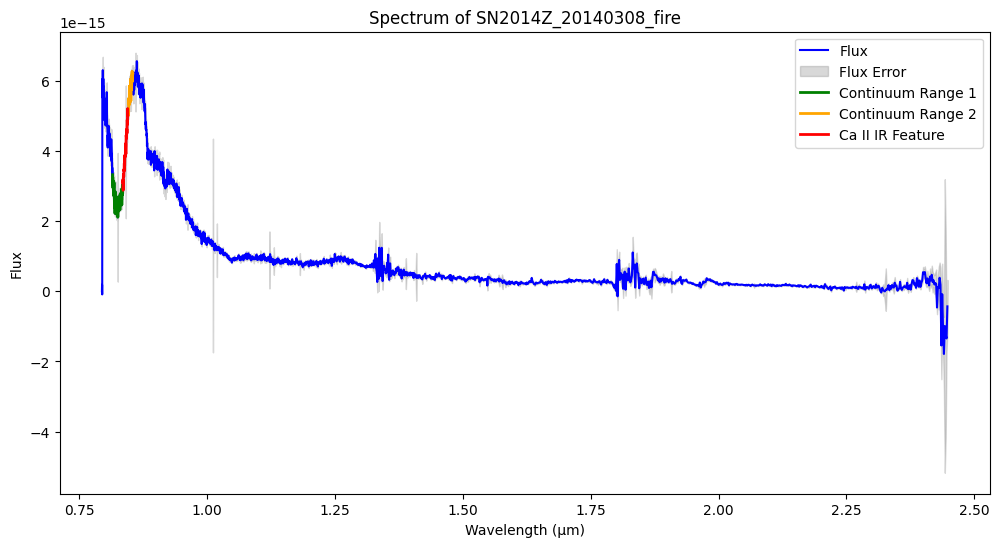

Pseudo-equivalent width for Ca II IR in SN2014ao_20140423_fire: 0.01 Å
Velocity shift for Ca II IR in SN2014ao_20140423_fire: -4273.59 km/s


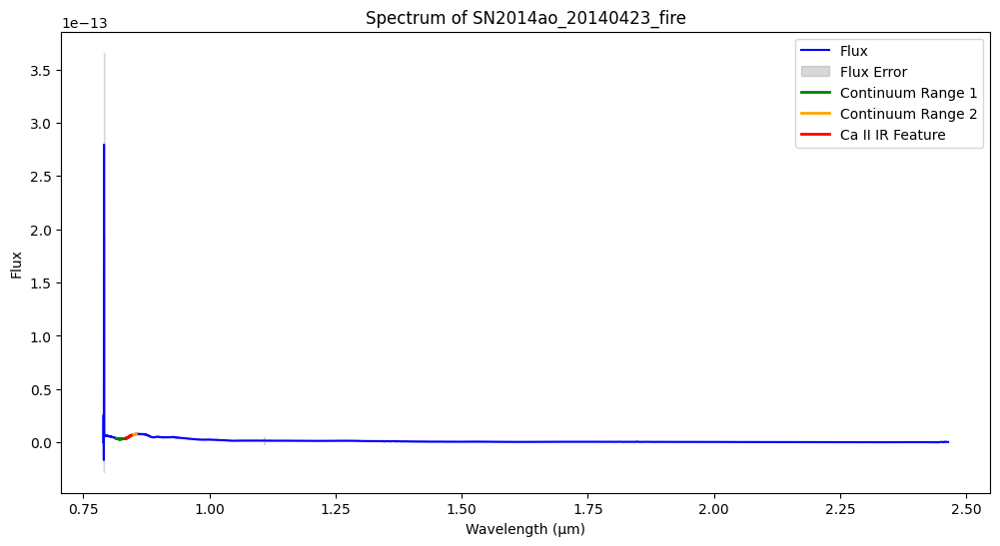

Pseudo-equivalent width for Ca II IR in SN2014ao_20140606_fire: 0.01 Å
Velocity shift for Ca II IR in SN2014ao_20140606_fire: -3981.53 km/s


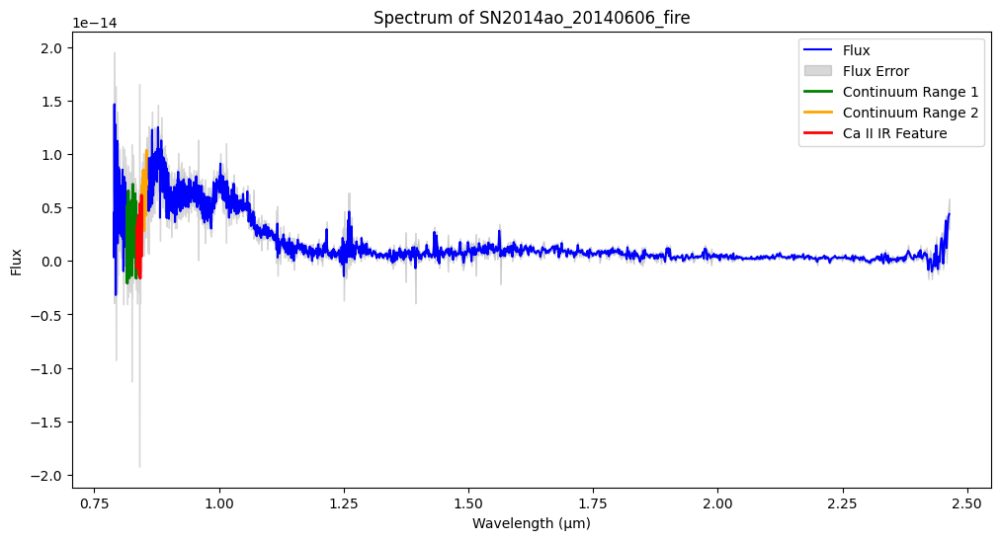

Pseudo-equivalent width for Ca II IR in SN2014at_20140423_fire: 0.00 Å
Velocity shift for Ca II IR in SN2014at_20140423_fire: -5717.86 km/s


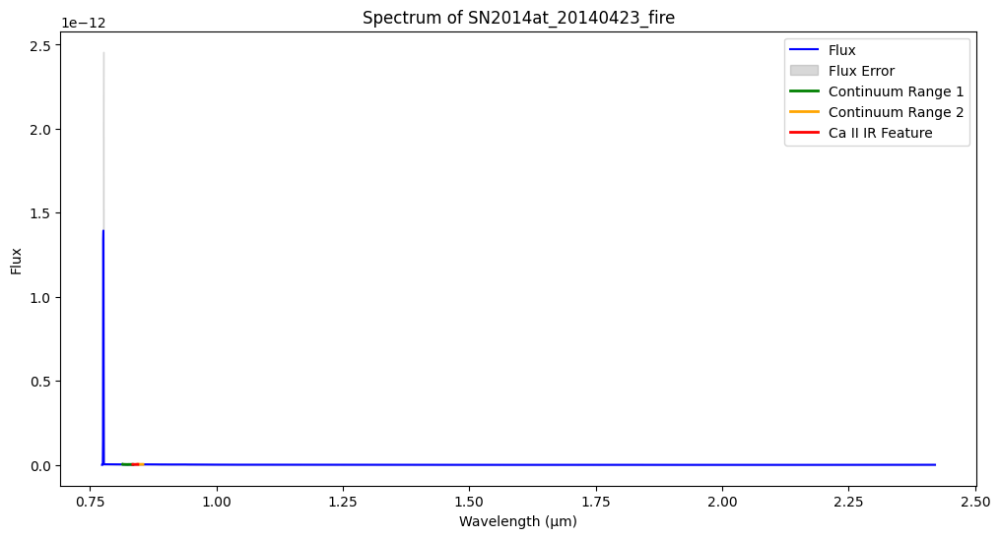

Pseudo-equivalent width for Ca II IR in SN2014at_20140606_fire: 0.01 Å
Velocity shift for Ca II IR in SN2014at_20140606_fire: -3604.81 km/s


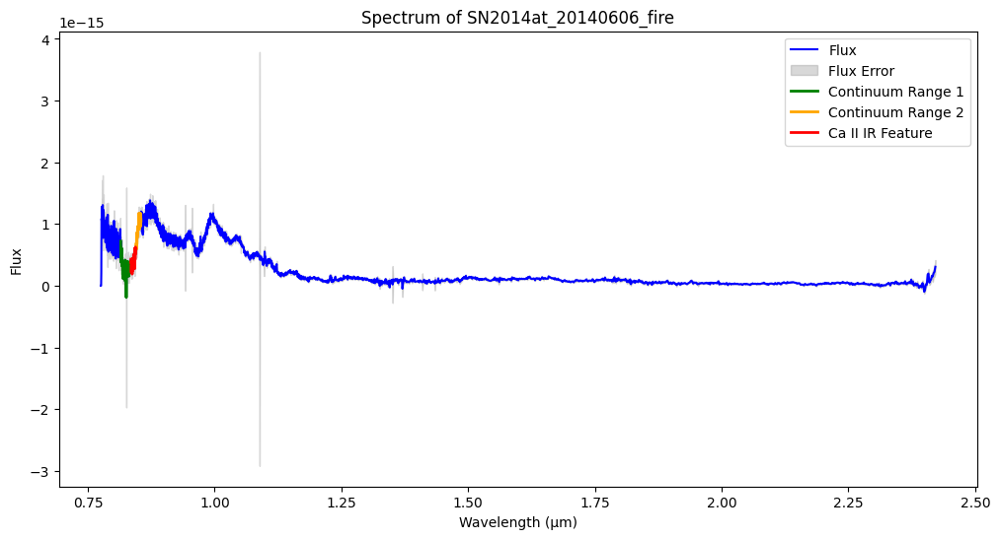

Pseudo-equivalent width for Ca II IR in CSP14adc_20141105_fire: 0.01 Å
Velocity shift for Ca II IR in CSP14adc_20141105_fire: -4686.30 km/s


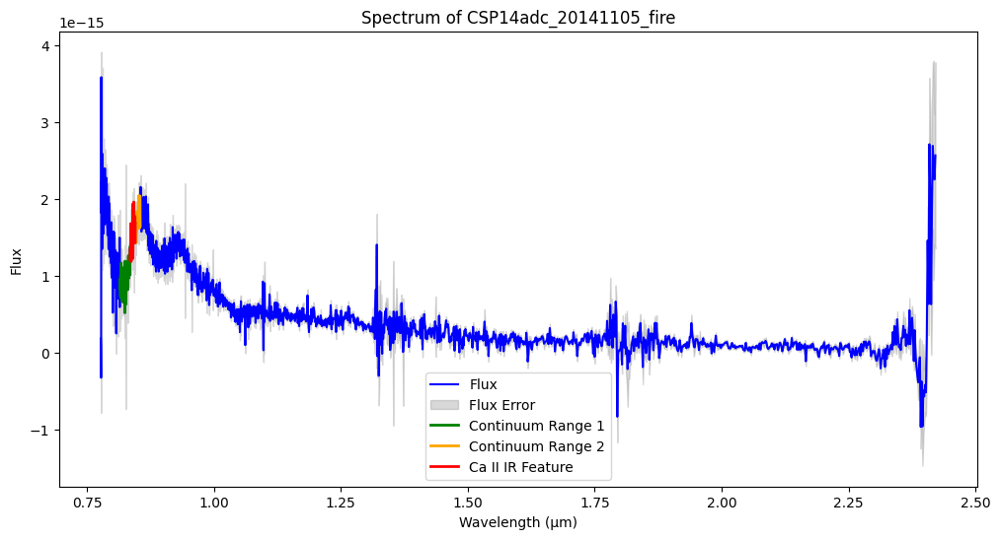

Pseudo-equivalent width for Ca II IR in SN2014eg_20141208_fire: 0.00 Å
Velocity shift for Ca II IR in SN2014eg_20141208_fire: -5111.35 km/s


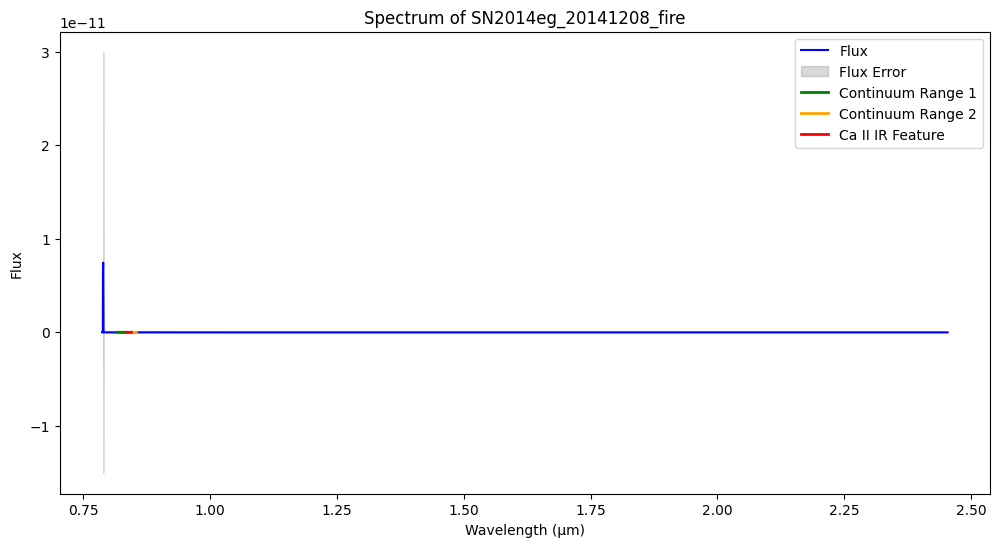

Pseudo-equivalent width for Ca II IR in SN2015F_20150314_fire: 0.00 Å
Velocity shift for Ca II IR in SN2015F_20150314_fire: -4413.56 km/s


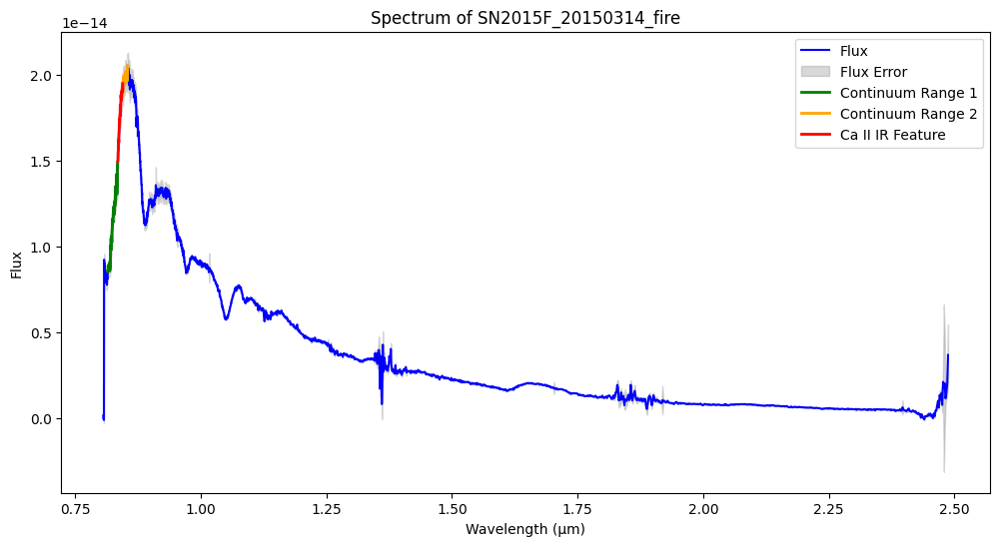

Pseudo-equivalent width for Ca II IR in SN2015F_20150402_fire: 0.01 Å
Velocity shift for Ca II IR in SN2015F_20150402_fire: -3827.27 km/s


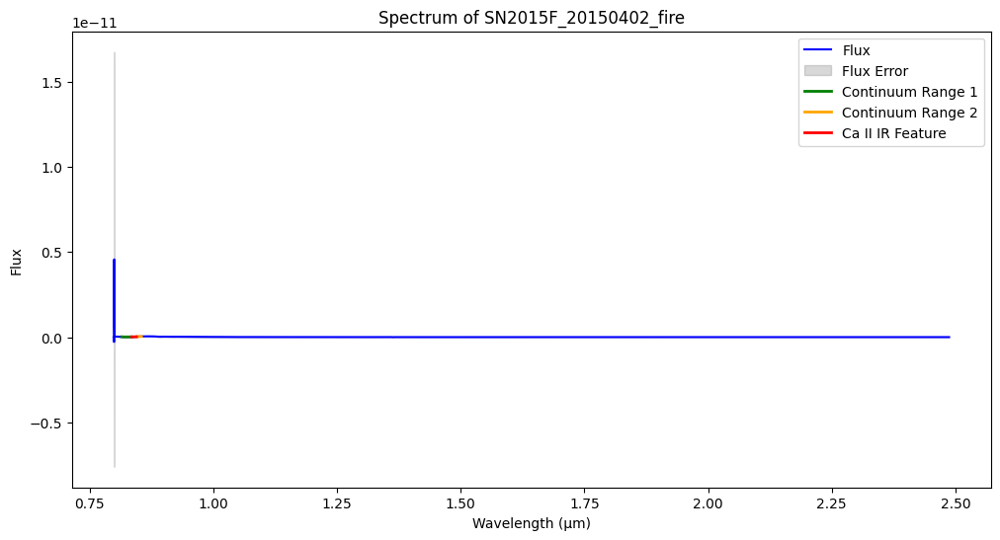

Pseudo-equivalent width for Ca II IR in SN2015F_20150407_fire: 0.01 Å
Velocity shift for Ca II IR in SN2015F_20150407_fire: -3650.01 km/s


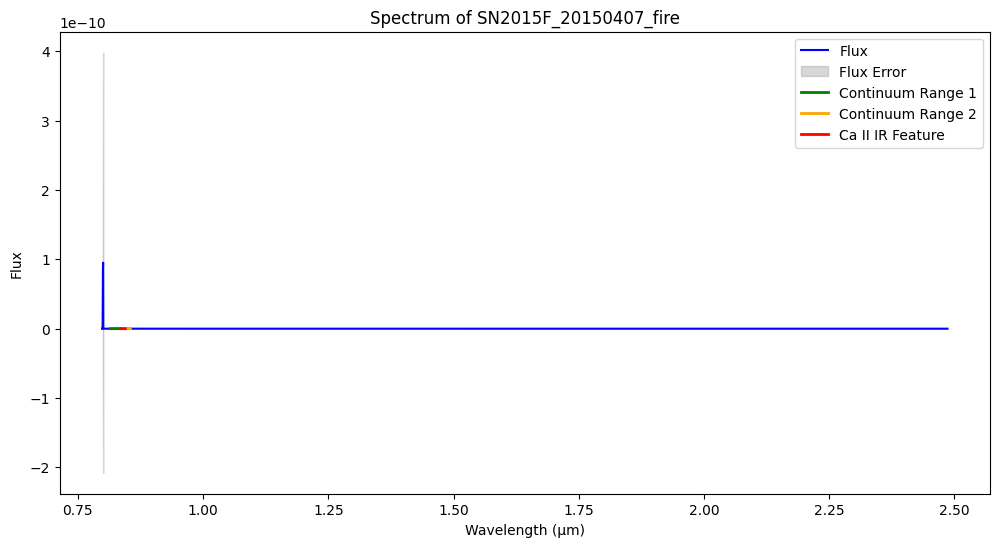

Pseudo-equivalent width for Ca II IR in SN2015F_20150412_fire: 0.01 Å
Velocity shift for Ca II IR in SN2015F_20150412_fire: -3696.64 km/s


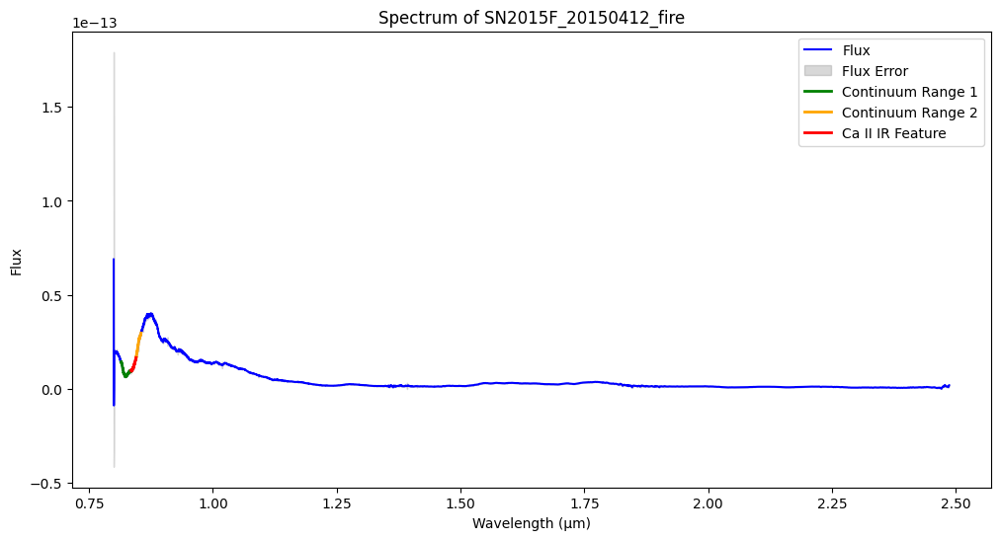

Pseudo-equivalent width for Ca II IR in SN2015F_20150602_fire: 0.01 Å
Velocity shift for Ca II IR in SN2015F_20150602_fire: -3024.44 km/s


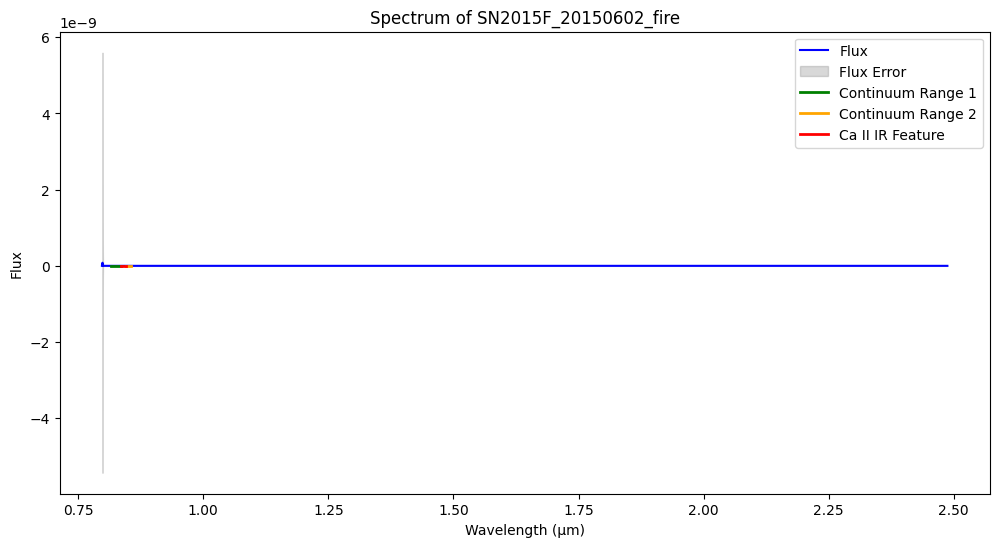

Pseudo-equivalent width for Ca II IR in CSP15aae_20150307_fire: 0.01 Å
Velocity shift for Ca II IR in CSP15aae_20150307_fire: -3486.29 km/s


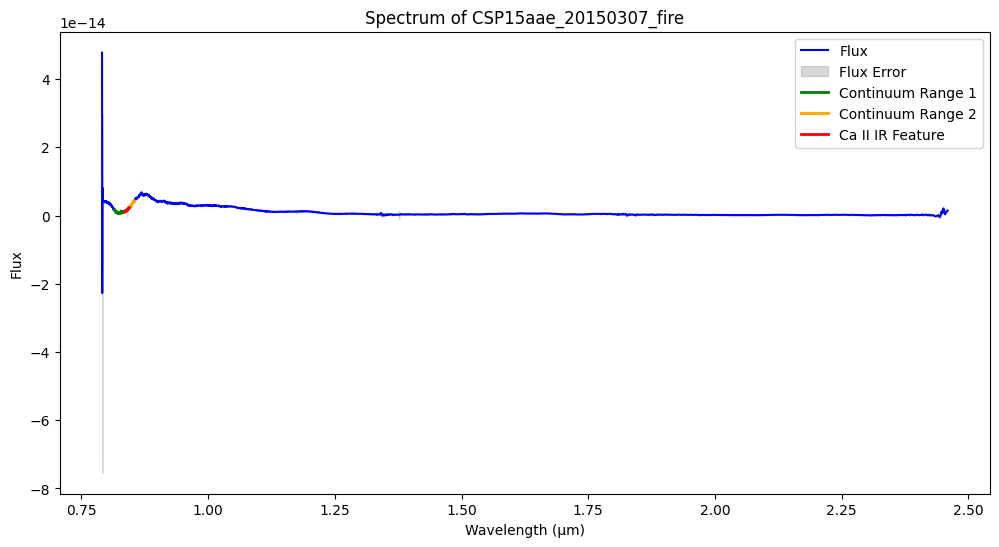

Pseudo-equivalent width for Ca II IR in SNhunt281_20150402_fire: 0.01 Å
Velocity shift for Ca II IR in SNhunt281_20150402_fire: -3755.83 km/s


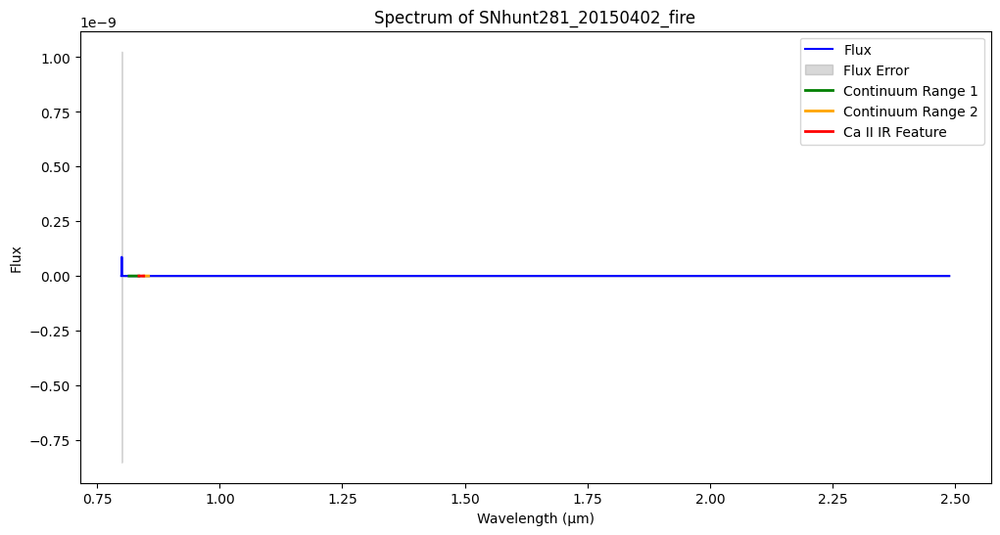

Pseudo-equivalent width for Ca II IR in SNhunt281_20150407_fire: 0.01 Å
Velocity shift for Ca II IR in SNhunt281_20150407_fire: -3593.24 km/s


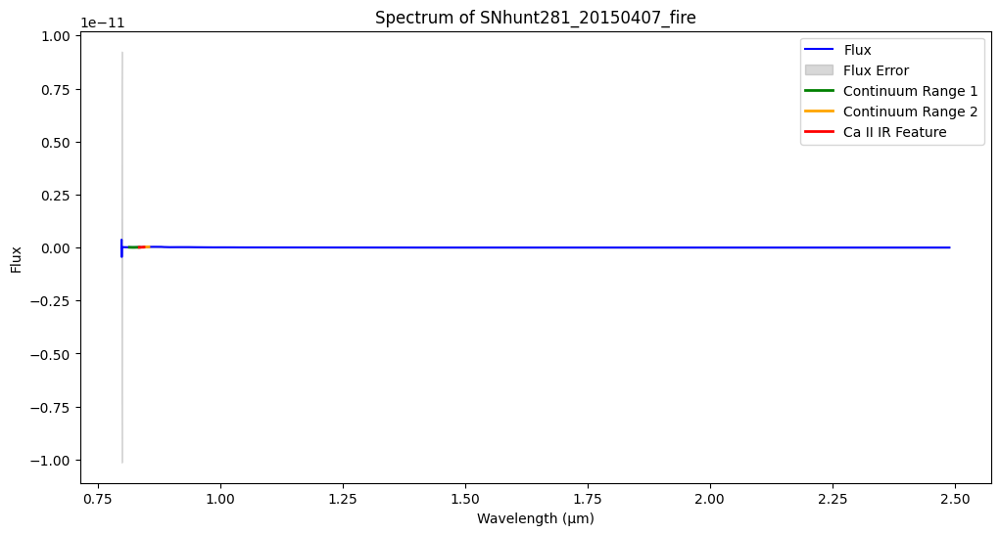

Pseudo-equivalent width for Ca II IR in SNhunt281_20150412_fire: 0.01 Å
Velocity shift for Ca II IR in SNhunt281_20150412_fire: -3646.35 km/s


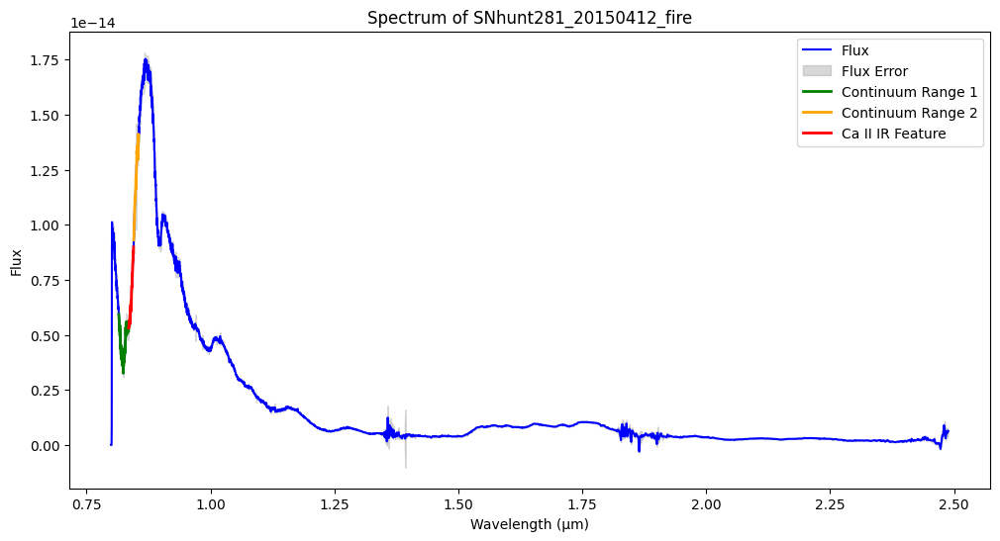

Pseudo-equivalent width for Ca II IR in SNhunt281_20150601_fire: 0.01 Å
Velocity shift for Ca II IR in SNhunt281_20150601_fire: -3687.26 km/s


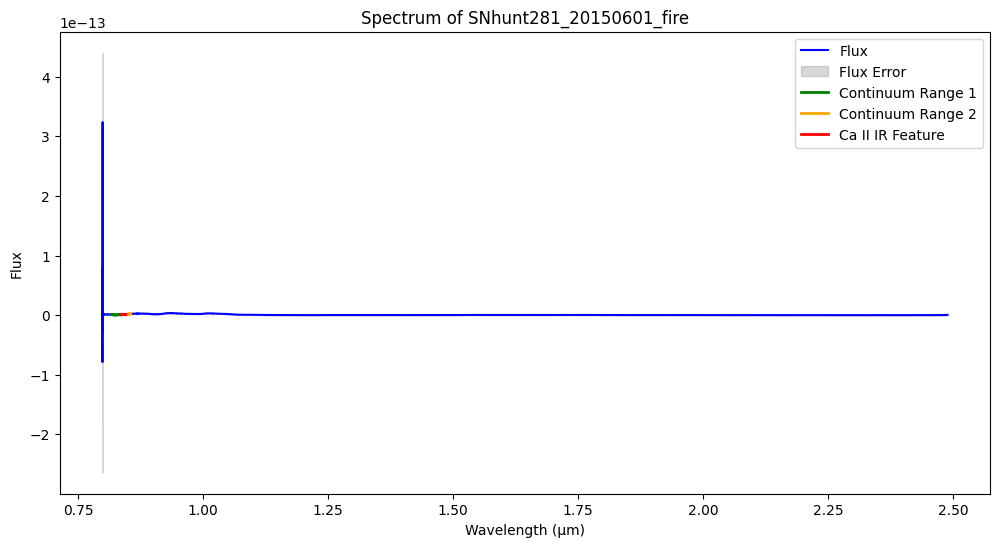

,filename,zhel,Tmax(MJD),sBV,pew,velocity,mean_flux,median_flux,std_flux,max_flux,min_flux,wavelength_at_max_flux,wavelength_at_min_flux,flux I,flux_Y,flux_J,flux_H,flux_K
0,ASAS14ad_20140208_fire,0.0264,56692.7,1.013,0.008308,-4137.910925,4.216527e-16,2.181891e-16,4.569898e-16,3.187331e-15,-3.314887e-16,0.781008,2.421794,1.094592e-15,2.616835e-16,1.770716e-16,7.008082e-17,3.677074e-17
1,ASAS14ad_20140215_fire,0.0264,56692.7,1.013,0.013300,-2956.998284,3.772785e-16,1.812365e-16,4.619190e-16,2.513188e-15,-1.400979e-15,0.785246,2.432642,9.636542e-16,2.390821e-16,1.088961e-16,1.189426e-16,5.377226e-17
2,ASAS14ad_20140222_fire,0.0264,56692.7,1.013,0.019110,-1651.412477,6.370729e-15,2.302576e-15,9.300459e-15,4.155343e-14,-7.336957e-15,0.869730,2.410336,1.273188e-14,5.839983e-15,1.654553e-15,2.229334e-15,1.010692e-15
3,ASAS14ad_20140227_fire,0.0264,56692.7,1.013,0.015530,-2594.762242,1.011366e-14,4.019668e-15,5.530620e-14,1.786641e-12,-2.337041e-15,0.782077,2.415819,2.497749e-14,8.373535e-15,2.476321e-15,3.471668e-15,1.805622e-15
4,ASAS14ad_20140310_fire,0.0264,56692.7,1.013,0.017065,-2234.798725,1.521564e-15,2.831000e-16,4.166121e-14,1.681415e-12,-5.012777e-13,0.782852,0.782501,4.995384e-15,9.805629e-16,2.329618e-16,1.493026e-16,5.941049e-17


In [8]:

def process_fits_file(file_path):
    with fits.open(file_path) as hdul:
        wv, fx, fx_err = hdul[0].data
    reasonable_indices = (wv >= 0.7) & (wv <= 2.5)
    wv = wv[reasonable_indices]
    fx = fx[reasonable_indices]
    fx_err = fx_err[reasonable_indices]
    return wv, fx, fx_err

def pEW(wavelength, flux, cont_coords):
    # Interpolate the continuum
    cont = interp1d(cont_coords[0], cont_coords[1], bounds_error=False, fill_value=1)
    # Normalize the flux by the continuum
    nflux = flux / cont(wavelength)
    pEW = 0
    # Loop through the wavelengths, avoiding the boundaries
    for i in range(1, len(wavelength)-1):
        if cont_coords[0, 0] < wavelength[i] < cont_coords[0, 1]:
            dwave = 0.5 * (wavelength[i + 1] - wavelength[i - 1])
            pEW += dwave * (1 - nflux[i])
    return pEW

def compute_pew_for_Ca_II_IR(wv, fx, zhel):
    # Define the rest wavelength for the Ca II IR feature
    rest_wavelength = wv / (1 + zhel)
    line_data = ('Line at 8498A', 0.8498, 0.8150, 0.8350, 0.8450, 0.8550)
    element, rest_wavelength_center, low_1, high_1, low_2, high_2 = line_data

    # Find indices corresponding to the wavelength ranges
    range1 = (rest_wavelength >= low_1) & (rest_wavelength <= high_1)
    range2 = (rest_wavelength >= low_2) & (rest_wavelength <= high_2)

    # Select the wavelengths and fluxes in the specified ranges
    wv_range1 = rest_wavelength[range1]
    fx_range1 = fx[range1]
    wv_range2 = rest_wavelength[range2]
    fx_range2 = fx[range2]

    # Calculate the continuum coordinates
    cont_coords = np.array([[low_1, low_2], [np.mean(fx_range1), np.mean(fx_range2)]])

    # Compute pEW
    pew_value = pEW(rest_wavelength, fx, cont_coords)

    # Calculate the centroid of the absorption feature for velocity shift calculation
    all_wv_range = np.concatenate([wv_range1, wv_range2])
    all_fx_range = np.concatenate([fx_range1, fx_range2])

    # Weighted centroid calculation
    centroid_wavelength = np.sum(all_wv_range * all_fx_range) / np.sum(all_fx_range)

    # Calculate the velocity shift (in km/s)
    delta_wavelength = centroid_wavelength - rest_wavelength_center
    velocity = (delta_wavelength / rest_wavelength_center) * 3e5

    return pew_value, velocity, low_1, high_1, low_2, high_2

def plot_spectrum(wv, flux, flux_err, title, low_1, high_1, low_2, high_2):
    plt.figure(figsize=(12, 6))

    # Plot the flux
    plt.plot(wv, flux, label='Flux', color='blue')

    # Plot the flux error as a shaded area
    plt.fill_between(wv, flux - flux_err, flux + flux_err, color='gray', alpha=0.3, label='Flux Error')

    # Highlight the first continuum range within the flux line
    plt.plot(wv[(wv >= low_1) & (wv <= high_1)], flux[(wv >= low_1) & (wv <= high_1)], color='green', linewidth=2, label='Continuum Range 1')

    # Highlight the second continuum range within the flux line
    plt.plot(wv[(wv >= low_2) & (wv <= high_2)], flux[(wv >= low_2) & (wv <= high_2)], color='orange', linewidth=2, label='Continuum Range 2')

    # Highlight the Ca II IR absorption feature region within the flux line
    plt.plot(wv[(wv > high_1) & (wv < low_2)], flux[(wv > high_1) & (wv < low_2)], color='red', linewidth=2, label='Ca II IR Feature')

    # Labels and title
    plt.xlabel('Wavelength (μm)')
    plt.ylabel('Flux')
    plt.title(title)
    plt.legend()
    plt.show()


def extract_features(wv, fx):
    features = {}
    features['mean_flux'] = np.mean(fx)
    features['median_flux'] = np.median(fx)
    features['std_flux'] = np.std(fx)
    features['max_flux'] = np.max(fx)
    features['min_flux'] = np.min(fx)
    features['wavelength_at_max_flux'] = wv[np.argmax(fx)]
    features['wavelength_at_min_flux'] = wv[np.argmin(fx)]

    # Calculation of flux in specific bands (Y: 1.0-1.1 µm, J: 1.1-1.4 µm, H: 1.5-1.8 µm, K: 2.0-2.5 µm)
    features['flux I'] = np.mean(fx[(wv >= 0.7) & (wv <= 0.9)])
    features['flux_Y'] = np.mean(fx[(wv >= 1.0) & (wv <= 1.1)])
    features['flux_J'] = np.mean(fx[(wv >= 1.1) & (wv <= 1.4)])
    features['flux_H'] = np.mean(fx[(wv >= 1.5) & (wv <= 1.8)])
    features['flux_K'] = np.mean(fx[(wv >= 2.0) & (wv <= 2.5)])

    return features

# Initialize an empty list to store features
features_list = []

# Process each file listed in the metadata
for index, row in metadata_df.iterrows():
    filename = row['filename']
    file_path_fits = os.path.join(fits_data_directory, f'{filename}.fits')
    zhel = row['zhel']
    Tmax = row['Tmax(MJD)']
    sBV = row['sBV']

    try:
        if os.path.exists(file_path_fits):
            wv, fx, fx_err = process_fits_file(file_path_fits)
            rest_wavelength = wv / (1 + zhel)

            if wv is not None:
                pew_value, velocity, low_1, high_1, low_2, high_2 = compute_pew_for_Ca_II_IR(wv, fx, zhel)
                print(f'Pseudo-equivalent width for Ca II IR in {filename}: {pew_value:.2f} Å')
                print(f'Velocity shift for Ca II IR in {filename}: {velocity:.2f} km/s')

                # Plot the spectrum and highlight the pEW calculation regions
                plot_spectrum(rest_wavelength, fx, fx_err, 'Spectrum of ' + filename, low_1, high_1, low_2, high_2)
                additional_features = extract_features(rest_wavelength, fx)

                # Create a dictionary for the features of this file
                features = {
                    'filename': filename,
                    'zhel': zhel,
                    'Tmax(MJD)': Tmax,
                    'sBV': sBV,
                    'pew': pew_value,
                    'velocity': velocity
                }

                features.update(additional_features)
                # Append the features dictionary to the features_list
                features_list.append(features)

        else:
            continue

    except Exception as e:
        print(f"Error processing file {filename}: {e}")
        continue

features_df = pd.DataFrame(features_list)
features_df.to_csv('extracted_features.csv', index=False)
features_df.head()


In [9]:

print("Initial missing values:\n", features_df.isnull().sum())


features_df_cleaned = features_df.dropna()

print("Missing values after removing rows:\n", features_df_cleaned.isnull().sum())


features_df_cleaned.to_csv('extracted_features_cleaned.csv', index=False)


print(features_df_cleaned.head())


Initial missing values:
 filename                  0
zhel                      0
Tmax(MJD)                 0
sBV                       0
pew                       0
velocity                  0
mean_flux                 2
median_flux               2
std_flux                  2
max_flux                  2
min_flux                  2
wavelength_at_max_flux    0
wavelength_at_min_flux    0
flux I                    0
flux_Y                    0
flux_J                    0
flux_H                    0
flux_K                    2
dtype: int64
Missing values after removing rows:
 filename                  0
zhel                      0
Tmax(MJD)                 0
sBV                       0
pew                       0
velocity                  0
mean_flux                 0
median_flux               0
std_flux                  0
max_flux                  0
min_flux                  0
wavelength_at_max_flux    0
wavelength_at_min_flux    0
flux I                    0
flux_Y                    0
f

In [10]:
import pandas as pd
import numpy as np


# Min-Max normalization
def min_max_normalize(series):
    min_val = series.min()
    max_val = series.max()
    return (series - min_val) / (max_val - min_val)

# Apply normalization to the 'pew' column
features_df_cleaned['pew_normalized'] = min_max_normalize(features_df_cleaned['pew'])

# Display the DataFrame with normalized values
print(features_df_cleaned)


                    filename    zhel  Tmax(MJD)    sBV       pew     velocity  \
0     ASAS14ad_20140208_fire  0.0264   56692.70  1.013  0.008308 -4137.910925   
1     ASAS14ad_20140215_fire  0.0264   56692.70  1.013  0.013300 -2956.998284   
2     ASAS14ad_20140222_fire  0.0264   56692.70  1.013  0.019110 -1651.412477   
3     ASAS14ad_20140227_fire  0.0264   56692.70  1.013  0.015530 -2594.762242   
4     ASAS14ad_20140310_fire  0.0264   56692.70  1.013  0.017065 -2234.798725   
..                       ...     ...        ...    ...       ...          ...   
334   CSP15aae_20150307_fire  0.0162   57076.02  0.505  0.011960 -3486.285846   
335  SNhunt281_20150402_fire  0.0041   57112.67  0.692  0.009350 -3755.832386   
336  SNhunt281_20150407_fire  0.0041   57112.67  0.692  0.010357 -3593.241745   
337  SNhunt281_20150412_fire  0.0041   57112.67  0.692  0.010114 -3646.351461   
338  SNhunt281_20150601_fire  0.0041   57112.67  0.692  0.010117 -3687.256885   

        mean_flux   median_

<ipython-input-10-f8a639e5bd6e>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  features_df_cleaned['pew_normalized'] = min_max_normalize(features_df_cleaned['pew'])


<ipython-input-11-cf996f9f69ab>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  features_copy['magI'] = -2.5 * np.log10(features_copy['flux I'] / 1.0e-10)


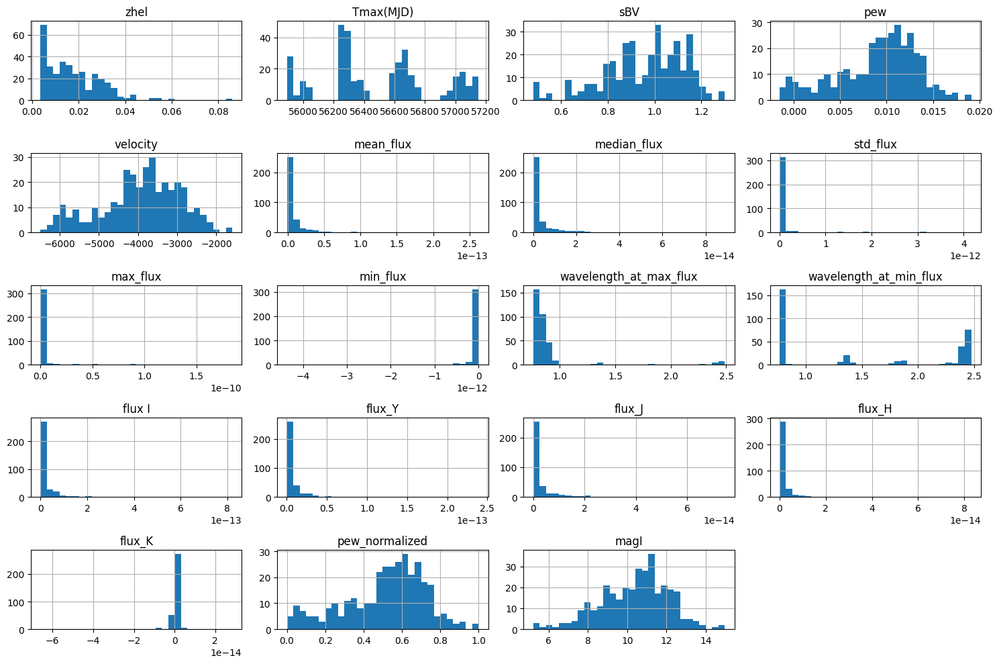

In [11]:

features_copy = features_df_cleaned
features_copy['magI'] = -2.5 * np.log10(features_copy['flux I'] / 1.0e-10)
import matplotlib.pyplot as plt

features_to_plot = [col for col in features_copy.columns if col not in ['filename']]


features_copy[features_to_plot].hist(bins=30, figsize=(15, 10))
plt.tight_layout()
plt.show()
